In [1]:
import mujoco
import mediapy as media
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F 
import torch.autograd
from torch.autograd import Variable
import torch.optim as optim
import numpy as np
import gym
from collections import deque
import random
import sys
import pandas as pd
import matplotlib.pyplot as plt
from numpy import cos, sin
from gym import spaces
from gym.error import DependencyNotInstalled
from typing import Optional
from control.matlab import ss, lsim, linspace, c2d
from functools import partial
from state_estimation import Estimator
import math
import gym
from stable_baselines3 import PPO, SAC, TD3, DDPG, DQN, A2C
from stable_baselines3.common.env_checker import check_env

In [2]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

In [3]:
try:
    print('Checking that the installation succeeded:')
    import mujoco
    mujoco.MjModel.from_xml_string('<mujoco/>')
except Exception as e:
    raise e from RuntimeError(
      'Something went wrong during installation. Check the shell output above '
      'for more information.\n'
      'If using a hosted Colab runtime, make sure you enable GPU acceleration '
      'by going to the Runtime menu and selecting "Choose runtime type".')

print('Installation successful.')

Checking that the installation succeeded:
Installation successful.


In [4]:
with open('swimmer.xml', 'r',encoding='UTF-8') as f:
    xml = f.read()

In [5]:
model = mujoco.MjModel.from_xml_string(xml)
data = mujoco.MjData(model)
mujoco.mj_forward(model, data)

In [6]:
for key in range(model.nkey):
    mujoco.mj_resetDataKeyframe(model, data, key)
    mujoco.mj_forward(model, data)

In [7]:
DURATION  = 3   # seconds
FRAMERATE = 60  # Hz

mujoco.mj_resetDataKeyframe(model, data, 1)

frames = []
while data.time < DURATION:
    # Set control vector.
    data.ctrl = np.random.randn(model.nu)
    print(data.qpos)
    # Step the simulation.
    mujoco.mj_step(model, data)

[0. 0. 0. 0. 0.]
[ 4.25359724e-07 -1.06752845e-03  1.20477985e-03 -1.52827489e-03
 -2.98393083e-04]
[ 6.46591915e-06 -4.33033152e-03  4.74866668e-03 -6.64784337e-03
  5.81059618e-04]
[ 2.76838159e-05 -9.50106086e-03  1.01749652e-02 -1.53739965e-02
  4.42237216e-03]
[ 7.35111710e-05 -1.56249833e-02  1.66835524e-02 -2.54399088e-02
  7.88893921e-03]
[ 0.00014066 -0.0214485   0.02295555 -0.03474262  0.01008988]
[ 0.00020544 -0.02609319  0.02786585 -0.04245717  0.01300702]
[ 0.00028991 -0.03179003  0.03369848 -0.05253758  0.01905977]
[ 0.00043986 -0.03997115  0.0421442  -0.06679475  0.02688075]
[ 0.00068561 -0.04991231  0.05262534 -0.08342306  0.03357534]
[ 0.00106225 -0.06150678  0.06501994 -0.10228752  0.03921128]
[ 0.00154697 -0.07373258  0.07808629 -0.1222193   0.04522482]
[ 0.0021476  -0.08648192  0.09171041 -0.14305055  0.05158198]
[ 0.00294994 -0.10024059  0.10665136 -0.16482962  0.05550881]
[ 0.00399489 -0.11538175  0.12319292 -0.18858655  0.0588111 ]
[ 0.00533009 -0.13289538  0.142

In [8]:
class SwimmerEnv(gym.Env):
    """Custom Environment that follows gym interface."""

    metadata = {"render.modes": ["human"]}

    def __init__(self, render_mode: Optional[str] = None, g=10.0):
        super(SwimmerEnv).__init__()
        # Define action and observation space
        # They must be gym.spaces objects
        # Example when using discrete actions:
        ob_high = np.ones(10)
        action_high = np.ones(2)
        self.action_space = spaces.Box(low=-action_high, high=action_high, dtype=np.float32)
        self.observation_space = spaces.Box(low=-ob_high, high=ob_high, dtype=np.float32)
        self.step_const = 30
        self.freq = 0.1
        self.steps = 0
        self.center = [0.9,0,0,0,0,0,0,0,0,0]
        self.reward_cache = [] # cache distances to target norm ball center
        self.final_reward_cache = [] # cache final reward
        self.state = np.random.rand(10)*2-1
        self.target_norm_radius = 0.8
        self.max_reward_list = []
        self.quality_list = []
        self.total_steps = 0
        self.step_history = []
        self.reset_noise_scale = 0.2
        self.mod = mujoco.MjModel.from_xml_string(xml)
        self.data = mujoco.MjData(self.mod)
        self.init_qpos = self.data.qpos.ravel().copy()
        self.init_qvel = self.data.qvel.ravel().copy()
        self.k = 20
    def step(self, action):
        terminated = False
        self.data.ctrl = action
        mujoco.mj_step(self.mod, self.data)
        self.state = self._get_obs()
        dist = np.linalg.norm(self.state - self.center)
        reward = self.target_norm_radius - dist
        self.reward_cache.append(reward)
        self.steps += 1
        self.total_steps +=1 
        # quantitative semantics
        # reach reward, encourage reaching target
        if self.steps < 10:
            reach_reward = max(self.reward_cache)
        else:
            reach_reward = max(self.reward_cache[-10:])
        final_reward = reach_reward

        if dist <= self.target_norm_radius:
            final_reward = 10
        self.final_reward_cache.append(final_reward)
        if self.steps == self.step_const or max(np.absolute(self.state))>2:
            self.max_reward_list.append(max(self.final_reward_cache)) # use max final reward to measure episodes
            self.step_history.append(self.total_steps)
            self.quality_list.append(sum(self.final_reward_cache))
            terminated = True
            self.reset()

        # Return next state, reward, done, info
        return self.state, final_reward, terminated, {}

    def reset(self):
        self.steps = 0
        self.reward_cache = []
        self.step_const = self.k
        self.final_reward_cache = []
        noise_low = -self.reset_noise_scale
        noise_high = self.reset_noise_scale

        qpos = self.init_qpos + np.random.uniform(
            low=noise_low, high=noise_high, size=self.mod.nq
        )
        qvel = self.init_qvel + np.random.uniform(
            low=noise_low, high=noise_high, size=self.mod.nv
        )
        self.data.qpos[:] = np.copy(qpos)
        self.data.qvel[:] = np.copy(qvel)
        mujoco.mj_forward(self.mod, self.data)
        return self._get_obs()  # reward, done, info can't be included
    def _get_obs(self):
        position = self.data.qpos.flat.copy()
        velocity = self.data.qvel.flat.copy()
        observation = np.concatenate([position, velocity]).ravel()
        return observation
    def render(self, mode="human"):
        return

    def close(self):
        if self.screen is not None:
            import pygame
            pygame.display.quit()
            pygame.quit()
            self.isopen = False

In [10]:
# Training
reached = []
for k in [10,20,40,80,160]:
    env = SwimmerEnv()
    env.k = k
    # learning_rate = 1e-3, n_steps = 1024, tune these
    model = SAC("MlpPolicy", env, verbose=1)
    model.learn(total_timesteps=300000, progress_bar=False)
#     model.save('swimmer_reach_sac')
    vec_env = model.get_env()
    obs = vec_env.reset()
    # Test 50 traces
    env = SwimmerEnv()
    env.k = 160
    state = env.reset()
    dims0 = []
    dims1 = []
    dims2 = []
    euclids = []
    center = [0.9,0,0,0,0,0,0,0,0,0]
    num_reached = 0
    for j in range(1000):
        dim0 = []
        dim1 = []
        dim2 = []
        euclid = []
        state = env.reset()
        # Print initial state
        for i in range(30):
            action, _states = model.predict(state, deterministic=True)
            new_state, reward, done, _ = env.step(action)
            dist = np.linalg.norm(new_state-center)
            dim0.append(new_state[0])
            euclid.append(dist)
            state = new_state
            if dist <= 0.8: # stop
                num_reached += 1
                break
        dims0.append(dim0)
        dims1.append(dim1)
        dims2.append(dim2)
        euclids.append(euclid)
    reached.append(num_reached)
print(reached)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | -1.79    |
| time/              |          |
|    episodes        | 4        |
|    fps             | 2506     |
|    time_elapsed    | 0        |
|    total_timesteps | 40       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | -2.27    |
| time/              |          |
|    episodes        | 8        |
|    fps             | 2593     |
|    time_elapsed    | 0        |
|    total_timesteps | 75       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.17     |
|    ep_rew_mean     | -2.33    |
| time/              |          |
|    episodes        | 12       |
|    fps             |

C:\Users\Mengyu\AppData\Roaming\Python\Python39\site-packages\gym\spaces\box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.19     |
|    ep_rew_mean     | -2.03    |
| time/              |          |
|    episodes        | 16       |
|    fps             | 167      |
|    time_elapsed    | 0        |
|    total_timesteps | 147      |
| train/             |          |
|    actor_loss      | -2.32    |
|    critic_loss     | 0.317    |
|    ent_coef        | 0.987    |
|    ent_coef_loss   | -0.0456  |
|    learning_rate   | 0.0003   |
|    n_updates       | 46       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.35     |
|    ep_rew_mean     | -1.37    |
| time/              |          |
|    episodes        | 20       |
|    fps             | 116      |
|    time_elapsed    | 1        |
|    total_timesteps | 187      |
| train/             |          |
|    actor_loss      | -2.55    |
|    critic_loss     | 1.13     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | -1.69    |
| time/              |          |
|    episodes        | 76       |
|    fps             | 63       |
|    time_elapsed    | 11       |
|    total_timesteps | 729      |
| train/             |          |
|    actor_loss      | -3.64    |
|    critic_loss     | 1.26     |
|    ent_coef        | 0.829    |
|    ent_coef_loss   | -0.625   |
|    learning_rate   | 0.0003   |
|    n_updates       | 628      |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | -1.71    |
| time/              |          |
|    episodes        | 80       |
|    fps             | 62       |
|    time_elapsed    | 12       |
|    total_timesteps | 769      |
| train/             |          |
|    actor_loss      | -3.54    |
|    critic_loss     | 1.2      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | -1.34    |
| time/              |          |
|    episodes        | 136      |
|    fps             | 57       |
|    time_elapsed    | 23       |
|    total_timesteps | 1328     |
| train/             |          |
|    actor_loss      | -4.28    |
|    critic_loss     | 1.24     |
|    ent_coef        | 0.695    |
|    ent_coef_loss   | -1.16    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1227     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.98     |
|    ep_rew_mean     | -1.33    |
| time/              |          |
|    episodes        | 140      |
|    fps             | 57       |
|    time_elapsed    | 23       |
|    total_timesteps | 1368     |
| train/             |          |
|    actor_loss      | -4.43    |
|    critic_loss     | 1.21     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | -1.25    |
| time/              |          |
|    episodes        | 196      |
|    fps             | 55       |
|    time_elapsed    | 34       |
|    total_timesteps | 1928     |
| train/             |          |
|    actor_loss      | -4.51    |
|    critic_loss     | 1.59     |
|    ent_coef        | 0.584    |
|    ent_coef_loss   | -1.64    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1827     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | -1.2     |
| time/              |          |
|    episodes        | 200      |
|    fps             | 55       |
|    time_elapsed    | 35       |
|    total_timesteps | 1968     |
| train/             |          |
|    actor_loss      | -4.39    |
|    critic_loss     | 1.86     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | -0.961   |
| time/              |          |
|    episodes        | 256      |
|    fps             | 55       |
|    time_elapsed    | 45       |
|    total_timesteps | 2528     |
| train/             |          |
|    actor_loss      | -4.37    |
|    critic_loss     | 1.53     |
|    ent_coef        | 0.493    |
|    ent_coef_loss   | -2.03    |
|    learning_rate   | 0.0003   |
|    n_updates       | 2427     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | -0.979   |
| time/              |          |
|    episodes        | 260      |
|    fps             | 55       |
|    time_elapsed    | 46       |
|    total_timesteps | 2568     |
| train/             |          |
|    actor_loss      | -4.46    |
|    critic_loss     | 2.81     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 0.864    |
| time/              |          |
|    episodes        | 316      |
|    fps             | 54       |
|    time_elapsed    | 57       |
|    total_timesteps | 3128     |
| train/             |          |
|    actor_loss      | -4.33    |
|    critic_loss     | 2.81     |
|    ent_coef        | 0.417    |
|    ent_coef_loss   | -2.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 3027     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 0.891    |
| time/              |          |
|    episodes        | 320      |
|    fps             | 54       |
|    time_elapsed    | 58       |
|    total_timesteps | 3168     |
| train/             |          |
|    actor_loss      | -4.54    |
|    critic_loss     | 2.99     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 2.73     |
| time/              |          |
|    episodes        | 376      |
|    fps             | 54       |
|    time_elapsed    | 68       |
|    total_timesteps | 3728     |
| train/             |          |
|    actor_loss      | -4.26    |
|    critic_loss     | 2.73     |
|    ent_coef        | 0.355    |
|    ent_coef_loss   | -2.5     |
|    learning_rate   | 0.0003   |
|    n_updates       | 3627     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 2.44     |
| time/              |          |
|    episodes        | 380      |
|    fps             | 54       |
|    time_elapsed    | 69       |
|    total_timesteps | 3768     |
| train/             |          |
|    actor_loss      | -4.23    |
|    critic_loss     | 4.13     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 2.89     |
| time/              |          |
|    episodes        | 436      |
|    fps             | 54       |
|    time_elapsed    | 80       |
|    total_timesteps | 4328     |
| train/             |          |
|    actor_loss      | -3.39    |
|    critic_loss     | 2.79     |
|    ent_coef        | 0.302    |
|    ent_coef_loss   | -2.99    |
|    learning_rate   | 0.0003   |
|    n_updates       | 4227     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 3.49     |
| time/              |          |
|    episodes        | 440      |
|    fps             | 54       |
|    time_elapsed    | 80       |
|    total_timesteps | 4368     |
| train/             |          |
|    actor_loss      | -4.01    |
|    critic_loss     | 3.9      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 0.966    |
| time/              |          |
|    episodes        | 496      |
|    fps             | 53       |
|    time_elapsed    | 91       |
|    total_timesteps | 4928     |
| train/             |          |
|    actor_loss      | -3.88    |
|    critic_loss     | 5.08     |
|    ent_coef        | 0.257    |
|    ent_coef_loss   | -3.02    |
|    learning_rate   | 0.0003   |
|    n_updates       | 4827     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 2.27     |
| time/              |          |
|    episodes        | 500      |
|    fps             | 53       |
|    time_elapsed    | 92       |
|    total_timesteps | 4968     |
| train/             |          |
|    actor_loss      | -3.93    |
|    critic_loss     | 7.33     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 4.79     |
| time/              |          |
|    episodes        | 556      |
|    fps             | 53       |
|    time_elapsed    | 103      |
|    total_timesteps | 5528     |
| train/             |          |
|    actor_loss      | -5.12    |
|    critic_loss     | 11.4     |
|    ent_coef        | 0.218    |
|    ent_coef_loss   | -2.99    |
|    learning_rate   | 0.0003   |
|    n_updates       | 5427     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 4.45     |
| time/              |          |
|    episodes        | 560      |
|    fps             | 53       |
|    time_elapsed    | 103      |
|    total_timesteps | 5568     |
| train/             |          |
|    actor_loss      | -4.31    |
|    critic_loss     | 4.04     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 6.92     |
| time/              |          |
|    episodes        | 616      |
|    fps             | 53       |
|    time_elapsed    | 114      |
|    total_timesteps | 6128     |
| train/             |          |
|    actor_loss      | -4.72    |
|    critic_loss     | 4.74     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -3.38    |
|    learning_rate   | 0.0003   |
|    n_updates       | 6027     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 620      |
|    fps             | 53       |
|    time_elapsed    | 115      |
|    total_timesteps | 6168     |
| train/             |          |
|    actor_loss      | -4.47    |
|    critic_loss     | 6.44     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 5.05     |
| time/              |          |
|    episodes        | 676      |
|    fps             | 53       |
|    time_elapsed    | 126      |
|    total_timesteps | 6728     |
| train/             |          |
|    actor_loss      | -4.66    |
|    critic_loss     | 11.3     |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | -3.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 6627     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 5.47     |
| time/              |          |
|    episodes        | 680      |
|    fps             | 53       |
|    time_elapsed    | 126      |
|    total_timesteps | 6768     |
| train/             |          |
|    actor_loss      | -3.94    |
|    critic_loss     | 18.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 3.01     |
| time/              |          |
|    episodes        | 736      |
|    fps             | 53       |
|    time_elapsed    | 137      |
|    total_timesteps | 7328     |
| train/             |          |
|    actor_loss      | -4.52    |
|    critic_loss     | 22.4     |
|    ent_coef        | 0.135    |
|    ent_coef_loss   | -3.76    |
|    learning_rate   | 0.0003   |
|    n_updates       | 7227     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 2.99     |
| time/              |          |
|    episodes        | 740      |
|    fps             | 53       |
|    time_elapsed    | 138      |
|    total_timesteps | 7368     |
| train/             |          |
|    actor_loss      | -5.09    |
|    critic_loss     | 8.83     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 796      |
|    fps             | 53       |
|    time_elapsed    | 149      |
|    total_timesteps | 7928     |
| train/             |          |
|    actor_loss      | -6.16    |
|    critic_loss     | 18.7     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -3.4     |
|    learning_rate   | 0.0003   |
|    n_updates       | 7827     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 7.12     |
| time/              |          |
|    episodes        | 800      |
|    fps             | 53       |
|    time_elapsed    | 150      |
|    total_timesteps | 7968     |
| train/             |          |
|    actor_loss      | -5.75    |
|    critic_loss     | 8.28     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 9.64     |
| time/              |          |
|    episodes        | 856      |
|    fps             | 53       |
|    time_elapsed    | 160      |
|    total_timesteps | 8528     |
| train/             |          |
|    actor_loss      | -5.55    |
|    critic_loss     | 14       |
|    ent_coef        | 0.0983   |
|    ent_coef_loss   | -3.76    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8427     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 860      |
|    fps             | 53       |
|    time_elapsed    | 161      |
|    total_timesteps | 8568     |
| train/             |          |
|    actor_loss      | -5.55    |
|    critic_loss     | 28.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 5.92     |
| time/              |          |
|    episodes        | 916      |
|    fps             | 52       |
|    time_elapsed    | 172      |
|    total_timesteps | 9128     |
| train/             |          |
|    actor_loss      | -6.02    |
|    critic_loss     | 13.6     |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | -2.87    |
|    learning_rate   | 0.0003   |
|    n_updates       | 9027     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 4.92     |
| time/              |          |
|    episodes        | 920      |
|    fps             | 52       |
|    time_elapsed    | 173      |
|    total_timesteps | 9168     |
| train/             |          |
|    actor_loss      | -5.76    |
|    critic_loss     | 19       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 2.76     |
| time/              |          |
|    episodes        | 976      |
|    fps             | 52       |
|    time_elapsed    | 184      |
|    total_timesteps | 9727     |
| train/             |          |
|    actor_loss      | -6.2     |
|    critic_loss     | 16.5     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | -3.51    |
|    learning_rate   | 0.0003   |
|    n_updates       | 9626     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.98     |
|    ep_rew_mean     | 2.78     |
| time/              |          |
|    episodes        | 980      |
|    fps             | 52       |
|    time_elapsed    | 185      |
|    total_timesteps | 9766     |
| train/             |          |
|    actor_loss      | -6.83    |
|    critic_loss     | 69.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 1.21     |
| time/              |          |
|    episodes        | 1036     |
|    fps             | 52       |
|    time_elapsed    | 195      |
|    total_timesteps | 10321    |
| train/             |          |
|    actor_loss      | -6.64    |
|    critic_loss     | 34.9     |
|    ent_coef        | 0.0626   |
|    ent_coef_loss   | -2.64    |
|    learning_rate   | 0.0003   |
|    n_updates       | 10220    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 2.29     |
| time/              |          |
|    episodes        | 1040     |
|    fps             | 52       |
|    time_elapsed    | 196      |
|    total_timesteps | 10361    |
| train/             |          |
|    actor_loss      | -7.25    |
|    critic_loss     | 15.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 6.44     |
| time/              |          |
|    episodes        | 1096     |
|    fps             | 52       |
|    time_elapsed    | 207      |
|    total_timesteps | 10910    |
| train/             |          |
|    actor_loss      | -5.69    |
|    critic_loss     | 19.3     |
|    ent_coef        | 0.0546   |
|    ent_coef_loss   | -2.64    |
|    learning_rate   | 0.0003   |
|    n_updates       | 10809    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.78     |
|    ep_rew_mean     | 5.45     |
| time/              |          |
|    episodes        | 1100     |
|    fps             | 52       |
|    time_elapsed    | 207      |
|    total_timesteps | 10944    |
| train/             |          |
|    actor_loss      | -6.21    |
|    critic_loss     | 51       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 1156     |
|    fps             | 52       |
|    time_elapsed    | 218      |
|    total_timesteps | 11481    |
| train/             |          |
|    actor_loss      | -7.64    |
|    critic_loss     | 46       |
|    ent_coef        | 0.0483   |
|    ent_coef_loss   | -1.33    |
|    learning_rate   | 0.0003   |
|    n_updates       | 11380    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 1160     |
|    fps             | 52       |
|    time_elapsed    | 218      |
|    total_timesteps | 11513    |
| train/             |          |
|    actor_loss      | -8.34    |
|    critic_loss     | 34.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 2.19     |
| time/              |          |
|    episodes        | 1216     |
|    fps             | 52       |
|    time_elapsed    | 228      |
|    total_timesteps | 12032    |
| train/             |          |
|    actor_loss      | -6.63    |
|    critic_loss     | 23       |
|    ent_coef        | 0.0436   |
|    ent_coef_loss   | -1.36    |
|    learning_rate   | 0.0003   |
|    n_updates       | 11931    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.2      |
|    ep_rew_mean     | 2.06     |
| time/              |          |
|    episodes        | 1220     |
|    fps             | 52       |
|    time_elapsed    | 229      |
|    total_timesteps | 12063    |
| train/             |          |
|    actor_loss      | -6.23    |
|    critic_loss     | 12.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    episodes        | 1276     |
|    fps             | 52       |
|    time_elapsed    | 238      |
|    total_timesteps | 12546    |
| train/             |          |
|    actor_loss      | -4.65    |
|    critic_loss     | 7.24     |
|    ent_coef        | 0.0396   |
|    ent_coef_loss   | -2.43    |
|    learning_rate   | 0.0003   |
|    n_updates       | 12445    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    episodes        | 1280     |
|    fps             | 52       |
|    time_elapsed    | 238      |
|    total_timesteps | 12581    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 75       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    episodes        | 1336     |
|    fps             | 52       |
|    time_elapsed    | 248      |
|    total_timesteps | 13065    |
| train/             |          |
|    actor_loss      | -9.14    |
|    critic_loss     | 52       |
|    ent_coef        | 0.0361   |
|    ent_coef_loss   | -1.36    |
|    learning_rate   | 0.0003   |
|    n_updates       | 12964    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 1340     |
|    fps             | 52       |
|    time_elapsed    | 248      |
|    total_timesteps | 13105    |
| train/             |          |
|    actor_loss      | -6.99    |
|    critic_loss     | 9.62     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 0.974    |
| time/              |          |
|    episodes        | 1396     |
|    fps             | 52       |
|    time_elapsed    | 257      |
|    total_timesteps | 13581    |
| train/             |          |
|    actor_loss      | -7.35    |
|    critic_loss     | 94.5     |
|    ent_coef        | 0.0343   |
|    ent_coef_loss   | -0.326   |
|    learning_rate   | 0.0003   |
|    n_updates       | 13480    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.55     |
|    ep_rew_mean     | 0.974    |
| time/              |          |
|    episodes        | 1400     |
|    fps             | 52       |
|    time_elapsed    | 258      |
|    total_timesteps | 13611    |
| train/             |          |
|    actor_loss      | -6.79    |
|    critic_loss     | 26.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | -0.74    |
| time/              |          |
|    episodes        | 1456     |
|    fps             | 52       |
|    time_elapsed    | 267      |
|    total_timesteps | 14113    |
| train/             |          |
|    actor_loss      | -6.22    |
|    critic_loss     | 10.3     |
|    ent_coef        | 0.0334   |
|    ent_coef_loss   | -0.811   |
|    learning_rate   | 0.0003   |
|    n_updates       | 14012    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | -0.359   |
| time/              |          |
|    episodes        | 1460     |
|    fps             | 52       |
|    time_elapsed    | 268      |
|    total_timesteps | 14153    |
| train/             |          |
|    actor_loss      | -8.01    |
|    critic_loss     | 52       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 4.93     |
| time/              |          |
|    episodes        | 1516     |
|    fps             | 52       |
|    time_elapsed    | 277      |
|    total_timesteps | 14630    |
| train/             |          |
|    actor_loss      | -8.53    |
|    critic_loss     | 53.6     |
|    ent_coef        | 0.0343   |
|    ent_coef_loss   | 0.76     |
|    learning_rate   | 0.0003   |
|    n_updates       | 14529    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 4.95     |
| time/              |          |
|    episodes        | 1520     |
|    fps             | 52       |
|    time_elapsed    | 278      |
|    total_timesteps | 14665    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 52       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 4.58     |
| time/              |          |
|    episodes        | 1576     |
|    fps             | 52       |
|    time_elapsed    | 287      |
|    total_timesteps | 15144    |
| train/             |          |
|    actor_loss      | -7.12    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0362   |
|    ent_coef_loss   | 0.172    |
|    learning_rate   | 0.0003   |
|    n_updates       | 15043    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 4.62     |
| time/              |          |
|    episodes        | 1580     |
|    fps             | 52       |
|    time_elapsed    | 288      |
|    total_timesteps | 15175    |
| train/             |          |
|    actor_loss      | -7.11    |
|    critic_loss     | 72.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 5.48     |
| time/              |          |
|    episodes        | 1636     |
|    fps             | 52       |
|    time_elapsed    | 298      |
|    total_timesteps | 15642    |
| train/             |          |
|    actor_loss      | -8.05    |
|    critic_loss     | 33.5     |
|    ent_coef        | 0.0385   |
|    ent_coef_loss   | 0.5      |
|    learning_rate   | 0.0003   |
|    n_updates       | 15541    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 5.52     |
| time/              |          |
|    episodes        | 1640     |
|    fps             | 52       |
|    time_elapsed    | 299      |
|    total_timesteps | 15671    |
| train/             |          |
|    actor_loss      | -7.94    |
|    critic_loss     | 41.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 5.78     |
| time/              |          |
|    episodes        | 1696     |
|    fps             | 52       |
|    time_elapsed    | 309      |
|    total_timesteps | 16122    |
| train/             |          |
|    actor_loss      | -7.18    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0412   |
|    ent_coef_loss   | 0.366    |
|    learning_rate   | 0.0003   |
|    n_updates       | 16021    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 4.78     |
| time/              |          |
|    episodes        | 1700     |
|    fps             | 52       |
|    time_elapsed    | 309      |
|    total_timesteps | 16145    |
| train/             |          |
|    actor_loss      | -8.63    |
|    critic_loss     | 28.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 3.11     |
| time/              |          |
|    episodes        | 1756     |
|    fps             | 52       |
|    time_elapsed    | 318      |
|    total_timesteps | 16573    |
| train/             |          |
|    actor_loss      | -6.51    |
|    critic_loss     | 51.2     |
|    ent_coef        | 0.043    |
|    ent_coef_loss   | -0.6     |
|    learning_rate   | 0.0003   |
|    n_updates       | 16472    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 3.91     |
| time/              |          |
|    episodes        | 1760     |
|    fps             | 52       |
|    time_elapsed    | 319      |
|    total_timesteps | 16613    |
| train/             |          |
|    actor_loss      | -8.87    |
|    critic_loss     | 61.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 2.69     |
| time/              |          |
|    episodes        | 1816     |
|    fps             | 52       |
|    time_elapsed    | 327      |
|    total_timesteps | 17053    |
| train/             |          |
|    actor_loss      | -9.03    |
|    critic_loss     | 69.6     |
|    ent_coef        | 0.0442   |
|    ent_coef_loss   | 0.917    |
|    learning_rate   | 0.0003   |
|    n_updates       | 16952    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 2.99     |
| time/              |          |
|    episodes        | 1820     |
|    fps             | 52       |
|    time_elapsed    | 328      |
|    total_timesteps | 17086    |
| train/             |          |
|    actor_loss      | -6.97    |
|    critic_loss     | 62.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 1876     |
|    fps             | 52       |
|    time_elapsed    | 336      |
|    total_timesteps | 17509    |
| train/             |          |
|    actor_loss      | -8.85    |
|    critic_loss     | 30.4     |
|    ent_coef        | 0.0449   |
|    ent_coef_loss   | 0.011    |
|    learning_rate   | 0.0003   |
|    n_updates       | 17408    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.55     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    episodes        | 1880     |
|    fps             | 52       |
|    time_elapsed    | 337      |
|    total_timesteps | 17534    |
| train/             |          |
|    actor_loss      | -9.62    |
|    critic_loss     | 16.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 1936     |
|    fps             | 52       |
|    time_elapsed    | 345      |
|    total_timesteps | 17974    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 29.2     |
|    ent_coef        | 0.0436   |
|    ent_coef_loss   | 0.789    |
|    learning_rate   | 0.0003   |
|    n_updates       | 17873    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 1940     |
|    fps             | 52       |
|    time_elapsed    | 346      |
|    total_timesteps | 18005    |
| train/             |          |
|    actor_loss      | -8.98    |
|    critic_loss     | 57.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 1996     |
|    fps             | 52       |
|    time_elapsed    | 354      |
|    total_timesteps | 18450    |
| train/             |          |
|    actor_loss      | -6.5     |
|    critic_loss     | 62       |
|    ent_coef        | 0.0416   |
|    ent_coef_loss   | -0.601   |
|    learning_rate   | 0.0003   |
|    n_updates       | 18349    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 2000     |
|    fps             | 52       |
|    time_elapsed    | 355      |
|    total_timesteps | 18482    |
| train/             |          |
|    actor_loss      | -9.16    |
|    critic_loss     | 21.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 7.11     |
| time/              |          |
|    episodes        | 2056     |
|    fps             | 52       |
|    time_elapsed    | 363      |
|    total_timesteps | 18917    |
| train/             |          |
|    actor_loss      | -9.15    |
|    critic_loss     | 50.9     |
|    ent_coef        | 0.0427   |
|    ent_coef_loss   | 0.526    |
|    learning_rate   | 0.0003   |
|    n_updates       | 18816    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.77     |
|    ep_rew_mean     | 6.06     |
| time/              |          |
|    episodes        | 2060     |
|    fps             | 52       |
|    time_elapsed    | 363      |
|    total_timesteps | 18945    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 68.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 2116     |
|    fps             | 52       |
|    time_elapsed    | 371      |
|    total_timesteps | 19333    |
| train/             |          |
|    actor_loss      | -8.87    |
|    critic_loss     | 61.1     |
|    ent_coef        | 0.0445   |
|    ent_coef_loss   | 0.149    |
|    learning_rate   | 0.0003   |
|    n_updates       | 19232    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 5.02     |
| time/              |          |
|    episodes        | 2120     |
|    fps             | 52       |
|    time_elapsed    | 371      |
|    total_timesteps | 19360    |
| train/             |          |
|    actor_loss      | -7.95    |
|    critic_loss     | 62.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 3.16     |
| time/              |          |
|    episodes        | 2176     |
|    fps             | 52       |
|    time_elapsed    | 380      |
|    total_timesteps | 19793    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0455   |
|    ent_coef_loss   | 0.0584   |
|    learning_rate   | 0.0003   |
|    n_updates       | 19692    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 3.7      |
| time/              |          |
|    episodes        | 2180     |
|    fps             | 52       |
|    time_elapsed    | 380      |
|    total_timesteps | 19827    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 77.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    episodes        | 2236     |
|    fps             | 52       |
|    time_elapsed    | 389      |
|    total_timesteps | 20272    |
| train/             |          |
|    actor_loss      | -9       |
|    critic_loss     | 63       |
|    ent_coef        | 0.0466   |
|    ent_coef_loss   | 0.309    |
|    learning_rate   | 0.0003   |
|    n_updates       | 20171    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 2240     |
|    fps             | 52       |
|    time_elapsed    | 390      |
|    total_timesteps | 20308    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 51.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 2296     |
|    fps             | 52       |
|    time_elapsed    | 397      |
|    total_timesteps | 20708    |
| train/             |          |
|    actor_loss      | -9.89    |
|    critic_loss     | 67.5     |
|    ent_coef        | 0.0481   |
|    ent_coef_loss   | -0.527   |
|    learning_rate   | 0.0003   |
|    n_updates       | 20607    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 8.47     |
| time/              |          |
|    episodes        | 2300     |
|    fps             | 52       |
|    time_elapsed    | 398      |
|    total_timesteps | 20723    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 62       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 5.53     |
| time/              |          |
|    episodes        | 2356     |
|    fps             | 52       |
|    time_elapsed    | 405      |
|    total_timesteps | 21108    |
| train/             |          |
|    actor_loss      | -8.44    |
|    critic_loss     | 52.6     |
|    ent_coef        | 0.049    |
|    ent_coef_loss   | 0.636    |
|    learning_rate   | 0.0003   |
|    n_updates       | 21007    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 4.61     |
| time/              |          |
|    episodes        | 2360     |
|    fps             | 52       |
|    time_elapsed    | 406      |
|    total_timesteps | 21131    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 70.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.61     |
|    ep_rew_mean     | 3.15     |
| time/              |          |
|    episodes        | 2416     |
|    fps             | 52       |
|    time_elapsed    | 413      |
|    total_timesteps | 21504    |
| train/             |          |
|    actor_loss      | -8.78    |
|    critic_loss     | 54.5     |
|    ent_coef        | 0.0498   |
|    ent_coef_loss   | -0.115   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21403    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.57     |
|    ep_rew_mean     | 3.97     |
| time/              |          |
|    episodes        | 2420     |
|    fps             | 52       |
|    time_elapsed    | 413      |
|    total_timesteps | 21533    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 60.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.53     |
|    ep_rew_mean     | 4.5      |
| time/              |          |
|    episodes        | 2476     |
|    fps             | 51       |
|    time_elapsed    | 421      |
|    total_timesteps | 21909    |
| train/             |          |
|    actor_loss      | -9.53    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0506   |
|    ent_coef_loss   | -0.493   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21808    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 4.53     |
| time/              |          |
|    episodes        | 2480     |
|    fps             | 51       |
|    time_elapsed    | 422      |
|    total_timesteps | 21941    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 27.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.66     |
|    ep_rew_mean     | 4.54     |
| time/              |          |
|    episodes        | 2536     |
|    fps             | 51       |
|    time_elapsed    | 429      |
|    total_timesteps | 22305    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 60.7     |
|    ent_coef        | 0.0505   |
|    ent_coef_loss   | 0.675    |
|    learning_rate   | 0.0003   |
|    n_updates       | 22204    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.74     |
|    ep_rew_mean     | 4.55     |
| time/              |          |
|    episodes        | 2540     |
|    fps             | 51       |
|    time_elapsed    | 429      |
|    total_timesteps | 22335    |
| train/             |          |
|    actor_loss      | -8.7     |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.77     |
|    ep_rew_mean     | 5.92     |
| time/              |          |
|    episodes        | 2596     |
|    fps             | 51       |
|    time_elapsed    | 437      |
|    total_timesteps | 22723    |
| train/             |          |
|    actor_loss      | -9.92    |
|    critic_loss     | 37.5     |
|    ent_coef        | 0.0494   |
|    ent_coef_loss   | -0.319   |
|    learning_rate   | 0.0003   |
|    n_updates       | 22622    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 2600     |
|    fps             | 51       |
|    time_elapsed    | 438      |
|    total_timesteps | 22754    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 62       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.02     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 2656     |
|    fps             | 51       |
|    time_elapsed    | 445      |
|    total_timesteps | 23141    |
| train/             |          |
|    actor_loss      | -8.46    |
|    critic_loss     | 35.4     |
|    ent_coef        | 0.0487   |
|    ent_coef_loss   | -0.681   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23040    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 5.69     |
| time/              |          |
|    episodes        | 2660     |
|    fps             | 51       |
|    time_elapsed    | 446      |
|    total_timesteps | 23178    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 67.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 0.777    |
| time/              |          |
|    episodes        | 2716     |
|    fps             | 51       |
|    time_elapsed    | 453      |
|    total_timesteps | 23565    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 46.8     |
|    ent_coef        | 0.0494   |
|    ent_coef_loss   | -0.319   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23464    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 0.777    |
| time/              |          |
|    episodes        | 2720     |
|    fps             | 51       |
|    time_elapsed    | 454      |
|    total_timesteps | 23596    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 86.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 1.69     |
| time/              |          |
|    episodes        | 2776     |
|    fps             | 51       |
|    time_elapsed    | 463      |
|    total_timesteps | 23998    |
| train/             |          |
|    actor_loss      | -8.72    |
|    critic_loss     | 147      |
|    ent_coef        | 0.0496   |
|    ent_coef_loss   | 0.668    |
|    learning_rate   | 0.0003   |
|    n_updates       | 23897    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 1.62     |
| time/              |          |
|    episodes        | 2780     |
|    fps             | 51       |
|    time_elapsed    | 463      |
|    total_timesteps | 24014    |
| train/             |          |
|    actor_loss      | -7.13    |
|    critic_loss     | 33.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.62     |
|    ep_rew_mean     | 3.17     |
| time/              |          |
|    episodes        | 2836     |
|    fps             | 51       |
|    time_elapsed    | 474      |
|    total_timesteps | 24379    |
| train/             |          |
|    actor_loss      | -8.67    |
|    critic_loss     | 31.5     |
|    ent_coef        | 0.0495   |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 24278    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.73     |
|    ep_rew_mean     | 4.17     |
| time/              |          |
|    episodes        | 2840     |
|    fps             | 51       |
|    time_elapsed    | 475      |
|    total_timesteps | 24419    |
| train/             |          |
|    actor_loss      | -7.25    |
|    critic_loss     | 61.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 2.59     |
| time/              |          |
|    episodes        | 2896     |
|    fps             | 51       |
|    time_elapsed    | 484      |
|    total_timesteps | 24807    |
| train/             |          |
|    actor_loss      | -9.28    |
|    critic_loss     | 27.8     |
|    ent_coef        | 0.049    |
|    ent_coef_loss   | -0.336   |
|    learning_rate   | 0.0003   |
|    n_updates       | 24706    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.53     |
|    ep_rew_mean     | 2.6      |
| time/              |          |
|    episodes        | 2900     |
|    fps             | 51       |
|    time_elapsed    | 484      |
|    total_timesteps | 24827    |
| train/             |          |
|    actor_loss      | -8.2     |
|    critic_loss     | 14.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 1.96     |
| time/              |          |
|    episodes        | 2956     |
|    fps             | 51       |
|    time_elapsed    | 493      |
|    total_timesteps | 25228    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 32.5     |
|    ent_coef        | 0.0505   |
|    ent_coef_loss   | 0.348    |
|    learning_rate   | 0.0003   |
|    n_updates       | 25127    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 2.62     |
| time/              |          |
|    episodes        | 2960     |
|    fps             | 51       |
|    time_elapsed    | 494      |
|    total_timesteps | 25262    |
| train/             |          |
|    actor_loss      | -9.91    |
|    critic_loss     | 57.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 4.45     |
| time/              |          |
|    episodes        | 3016     |
|    fps             | 50       |
|    time_elapsed    | 504      |
|    total_timesteps | 25684    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 73.9     |
|    ent_coef        | 0.0531   |
|    ent_coef_loss   | 0.633    |
|    learning_rate   | 0.0003   |
|    n_updates       | 25583    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.48     |
|    ep_rew_mean     | 5.02     |
| time/              |          |
|    episodes        | 3020     |
|    fps             | 50       |
|    time_elapsed    | 505      |
|    total_timesteps | 25718    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.57     |
|    ep_rew_mean     | 9.01     |
| time/              |          |
|    episodes        | 3076     |
|    fps             | 50       |
|    time_elapsed    | 515      |
|    total_timesteps | 26139    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 66.6     |
|    ent_coef        | 0.0539   |
|    ent_coef_loss   | 0.308    |
|    learning_rate   | 0.0003   |
|    n_updates       | 26038    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    episodes        | 3080     |
|    fps             | 50       |
|    time_elapsed    | 515      |
|    total_timesteps | 26175    |
| train/             |          |
|    actor_loss      | -7.83    |
|    critic_loss     | 24.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.44     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 3136     |
|    fps             | 50       |
|    time_elapsed    | 525      |
|    total_timesteps | 26587    |
| train/             |          |
|    actor_loss      | -8.12    |
|    critic_loss     | 53.2     |
|    ent_coef        | 0.0546   |
|    ent_coef_loss   | -0.709   |
|    learning_rate   | 0.0003   |
|    n_updates       | 26486    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 3140     |
|    fps             | 50       |
|    time_elapsed    | 525      |
|    total_timesteps | 26607    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 87.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.27     |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 3196     |
|    fps             | 50       |
|    time_elapsed    | 535      |
|    total_timesteps | 26998    |
| train/             |          |
|    actor_loss      | -6.99    |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0539   |
|    ent_coef_loss   | 0.915    |
|    learning_rate   | 0.0003   |
|    n_updates       | 26897    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 3200     |
|    fps             | 50       |
|    time_elapsed    | 536      |
|    total_timesteps | 27024    |
| train/             |          |
|    actor_loss      | -9.54    |
|    critic_loss     | 88.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 1.68     |
| time/              |          |
|    episodes        | 3256     |
|    fps             | 50       |
|    time_elapsed    | 545      |
|    total_timesteps | 27373    |
| train/             |          |
|    actor_loss      | -7.97    |
|    critic_loss     | 79.1     |
|    ent_coef        | 0.056    |
|    ent_coef_loss   | 0.00102  |
|    learning_rate   | 0.0003   |
|    n_updates       | 27272    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.62     |
|    ep_rew_mean     | 2.52     |
| time/              |          |
|    episodes        | 3260     |
|    fps             | 50       |
|    time_elapsed    | 545      |
|    total_timesteps | 27402    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 60.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.39     |
|    ep_rew_mean     | 6.28     |
| time/              |          |
|    episodes        | 3316     |
|    fps             | 49       |
|    time_elapsed    | 557      |
|    total_timesteps | 27780    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 54.5     |
|    ent_coef        | 0.0576   |
|    ent_coef_loss   | 0.328    |
|    learning_rate   | 0.0003   |
|    n_updates       | 27679    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.48     |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 3320     |
|    fps             | 49       |
|    time_elapsed    | 557      |
|    total_timesteps | 27817    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 46.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.48     |
|    ep_rew_mean     | 3.55     |
| time/              |          |
|    episodes        | 3376     |
|    fps             | 49       |
|    time_elapsed    | 565      |
|    total_timesteps | 28164    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 17.9     |
|    ent_coef        | 0.0579   |
|    ent_coef_loss   | 0.862    |
|    learning_rate   | 0.0003   |
|    n_updates       | 28063    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.54     |
|    ep_rew_mean     | 3.54     |
| time/              |          |
|    episodes        | 3380     |
|    fps             | 49       |
|    time_elapsed    | 566      |
|    total_timesteps | 28198    |
| train/             |          |
|    actor_loss      | -4.94    |
|    critic_loss     | 39.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.63     |
|    ep_rew_mean     | 2.95     |
| time/              |          |
|    episodes        | 3436     |
|    fps             | 49       |
|    time_elapsed    | 574      |
|    total_timesteps | 28578    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 49.7     |
|    ent_coef        | 0.0593   |
|    ent_coef_loss   | -0.178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 28477    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.55     |
|    ep_rew_mean     | 2.93     |
| time/              |          |
|    episodes        | 3440     |
|    fps             | 49       |
|    time_elapsed    | 575      |
|    total_timesteps | 28603    |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 37.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 3496     |
|    fps             | 49       |
|    time_elapsed    | 584      |
|    total_timesteps | 29006    |
| train/             |          |
|    actor_loss      | -8.75    |
|    critic_loss     | 87.1     |
|    ent_coef        | 0.0597   |
|    ent_coef_loss   | -0.473   |
|    learning_rate   | 0.0003   |
|    n_updates       | 28905    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 5.82     |
| time/              |          |
|    episodes        | 3500     |
|    fps             | 49       |
|    time_elapsed    | 585      |
|    total_timesteps | 29034    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 37.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 5.07     |
| time/              |          |
|    episodes        | 3556     |
|    fps             | 49       |
|    time_elapsed    | 595      |
|    total_timesteps | 29423    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 70.6     |
|    ent_coef        | 0.0598   |
|    ent_coef_loss   | -0.0546  |
|    learning_rate   | 0.0003   |
|    n_updates       | 29322    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 4.97     |
| time/              |          |
|    episodes        | 3560     |
|    fps             | 49       |
|    time_elapsed    | 595      |
|    total_timesteps | 29450    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 52.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.72     |
|    ep_rew_mean     | 4.68     |
| time/              |          |
|    episodes        | 3616     |
|    fps             | 49       |
|    time_elapsed    | 606      |
|    total_timesteps | 29821    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 34       |
|    ent_coef        | 0.0599   |
|    ent_coef_loss   | 0.225    |
|    learning_rate   | 0.0003   |
|    n_updates       | 29720    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.73     |
|    ep_rew_mean     | 4.7      |
| time/              |          |
|    episodes        | 3620     |
|    fps             | 49       |
|    time_elapsed    | 607      |
|    total_timesteps | 29849    |
| train/             |          |
|    actor_loss      | -9.38    |
|    critic_loss     | 44.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 5.02     |
| time/              |          |
|    episodes        | 3676     |
|    fps             | 48       |
|    time_elapsed    | 623      |
|    total_timesteps | 30261    |
| train/             |          |
|    actor_loss      | -8.73    |
|    critic_loss     | 20       |
|    ent_coef        | 0.0592   |
|    ent_coef_loss   | 0.372    |
|    learning_rate   | 0.0003   |
|    n_updates       | 30160    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 5.51     |
| time/              |          |
|    episodes        | 3680     |
|    fps             | 48       |
|    time_elapsed    | 623      |
|    total_timesteps | 30295    |
| train/             |          |
|    actor_loss      | -7.99    |
|    critic_loss     | 32.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 6.52     |
| time/              |          |
|    episodes        | 3736     |
|    fps             | 48       |
|    time_elapsed    | 633      |
|    total_timesteps | 30666    |
| train/             |          |
|    actor_loss      | -9.07    |
|    critic_loss     | 64.8     |
|    ent_coef        | 0.0598   |
|    ent_coef_loss   | 0.723    |
|    learning_rate   | 0.0003   |
|    n_updates       | 30565    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 3740     |
|    fps             | 48       |
|    time_elapsed    | 633      |
|    total_timesteps | 30687    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 52.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.79     |
|    ep_rew_mean     | 2.97     |
| time/              |          |
|    episodes        | 3796     |
|    fps             | 48       |
|    time_elapsed    | 643      |
|    total_timesteps | 31105    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 46.2     |
|    ent_coef        | 0.0603   |
|    ent_coef_loss   | -0.431   |
|    learning_rate   | 0.0003   |
|    n_updates       | 31004    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 5        |
| time/              |          |
|    episodes        | 3800     |
|    fps             | 48       |
|    time_elapsed    | 644      |
|    total_timesteps | 31133    |
| train/             |          |
|    actor_loss      | -6.94    |
|    critic_loss     | 13.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    episodes        | 3856     |
|    fps             | 48       |
|    time_elapsed    | 652      |
|    total_timesteps | 31504    |
| train/             |          |
|    actor_loss      | -8.73    |
|    critic_loss     | 17.7     |
|    ent_coef        | 0.0601   |
|    ent_coef_loss   | -0.0117  |
|    learning_rate   | 0.0003   |
|    n_updates       | 31403    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 7.92     |
| time/              |          |
|    episodes        | 3860     |
|    fps             | 48       |
|    time_elapsed    | 653      |
|    total_timesteps | 31538    |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 90.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.74     |
|    ep_rew_mean     | 4.93     |
| time/              |          |
|    episodes        | 3916     |
|    fps             | 48       |
|    time_elapsed    | 661      |
|    total_timesteps | 31914    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0603   |
|    ent_coef_loss   | 0.541    |
|    learning_rate   | 0.0003   |
|    n_updates       | 31813    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.81     |
|    ep_rew_mean     | 4.95     |
| time/              |          |
|    episodes        | 3920     |
|    fps             | 48       |
|    time_elapsed    | 662      |
|    total_timesteps | 31942    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 55.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 6.45     |
| time/              |          |
|    episodes        | 3976     |
|    fps             | 48       |
|    time_elapsed    | 672      |
|    total_timesteps | 32345    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 56.8     |
|    ent_coef        | 0.0613   |
|    ent_coef_loss   | 0.931    |
|    learning_rate   | 0.0003   |
|    n_updates       | 32244    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 5.63     |
| time/              |          |
|    episodes        | 3980     |
|    fps             | 48       |
|    time_elapsed    | 672      |
|    total_timesteps | 32371    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 47       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    episodes        | 4036     |
|    fps             | 48       |
|    time_elapsed    | 680      |
|    total_timesteps | 32742    |
| train/             |          |
|    actor_loss      | -8.26    |
|    critic_loss     | 79.1     |
|    ent_coef        | 0.0623   |
|    ent_coef_loss   | -0.8     |
|    learning_rate   | 0.0003   |
|    n_updates       | 32641    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    episodes        | 4040     |
|    fps             | 48       |
|    time_elapsed    | 681      |
|    total_timesteps | 32765    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 69.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.78     |
|    ep_rew_mean     | 4.58     |
| time/              |          |
|    episodes        | 4096     |
|    fps             | 48       |
|    time_elapsed    | 690      |
|    total_timesteps | 33158    |
| train/             |          |
|    actor_loss      | -9.86    |
|    critic_loss     | 49.5     |
|    ent_coef        | 0.0627   |
|    ent_coef_loss   | 0.0287   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33057    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.79     |
|    ep_rew_mean     | 5.28     |
| time/              |          |
|    episodes        | 4100     |
|    fps             | 48       |
|    time_elapsed    | 691      |
|    total_timesteps | 33189    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 84.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.87     |
|    ep_rew_mean     | 4.39     |
| time/              |          |
|    episodes        | 4156     |
|    fps             | 48       |
|    time_elapsed    | 698      |
|    total_timesteps | 33566    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 45.9     |
|    ent_coef        | 0.0627   |
|    ent_coef_loss   | 0.0741   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33465    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.77     |
|    ep_rew_mean     | 4.35     |
| time/              |          |
|    episodes        | 4160     |
|    fps             | 48       |
|    time_elapsed    | 699      |
|    total_timesteps | 33583    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 35.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 6        |
| time/              |          |
|    episodes        | 4216     |
|    fps             | 47       |
|    time_elapsed    | 707      |
|    total_timesteps | 33965    |
| train/             |          |
|    actor_loss      | -9.87    |
|    critic_loss     | 83.2     |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | 0.294    |
|    learning_rate   | 0.0003   |
|    n_updates       | 33864    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.69     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 4220     |
|    fps             | 47       |
|    time_elapsed    | 708      |
|    total_timesteps | 33993    |
| train/             |          |
|    actor_loss      | -9.36    |
|    critic_loss     | 69.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.86     |
|    ep_rew_mean     | 4.65     |
| time/              |          |
|    episodes        | 4276     |
|    fps             | 47       |
|    time_elapsed    | 721      |
|    total_timesteps | 34383    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 52.3     |
|    ent_coef        | 0.063    |
|    ent_coef_loss   | -0.723   |
|    learning_rate   | 0.0003   |
|    n_updates       | 34282    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.74     |
|    ep_rew_mean     | 4.63     |
| time/              |          |
|    episodes        | 4280     |
|    fps             | 47       |
|    time_elapsed    | 722      |
|    total_timesteps | 34400    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 92.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.61     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    episodes        | 4336     |
|    fps             | 47       |
|    time_elapsed    | 729      |
|    total_timesteps | 34762    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 61.4     |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | 0.35     |
|    learning_rate   | 0.0003   |
|    n_updates       | 34661    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.63     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    episodes        | 4340     |
|    fps             | 47       |
|    time_elapsed    | 730      |
|    total_timesteps | 34788    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 41.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.65     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 4396     |
|    fps             | 47       |
|    time_elapsed    | 738      |
|    total_timesteps | 35175    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 51       |
|    ent_coef        | 0.0608   |
|    ent_coef_loss   | -0.0814  |
|    learning_rate   | 0.0003   |
|    n_updates       | 35074    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.53     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 4400     |
|    fps             | 47       |
|    time_elapsed    | 739      |
|    total_timesteps | 35198    |
| train/             |          |
|    actor_loss      | -9.62    |
|    critic_loss     | 63.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.81     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 4456     |
|    fps             | 47       |
|    time_elapsed    | 748      |
|    total_timesteps | 35588    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 62.4     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | 1.01     |
|    learning_rate   | 0.0003   |
|    n_updates       | 35487    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    episodes        | 4460     |
|    fps             | 47       |
|    time_elapsed    | 749      |
|    total_timesteps | 35619    |
| train/             |          |
|    actor_loss      | -9.76    |
|    critic_loss     | 42.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.4      |
|    ep_rew_mean     | 5.52     |
| time/              |          |
|    episodes        | 4516     |
|    fps             | 47       |
|    time_elapsed    | 762      |
|    total_timesteps | 35962    |
| train/             |          |
|    actor_loss      | -9.77    |
|    critic_loss     | 39.7     |
|    ent_coef        | 0.0612   |
|    ent_coef_loss   | -0.382   |
|    learning_rate   | 0.0003   |
|    n_updates       | 35861    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.4      |
|    ep_rew_mean     | 5.55     |
| time/              |          |
|    episodes        | 4520     |
|    fps             | 47       |
|    time_elapsed    | 763      |
|    total_timesteps | 35986    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 45.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 4.53     |
| time/              |          |
|    episodes        | 4576     |
|    fps             | 46       |
|    time_elapsed    | 775      |
|    total_timesteps | 36376    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0605   |
|    ent_coef_loss   | 0.19     |
|    learning_rate   | 0.0003   |
|    n_updates       | 36275    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.45     |
|    ep_rew_mean     | 3.5      |
| time/              |          |
|    episodes        | 4580     |
|    fps             | 46       |
|    time_elapsed    | 776      |
|    total_timesteps | 36391    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 70.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 5.93     |
| time/              |          |
|    episodes        | 4636     |
|    fps             | 46       |
|    time_elapsed    | 787      |
|    total_timesteps | 36763    |
| train/             |          |
|    actor_loss      | -9.09    |
|    critic_loss     | 67.9     |
|    ent_coef        | 0.0607   |
|    ent_coef_loss   | -1.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 36662    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.58     |
|    ep_rew_mean     | 5.92     |
| time/              |          |
|    episodes        | 4640     |
|    fps             | 46       |
|    time_elapsed    | 788      |
|    total_timesteps | 36778    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 78.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 6.43     |
| time/              |          |
|    episodes        | 4696     |
|    fps             | 46       |
|    time_elapsed    | 799      |
|    total_timesteps | 37141    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 57.5     |
|    ent_coef        | 0.0607   |
|    ent_coef_loss   | -0.0167  |
|    learning_rate   | 0.0003   |
|    n_updates       | 37040    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.36     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 4700     |
|    fps             | 46       |
|    time_elapsed    | 801      |
|    total_timesteps | 37169    |
| train/             |          |
|    actor_loss      | -8.16    |
|    critic_loss     | 58       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 4.44     |
| time/              |          |
|    episodes        | 4756     |
|    fps             | 46       |
|    time_elapsed    | 809      |
|    total_timesteps | 37500    |
| train/             |          |
|    actor_loss      | -9.04    |
|    critic_loss     | 71.5     |
|    ent_coef        | 0.061    |
|    ent_coef_loss   | -0.618   |
|    learning_rate   | 0.0003   |
|    n_updates       | 37399    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 3.71     |
| time/              |          |
|    episodes        | 4760     |
|    fps             | 46       |
|    time_elapsed    | 810      |
|    total_timesteps | 37518    |
| train/             |          |
|    actor_loss      | -7.46    |
|    critic_loss     | 68.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 6.84     |
| time/              |          |
|    episodes        | 4816     |
|    fps             | 46       |
|    time_elapsed    | 818      |
|    total_timesteps | 37852    |
| train/             |          |
|    actor_loss      | -7.4     |
|    critic_loss     | 36.3     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | -0.851   |
|    learning_rate   | 0.0003   |
|    n_updates       | 37751    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 4820     |
|    fps             | 46       |
|    time_elapsed    | 818      |
|    total_timesteps | 37882    |
| train/             |          |
|    actor_loss      | -7.54    |
|    critic_loss     | 23.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 4876     |
|    fps             | 45       |
|    time_elapsed    | 832      |
|    total_timesteps | 38232    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 55.5     |
|    ent_coef        | 0.0608   |
|    ent_coef_loss   | 1.01     |
|    learning_rate   | 0.0003   |
|    n_updates       | 38131    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.43     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 4880     |
|    fps             | 45       |
|    time_elapsed    | 834      |
|    total_timesteps | 38266    |
| train/             |          |
|    actor_loss      | -9.42    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 4936     |
|    fps             | 45       |
|    time_elapsed    | 845      |
|    total_timesteps | 38646    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 86.6     |
|    ent_coef        | 0.0603   |
|    ent_coef_loss   | 0.371    |
|    learning_rate   | 0.0003   |
|    n_updates       | 38545    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.79     |
|    ep_rew_mean     | 5.88     |
| time/              |          |
|    episodes        | 4940     |
|    fps             | 45       |
|    time_elapsed    | 846      |
|    total_timesteps | 38677    |
| train/             |          |
|    actor_loss      | -9.07    |
|    critic_loss     | 78.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.74     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    episodes        | 4996     |
|    fps             | 45       |
|    time_elapsed    | 854      |
|    total_timesteps | 39044    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 41.8     |
|    ent_coef        | 0.0608   |
|    ent_coef_loss   | 0.241    |
|    learning_rate   | 0.0003   |
|    n_updates       | 38943    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.8      |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    episodes        | 5000     |
|    fps             | 45       |
|    time_elapsed    | 854      |
|    total_timesteps | 39072    |
| train/             |          |
|    actor_loss      | -8.86    |
|    critic_loss     | 74       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.51     |
|    ep_rew_mean     | 7.34     |
| time/              |          |
|    episodes        | 5056     |
|    fps             | 45       |
|    time_elapsed    | 863      |
|    total_timesteps | 39450    |
| train/             |          |
|    actor_loss      | -9.69    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | -0.153   |
|    learning_rate   | 0.0003   |
|    n_updates       | 39349    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.6      |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 5060     |
|    fps             | 45       |
|    time_elapsed    | 863      |
|    total_timesteps | 39477    |
| train/             |          |
|    actor_loss      | -8.94    |
|    critic_loss     | 28.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.73     |
|    ep_rew_mean     | 7.29     |
| time/              |          |
|    episodes        | 5116     |
|    fps             | 45       |
|    time_elapsed    | 871      |
|    total_timesteps | 39852    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | -0.115   |
|    learning_rate   | 0.0003   |
|    n_updates       | 39751    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.73     |
|    ep_rew_mean     | 7.26     |
| time/              |          |
|    episodes        | 5120     |
|    fps             | 45       |
|    time_elapsed    | 872      |
|    total_timesteps | 39875    |
| train/             |          |
|    actor_loss      | -9.85    |
|    critic_loss     | 47.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.78     |
|    ep_rew_mean     | 3.57     |
| time/              |          |
|    episodes        | 5176     |
|    fps             | 45       |
|    time_elapsed    | 880      |
|    total_timesteps | 40245    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 54.3     |
|    ent_coef        | 0.0615   |
|    ent_coef_loss   | 0.265    |
|    learning_rate   | 0.0003   |
|    n_updates       | 40144    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.78     |
|    ep_rew_mean     | 3.69     |
| time/              |          |
|    episodes        | 5180     |
|    fps             | 45       |
|    time_elapsed    | 881      |
|    total_timesteps | 40280    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 98.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 1.52     |
| time/              |          |
|    episodes        | 5236     |
|    fps             | 45       |
|    time_elapsed    | 887      |
|    total_timesteps | 40587    |
| train/             |          |
|    actor_loss      | -8.69    |
|    critic_loss     | 82.7     |
|    ent_coef        | 0.0614   |
|    ent_coef_loss   | 0.234    |
|    learning_rate   | 0.0003   |
|    n_updates       | 40486    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 1.51     |
| time/              |          |
|    episodes        | 5240     |
|    fps             | 45       |
|    time_elapsed    | 888      |
|    total_timesteps | 40617    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 39       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 4.89     |
| time/              |          |
|    episodes        | 5296     |
|    fps             | 45       |
|    time_elapsed    | 895      |
|    total_timesteps | 40956    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 79.3     |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | -0.576   |
|    learning_rate   | 0.0003   |
|    n_updates       | 40855    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 3.87     |
| time/              |          |
|    episodes        | 5300     |
|    fps             | 45       |
|    time_elapsed    | 895      |
|    total_timesteps | 40982    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 46.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 5356     |
|    fps             | 45       |
|    time_elapsed    | 904      |
|    total_timesteps | 41332    |
| train/             |          |
|    actor_loss      | -8.68    |
|    critic_loss     | 39.3     |
|    ent_coef        | 0.0621   |
|    ent_coef_loss   | -0.446   |
|    learning_rate   | 0.0003   |
|    n_updates       | 41231    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    episodes        | 5360     |
|    fps             | 45       |
|    time_elapsed    | 904      |
|    total_timesteps | 41349    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 37       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 5.02     |
| time/              |          |
|    episodes        | 5416     |
|    fps             | 45       |
|    time_elapsed    | 912      |
|    total_timesteps | 41667    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 70.1     |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | 0.604    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41566    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 5420     |
|    fps             | 45       |
|    time_elapsed    | 913      |
|    total_timesteps | 41701    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 34.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 4.9      |
| time/              |          |
|    episodes        | 5476     |
|    fps             | 45       |
|    time_elapsed    | 921      |
|    total_timesteps | 42058    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.0642   |
|    ent_coef_loss   | 0.213    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41957    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 4.08     |
| time/              |          |
|    episodes        | 5480     |
|    fps             | 45       |
|    time_elapsed    | 922      |
|    total_timesteps | 42086    |
| train/             |          |
|    actor_loss      | -9.4     |
|    critic_loss     | 92.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 2.03     |
| time/              |          |
|    episodes        | 5536     |
|    fps             | 45       |
|    time_elapsed    | 929      |
|    total_timesteps | 42404    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | 0.046    |
|    learning_rate   | 0.0003   |
|    n_updates       | 42303    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 0.978    |
| time/              |          |
|    episodes        | 5540     |
|    fps             | 45       |
|    time_elapsed    | 930      |
|    total_timesteps | 42420    |
| train/             |          |
|    actor_loss      | -7.89    |
|    critic_loss     | 39.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 1.05     |
| time/              |          |
|    episodes        | 5596     |
|    fps             | 45       |
|    time_elapsed    | 937      |
|    total_timesteps | 42740    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0652   |
|    ent_coef_loss   | 0.219    |
|    learning_rate   | 0.0003   |
|    n_updates       | 42639    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 2.04     |
| time/              |          |
|    episodes        | 5600     |
|    fps             | 45       |
|    time_elapsed    | 937      |
|    total_timesteps | 42762    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 40.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 7.24     |
| time/              |          |
|    episodes        | 5656     |
|    fps             | 45       |
|    time_elapsed    | 944      |
|    total_timesteps | 43095    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 83.9     |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | -0.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 42994    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    episodes        | 5660     |
|    fps             | 45       |
|    time_elapsed    | 945      |
|    total_timesteps | 43122    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 43.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    episodes        | 5716     |
|    fps             | 45       |
|    time_elapsed    | 953      |
|    total_timesteps | 43480    |
| train/             |          |
|    actor_loss      | -9.39    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.0643   |
|    ent_coef_loss   | -0.697   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43379    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 7.56     |
| time/              |          |
|    episodes        | 5720     |
|    fps             | 45       |
|    time_elapsed    | 954      |
|    total_timesteps | 43504    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 45.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 5776     |
|    fps             | 45       |
|    time_elapsed    | 961      |
|    total_timesteps | 43836    |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 45.4     |
|    ent_coef        | 0.0651   |
|    ent_coef_loss   | 0.379    |
|    learning_rate   | 0.0003   |
|    n_updates       | 43735    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.43     |
|    ep_rew_mean     | 7.83     |
| time/              |          |
|    episodes        | 5780     |
|    fps             | 45       |
|    time_elapsed    | 962      |
|    total_timesteps | 43876    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 56.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.11     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    episodes        | 5836     |
|    fps             | 45       |
|    time_elapsed    | 970      |
|    total_timesteps | 44217    |
| train/             |          |
|    actor_loss      | -9.25    |
|    critic_loss     | 68.9     |
|    ent_coef        | 0.0657   |
|    ent_coef_loss   | -0.663   |
|    learning_rate   | 0.0003   |
|    n_updates       | 44116    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 5.78     |
| time/              |          |
|    episodes        | 5840     |
|    fps             | 45       |
|    time_elapsed    | 970      |
|    total_timesteps | 44239    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 83.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 6.64     |
| time/              |          |
|    episodes        | 5896     |
|    fps             | 45       |
|    time_elapsed    | 978      |
|    total_timesteps | 44555    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 40.5     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.957    |
|    learning_rate   | 0.0003   |
|    n_updates       | 44454    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 6.74     |
| time/              |          |
|    episodes        | 5900     |
|    fps             | 45       |
|    time_elapsed    | 978      |
|    total_timesteps | 44579    |
| train/             |          |
|    actor_loss      | -9.77    |
|    critic_loss     | 75.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 5.02     |
| time/              |          |
|    episodes        | 5956     |
|    fps             | 45       |
|    time_elapsed    | 986      |
|    total_timesteps | 44918    |
| train/             |          |
|    actor_loss      | -8.95    |
|    critic_loss     | 57.6     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.107    |
|    learning_rate   | 0.0003   |
|    n_updates       | 44817    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 5.38     |
| time/              |          |
|    episodes        | 5960     |
|    fps             | 45       |
|    time_elapsed    | 987      |
|    total_timesteps | 44940    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 2.51     |
| time/              |          |
|    episodes        | 6016     |
|    fps             | 45       |
|    time_elapsed    | 994      |
|    total_timesteps | 45277    |
| train/             |          |
|    actor_loss      | -9.66    |
|    critic_loss     | 58.8     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | -0.626   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45176    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 2.53     |
| time/              |          |
|    episodes        | 6020     |
|    fps             | 45       |
|    time_elapsed    | 995      |
|    total_timesteps | 45305    |
| train/             |          |
|    actor_loss      | -9.56    |
|    critic_loss     | 32.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.48     |
|    ep_rew_mean     | 3.98     |
| time/              |          |
|    episodes        | 6076     |
|    fps             | 45       |
|    time_elapsed    | 1002     |
|    total_timesteps | 45679    |
| train/             |          |
|    actor_loss      | -9.12    |
|    critic_loss     | 43.8     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.348   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45578    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.57     |
|    ep_rew_mean     | 4.6      |
| time/              |          |
|    episodes        | 6080     |
|    fps             | 45       |
|    time_elapsed    | 1003     |
|    total_timesteps | 45709    |
| train/             |          |
|    actor_loss      | -9.23    |
|    critic_loss     | 37.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.54     |
|    ep_rew_mean     | 9.93     |
| time/              |          |
|    episodes        | 6136     |
|    fps             | 45       |
|    time_elapsed    | 1011     |
|    total_timesteps | 46077    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 58.1     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.534   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45976    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.63     |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 6140     |
|    fps             | 45       |
|    time_elapsed    | 1011     |
|    total_timesteps | 46101    |
| train/             |          |
|    actor_loss      | -9.84    |
|    critic_loss     | 30       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 6196     |
|    fps             | 45       |
|    time_elapsed    | 1018     |
|    total_timesteps | 46431    |
| train/             |          |
|    actor_loss      | -9.49    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | -0.645   |
|    learning_rate   | 0.0003   |
|    n_updates       | 46330    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    episodes        | 6200     |
|    fps             | 45       |
|    time_elapsed    | 1019     |
|    total_timesteps | 46456    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 6256     |
|    fps             | 45       |
|    time_elapsed    | 1027     |
|    total_timesteps | 46803    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0645   |
|    ent_coef_loss   | -0.112   |
|    learning_rate   | 0.0003   |
|    n_updates       | 46702    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 6260     |
|    fps             | 45       |
|    time_elapsed    | 1027     |
|    total_timesteps | 46830    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.49     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 6316     |
|    fps             | 45       |
|    time_elapsed    | 1035     |
|    total_timesteps | 47200    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 63.2     |
|    ent_coef        | 0.0642   |
|    ent_coef_loss   | 0.849    |
|    learning_rate   | 0.0003   |
|    n_updates       | 47099    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.57     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 6320     |
|    fps             | 45       |
|    time_elapsed    | 1036     |
|    total_timesteps | 47226    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 68.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.29     |
|    ep_rew_mean     | 6.66     |
| time/              |          |
|    episodes        | 6376     |
|    fps             | 45       |
|    time_elapsed    | 1043     |
|    total_timesteps | 47558    |
| train/             |          |
|    actor_loss      | -8.49    |
|    critic_loss     | 71.3     |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | -1.29    |
|    learning_rate   | 0.0003   |
|    n_updates       | 47457    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.33     |
|    ep_rew_mean     | 6.68     |
| time/              |          |
|    episodes        | 6380     |
|    fps             | 45       |
|    time_elapsed    | 1043     |
|    total_timesteps | 47579    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 60.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.35     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 6436     |
|    fps             | 45       |
|    time_elapsed    | 1051     |
|    total_timesteps | 47952    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 25.4     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.278    |
|    learning_rate   | 0.0003   |
|    n_updates       | 47851    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.3      |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    episodes        | 6440     |
|    fps             | 45       |
|    time_elapsed    | 1052     |
|    total_timesteps | 47972    |
| train/             |          |
|    actor_loss      | -8.51    |
|    critic_loss     | 63.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.65     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 6496     |
|    fps             | 45       |
|    time_elapsed    | 1060     |
|    total_timesteps | 48364    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 70.2     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.106    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48263    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.7      |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    episodes        | 6500     |
|    fps             | 45       |
|    time_elapsed    | 1061     |
|    total_timesteps | 48393    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 37.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.51     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 6556     |
|    fps             | 45       |
|    time_elapsed    | 1068     |
|    total_timesteps | 48739    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0653   |
|    ent_coef_loss   | 0.938    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48638    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.49     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    episodes        | 6560     |
|    fps             | 45       |
|    time_elapsed    | 1069     |
|    total_timesteps | 48772    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 55.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 9.51     |
| time/              |          |
|    episodes        | 6616     |
|    fps             | 45       |
|    time_elapsed    | 1076     |
|    total_timesteps | 49106    |
| train/             |          |
|    actor_loss      | -9.51    |
|    critic_loss     | 60.1     |
|    ent_coef        | 0.0655   |
|    ent_coef_loss   | -0.744   |
|    learning_rate   | 0.0003   |
|    n_updates       | 49005    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 9.5      |
| time/              |          |
|    episodes        | 6620     |
|    fps             | 45       |
|    time_elapsed    | 1077     |
|    total_timesteps | 49133    |
| train/             |          |
|    actor_loss      | -9.57    |
|    critic_loss     | 70.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.15     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 6676     |
|    fps             | 45       |
|    time_elapsed    | 1085     |
|    total_timesteps | 49488    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 18.7     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 1.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 49387    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 6680     |
|    fps             | 45       |
|    time_elapsed    | 1085     |
|    total_timesteps | 49516    |
| train/             |          |
|    actor_loss      | -9.91    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 3.04     |
| time/              |          |
|    episodes        | 6736     |
|    fps             | 45       |
|    time_elapsed    | 1092     |
|    total_timesteps | 49837    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 160      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.343   |
|    learning_rate   | 0.0003   |
|    n_updates       | 49736    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 3.05     |
| time/              |          |
|    episodes        | 6740     |
|    fps             | 45       |
|    time_elapsed    | 1093     |
|    total_timesteps | 49866    |
| train/             |          |
|    actor_loss      | -9.55    |
|    critic_loss     | 33.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 6796     |
|    fps             | 45       |
|    time_elapsed    | 1100     |
|    total_timesteps | 50204    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.589    |
|    learning_rate   | 0.0003   |
|    n_updates       | 50103    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 6800     |
|    fps             | 45       |
|    time_elapsed    | 1101     |
|    total_timesteps | 50225    |
| train/             |          |
|    actor_loss      | -9.1     |
|    critic_loss     | 20.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 7.09     |
| time/              |          |
|    episodes        | 6856     |
|    fps             | 45       |
|    time_elapsed    | 1108     |
|    total_timesteps | 50556    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 120      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 50455    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 7.09     |
| time/              |          |
|    episodes        | 6860     |
|    fps             | 45       |
|    time_elapsed    | 1108     |
|    total_timesteps | 50570    |
| train/             |          |
|    actor_loss      | -9.12    |
|    critic_loss     | 92.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 3.21     |
| time/              |          |
|    episodes        | 6916     |
|    fps             | 45       |
|    time_elapsed    | 1116     |
|    total_timesteps | 50933    |
| train/             |          |
|    actor_loss      | -9.18    |
|    critic_loss     | 72.6     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.217   |
|    learning_rate   | 0.0003   |
|    n_updates       | 50832    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 2.51     |
| time/              |          |
|    episodes        | 6920     |
|    fps             | 45       |
|    time_elapsed    | 1116     |
|    total_timesteps | 50956    |
| train/             |          |
|    actor_loss      | -9.1     |
|    critic_loss     | 91.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 5.81     |
| time/              |          |
|    episodes        | 6976     |
|    fps             | 45       |
|    time_elapsed    | 1125     |
|    total_timesteps | 51289    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.848   |
|    learning_rate   | 0.0003   |
|    n_updates       | 51188    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 6980     |
|    fps             | 45       |
|    time_elapsed    | 1126     |
|    total_timesteps | 51311    |
| train/             |          |
|    actor_loss      | -9.45    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 4.34     |
| time/              |          |
|    episodes        | 7036     |
|    fps             | 45       |
|    time_elapsed    | 1138     |
|    total_timesteps | 51652    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 50.1     |
|    ent_coef        | 0.065    |
|    ent_coef_loss   | 0.344    |
|    learning_rate   | 0.0003   |
|    n_updates       | 51551    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.15     |
|    ep_rew_mean     | 5.35     |
| time/              |          |
|    episodes        | 7040     |
|    fps             | 45       |
|    time_elapsed    | 1139     |
|    total_timesteps | 51678    |
| train/             |          |
|    actor_loss      | -8.15    |
|    critic_loss     | 42.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 3.64     |
| time/              |          |
|    episodes        | 7096     |
|    fps             | 45       |
|    time_elapsed    | 1151     |
|    total_timesteps | 52004    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 79.7     |
|    ent_coef        | 0.0641   |
|    ent_coef_loss   | 0.284    |
|    learning_rate   | 0.0003   |
|    n_updates       | 51903    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 5.87     |
| time/              |          |
|    episodes        | 7100     |
|    fps             | 45       |
|    time_elapsed    | 1153     |
|    total_timesteps | 52039    |
| train/             |          |
|    actor_loss      | -9.67    |
|    critic_loss     | 42.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 5.63     |
| time/              |          |
|    episodes        | 7156     |
|    fps             | 44       |
|    time_elapsed    | 1166     |
|    total_timesteps | 52367    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 22.2     |
|    ent_coef        | 0.0629   |
|    ent_coef_loss   | 0.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 52266    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 5.65     |
| time/              |          |
|    episodes        | 7160     |
|    fps             | 44       |
|    time_elapsed    | 1167     |
|    total_timesteps | 52390    |
| train/             |          |
|    actor_loss      | -8.75    |
|    critic_loss     | 17.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 1.7      |
| time/              |          |
|    episodes        | 7216     |
|    fps             | 44       |
|    time_elapsed    | 1179     |
|    total_timesteps | 52688    |
| train/             |          |
|    actor_loss      | -9.78    |
|    critic_loss     | 38.7     |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | -0.187   |
|    learning_rate   | 0.0003   |
|    n_updates       | 52587    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 2.8      |
| time/              |          |
|    episodes        | 7220     |
|    fps             | 44       |
|    time_elapsed    | 1180     |
|    total_timesteps | 52715    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 30       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 5.95     |
| time/              |          |
|    episodes        | 7276     |
|    fps             | 44       |
|    time_elapsed    | 1192     |
|    total_timesteps | 53034    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 99.8     |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | 0.862    |
|    learning_rate   | 0.0003   |
|    n_updates       | 52933    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.28     |
| time/              |          |
|    episodes        | 7280     |
|    fps             | 44       |
|    time_elapsed    | 1193     |
|    total_timesteps | 53059    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 79.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 7.16     |
| time/              |          |
|    episodes        | 7336     |
|    fps             | 43       |
|    time_elapsed    | 1214     |
|    total_timesteps | 53393    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0629   |
|    ent_coef_loss   | 0.891    |
|    learning_rate   | 0.0003   |
|    n_updates       | 53292    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 7.19     |
| time/              |          |
|    episodes        | 7340     |
|    fps             | 43       |
|    time_elapsed    | 1215     |
|    total_timesteps | 53424    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 27.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 7.77     |
| time/              |          |
|    episodes        | 7396     |
|    fps             | 43       |
|    time_elapsed    | 1230     |
|    total_timesteps | 53768    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 146      |
|    ent_coef        | 0.0627   |
|    ent_coef_loss   | 0.0552   |
|    learning_rate   | 0.0003   |
|    n_updates       | 53667    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.29     |
|    ep_rew_mean     | 8.11     |
| time/              |          |
|    episodes        | 7400     |
|    fps             | 43       |
|    time_elapsed    | 1230     |
|    total_timesteps | 53792    |
| train/             |          |
|    actor_loss      | -9.55    |
|    critic_loss     | 76.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.28     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 7456     |
|    fps             | 43       |
|    time_elapsed    | 1246     |
|    total_timesteps | 54151    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 50.4     |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | 0.322    |
|    learning_rate   | 0.0003   |
|    n_updates       | 54050    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.34     |
|    ep_rew_mean     | 8.47     |
| time/              |          |
|    episodes        | 7460     |
|    fps             | 43       |
|    time_elapsed    | 1248     |
|    total_timesteps | 54178    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 7516     |
|    fps             | 43       |
|    time_elapsed    | 1264     |
|    total_timesteps | 54516    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 58       |
|    ent_coef        | 0.0642   |
|    ent_coef_loss   | -0.119   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54415    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.27     |
|    ep_rew_mean     | 9.92     |
| time/              |          |
|    episodes        | 7520     |
|    fps             | 43       |
|    time_elapsed    | 1265     |
|    total_timesteps | 54541    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 42.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 7576     |
|    fps             | 42       |
|    time_elapsed    | 1283     |
|    total_timesteps | 54843    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 81.7     |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | 0.778    |
|    learning_rate   | 0.0003   |
|    n_updates       | 54742    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 7580     |
|    fps             | 42       |
|    time_elapsed    | 1284     |
|    total_timesteps | 54864    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 54.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 5.62     |
| time/              |          |
|    episodes        | 7636     |
|    fps             | 42       |
|    time_elapsed    | 1300     |
|    total_timesteps | 55197    |
| train/             |          |
|    actor_loss      | -8.97    |
|    critic_loss     | 89.7     |
|    ent_coef        | 0.063    |
|    ent_coef_loss   | -0.704   |
|    learning_rate   | 0.0003   |
|    n_updates       | 55096    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 5.64     |
| time/              |          |
|    episodes        | 7640     |
|    fps             | 42       |
|    time_elapsed    | 1301     |
|    total_timesteps | 55219    |
| train/             |          |
|    actor_loss      | -9.7     |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 4.37     |
| time/              |          |
|    episodes        | 7696     |
|    fps             | 42       |
|    time_elapsed    | 1314     |
|    total_timesteps | 55544    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 137      |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | -0.409   |
|    learning_rate   | 0.0003   |
|    n_updates       | 55443    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 4.95     |
| time/              |          |
|    episodes        | 7700     |
|    fps             | 42       |
|    time_elapsed    | 1315     |
|    total_timesteps | 55568    |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 4.64     |
| time/              |          |
|    episodes        | 7756     |
|    fps             | 42       |
|    time_elapsed    | 1329     |
|    total_timesteps | 55907    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 67.6     |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | -0.545   |
|    learning_rate   | 0.0003   |
|    n_updates       | 55806    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 5.57     |
| time/              |          |
|    episodes        | 7760     |
|    fps             | 42       |
|    time_elapsed    | 1330     |
|    total_timesteps | 55929    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 7.09     |
| time/              |          |
|    episodes        | 7816     |
|    fps             | 41       |
|    time_elapsed    | 1343     |
|    total_timesteps | 56223    |
| train/             |          |
|    actor_loss      | -5.73    |
|    critic_loss     | 17.2     |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | -0.886   |
|    learning_rate   | 0.0003   |
|    n_updates       | 56122    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 6.8      |
| time/              |          |
|    episodes        | 7820     |
|    fps             | 41       |
|    time_elapsed    | 1344     |
|    total_timesteps | 56248    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 7876     |
|    fps             | 41       |
|    time_elapsed    | 1357     |
|    total_timesteps | 56550    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 56       |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | -0.713   |
|    learning_rate   | 0.0003   |
|    n_updates       | 56449    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 5.58     |
| time/              |          |
|    episodes        | 7880     |
|    fps             | 41       |
|    time_elapsed    | 1358     |
|    total_timesteps | 56570    |
| train/             |          |
|    actor_loss      | -9.34    |
|    critic_loss     | 55       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 6.14     |
| time/              |          |
|    episodes        | 7936     |
|    fps             | 41       |
|    time_elapsed    | 1370     |
|    total_timesteps | 56894    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 61.3     |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | 1.07     |
|    learning_rate   | 0.0003   |
|    n_updates       | 56793    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 6.15     |
| time/              |          |
|    episodes        | 7940     |
|    fps             | 41       |
|    time_elapsed    | 1371     |
|    total_timesteps | 56921    |
| train/             |          |
|    actor_loss      | -9.95    |
|    critic_loss     | 64.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 7996     |
|    fps             | 41       |
|    time_elapsed    | 1383     |
|    total_timesteps | 57265    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 39.6     |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | 1.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 57164    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 8000     |
|    fps             | 41       |
|    time_elapsed    | 1385     |
|    total_timesteps | 57291    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 95.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.41     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 8056     |
|    fps             | 41       |
|    time_elapsed    | 1399     |
|    total_timesteps | 57647    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | 1.34     |
|    learning_rate   | 0.0003   |
|    n_updates       | 57546    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.4      |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 8060     |
|    fps             | 41       |
|    time_elapsed    | 1399     |
|    total_timesteps | 57673    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 63.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 8116     |
|    fps             | 41       |
|    time_elapsed    | 1413     |
|    total_timesteps | 58013    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 54.5     |
|    ent_coef        | 0.065    |
|    ent_coef_loss   | 0.44     |
|    learning_rate   | 0.0003   |
|    n_updates       | 57912    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 8120     |
|    fps             | 41       |
|    time_elapsed    | 1414     |
|    total_timesteps | 58043    |
| train/             |          |
|    actor_loss      | -8.88    |
|    critic_loss     | 36.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 6.38     |
| time/              |          |
|    episodes        | 8176     |
|    fps             | 40       |
|    time_elapsed    | 1428     |
|    total_timesteps | 58391    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 79       |
|    ent_coef        | 0.0651   |
|    ent_coef_loss   | -0.501   |
|    learning_rate   | 0.0003   |
|    n_updates       | 58290    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 6.36     |
| time/              |          |
|    episodes        | 8180     |
|    fps             | 40       |
|    time_elapsed    | 1429     |
|    total_timesteps | 58411    |
| train/             |          |
|    actor_loss      | -7.56    |
|    critic_loss     | 19.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 3.21     |
| time/              |          |
|    episodes        | 8236     |
|    fps             | 40       |
|    time_elapsed    | 1440     |
|    total_timesteps | 58696    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 61.8     |
|    ent_coef        | 0.0644   |
|    ent_coef_loss   | 0.337    |
|    learning_rate   | 0.0003   |
|    n_updates       | 58595    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 1.97     |
| time/              |          |
|    episodes        | 8240     |
|    fps             | 40       |
|    time_elapsed    | 1441     |
|    total_timesteps | 58716    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 60.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 5.09     |
| time/              |          |
|    episodes        | 8296     |
|    fps             | 40       |
|    time_elapsed    | 1454     |
|    total_timesteps | 59071    |
| train/             |          |
|    actor_loss      | -7.61    |
|    critic_loss     | 30.3     |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | -0.429   |
|    learning_rate   | 0.0003   |
|    n_updates       | 58970    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 4.1      |
| time/              |          |
|    episodes        | 8300     |
|    fps             | 40       |
|    time_elapsed    | 1455     |
|    total_timesteps | 59086    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 44.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.51     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 8356     |
|    fps             | 40       |
|    time_elapsed    | 1470     |
|    total_timesteps | 59459    |
| train/             |          |
|    actor_loss      | -9.99    |
|    critic_loss     | 64.7     |
|    ent_coef        | 0.0645   |
|    ent_coef_loss   | -0.585   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59358    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.52     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 8360     |
|    fps             | 40       |
|    time_elapsed    | 1471     |
|    total_timesteps | 59486    |
| train/             |          |
|    actor_loss      | -8.39    |
|    critic_loss     | 57.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 9.69     |
| time/              |          |
|    episodes        | 8416     |
|    fps             | 40       |
|    time_elapsed    | 1485     |
|    total_timesteps | 59824    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0654   |
|    ent_coef_loss   | -0.586   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59723    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 8420     |
|    fps             | 40       |
|    time_elapsed    | 1486     |
|    total_timesteps | 59852    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 40       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 5.63     |
| time/              |          |
|    episodes        | 8476     |
|    fps             | 40       |
|    time_elapsed    | 1499     |
|    total_timesteps | 60162    |
| train/             |          |
|    actor_loss      | -7.94    |
|    critic_loss     | 40.7     |
|    ent_coef        | 0.0636   |
|    ent_coef_loss   | -0.463   |
|    learning_rate   | 0.0003   |
|    n_updates       | 60061    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 5.24     |
| time/              |          |
|    episodes        | 8480     |
|    fps             | 40       |
|    time_elapsed    | 1500     |
|    total_timesteps | 60190    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 71.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 4.8      |
| time/              |          |
|    episodes        | 8536     |
|    fps             | 39       |
|    time_elapsed    | 1518     |
|    total_timesteps | 60522    |
| train/             |          |
|    actor_loss      | -8.32    |
|    critic_loss     | 24.9     |
|    ent_coef        | 0.0627   |
|    ent_coef_loss   | -0.326   |
|    learning_rate   | 0.0003   |
|    n_updates       | 60421    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 4.8      |
| time/              |          |
|    episodes        | 8540     |
|    fps             | 39       |
|    time_elapsed    | 1519     |
|    total_timesteps | 60545    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 78.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 3.02     |
| time/              |          |
|    episodes        | 8596     |
|    fps             | 39       |
|    time_elapsed    | 1530     |
|    total_timesteps | 60821    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0642   |
|    ent_coef_loss   | 0.0373   |
|    learning_rate   | 0.0003   |
|    n_updates       | 60720    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.02     |
| time/              |          |
|    episodes        | 8600     |
|    fps             | 39       |
|    time_elapsed    | 1532     |
|    total_timesteps | 60845    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 7.35     |
| time/              |          |
|    episodes        | 8656     |
|    fps             | 39       |
|    time_elapsed    | 1547     |
|    total_timesteps | 61191    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 88.2     |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | 0.498    |
|    learning_rate   | 0.0003   |
|    n_updates       | 61090    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 8660     |
|    fps             | 39       |
|    time_elapsed    | 1548     |
|    total_timesteps | 61221    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 74.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    episodes        | 8716     |
|    fps             | 39       |
|    time_elapsed    | 1561     |
|    total_timesteps | 61552    |
| train/             |          |
|    actor_loss      | -8.19    |
|    critic_loss     | 39.7     |
|    ent_coef        | 0.0652   |
|    ent_coef_loss   | -0.297   |
|    learning_rate   | 0.0003   |
|    n_updates       | 61451    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    episodes        | 8720     |
|    fps             | 39       |
|    time_elapsed    | 1562     |
|    total_timesteps | 61569    |
| train/             |          |
|    actor_loss      | -7.95    |
|    critic_loss     | 24.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 4.1      |
| time/              |          |
|    episodes        | 8776     |
|    fps             | 39       |
|    time_elapsed    | 1574     |
|    total_timesteps | 61892    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 70.4     |
|    ent_coef        | 0.0654   |
|    ent_coef_loss   | 0.499    |
|    learning_rate   | 0.0003   |
|    n_updates       | 61791    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 4.1      |
| time/              |          |
|    episodes        | 8780     |
|    fps             | 39       |
|    time_elapsed    | 1574     |
|    total_timesteps | 61912    |
| train/             |          |
|    actor_loss      | -7.64    |
|    critic_loss     | 68.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 1.61     |
| time/              |          |
|    episodes        | 8836     |
|    fps             | 39       |
|    time_elapsed    | 1582     |
|    total_timesteps | 62210    |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 86.8     |
|    ent_coef        | 0.0649   |
|    ent_coef_loss   | 0.254    |
|    learning_rate   | 0.0003   |
|    n_updates       | 62109    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 1.09     |
| time/              |          |
|    episodes        | 8840     |
|    fps             | 39       |
|    time_elapsed    | 1582     |
|    total_timesteps | 62232    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 4.37     |
| time/              |          |
|    episodes        | 8896     |
|    fps             | 39       |
|    time_elapsed    | 1593     |
|    total_timesteps | 62591    |
| train/             |          |
|    actor_loss      | -9.26    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.0123  |
|    learning_rate   | 0.0003   |
|    n_updates       | 62490    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 4.35     |
| time/              |          |
|    episodes        | 8900     |
|    fps             | 39       |
|    time_elapsed    | 1594     |
|    total_timesteps | 62606    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 92.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.23     |
|    ep_rew_mean     | 6.65     |
| time/              |          |
|    episodes        | 8956     |
|    fps             | 39       |
|    time_elapsed    | 1606     |
|    total_timesteps | 62944    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 41.9     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.379    |
|    learning_rate   | 0.0003   |
|    n_updates       | 62843    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 6.66     |
| time/              |          |
|    episodes        | 8960     |
|    fps             | 39       |
|    time_elapsed    | 1607     |
|    total_timesteps | 62971    |
| train/             |          |
|    actor_loss      | -7.24    |
|    critic_loss     | 77.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 6.75     |
| time/              |          |
|    episodes        | 9016     |
|    fps             | 39       |
|    time_elapsed    | 1616     |
|    total_timesteps | 63310    |
| train/             |          |
|    actor_loss      | -9.09    |
|    critic_loss     | 62.9     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | -0.961   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63209    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 9020     |
|    fps             | 39       |
|    time_elapsed    | 1617     |
|    total_timesteps | 63327    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 63.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 5.16     |
| time/              |          |
|    episodes        | 9076     |
|    fps             | 39       |
|    time_elapsed    | 1626     |
|    total_timesteps | 63637    |
| train/             |          |
|    actor_loss      | -9.1     |
|    critic_loss     | 32.9     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.151   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63536    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 4.16     |
| time/              |          |
|    episodes        | 9080     |
|    fps             | 39       |
|    time_elapsed    | 1627     |
|    total_timesteps | 63659    |
| train/             |          |
|    actor_loss      | -9.28    |
|    critic_loss     | 31.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    episodes        | 9136     |
|    fps             | 39       |
|    time_elapsed    | 1636     |
|    total_timesteps | 63993    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 64.3     |
|    ent_coef        | 0.0646   |
|    ent_coef_loss   | -0.671   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63892    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 6.67     |
| time/              |          |
|    episodes        | 9140     |
|    fps             | 39       |
|    time_elapsed    | 1636     |
|    total_timesteps | 64016    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 99.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 9196     |
|    fps             | 39       |
|    time_elapsed    | 1644     |
|    total_timesteps | 64330    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.582    |
|    learning_rate   | 0.0003   |
|    n_updates       | 64229    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 9200     |
|    fps             | 39       |
|    time_elapsed    | 1644     |
|    total_timesteps | 64358    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 7.21     |
| time/              |          |
|    episodes        | 9256     |
|    fps             | 39       |
|    time_elapsed    | 1654     |
|    total_timesteps | 64699    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 60.6     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.141   |
|    learning_rate   | 0.0003   |
|    n_updates       | 64598    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 6.58     |
| time/              |          |
|    episodes        | 9260     |
|    fps             | 39       |
|    time_elapsed    | 1654     |
|    total_timesteps | 64717    |
| train/             |          |
|    actor_loss      | -9.92    |
|    critic_loss     | 55.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 1.74     |
| time/              |          |
|    episodes        | 9316     |
|    fps             | 39       |
|    time_elapsed    | 1663     |
|    total_timesteps | 65020    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 26.1     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.0524  |
|    learning_rate   | 0.0003   |
|    n_updates       | 64919    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 1.74     |
| time/              |          |
|    episodes        | 9320     |
|    fps             | 39       |
|    time_elapsed    | 1663     |
|    total_timesteps | 65037    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 92       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 6.51     |
| time/              |          |
|    episodes        | 9376     |
|    fps             | 39       |
|    time_elapsed    | 1673     |
|    total_timesteps | 65390    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 95       |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | -0.221   |
|    learning_rate   | 0.0003   |
|    n_updates       | 65289    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 9380     |
|    fps             | 39       |
|    time_elapsed    | 1674     |
|    total_timesteps | 65418    |
| train/             |          |
|    actor_loss      | -7.89    |
|    critic_loss     | 28.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    episodes        | 9436     |
|    fps             | 39       |
|    time_elapsed    | 1684     |
|    total_timesteps | 65702    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 45.3     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.000717 |
|    learning_rate   | 0.0003   |
|    n_updates       | 65601    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    episodes        | 9440     |
|    fps             | 39       |
|    time_elapsed    | 1684     |
|    total_timesteps | 65724    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 68.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 6.8      |
| time/              |          |
|    episodes        | 9496     |
|    fps             | 38       |
|    time_elapsed    | 1695     |
|    total_timesteps | 66063    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 65962    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 6.77     |
| time/              |          |
|    episodes        | 9500     |
|    fps             | 38       |
|    time_elapsed    | 1696     |
|    total_timesteps | 66079    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 58.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.24     |
|    ep_rew_mean     | 6.85     |
| time/              |          |
|    episodes        | 9556     |
|    fps             | 38       |
|    time_elapsed    | 1708     |
|    total_timesteps | 66430    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 32.1     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 0.222    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66329    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 6.84     |
| time/              |          |
|    episodes        | 9560     |
|    fps             | 38       |
|    time_elapsed    | 1708     |
|    total_timesteps | 66457    |
| train/             |          |
|    actor_loss      | -7.71    |
|    critic_loss     | 71.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 9616     |
|    fps             | 38       |
|    time_elapsed    | 1719     |
|    total_timesteps | 66767    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 71.4     |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | 0.486    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66666    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 9620     |
|    fps             | 38       |
|    time_elapsed    | 1719     |
|    total_timesteps | 66794    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 53.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 6.63     |
| time/              |          |
|    episodes        | 9676     |
|    fps             | 38       |
|    time_elapsed    | 1727     |
|    total_timesteps | 67124    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | 0.311    |
|    learning_rate   | 0.0003   |
|    n_updates       | 67023    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 6.62     |
| time/              |          |
|    episodes        | 9680     |
|    fps             | 38       |
|    time_elapsed    | 1728     |
|    total_timesteps | 67139    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 35.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 5.95     |
| time/              |          |
|    episodes        | 9736     |
|    fps             | 38       |
|    time_elapsed    | 1739     |
|    total_timesteps | 67480    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 149      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.376   |
|    learning_rate   | 0.0003   |
|    n_updates       | 67379    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 6.17     |
| time/              |          |
|    episodes        | 9740     |
|    fps             | 38       |
|    time_elapsed    | 1740     |
|    total_timesteps | 67509    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 7.47     |
| time/              |          |
|    episodes        | 9796     |
|    fps             | 38       |
|    time_elapsed    | 1752     |
|    total_timesteps | 67823    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 114      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.0173  |
|    learning_rate   | 0.0003   |
|    n_updates       | 67722    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    episodes        | 9800     |
|    fps             | 38       |
|    time_elapsed    | 1753     |
|    total_timesteps | 67850    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 43.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 9856     |
|    fps             | 38       |
|    time_elapsed    | 1766     |
|    total_timesteps | 68208    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.141    |
|    learning_rate   | 0.0003   |
|    n_updates       | 68107    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 9860     |
|    fps             | 38       |
|    time_elapsed    | 1767     |
|    total_timesteps | 68233    |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 5.88     |
| time/              |          |
|    episodes        | 9916     |
|    fps             | 38       |
|    time_elapsed    | 1775     |
|    total_timesteps | 68526    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 77       |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 68425    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 4.87     |
| time/              |          |
|    episodes        | 9920     |
|    fps             | 38       |
|    time_elapsed    | 1776     |
|    total_timesteps | 68542    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 72.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 2.24     |
| time/              |          |
|    episodes        | 9976     |
|    fps             | 38       |
|    time_elapsed    | 1786     |
|    total_timesteps | 68820    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 75.3     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.73     |
|    learning_rate   | 0.0003   |
|    n_updates       | 68719    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 3.31     |
| time/              |          |
|    episodes        | 9980     |
|    fps             | 38       |
|    time_elapsed    | 1787     |
|    total_timesteps | 68850    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 75.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 10036    |
|    fps             | 38       |
|    time_elapsed    | 1797     |
|    total_timesteps | 69180    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 83.4     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.464   |
|    learning_rate   | 0.0003   |
|    n_updates       | 69079    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.39     |
| time/              |          |
|    episodes        | 10040    |
|    fps             | 38       |
|    time_elapsed    | 1798     |
|    total_timesteps | 69200    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 71       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 10096    |
|    fps             | 38       |
|    time_elapsed    | 1811     |
|    total_timesteps | 69551    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 78.2     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.652    |
|    learning_rate   | 0.0003   |
|    n_updates       | 69450    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 10100    |
|    fps             | 38       |
|    time_elapsed    | 1812     |
|    total_timesteps | 69585    |
| train/             |          |
|    actor_loss      | -9.37    |
|    critic_loss     | 53.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 9.03     |
| time/              |          |
|    episodes        | 10156    |
|    fps             | 38       |
|    time_elapsed    | 1824     |
|    total_timesteps | 69899    |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 86.2     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.328    |
|    learning_rate   | 0.0003   |
|    n_updates       | 69798    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    episodes        | 10160    |
|    fps             | 38       |
|    time_elapsed    | 1825     |
|    total_timesteps | 69920    |
| train/             |          |
|    actor_loss      | -8.66    |
|    critic_loss     | 43.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 3        |
| time/              |          |
|    episodes        | 10216    |
|    fps             | 38       |
|    time_elapsed    | 1833     |
|    total_timesteps | 70196    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 22       |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.686    |
|    learning_rate   | 0.0003   |
|    n_updates       | 70095    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 3.01     |
| time/              |          |
|    episodes        | 10220    |
|    fps             | 38       |
|    time_elapsed    | 1833     |
|    total_timesteps | 70214    |
| train/             |          |
|    actor_loss      | -9.83    |
|    critic_loss     | 58.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.09     |
| time/              |          |
|    episodes        | 10276    |
|    fps             | 38       |
|    time_elapsed    | 1844     |
|    total_timesteps | 70552    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 86.4     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.34    |
|    learning_rate   | 0.0003   |
|    n_updates       | 70451    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 4.06     |
| time/              |          |
|    episodes        | 10280    |
|    fps             | 38       |
|    time_elapsed    | 1845     |
|    total_timesteps | 70571    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 78.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 5.57     |
| time/              |          |
|    episodes        | 10336    |
|    fps             | 38       |
|    time_elapsed    | 1856     |
|    total_timesteps | 70890    |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 84.5     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.71     |
|    learning_rate   | 0.0003   |
|    n_updates       | 70789    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.5      |
| time/              |          |
|    episodes        | 10340    |
|    fps             | 38       |
|    time_elapsed    | 1857     |
|    total_timesteps | 70914    |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 4.08     |
| time/              |          |
|    episodes        | 10396    |
|    fps             | 38       |
|    time_elapsed    | 1870     |
|    total_timesteps | 71241    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 120      |
|    ent_coef        | 0.0653   |
|    ent_coef_loss   | -0.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 71140    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 4.05     |
| time/              |          |
|    episodes        | 10400    |
|    fps             | 38       |
|    time_elapsed    | 1871     |
|    total_timesteps | 71263    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    episodes        | 10456    |
|    fps             | 38       |
|    time_elapsed    | 1879     |
|    total_timesteps | 71582    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 27.8     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.367   |
|    learning_rate   | 0.0003   |
|    n_updates       | 71481    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 10460    |
|    fps             | 38       |
|    time_elapsed    | 1879     |
|    total_timesteps | 71596    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 88.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 7.88     |
| time/              |          |
|    episodes        | 10516    |
|    fps             | 38       |
|    time_elapsed    | 1890     |
|    total_timesteps | 71937    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 65.1     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.698   |
|    learning_rate   | 0.0003   |
|    n_updates       | 71836    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 10520    |
|    fps             | 38       |
|    time_elapsed    | 1891     |
|    total_timesteps | 71966    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 81.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 4.62     |
| time/              |          |
|    episodes        | 10576    |
|    fps             | 38       |
|    time_elapsed    | 1901     |
|    total_timesteps | 72268    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 42       |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.389   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72167    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 10580    |
|    fps             | 38       |
|    time_elapsed    | 1902     |
|    total_timesteps | 72301    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 60.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 5.3      |
| time/              |          |
|    episodes        | 10636    |
|    fps             | 37       |
|    time_elapsed    | 1914     |
|    total_timesteps | 72634    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 57.4     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.374   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72533    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 5.3      |
| time/              |          |
|    episodes        | 10640    |
|    fps             | 37       |
|    time_elapsed    | 1915     |
|    total_timesteps | 72655    |
| train/             |          |
|    actor_loss      | -8.63    |
|    critic_loss     | 64.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 5.11     |
| time/              |          |
|    episodes        | 10696    |
|    fps             | 37       |
|    time_elapsed    | 1928     |
|    total_timesteps | 73005    |
| train/             |          |
|    actor_loss      | -9.78    |
|    critic_loss     | 79.6     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -0.252   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72904    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 5.62     |
| time/              |          |
|    episodes        | 10700    |
|    fps             | 37       |
|    time_elapsed    | 1929     |
|    total_timesteps | 73040    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 4.48     |
| time/              |          |
|    episodes        | 10756    |
|    fps             | 37       |
|    time_elapsed    | 1943     |
|    total_timesteps | 73346    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 35.4     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.796   |
|    learning_rate   | 0.0003   |
|    n_updates       | 73245    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 3.78     |
| time/              |          |
|    episodes        | 10760    |
|    fps             | 37       |
|    time_elapsed    | 1945     |
|    total_timesteps | 73377    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 5.43     |
| time/              |          |
|    episodes        | 10816    |
|    fps             | 37       |
|    time_elapsed    | 1957     |
|    total_timesteps | 73665    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 62       |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 73564    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 5.4      |
| time/              |          |
|    episodes        | 10820    |
|    fps             | 37       |
|    time_elapsed    | 1957     |
|    total_timesteps | 73680    |
| train/             |          |
|    actor_loss      | -8.25    |
|    critic_loss     | 39.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 10876    |
|    fps             | 37       |
|    time_elapsed    | 1969     |
|    total_timesteps | 73965    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 55.2     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.209    |
|    learning_rate   | 0.0003   |
|    n_updates       | 73864    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 6.02     |
| time/              |          |
|    episodes        | 10880    |
|    fps             | 37       |
|    time_elapsed    | 1970     |
|    total_timesteps | 73986    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 10936    |
|    fps             | 37       |
|    time_elapsed    | 1984     |
|    total_timesteps | 74332    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 59.9     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74231    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 10940    |
|    fps             | 37       |
|    time_elapsed    | 1986     |
|    total_timesteps | 74361    |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 10996    |
|    fps             | 37       |
|    time_elapsed    | 2004     |
|    total_timesteps | 74702    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 83.6     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.0603   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74601    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 11000    |
|    fps             | 37       |
|    time_elapsed    | 2006     |
|    total_timesteps | 74736    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 52.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 11056    |
|    fps             | 37       |
|    time_elapsed    | 2025     |
|    total_timesteps | 75072    |
| train/             |          |
|    actor_loss      | -9.54    |
|    critic_loss     | 81.3     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | -0.822   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74971    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 11060    |
|    fps             | 37       |
|    time_elapsed    | 2026     |
|    total_timesteps | 75089    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 11116    |
|    fps             | 36       |
|    time_elapsed    | 2041     |
|    total_timesteps | 75420    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 132      |
|    ent_coef        | 0.065    |
|    ent_coef_loss   | 0.615    |
|    learning_rate   | 0.0003   |
|    n_updates       | 75319    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 11120    |
|    fps             | 36       |
|    time_elapsed    | 2042     |
|    total_timesteps | 75442    |
| train/             |          |
|    actor_loss      | -8.91    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 11176    |
|    fps             | 36       |
|    time_elapsed    | 2058     |
|    total_timesteps | 75770    |
| train/             |          |
|    actor_loss      | -9.56    |
|    critic_loss     | 177      |
|    ent_coef        | 0.0649   |
|    ent_coef_loss   | -0.626   |
|    learning_rate   | 0.0003   |
|    n_updates       | 75669    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 11180    |
|    fps             | 36       |
|    time_elapsed    | 2059     |
|    total_timesteps | 75792    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 45.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 6.77     |
| time/              |          |
|    episodes        | 11236    |
|    fps             | 36       |
|    time_elapsed    | 2073     |
|    total_timesteps | 76096    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 53.9     |
|    ent_coef        | 0.0645   |
|    ent_coef_loss   | 0.00409  |
|    learning_rate   | 0.0003   |
|    n_updates       | 75995    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 7.8      |
| time/              |          |
|    episodes        | 11240    |
|    fps             | 36       |
|    time_elapsed    | 2075     |
|    total_timesteps | 76125    |
| train/             |          |
|    actor_loss      | -7.4     |
|    critic_loss     | 36.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    episodes        | 11296    |
|    fps             | 36       |
|    time_elapsed    | 2095     |
|    total_timesteps | 76452    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 47.2     |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | 0.69     |
|    learning_rate   | 0.0003   |
|    n_updates       | 76351    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 11300    |
|    fps             | 36       |
|    time_elapsed    | 2103     |
|    total_timesteps | 76480    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 11356    |
|    fps             | 36       |
|    time_elapsed    | 2116     |
|    total_timesteps | 76770    |
| train/             |          |
|    actor_loss      | -7.87    |
|    critic_loss     | 28.6     |
|    ent_coef        | 0.0644   |
|    ent_coef_loss   | -1.3     |
|    learning_rate   | 0.0003   |
|    n_updates       | 76669    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 6.02     |
| time/              |          |
|    episodes        | 11360    |
|    fps             | 36       |
|    time_elapsed    | 2117     |
|    total_timesteps | 76787    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 59.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 6.64     |
| time/              |          |
|    episodes        | 11416    |
|    fps             | 36       |
|    time_elapsed    | 2134     |
|    total_timesteps | 77104    |
| train/             |          |
|    actor_loss      | -7.7     |
|    critic_loss     | 27.1     |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | -0.535   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77003    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.66     |
| time/              |          |
|    episodes        | 11420    |
|    fps             | 36       |
|    time_elapsed    | 2135     |
|    total_timesteps | 77132    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 23.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 11476    |
|    fps             | 36       |
|    time_elapsed    | 2150     |
|    total_timesteps | 77464    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 64.7     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.113    |
|    learning_rate   | 0.0003   |
|    n_updates       | 77363    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 11480    |
|    fps             | 36       |
|    time_elapsed    | 2151     |
|    total_timesteps | 77480    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 75.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 11536    |
|    fps             | 35       |
|    time_elapsed    | 2169     |
|    total_timesteps | 77825    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 54.8     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.665   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77724    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 11540    |
|    fps             | 35       |
|    time_elapsed    | 2169     |
|    total_timesteps | 77840    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 53.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 11596    |
|    fps             | 35       |
|    time_elapsed    | 2178     |
|    total_timesteps | 78164    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 69.1     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.189   |
|    learning_rate   | 0.0003   |
|    n_updates       | 78063    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 4.66     |
| time/              |          |
|    episodes        | 11600    |
|    fps             | 35       |
|    time_elapsed    | 2179     |
|    total_timesteps | 78185    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 91.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 5.45     |
| time/              |          |
|    episodes        | 11656    |
|    fps             | 35       |
|    time_elapsed    | 2192     |
|    total_timesteps | 78488    |
| train/             |          |
|    actor_loss      | -9.07    |
|    critic_loss     | 33.1     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.991   |
|    learning_rate   | 0.0003   |
|    n_updates       | 78387    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 5.43     |
| time/              |          |
|    episodes        | 11660    |
|    fps             | 35       |
|    time_elapsed    | 2192     |
|    total_timesteps | 78506    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 39.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 3.47     |
| time/              |          |
|    episodes        | 11716    |
|    fps             | 35       |
|    time_elapsed    | 2202     |
|    total_timesteps | 78847    |
| train/             |          |
|    actor_loss      | -8.87    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0647   |
|    ent_coef_loss   | -0.402   |
|    learning_rate   | 0.0003   |
|    n_updates       | 78746    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 3.47     |
| time/              |          |
|    episodes        | 11720    |
|    fps             | 35       |
|    time_elapsed    | 2203     |
|    total_timesteps | 78862    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 71.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 11776    |
|    fps             | 35       |
|    time_elapsed    | 2214     |
|    total_timesteps | 79214    |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0642   |
|    ent_coef_loss   | 0.333    |
|    learning_rate   | 0.0003   |
|    n_updates       | 79113    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    episodes        | 11780    |
|    fps             | 35       |
|    time_elapsed    | 2214     |
|    total_timesteps | 79234    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 90.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    episodes        | 11836    |
|    fps             | 35       |
|    time_elapsed    | 2222     |
|    total_timesteps | 79535    |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 53.7     |
|    ent_coef        | 0.0635   |
|    ent_coef_loss   | 0.161    |
|    learning_rate   | 0.0003   |
|    n_updates       | 79434    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 11840    |
|    fps             | 35       |
|    time_elapsed    | 2223     |
|    total_timesteps | 79563    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 64.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 3.56     |
| time/              |          |
|    episodes        | 11896    |
|    fps             | 35       |
|    time_elapsed    | 2234     |
|    total_timesteps | 79892    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 112      |
|    ent_coef        | 0.0645   |
|    ent_coef_loss   | 0.715    |
|    learning_rate   | 0.0003   |
|    n_updates       | 79791    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 3.55     |
| time/              |          |
|    episodes        | 11900    |
|    fps             | 35       |
|    time_elapsed    | 2235     |
|    total_timesteps | 79912    |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 2.4      |
| time/              |          |
|    episodes        | 11956    |
|    fps             | 35       |
|    time_elapsed    | 2243     |
|    total_timesteps | 80224    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 56.6     |
|    ent_coef        | 0.0647   |
|    ent_coef_loss   | -0.12    |
|    learning_rate   | 0.0003   |
|    n_updates       | 80123    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 2.63     |
| time/              |          |
|    episodes        | 11960    |
|    fps             | 35       |
|    time_elapsed    | 2244     |
|    total_timesteps | 80252    |
| train/             |          |
|    actor_loss      | -9.06    |
|    critic_loss     | 67.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 5.57     |
| time/              |          |
|    episodes        | 12016    |
|    fps             | 35       |
|    time_elapsed    | 2252     |
|    total_timesteps | 80577    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0649   |
|    ent_coef_loss   | 0.227    |
|    learning_rate   | 0.0003   |
|    n_updates       | 80476    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 5.56     |
| time/              |          |
|    episodes        | 12020    |
|    fps             | 35       |
|    time_elapsed    | 2253     |
|    total_timesteps | 80597    |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 12076    |
|    fps             | 35       |
|    time_elapsed    | 2265     |
|    total_timesteps | 80952    |
| train/             |          |
|    actor_loss      | -8.4     |
|    critic_loss     | 88.9     |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | -0.403   |
|    learning_rate   | 0.0003   |
|    n_updates       | 80851    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    episodes        | 12080    |
|    fps             | 35       |
|    time_elapsed    | 2266     |
|    total_timesteps | 80974    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 48       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 5.11     |
| time/              |          |
|    episodes        | 12136    |
|    fps             | 35       |
|    time_elapsed    | 2277     |
|    total_timesteps | 81305    |
| train/             |          |
|    actor_loss      | -9.9     |
|    critic_loss     | 78.4     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 81204    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 5.11     |
| time/              |          |
|    episodes        | 12140    |
|    fps             | 35       |
|    time_elapsed    | 2277     |
|    total_timesteps | 81334    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 4.32     |
| time/              |          |
|    episodes        | 12196    |
|    fps             | 35       |
|    time_elapsed    | 2285     |
|    total_timesteps | 81650    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 46.3     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.081    |
|    learning_rate   | 0.0003   |
|    n_updates       | 81549    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 4.28     |
| time/              |          |
|    episodes        | 12200    |
|    fps             | 35       |
|    time_elapsed    | 2285     |
|    total_timesteps | 81675    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 57.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 12256    |
|    fps             | 35       |
|    time_elapsed    | 2295     |
|    total_timesteps | 81983    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.0776   |
|    learning_rate   | 0.0003   |
|    n_updates       | 81882    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 12260    |
|    fps             | 35       |
|    time_elapsed    | 2296     |
|    total_timesteps | 82002    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 77.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 12316    |
|    fps             | 35       |
|    time_elapsed    | 2307     |
|    total_timesteps | 82324    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 50       |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.34    |
|    learning_rate   | 0.0003   |
|    n_updates       | 82223    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 12320    |
|    fps             | 35       |
|    time_elapsed    | 2307     |
|    total_timesteps | 82348    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 76.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 12376    |
|    fps             | 35       |
|    time_elapsed    | 2317     |
|    total_timesteps | 82650    |
| train/             |          |
|    actor_loss      | -9.94    |
|    critic_loss     | 57.7     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.578   |
|    learning_rate   | 0.0003   |
|    n_updates       | 82549    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 8.4      |
| time/              |          |
|    episodes        | 12380    |
|    fps             | 35       |
|    time_elapsed    | 2317     |
|    total_timesteps | 82684    |
| train/             |          |
|    actor_loss      | -9.89    |
|    critic_loss     | 68.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 2.35     |
| time/              |          |
|    episodes        | 12436    |
|    fps             | 35       |
|    time_elapsed    | 2325     |
|    total_timesteps | 82985    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 17.1     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | 0.0224   |
|    learning_rate   | 0.0003   |
|    n_updates       | 82884    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 2.57     |
| time/              |          |
|    episodes        | 12440    |
|    fps             | 35       |
|    time_elapsed    | 2326     |
|    total_timesteps | 83025    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 75.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 1.85     |
| time/              |          |
|    episodes        | 12496    |
|    fps             | 35       |
|    time_elapsed    | 2333     |
|    total_timesteps | 83316    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 46.4     |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | 0.559    |
|    learning_rate   | 0.0003   |
|    n_updates       | 83215    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 1.63     |
| time/              |          |
|    episodes        | 12500    |
|    fps             | 35       |
|    time_elapsed    | 2334     |
|    total_timesteps | 83330    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 2.53     |
| time/              |          |
|    episodes        | 12556    |
|    fps             | 35       |
|    time_elapsed    | 2343     |
|    total_timesteps | 83656    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 46.5     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.452    |
|    learning_rate   | 0.0003   |
|    n_updates       | 83555    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 2.52     |
| time/              |          |
|    episodes        | 12560    |
|    fps             | 35       |
|    time_elapsed    | 2344     |
|    total_timesteps | 83674    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 50.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 12616    |
|    fps             | 35       |
|    time_elapsed    | 2352     |
|    total_timesteps | 83984    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 157      |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 83883    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    episodes        | 12620    |
|    fps             | 35       |
|    time_elapsed    | 2353     |
|    total_timesteps | 84006    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 64.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 12676    |
|    fps             | 35       |
|    time_elapsed    | 2361     |
|    total_timesteps | 84320    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 42.8     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.246   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84219    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 4.77     |
| time/              |          |
|    episodes        | 12680    |
|    fps             | 35       |
|    time_elapsed    | 2361     |
|    total_timesteps | 84337    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 31.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 2.21     |
| time/              |          |
|    episodes        | 12736    |
|    fps             | 35       |
|    time_elapsed    | 2369     |
|    total_timesteps | 84650    |
| train/             |          |
|    actor_loss      | -7.24    |
|    critic_loss     | 47.9     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.703   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84549    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 1.29     |
| time/              |          |
|    episodes        | 12740    |
|    fps             | 35       |
|    time_elapsed    | 2369     |
|    total_timesteps | 84669    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 4.77     |
| time/              |          |
|    episodes        | 12796    |
|    fps             | 35       |
|    time_elapsed    | 2379     |
|    total_timesteps | 84986    |
| train/             |          |
|    actor_loss      | -8.61    |
|    critic_loss     | 17.6     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.258   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84885    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 4.15     |
| time/              |          |
|    episodes        | 12800    |
|    fps             | 35       |
|    time_elapsed    | 2380     |
|    total_timesteps | 85013    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    episodes        | 12856    |
|    fps             | 35       |
|    time_elapsed    | 2388     |
|    total_timesteps | 85334    |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 156      |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.365    |
|    learning_rate   | 0.0003   |
|    n_updates       | 85233    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 7.66     |
| time/              |          |
|    episodes        | 12860    |
|    fps             | 35       |
|    time_elapsed    | 2388     |
|    total_timesteps | 85355    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 92.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 12916    |
|    fps             | 35       |
|    time_elapsed    | 2399     |
|    total_timesteps | 85704    |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 56.2     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.677    |
|    learning_rate   | 0.0003   |
|    n_updates       | 85603    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 12920    |
|    fps             | 35       |
|    time_elapsed    | 2399     |
|    total_timesteps | 85738    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 87       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.38     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 12976    |
|    fps             | 35       |
|    time_elapsed    | 2407     |
|    total_timesteps | 86096    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 59.4     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.387   |
|    learning_rate   | 0.0003   |
|    n_updates       | 85995    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.35     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 12980    |
|    fps             | 35       |
|    time_elapsed    | 2408     |
|    total_timesteps | 86118    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 63.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.49     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 13036    |
|    fps             | 35       |
|    time_elapsed    | 2417     |
|    total_timesteps | 86503    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 94.1     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.314   |
|    learning_rate   | 0.0003   |
|    n_updates       | 86402    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.49     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 13040    |
|    fps             | 35       |
|    time_elapsed    | 2417     |
|    total_timesteps | 86526    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 42.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.41     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 13096    |
|    fps             | 35       |
|    time_elapsed    | 2426     |
|    total_timesteps | 86867    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 86766    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 13100    |
|    fps             | 35       |
|    time_elapsed    | 2426     |
|    total_timesteps | 86881    |
| train/             |          |
|    actor_loss      | -9.96    |
|    critic_loss     | 20.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 13156    |
|    fps             | 35       |
|    time_elapsed    | 2435     |
|    total_timesteps | 87220    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 89.8     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.255    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87119    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 13160    |
|    fps             | 35       |
|    time_elapsed    | 2435     |
|    total_timesteps | 87241    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 13216    |
|    fps             | 35       |
|    time_elapsed    | 2442     |
|    total_timesteps | 87561    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 85.9     |
|    ent_coef        | 0.0657   |
|    ent_coef_loss   | 0.315    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87460    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    episodes        | 13220    |
|    fps             | 35       |
|    time_elapsed    | 2443     |
|    total_timesteps | 87591    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 53.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 9.64     |
| time/              |          |
|    episodes        | 13276    |
|    fps             | 35       |
|    time_elapsed    | 2451     |
|    total_timesteps | 87941    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0657   |
|    ent_coef_loss   | 0.558    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87840    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.11     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    episodes        | 13280    |
|    fps             | 35       |
|    time_elapsed    | 2452     |
|    total_timesteps | 87962    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 35.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    episodes        | 13336    |
|    fps             | 35       |
|    time_elapsed    | 2460     |
|    total_timesteps | 88292    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | -0.615   |
|    learning_rate   | 0.0003   |
|    n_updates       | 88191    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 6.59     |
| time/              |          |
|    episodes        | 13340    |
|    fps             | 35       |
|    time_elapsed    | 2460     |
|    total_timesteps | 88321    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 13396    |
|    fps             | 35       |
|    time_elapsed    | 2468     |
|    total_timesteps | 88630    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 81       |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.0565  |
|    learning_rate   | 0.0003   |
|    n_updates       | 88529    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 7.07     |
| time/              |          |
|    episodes        | 13400    |
|    fps             | 35       |
|    time_elapsed    | 2469     |
|    total_timesteps | 88644    |
| train/             |          |
|    actor_loss      | -9.34    |
|    critic_loss     | 63.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 3.95     |
| time/              |          |
|    episodes        | 13456    |
|    fps             | 35       |
|    time_elapsed    | 2476     |
|    total_timesteps | 88972    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 32.6     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 1.65     |
|    learning_rate   | 0.0003   |
|    n_updates       | 88871    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 2.95     |
| time/              |          |
|    episodes        | 13460    |
|    fps             | 35       |
|    time_elapsed    | 2477     |
|    total_timesteps | 88988    |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 79.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    episodes        | 13516    |
|    fps             | 35       |
|    time_elapsed    | 2485     |
|    total_timesteps | 89358    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | 0.153    |
|    learning_rate   | 0.0003   |
|    n_updates       | 89257    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 9.09     |
| time/              |          |
|    episodes        | 13520    |
|    fps             | 35       |
|    time_elapsed    | 2485     |
|    total_timesteps | 89381    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 13576    |
|    fps             | 35       |
|    time_elapsed    | 2493     |
|    total_timesteps | 89696    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 47.8     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 89595    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 13580    |
|    fps             | 35       |
|    time_elapsed    | 2493     |
|    total_timesteps | 89710    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 61.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 3.89     |
| time/              |          |
|    episodes        | 13636    |
|    fps             | 35       |
|    time_elapsed    | 2502     |
|    total_timesteps | 89992    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 62.3     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.406   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89891    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 3.85     |
| time/              |          |
|    episodes        | 13640    |
|    fps             | 35       |
|    time_elapsed    | 2502     |
|    total_timesteps | 90016    |
| train/             |          |
|    actor_loss      | -9.06    |
|    critic_loss     | 27.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 1.21     |
| time/              |          |
|    episodes        | 13696    |
|    fps             | 35       |
|    time_elapsed    | 2511     |
|    total_timesteps | 90347    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 67.7     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.939   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90246    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 3.03     |
| time/              |          |
|    episodes        | 13700    |
|    fps             | 35       |
|    time_elapsed    | 2512     |
|    total_timesteps | 90376    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 59.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.23     |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    episodes        | 13756    |
|    fps             | 35       |
|    time_elapsed    | 2522     |
|    total_timesteps | 90728    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 127      |
|    ent_coef        | 0.0652   |
|    ent_coef_loss   | 0.707    |
|    learning_rate   | 0.0003   |
|    n_updates       | 90627    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.24     |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 13760    |
|    fps             | 35       |
|    time_elapsed    | 2523     |
|    total_timesteps | 90756    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 13816    |
|    fps             | 35       |
|    time_elapsed    | 2534     |
|    total_timesteps | 91054    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 58.2     |
|    ent_coef        | 0.0655   |
|    ent_coef_loss   | 0.348    |
|    learning_rate   | 0.0003   |
|    n_updates       | 90953    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 13820    |
|    fps             | 35       |
|    time_elapsed    | 2535     |
|    total_timesteps | 91088    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 76.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 13876    |
|    fps             | 35       |
|    time_elapsed    | 2542     |
|    total_timesteps | 91411    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.346    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91310    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 13880    |
|    fps             | 35       |
|    time_elapsed    | 2543     |
|    total_timesteps | 91435    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 56.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 5.31     |
| time/              |          |
|    episodes        | 13936    |
|    fps             | 35       |
|    time_elapsed    | 2551     |
|    total_timesteps | 91767    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 55.7     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.125   |
|    learning_rate   | 0.0003   |
|    n_updates       | 91666    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 13940    |
|    fps             | 35       |
|    time_elapsed    | 2551     |
|    total_timesteps | 91784    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 34.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 4.63     |
| time/              |          |
|    episodes        | 13996    |
|    fps             | 35       |
|    time_elapsed    | 2559     |
|    total_timesteps | 92095    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 58.1     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91994    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 5.62     |
| time/              |          |
|    episodes        | 14000    |
|    fps             | 35       |
|    time_elapsed    | 2560     |
|    total_timesteps | 92121    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 77.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 9.93     |
| time/              |          |
|    episodes        | 14056    |
|    fps             | 35       |
|    time_elapsed    | 2570     |
|    total_timesteps | 92461    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 89.4     |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | 0.176    |
|    learning_rate   | 0.0003   |
|    n_updates       | 92360    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    episodes        | 14060    |
|    fps             | 35       |
|    time_elapsed    | 2570     |
|    total_timesteps | 92476    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.83     |
| time/              |          |
|    episodes        | 14116    |
|    fps             | 35       |
|    time_elapsed    | 2578     |
|    total_timesteps | 92797    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | 0.358    |
|    learning_rate   | 0.0003   |
|    n_updates       | 92696    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 6.63     |
| time/              |          |
|    episodes        | 14120    |
|    fps             | 35       |
|    time_elapsed    | 2578     |
|    total_timesteps | 92817    |
| train/             |          |
|    actor_loss      | -9.92    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 14176    |
|    fps             | 36       |
|    time_elapsed    | 2585     |
|    total_timesteps | 93124    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 94.1     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.377    |
|    learning_rate   | 0.0003   |
|    n_updates       | 93023    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    episodes        | 14180    |
|    fps             | 36       |
|    time_elapsed    | 2586     |
|    total_timesteps | 93140    |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 35.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 7.57     |
| time/              |          |
|    episodes        | 14236    |
|    fps             | 36       |
|    time_elapsed    | 2593     |
|    total_timesteps | 93447    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 59.3     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 93346    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    episodes        | 14240    |
|    fps             | 36       |
|    time_elapsed    | 2593     |
|    total_timesteps | 93468    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 199      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 3.9      |
| time/              |          |
|    episodes        | 14296    |
|    fps             | 36       |
|    time_elapsed    | 2601     |
|    total_timesteps | 93760    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 81.6     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -1.31    |
|    learning_rate   | 0.0003   |
|    n_updates       | 93659    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.9      |
| time/              |          |
|    episodes        | 14300    |
|    fps             | 36       |
|    time_elapsed    | 2602     |
|    total_timesteps | 93781    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 87.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 9.73     |
| time/              |          |
|    episodes        | 14356    |
|    fps             | 36       |
|    time_elapsed    | 2611     |
|    total_timesteps | 94147    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 115      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.165   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94046    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    episodes        | 14360    |
|    fps             | 36       |
|    time_elapsed    | 2611     |
|    total_timesteps | 94164    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 23.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 14416    |
|    fps             | 36       |
|    time_elapsed    | 2620     |
|    total_timesteps | 94503    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 62.3     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.216    |
|    learning_rate   | 0.0003   |
|    n_updates       | 94402    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 14420    |
|    fps             | 36       |
|    time_elapsed    | 2620     |
|    total_timesteps | 94531    |
| train/             |          |
|    actor_loss      | -8.99    |
|    critic_loss     | 48.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 14476    |
|    fps             | 36       |
|    time_elapsed    | 2628     |
|    total_timesteps | 94878    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 40.9     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.322   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94777    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 14480    |
|    fps             | 36       |
|    time_elapsed    | 2628     |
|    total_timesteps | 94901    |
| train/             |          |
|    actor_loss      | -9.74    |
|    critic_loss     | 17.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 14536    |
|    fps             | 36       |
|    time_elapsed    | 2636     |
|    total_timesteps | 95238    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 166      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.921   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95137    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 14540    |
|    fps             | 36       |
|    time_elapsed    | 2636     |
|    total_timesteps | 95259    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 7.58     |
| time/              |          |
|    episodes        | 14596    |
|    fps             | 36       |
|    time_elapsed    | 2643     |
|    total_timesteps | 95571    |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 62.4     |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | 0.464    |
|    learning_rate   | 0.0003   |
|    n_updates       | 95470    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 14600    |
|    fps             | 36       |
|    time_elapsed    | 2644     |
|    total_timesteps | 95599    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 87.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 6.98     |
| time/              |          |
|    episodes        | 14656    |
|    fps             | 36       |
|    time_elapsed    | 2653     |
|    total_timesteps | 95909    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.193   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95808    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 14660    |
|    fps             | 36       |
|    time_elapsed    | 2654     |
|    total_timesteps | 95937    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 90       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 4.75     |
| time/              |          |
|    episodes        | 14716    |
|    fps             | 36       |
|    time_elapsed    | 2662     |
|    total_timesteps | 96268    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 0.38     |
|    learning_rate   | 0.0003   |
|    n_updates       | 96167    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 14720    |
|    fps             | 36       |
|    time_elapsed    | 2662     |
|    total_timesteps | 96289    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    episodes        | 14776    |
|    fps             | 36       |
|    time_elapsed    | 2672     |
|    total_timesteps | 96643    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 44.5     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.0179   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96542    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.11     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 14780    |
|    fps             | 36       |
|    time_elapsed    | 2673     |
|    total_timesteps | 96661    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 7.51     |
| time/              |          |
|    episodes        | 14836    |
|    fps             | 36       |
|    time_elapsed    | 2684     |
|    total_timesteps | 96989    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 60.2     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.454    |
|    learning_rate   | 0.0003   |
|    n_updates       | 96888    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 6.52     |
| time/              |          |
|    episodes        | 14840    |
|    fps             | 36       |
|    time_elapsed    | 2684     |
|    total_timesteps | 97017    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 4.38     |
| time/              |          |
|    episodes        | 14896    |
|    fps             | 36       |
|    time_elapsed    | 2691     |
|    total_timesteps | 97308    |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 67.4     |
|    ent_coef        | 0.0655   |
|    ent_coef_loss   | 0.133    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97207    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 4.36     |
| time/              |          |
|    episodes        | 14900    |
|    fps             | 36       |
|    time_elapsed    | 2691     |
|    total_timesteps | 97329    |
| train/             |          |
|    actor_loss      | -9.3     |
|    critic_loss     | 87.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    episodes        | 14956    |
|    fps             | 36       |
|    time_elapsed    | 2702     |
|    total_timesteps | 97677    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 86.8     |
|    ent_coef        | 0.0657   |
|    ent_coef_loss   | -0.304   |
|    learning_rate   | 0.0003   |
|    n_updates       | 97576    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 14960    |
|    fps             | 36       |
|    time_elapsed    | 2702     |
|    total_timesteps | 97703    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 94.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 15016    |
|    fps             | 36       |
|    time_elapsed    | 2711     |
|    total_timesteps | 98054    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0649   |
|    ent_coef_loss   | 0.151    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97953    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 15020    |
|    fps             | 36       |
|    time_elapsed    | 2711     |
|    total_timesteps | 98083    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 62.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 15076    |
|    fps             | 36       |
|    time_elapsed    | 2719     |
|    total_timesteps | 98385    |
| train/             |          |
|    actor_loss      | -9.91    |
|    critic_loss     | 34.5     |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | -0.183   |
|    learning_rate   | 0.0003   |
|    n_updates       | 98284    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 15080    |
|    fps             | 36       |
|    time_elapsed    | 2719     |
|    total_timesteps | 98414    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 54.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 15136    |
|    fps             | 36       |
|    time_elapsed    | 2726     |
|    total_timesteps | 98730    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 41.1     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.0647   |
|    learning_rate   | 0.0003   |
|    n_updates       | 98629    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 15140    |
|    fps             | 36       |
|    time_elapsed    | 2726     |
|    total_timesteps | 98746    |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 15196    |
|    fps             | 36       |
|    time_elapsed    | 2734     |
|    total_timesteps | 99088    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 66.6     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.166   |
|    learning_rate   | 0.0003   |
|    n_updates       | 98987    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 15200    |
|    fps             | 36       |
|    time_elapsed    | 2735     |
|    total_timesteps | 99106    |
| train/             |          |
|    actor_loss      | -8.45    |
|    critic_loss     | 46.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 15256    |
|    fps             | 36       |
|    time_elapsed    | 2742     |
|    total_timesteps | 99411    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 49.6     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.197   |
|    learning_rate   | 0.0003   |
|    n_updates       | 99310    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.58     |
| time/              |          |
|    episodes        | 15260    |
|    fps             | 36       |
|    time_elapsed    | 2743     |
|    total_timesteps | 99444    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 7.43     |
| time/              |          |
|    episodes        | 15316    |
|    fps             | 36       |
|    time_elapsed    | 2750     |
|    total_timesteps | 99760    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 37       |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.339    |
|    learning_rate   | 0.0003   |
|    n_updates       | 99659    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 15320    |
|    fps             | 36       |
|    time_elapsed    | 2750     |
|    total_timesteps | 99784    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 19.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 15376    |
|    fps             | 36       |
|    time_elapsed    | 2757     |
|    total_timesteps | 100070   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 33.7     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.275   |
|    learning_rate   | 0.0003   |
|    n_updates       | 99969    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.47     |
| time/              |          |
|    episodes        | 15380    |
|    fps             | 36       |
|    time_elapsed    | 2757     |
|    total_timesteps | 100086   |
| train/             |          |
|    actor_loss      | -9.22    |
|    critic_loss     | 65.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 15436    |
|    fps             | 36       |
|    time_elapsed    | 2767     |
|    total_timesteps | 100427   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 89.8     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 1.34     |
|    learning_rate   | 0.0003   |
|    n_updates       | 100326   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    episodes        | 15440    |
|    fps             | 36       |
|    time_elapsed    | 2767     |
|    total_timesteps | 100448   |
| train/             |          |
|    actor_loss      | -8.8     |
|    critic_loss     | 35       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 5.09     |
| time/              |          |
|    episodes        | 15496    |
|    fps             | 36       |
|    time_elapsed    | 2774     |
|    total_timesteps | 100760   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 141      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.697    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100659   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 5.07     |
| time/              |          |
|    episodes        | 15500    |
|    fps             | 36       |
|    time_elapsed    | 2775     |
|    total_timesteps | 100782   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 58.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 3.17     |
| time/              |          |
|    episodes        | 15556    |
|    fps             | 36       |
|    time_elapsed    | 2782     |
|    total_timesteps | 101087   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 53.3     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.111    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 4.22     |
| time/              |          |
|    episodes        | 15560    |
|    fps             | 36       |
|    time_elapsed    | 2782     |
|    total_timesteps | 101122   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 30.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 6.53     |
| time/              |          |
|    episodes        | 15616    |
|    fps             | 36       |
|    time_elapsed    | 2792     |
|    total_timesteps | 101470   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 28.1     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.202    |
|    learning_rate   | 0.0003   |
|    n_updates       | 101369   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 6.87     |
| time/              |          |
|    episodes        | 15620    |
|    fps             | 36       |
|    time_elapsed    | 2792     |
|    total_timesteps | 101499   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 15676    |
|    fps             | 36       |
|    time_elapsed    | 2800     |
|    total_timesteps | 101854   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 59.6     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.569    |
|    learning_rate   | 0.0003   |
|    n_updates       | 101753   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 15680    |
|    fps             | 36       |
|    time_elapsed    | 2801     |
|    total_timesteps | 101887   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 27.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.4      |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 15736    |
|    fps             | 36       |
|    time_elapsed    | 2809     |
|    total_timesteps | 102224   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 181      |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.626   |
|    learning_rate   | 0.0003   |
|    n_updates       | 102123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.34     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 15740    |
|    fps             | 36       |
|    time_elapsed    | 2810     |
|    total_timesteps | 102247   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 31       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    episodes        | 15796    |
|    fps             | 36       |
|    time_elapsed    | 2818     |
|    total_timesteps | 102570   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 60.1     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.185    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102469   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    episodes        | 15800    |
|    fps             | 36       |
|    time_elapsed    | 2819     |
|    total_timesteps | 102595   |
| train/             |          |
|    actor_loss      | -9.45    |
|    critic_loss     | 65.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 8.17     |
| time/              |          |
|    episodes        | 15856    |
|    fps             | 36       |
|    time_elapsed    | 2826     |
|    total_timesteps | 102899   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 93.7     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.276    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102798   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 15860    |
|    fps             | 36       |
|    time_elapsed    | 2827     |
|    total_timesteps | 102917   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 4.75     |
| time/              |          |
|    episodes        | 15916    |
|    fps             | 36       |
|    time_elapsed    | 2834     |
|    total_timesteps | 103224   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 89.9     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.239    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 4.98     |
| time/              |          |
|    episodes        | 15920    |
|    fps             | 36       |
|    time_elapsed    | 2834     |
|    total_timesteps | 103250   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 3.16     |
| time/              |          |
|    episodes        | 15976    |
|    fps             | 36       |
|    time_elapsed    | 2842     |
|    total_timesteps | 103593   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 93.3     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.617    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103492   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 15980    |
|    fps             | 36       |
|    time_elapsed    | 2843     |
|    total_timesteps | 103623   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 37.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 16036    |
|    fps             | 36       |
|    time_elapsed    | 2853     |
|    total_timesteps | 103941   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 98.9     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103840   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 6.16     |
| time/              |          |
|    episodes        | 16040    |
|    fps             | 36       |
|    time_elapsed    | 2853     |
|    total_timesteps | 103957   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 55.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 4.54     |
| time/              |          |
|    episodes        | 16096    |
|    fps             | 36       |
|    time_elapsed    | 2859     |
|    total_timesteps | 104217   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 87.5     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.38     |
|    learning_rate   | 0.0003   |
|    n_updates       | 104116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 3.33     |
| time/              |          |
|    episodes        | 16100    |
|    fps             | 36       |
|    time_elapsed    | 2860     |
|    total_timesteps | 104232   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 77.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 16156    |
|    fps             | 36       |
|    time_elapsed    | 2867     |
|    total_timesteps | 104557   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 28.5     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.994    |
|    learning_rate   | 0.0003   |
|    n_updates       | 104456   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 16160    |
|    fps             | 36       |
|    time_elapsed    | 2868     |
|    total_timesteps | 104576   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 80.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 16216    |
|    fps             | 36       |
|    time_elapsed    | 2876     |
|    total_timesteps | 104912   |
| train/             |          |
|    actor_loss      | -9.34    |
|    critic_loss     | 84.5     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.442    |
|    learning_rate   | 0.0003   |
|    n_updates       | 104811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 16220    |
|    fps             | 36       |
|    time_elapsed    | 2876     |
|    total_timesteps | 104929   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 16276    |
|    fps             | 36       |
|    time_elapsed    | 2886     |
|    total_timesteps | 105272   |
| train/             |          |
|    actor_loss      | -8.62    |
|    critic_loss     | 90.5     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.663   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105171   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 16280    |
|    fps             | 36       |
|    time_elapsed    | 2886     |
|    total_timesteps | 105294   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 16336    |
|    fps             | 36       |
|    time_elapsed    | 2893     |
|    total_timesteps | 105620   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | -0.333   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105519   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 16340    |
|    fps             | 36       |
|    time_elapsed    | 2894     |
|    total_timesteps | 105636   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 58       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 16396    |
|    fps             | 36       |
|    time_elapsed    | 2902     |
|    total_timesteps | 105957   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 75.3     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.429   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105856   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 16400    |
|    fps             | 36       |
|    time_elapsed    | 2902     |
|    total_timesteps | 105986   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 199      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 16456    |
|    fps             | 36       |
|    time_elapsed    | 2910     |
|    total_timesteps | 106270   |
| train/             |          |
|    actor_loss      | -8.93    |
|    critic_loss     | 55.7     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.912   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106169   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 16460    |
|    fps             | 36       |
|    time_elapsed    | 2911     |
|    total_timesteps | 106287   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 77.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 16516    |
|    fps             | 36       |
|    time_elapsed    | 2919     |
|    total_timesteps | 106583   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 82.8     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106482   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.89     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 16520    |
|    fps             | 36       |
|    time_elapsed    | 2920     |
|    total_timesteps | 106599   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 71.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 9.46     |
| time/              |          |
|    episodes        | 16576    |
|    fps             | 36       |
|    time_elapsed    | 2928     |
|    total_timesteps | 106946   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 47.2     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.0117   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106845   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    episodes        | 16580    |
|    fps             | 36       |
|    time_elapsed    | 2928     |
|    total_timesteps | 106961   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 68.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 16636    |
|    fps             | 36       |
|    time_elapsed    | 2936     |
|    total_timesteps | 107288   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | 0.0174   |
|    learning_rate   | 0.0003   |
|    n_updates       | 107187   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 16640    |
|    fps             | 36       |
|    time_elapsed    | 2936     |
|    total_timesteps | 107305   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 60       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 16696    |
|    fps             | 36       |
|    time_elapsed    | 2943     |
|    total_timesteps | 107586   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 80.3     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | -1.6     |
|    learning_rate   | 0.0003   |
|    n_updates       | 107485   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.19     |
| time/              |          |
|    episodes        | 16700    |
|    fps             | 36       |
|    time_elapsed    | 2944     |
|    total_timesteps | 107609   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 16756    |
|    fps             | 36       |
|    time_elapsed    | 2953     |
|    total_timesteps | 107925   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 66.5     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.0141  |
|    learning_rate   | 0.0003   |
|    n_updates       | 107824   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 6.98     |
| time/              |          |
|    episodes        | 16760    |
|    fps             | 36       |
|    time_elapsed    | 2954     |
|    total_timesteps | 107945   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 76.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    episodes        | 16816    |
|    fps             | 36       |
|    time_elapsed    | 2962     |
|    total_timesteps | 108269   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 47.1     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.318   |
|    learning_rate   | 0.0003   |
|    n_updates       | 108168   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 16820    |
|    fps             | 36       |
|    time_elapsed    | 2963     |
|    total_timesteps | 108286   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 80.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 16876    |
|    fps             | 36       |
|    time_elapsed    | 2970     |
|    total_timesteps | 108596   |
| train/             |          |
|    actor_loss      | -9.64    |
|    critic_loss     | 24       |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -1.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 108495   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 4.11     |
| time/              |          |
|    episodes        | 16880    |
|    fps             | 36       |
|    time_elapsed    | 2970     |
|    total_timesteps | 108618   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 3.59     |
| time/              |          |
|    episodes        | 16936    |
|    fps             | 36       |
|    time_elapsed    | 2978     |
|    total_timesteps | 108939   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 59.5     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -1.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 108838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 4.19     |
| time/              |          |
|    episodes        | 16940    |
|    fps             | 36       |
|    time_elapsed    | 2978     |
|    total_timesteps | 108967   |
| train/             |          |
|    actor_loss      | -9.5     |
|    critic_loss     | 28.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.63     |
| time/              |          |
|    episodes        | 16996    |
|    fps             | 36       |
|    time_elapsed    | 2986     |
|    total_timesteps | 109283   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 74.5     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.0908   |
|    learning_rate   | 0.0003   |
|    n_updates       | 109182   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    episodes        | 17000    |
|    fps             | 36       |
|    time_elapsed    | 2987     |
|    total_timesteps | 109303   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 17056    |
|    fps             | 36       |
|    time_elapsed    | 2995     |
|    total_timesteps | 109638   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 90.8     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.333   |
|    learning_rate   | 0.0003   |
|    n_updates       | 109537   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 17060    |
|    fps             | 36       |
|    time_elapsed    | 2995     |
|    total_timesteps | 109662   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 67.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    episodes        | 17116    |
|    fps             | 36       |
|    time_elapsed    | 3005     |
|    total_timesteps | 109967   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 99.1     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.705    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109866   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 7.33     |
| time/              |          |
|    episodes        | 17120    |
|    fps             | 36       |
|    time_elapsed    | 3005     |
|    total_timesteps | 109983   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 87.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 5.07     |
| time/              |          |
|    episodes        | 17176    |
|    fps             | 36       |
|    time_elapsed    | 3011     |
|    total_timesteps | 110273   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 69.7     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.0198   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110172   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.08     |
|    ep_rew_mean     | 5.07     |
| time/              |          |
|    episodes        | 17180    |
|    fps             | 36       |
|    time_elapsed    | 3012     |
|    total_timesteps | 110292   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 4.96     |
| time/              |          |
|    episodes        | 17236    |
|    fps             | 36       |
|    time_elapsed    | 3020     |
|    total_timesteps | 110601   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 68.3     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.658    |
|    learning_rate   | 0.0003   |
|    n_updates       | 110500   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 4.94     |
| time/              |          |
|    episodes        | 17240    |
|    fps             | 36       |
|    time_elapsed    | 3020     |
|    total_timesteps | 110615   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 81.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.97     |
| time/              |          |
|    episodes        | 17296    |
|    fps             | 36       |
|    time_elapsed    | 3029     |
|    total_timesteps | 110950   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 26.4     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.628   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110849   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.97     |
| time/              |          |
|    episodes        | 17300    |
|    fps             | 36       |
|    time_elapsed    | 3030     |
|    total_timesteps | 110968   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 17356    |
|    fps             | 36       |
|    time_elapsed    | 3036     |
|    total_timesteps | 111270   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 59.9     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.269    |
|    learning_rate   | 0.0003   |
|    n_updates       | 111169   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 17360    |
|    fps             | 36       |
|    time_elapsed    | 3037     |
|    total_timesteps | 111297   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 5.91     |
| time/              |          |
|    episodes        | 17416    |
|    fps             | 36       |
|    time_elapsed    | 3043     |
|    total_timesteps | 111591   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 83.5     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.26     |
|    learning_rate   | 0.0003   |
|    n_updates       | 111490   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 17420    |
|    fps             | 36       |
|    time_elapsed    | 3044     |
|    total_timesteps | 111616   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 188      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.51     |
| time/              |          |
|    episodes        | 17476    |
|    fps             | 36       |
|    time_elapsed    | 3051     |
|    total_timesteps | 111917   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 61.9     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.682   |
|    learning_rate   | 0.0003   |
|    n_updates       | 111816   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 9.51     |
| time/              |          |
|    episodes        | 17480    |
|    fps             | 36       |
|    time_elapsed    | 3051     |
|    total_timesteps | 111940   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 17536    |
|    fps             | 36       |
|    time_elapsed    | 3059     |
|    total_timesteps | 112268   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.247    |
|    learning_rate   | 0.0003   |
|    n_updates       | 112167   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 17540    |
|    fps             | 36       |
|    time_elapsed    | 3060     |
|    total_timesteps | 112291   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 78.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 17596    |
|    fps             | 36       |
|    time_elapsed    | 3067     |
|    total_timesteps | 112602   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.649   |
|    learning_rate   | 0.0003   |
|    n_updates       | 112501   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 17600    |
|    fps             | 36       |
|    time_elapsed    | 3068     |
|    total_timesteps | 112631   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    episodes        | 17656    |
|    fps             | 36       |
|    time_elapsed    | 3073     |
|    total_timesteps | 112887   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 55.3     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.421   |
|    learning_rate   | 0.0003   |
|    n_updates       | 112786   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 6.53     |
| time/              |          |
|    episodes        | 17660    |
|    fps             | 36       |
|    time_elapsed    | 3074     |
|    total_timesteps | 112925   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 82.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 3.71     |
| time/              |          |
|    episodes        | 17716    |
|    fps             | 36       |
|    time_elapsed    | 3081     |
|    total_timesteps | 113238   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 48.5     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -1.14    |
|    learning_rate   | 0.0003   |
|    n_updates       | 113137   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 4.29     |
| time/              |          |
|    episodes        | 17720    |
|    fps             | 36       |
|    time_elapsed    | 3082     |
|    total_timesteps | 113262   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 59.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 17776    |
|    fps             | 36       |
|    time_elapsed    | 3091     |
|    total_timesteps | 113577   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 120      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.119    |
|    learning_rate   | 0.0003   |
|    n_updates       | 113476   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.83     |
| time/              |          |
|    episodes        | 17780    |
|    fps             | 36       |
|    time_elapsed    | 3091     |
|    total_timesteps | 113605   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 6.43     |
| time/              |          |
|    episodes        | 17836    |
|    fps             | 36       |
|    time_elapsed    | 3098     |
|    total_timesteps | 113893   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.622   |
|    learning_rate   | 0.0003   |
|    n_updates       | 113792   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 5.41     |
| time/              |          |
|    episodes        | 17840    |
|    fps             | 36       |
|    time_elapsed    | 3099     |
|    total_timesteps | 113916   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 99.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 6.14     |
| time/              |          |
|    episodes        | 17896    |
|    fps             | 36       |
|    time_elapsed    | 3108     |
|    total_timesteps | 114227   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 68.9     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.31    |
|    learning_rate   | 0.0003   |
|    n_updates       | 114126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 5.34     |
| time/              |          |
|    episodes        | 17900    |
|    fps             | 36       |
|    time_elapsed    | 3108     |
|    total_timesteps | 114246   |
| train/             |          |
|    actor_loss      | -8.52    |
|    critic_loss     | 38       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 4.27     |
| time/              |          |
|    episodes        | 17956    |
|    fps             | 36       |
|    time_elapsed    | 3114     |
|    total_timesteps | 114535   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 114      |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.507    |
|    learning_rate   | 0.0003   |
|    n_updates       | 114434   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 3.27     |
| time/              |          |
|    episodes        | 17960    |
|    fps             | 36       |
|    time_elapsed    | 3115     |
|    total_timesteps | 114567   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 18016    |
|    fps             | 36       |
|    time_elapsed    | 3124     |
|    total_timesteps | 114902   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 47.6     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.632   |
|    learning_rate   | 0.0003   |
|    n_updates       | 114801   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 6.28     |
| time/              |          |
|    episodes        | 18020    |
|    fps             | 36       |
|    time_elapsed    | 3124     |
|    total_timesteps | 114917   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 49.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 6.47     |
| time/              |          |
|    episodes        | 18076    |
|    fps             | 36       |
|    time_elapsed    | 3132     |
|    total_timesteps | 115256   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 168      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.652    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115155   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 18080    |
|    fps             | 36       |
|    time_elapsed    | 3133     |
|    total_timesteps | 115278   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 31.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 18136    |
|    fps             | 36       |
|    time_elapsed    | 3140     |
|    total_timesteps | 115583   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 74.6     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.797    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115482   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 18140    |
|    fps             | 36       |
|    time_elapsed    | 3140     |
|    total_timesteps | 115599   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 47.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 6        |
| time/              |          |
|    episodes        | 18196    |
|    fps             | 36       |
|    time_elapsed    | 3149     |
|    total_timesteps | 115912   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 65.4     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.391    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.81     |
| time/              |          |
|    episodes        | 18200    |
|    fps             | 36       |
|    time_elapsed    | 3150     |
|    total_timesteps | 115940   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 78.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 6.92     |
| time/              |          |
|    episodes        | 18256    |
|    fps             | 36       |
|    time_elapsed    | 3157     |
|    total_timesteps | 116252   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 57.5     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.239   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116151   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 18260    |
|    fps             | 36       |
|    time_elapsed    | 3158     |
|    total_timesteps | 116285   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 76.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 6.39     |
| time/              |          |
|    episodes        | 18316    |
|    fps             | 36       |
|    time_elapsed    | 3165     |
|    total_timesteps | 116587   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 68       |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.278   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116486   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.03     |
| time/              |          |
|    episodes        | 18320    |
|    fps             | 36       |
|    time_elapsed    | 3165     |
|    total_timesteps | 116608   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 50.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 18376    |
|    fps             | 36       |
|    time_elapsed    | 3172     |
|    total_timesteps | 116903   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 73.3     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.259   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116802   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 18380    |
|    fps             | 36       |
|    time_elapsed    | 3172     |
|    total_timesteps | 116922   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 46.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 18436    |
|    fps             | 36       |
|    time_elapsed    | 3178     |
|    total_timesteps | 117216   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 78.3     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.207   |
|    learning_rate   | 0.0003   |
|    n_updates       | 117115   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 18440    |
|    fps             | 36       |
|    time_elapsed    | 3179     |
|    total_timesteps | 117235   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 63       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 2.7      |
| time/              |          |
|    episodes        | 18496    |
|    fps             | 36       |
|    time_elapsed    | 3185     |
|    total_timesteps | 117540   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 78.3     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.31    |
|    learning_rate   | 0.0003   |
|    n_updates       | 117439   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 2.89     |
| time/              |          |
|    episodes        | 18500    |
|    fps             | 36       |
|    time_elapsed    | 3186     |
|    total_timesteps | 117568   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 64.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 5.82     |
| time/              |          |
|    episodes        | 18556    |
|    fps             | 36       |
|    time_elapsed    | 3193     |
|    total_timesteps | 117870   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.125    |
|    learning_rate   | 0.0003   |
|    n_updates       | 117769   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    episodes        | 18560    |
|    fps             | 36       |
|    time_elapsed    | 3193     |
|    total_timesteps | 117888   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 86.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    episodes        | 18616    |
|    fps             | 36       |
|    time_elapsed    | 3200     |
|    total_timesteps | 118190   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 73.9     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.317   |
|    learning_rate   | 0.0003   |
|    n_updates       | 118089   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    episodes        | 18620    |
|    fps             | 36       |
|    time_elapsed    | 3200     |
|    total_timesteps | 118216   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 18676    |
|    fps             | 36       |
|    time_elapsed    | 3207     |
|    total_timesteps | 118513   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 160      |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | 0.47     |
|    learning_rate   | 0.0003   |
|    n_updates       | 118412   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 5.64     |
| time/              |          |
|    episodes        | 18680    |
|    fps             | 36       |
|    time_elapsed    | 3207     |
|    total_timesteps | 118528   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 48.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    episodes        | 18736    |
|    fps             | 36       |
|    time_elapsed    | 3214     |
|    total_timesteps | 118850   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 94.8     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.698    |
|    learning_rate   | 0.0003   |
|    n_updates       | 118749   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    episodes        | 18740    |
|    fps             | 36       |
|    time_elapsed    | 3215     |
|    total_timesteps | 118882   |
| train/             |          |
|    actor_loss      | -9.96    |
|    critic_loss     | 75.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    episodes        | 18796    |
|    fps             | 36       |
|    time_elapsed    | 3222     |
|    total_timesteps | 119204   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 75.6     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.514    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119103   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    episodes        | 18800    |
|    fps             | 36       |
|    time_elapsed    | 3223     |
|    total_timesteps | 119229   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 42.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 7.33     |
| time/              |          |
|    episodes        | 18856    |
|    fps             | 37       |
|    time_elapsed    | 3229     |
|    total_timesteps | 119545   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 95.9     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 119444   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 18860    |
|    fps             | 37       |
|    time_elapsed    | 3230     |
|    total_timesteps | 119568   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 18916    |
|    fps             | 37       |
|    time_elapsed    | 3237     |
|    total_timesteps | 119878   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119777   |
---------------------------------
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 5.61      |
|    ep_rew_mean     | 5.88      |
| time/              |           |
|    episodes        | 18920     |
|    fps             | 37        |
|    time_elapsed    | 3237      |
|    total_timesteps | 119896    |
| train/             |           |
|    actor_loss      | -13.7     |
|    critic_loss     | 52        |
| 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 18976    |
|    fps             | 37       |
|    time_elapsed    | 3244     |
|    total_timesteps | 120219   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 58.3     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.0507   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120118   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 18980    |
|    fps             | 37       |
|    time_elapsed    | 3244     |
|    total_timesteps | 120238   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 19036    |
|    fps             | 37       |
|    time_elapsed    | 3252     |
|    total_timesteps | 120574   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 145      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.473   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120473   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 19040    |
|    fps             | 37       |
|    time_elapsed    | 3252     |
|    total_timesteps | 120592   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 71.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 19096    |
|    fps             | 37       |
|    time_elapsed    | 3259     |
|    total_timesteps | 120927   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 39.4     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.513   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120826   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 19100    |
|    fps             | 37       |
|    time_elapsed    | 3259     |
|    total_timesteps | 120943   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.57     |
| time/              |          |
|    episodes        | 19156    |
|    fps             | 37       |
|    time_elapsed    | 3266     |
|    total_timesteps | 121232   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 79.9     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 1.37     |
|    learning_rate   | 0.0003   |
|    n_updates       | 121131   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.56     |
| time/              |          |
|    episodes        | 19160    |
|    fps             | 37       |
|    time_elapsed    | 3266     |
|    total_timesteps | 121252   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 58.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 4.4      |
| time/              |          |
|    episodes        | 19216    |
|    fps             | 37       |
|    time_elapsed    | 3273     |
|    total_timesteps | 121587   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -1.19    |
|    learning_rate   | 0.0003   |
|    n_updates       | 121486   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 2.89     |
| time/              |          |
|    episodes        | 19220    |
|    fps             | 37       |
|    time_elapsed    | 3274     |
|    total_timesteps | 121609   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 5.62     |
| time/              |          |
|    episodes        | 19276    |
|    fps             | 37       |
|    time_elapsed    | 3281     |
|    total_timesteps | 121943   |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 20.3     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -1.14    |
|    learning_rate   | 0.0003   |
|    n_updates       | 121842   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 5.73     |
| time/              |          |
|    episodes        | 19280    |
|    fps             | 37       |
|    time_elapsed    | 3282     |
|    total_timesteps | 121964   |
| train/             |          |
|    actor_loss      | -9.41    |
|    critic_loss     | 18.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 5.62     |
| time/              |          |
|    episodes        | 19336    |
|    fps             | 37       |
|    time_elapsed    | 3288     |
|    total_timesteps | 122269   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 64.7     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.176    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122168   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 5.64     |
| time/              |          |
|    episodes        | 19340    |
|    fps             | 37       |
|    time_elapsed    | 3288     |
|    total_timesteps | 122287   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 3.24     |
| time/              |          |
|    episodes        | 19396    |
|    fps             | 37       |
|    time_elapsed    | 3295     |
|    total_timesteps | 122589   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 62.7     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.0861  |
|    learning_rate   | 0.0003   |
|    n_updates       | 122488   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 19400    |
|    fps             | 37       |
|    time_elapsed    | 3296     |
|    total_timesteps | 122624   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 59.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 7.7      |
| time/              |          |
|    episodes        | 19456    |
|    fps             | 37       |
|    time_elapsed    | 3304     |
|    total_timesteps | 122965   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 37.7     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 1.79     |
|    learning_rate   | 0.0003   |
|    n_updates       | 122864   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 7.65     |
| time/              |          |
|    episodes        | 19460    |
|    fps             | 37       |
|    time_elapsed    | 3304     |
|    total_timesteps | 122994   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    episodes        | 19516    |
|    fps             | 37       |
|    time_elapsed    | 3312     |
|    total_timesteps | 123335   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 37.1     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.28    |
|    learning_rate   | 0.0003   |
|    n_updates       | 123234   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    episodes        | 19520    |
|    fps             | 37       |
|    time_elapsed    | 3313     |
|    total_timesteps | 123361   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 69.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 19576    |
|    fps             | 37       |
|    time_elapsed    | 3319     |
|    total_timesteps | 123646   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 93.7     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.672    |
|    learning_rate   | 0.0003   |
|    n_updates       | 123545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 7.12     |
| time/              |          |
|    episodes        | 19580    |
|    fps             | 37       |
|    time_elapsed    | 3320     |
|    total_timesteps | 123668   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 60.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 19636    |
|    fps             | 37       |
|    time_elapsed    | 3331     |
|    total_timesteps | 123978   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 95.5     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 1.06     |
|    learning_rate   | 0.0003   |
|    n_updates       | 123877   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    episodes        | 19640    |
|    fps             | 37       |
|    time_elapsed    | 3332     |
|    total_timesteps | 123994   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 79.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    episodes        | 19696    |
|    fps             | 37       |
|    time_elapsed    | 3347     |
|    total_timesteps | 124319   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.174   |
|    learning_rate   | 0.0003   |
|    n_updates       | 124218   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 19700    |
|    fps             | 37       |
|    time_elapsed    | 3348     |
|    total_timesteps | 124339   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 97.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 4.86     |
| time/              |          |
|    episodes        | 19756    |
|    fps             | 37       |
|    time_elapsed    | 3359     |
|    total_timesteps | 124647   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 60.2     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.578    |
|    learning_rate   | 0.0003   |
|    n_updates       | 124546   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 4.89     |
| time/              |          |
|    episodes        | 19760    |
|    fps             | 37       |
|    time_elapsed    | 3360     |
|    total_timesteps | 124665   |
| train/             |          |
|    actor_loss      | -8.45    |
|    critic_loss     | 19.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 4.48     |
| time/              |          |
|    episodes        | 19816    |
|    fps             | 37       |
|    time_elapsed    | 3367     |
|    total_timesteps | 124961   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 72.1     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.359    |
|    learning_rate   | 0.0003   |
|    n_updates       | 124860   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.93     |
| time/              |          |
|    episodes        | 19820    |
|    fps             | 37       |
|    time_elapsed    | 3368     |
|    total_timesteps | 124991   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 60.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 19876    |
|    fps             | 37       |
|    time_elapsed    | 3375     |
|    total_timesteps | 125310   |
| train/             |          |
|    actor_loss      | -9.5     |
|    critic_loss     | 48.8     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.77    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125209   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 19880    |
|    fps             | 37       |
|    time_elapsed    | 3376     |
|    total_timesteps | 125329   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 45       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    episodes        | 19936    |
|    fps             | 37       |
|    time_elapsed    | 3382     |
|    total_timesteps | 125641   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 53.1     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.382    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125540   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    episodes        | 19940    |
|    fps             | 37       |
|    time_elapsed    | 3383     |
|    total_timesteps | 125663   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 69.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 5.61     |
| time/              |          |
|    episodes        | 19996    |
|    fps             | 37       |
|    time_elapsed    | 3389     |
|    total_timesteps | 125968   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 73.7     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.159   |
|    learning_rate   | 0.0003   |
|    n_updates       | 125867   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 20000    |
|    fps             | 37       |
|    time_elapsed    | 3389     |
|    total_timesteps | 125986   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.02     |
|    ep_rew_mean     | 5.34     |
| time/              |          |
|    episodes        | 20056    |
|    fps             | 37       |
|    time_elapsed    | 3395     |
|    total_timesteps | 126268   |
| train/             |          |
|    actor_loss      | -7.65    |
|    critic_loss     | 62.9     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -1       |
|    learning_rate   | 0.0003   |
|    n_updates       | 126167   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.01     |
|    ep_rew_mean     | 5.34     |
| time/              |          |
|    episodes        | 20060    |
|    fps             | 37       |
|    time_elapsed    | 3396     |
|    total_timesteps | 126284   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 70.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 20116    |
|    fps             | 37       |
|    time_elapsed    | 3401     |
|    total_timesteps | 126568   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 98.5     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.598    |
|    learning_rate   | 0.0003   |
|    n_updates       | 126467   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 6.49     |
| time/              |          |
|    episodes        | 20120    |
|    fps             | 37       |
|    time_elapsed    | 3402     |
|    total_timesteps | 126583   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 92.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    episodes        | 20176    |
|    fps             | 37       |
|    time_elapsed    | 3408     |
|    total_timesteps | 126905   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 58.8     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.595    |
|    learning_rate   | 0.0003   |
|    n_updates       | 126804   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 20180    |
|    fps             | 37       |
|    time_elapsed    | 3409     |
|    total_timesteps | 126919   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 55.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 9.97     |
| time/              |          |
|    episodes        | 20236    |
|    fps             | 37       |
|    time_elapsed    | 3415     |
|    total_timesteps | 127246   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.0635   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 20240    |
|    fps             | 37       |
|    time_elapsed    | 3416     |
|    total_timesteps | 127269   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 20296    |
|    fps             | 37       |
|    time_elapsed    | 3423     |
|    total_timesteps | 127623   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.854    |
|    learning_rate   | 0.0003   |
|    n_updates       | 127522   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 20300    |
|    fps             | 37       |
|    time_elapsed    | 3424     |
|    total_timesteps | 127644   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 75.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    episodes        | 20356    |
|    fps             | 37       |
|    time_elapsed    | 3431     |
|    total_timesteps | 127958   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 95.1     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.208   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127857   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 9.73     |
| time/              |          |
|    episodes        | 20360    |
|    fps             | 37       |
|    time_elapsed    | 3431     |
|    total_timesteps | 127980   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 53.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 20416    |
|    fps             | 37       |
|    time_elapsed    | 3437     |
|    total_timesteps | 128274   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 97.9     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | -0.536   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128173   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 20420    |
|    fps             | 37       |
|    time_elapsed    | 3437     |
|    total_timesteps | 128297   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 75.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 20476    |
|    fps             | 37       |
|    time_elapsed    | 3444     |
|    total_timesteps | 128634   |
| train/             |          |
|    actor_loss      | -9.49    |
|    critic_loss     | 60.5     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.439   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128533   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 20480    |
|    fps             | 37       |
|    time_elapsed    | 3445     |
|    total_timesteps | 128665   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 20536    |
|    fps             | 37       |
|    time_elapsed    | 3452     |
|    total_timesteps | 128992   |
| train/             |          |
|    actor_loss      | -9.64    |
|    critic_loss     | 53.2     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.715    |
|    learning_rate   | 0.0003   |
|    n_updates       | 128891   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.11     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 20540    |
|    fps             | 37       |
|    time_elapsed    | 3452     |
|    total_timesteps | 129011   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 20596    |
|    fps             | 37       |
|    time_elapsed    | 3458     |
|    total_timesteps | 129323   |
| train/             |          |
|    actor_loss      | -9.89    |
|    critic_loss     | 83.6     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 129222   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 6.82     |
| time/              |          |
|    episodes        | 20600    |
|    fps             | 37       |
|    time_elapsed    | 3459     |
|    total_timesteps | 129357   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 93       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 5.91     |
| time/              |          |
|    episodes        | 20656    |
|    fps             | 37       |
|    time_elapsed    | 3466     |
|    total_timesteps | 129685   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 78       |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.627    |
|    learning_rate   | 0.0003   |
|    n_updates       | 129584   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 20660    |
|    fps             | 37       |
|    time_elapsed    | 3466     |
|    total_timesteps | 129702   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 98.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.39     |
| time/              |          |
|    episodes        | 20716    |
|    fps             | 37       |
|    time_elapsed    | 3472     |
|    total_timesteps | 129996   |
| train/             |          |
|    actor_loss      | -8.87    |
|    critic_loss     | 27.3     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -1.77    |
|    learning_rate   | 0.0003   |
|    n_updates       | 129895   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 4.38     |
| time/              |          |
|    episodes        | 20720    |
|    fps             | 37       |
|    time_elapsed    | 3472     |
|    total_timesteps | 130019   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 4.04     |
| time/              |          |
|    episodes        | 20776    |
|    fps             | 37       |
|    time_elapsed    | 3479     |
|    total_timesteps | 130332   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 58.1     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.079    |
|    learning_rate   | 0.0003   |
|    n_updates       | 130231   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 4.33     |
| time/              |          |
|    episodes        | 20780    |
|    fps             | 37       |
|    time_elapsed    | 3479     |
|    total_timesteps | 130354   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 91.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 4.68     |
| time/              |          |
|    episodes        | 20836    |
|    fps             | 37       |
|    time_elapsed    | 3485     |
|    total_timesteps | 130654   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 149      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.118    |
|    learning_rate   | 0.0003   |
|    n_updates       | 130553   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 3.44     |
| time/              |          |
|    episodes        | 20840    |
|    fps             | 37       |
|    time_elapsed    | 3486     |
|    total_timesteps | 130669   |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 61.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 20896    |
|    fps             | 37       |
|    time_elapsed    | 3492     |
|    total_timesteps | 130975   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 40.6     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.129    |
|    learning_rate   | 0.0003   |
|    n_updates       | 130874   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 20900    |
|    fps             | 37       |
|    time_elapsed    | 3493     |
|    total_timesteps | 131008   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.82     |
| time/              |          |
|    episodes        | 20956    |
|    fps             | 37       |
|    time_elapsed    | 3499     |
|    total_timesteps | 131315   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 79.4     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.5      |
|    learning_rate   | 0.0003   |
|    n_updates       | 131214   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 20960    |
|    fps             | 37       |
|    time_elapsed    | 3500     |
|    total_timesteps | 131349   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 21016    |
|    fps             | 37       |
|    time_elapsed    | 3506     |
|    total_timesteps | 131655   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 101      |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 1.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 131554   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 21020    |
|    fps             | 37       |
|    time_elapsed    | 3506     |
|    total_timesteps | 131672   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.24     |
| time/              |          |
|    episodes        | 21076    |
|    fps             | 37       |
|    time_elapsed    | 3512     |
|    total_timesteps | 131981   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 43.9     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.233   |
|    learning_rate   | 0.0003   |
|    n_updates       | 131880   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 4.23     |
| time/              |          |
|    episodes        | 21080    |
|    fps             | 37       |
|    time_elapsed    | 3513     |
|    total_timesteps | 131999   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 6.68     |
| time/              |          |
|    episodes        | 21136    |
|    fps             | 37       |
|    time_elapsed    | 3519     |
|    total_timesteps | 132317   |
| train/             |          |
|    actor_loss      | -9.52    |
|    critic_loss     | 102      |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.719   |
|    learning_rate   | 0.0003   |
|    n_updates       | 132216   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 6.69     |
| time/              |          |
|    episodes        | 21140    |
|    fps             | 37       |
|    time_elapsed    | 3520     |
|    total_timesteps | 132334   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 92       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 5.47     |
| time/              |          |
|    episodes        | 21196    |
|    fps             | 37       |
|    time_elapsed    | 3526     |
|    total_timesteps | 132640   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -0.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132539   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.69     |
| time/              |          |
|    episodes        | 21200    |
|    fps             | 37       |
|    time_elapsed    | 3526     |
|    total_timesteps | 132668   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 90.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 21256    |
|    fps             | 37       |
|    time_elapsed    | 3533     |
|    total_timesteps | 132983   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 87.7     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.526    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132882   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 21260    |
|    fps             | 37       |
|    time_elapsed    | 3533     |
|    total_timesteps | 133000   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 60.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    episodes        | 21316    |
|    fps             | 37       |
|    time_elapsed    | 3539     |
|    total_timesteps | 133299   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 48.2     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.644   |
|    learning_rate   | 0.0003   |
|    n_updates       | 133198   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    episodes        | 21320    |
|    fps             | 37       |
|    time_elapsed    | 3540     |
|    total_timesteps | 133321   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 37.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.35     |
| time/              |          |
|    episodes        | 21376    |
|    fps             | 37       |
|    time_elapsed    | 3546     |
|    total_timesteps | 133621   |
| train/             |          |
|    actor_loss      | -9.92    |
|    critic_loss     | 79.2     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.142   |
|    learning_rate   | 0.0003   |
|    n_updates       | 133520   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    episodes        | 21380    |
|    fps             | 37       |
|    time_elapsed    | 3547     |
|    total_timesteps | 133645   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 83.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 3.79     |
| time/              |          |
|    episodes        | 21436    |
|    fps             | 37       |
|    time_elapsed    | 3553     |
|    total_timesteps | 133932   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 102      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.525    |
|    learning_rate   | 0.0003   |
|    n_updates       | 133831   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 3.7      |
| time/              |          |
|    episodes        | 21440    |
|    fps             | 37       |
|    time_elapsed    | 3553     |
|    total_timesteps | 133955   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 81.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 2.3      |
| time/              |          |
|    episodes        | 21496    |
|    fps             | 37       |
|    time_elapsed    | 3559     |
|    total_timesteps | 134235   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 110      |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.142   |
|    learning_rate   | 0.0003   |
|    n_updates       | 134134   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 2.25     |
| time/              |          |
|    episodes        | 21500    |
|    fps             | 37       |
|    time_elapsed    | 3559     |
|    total_timesteps | 134254   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 90.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 21556    |
|    fps             | 37       |
|    time_elapsed    | 3565     |
|    total_timesteps | 134545   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 82.6     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.414    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134444   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    episodes        | 21560    |
|    fps             | 37       |
|    time_elapsed    | 3566     |
|    total_timesteps | 134569   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    episodes        | 21616    |
|    fps             | 37       |
|    time_elapsed    | 3572     |
|    total_timesteps | 134883   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 161      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.153    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134782   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 21620    |
|    fps             | 37       |
|    time_elapsed    | 3572     |
|    total_timesteps | 134904   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 75.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    episodes        | 21676    |
|    fps             | 37       |
|    time_elapsed    | 3578     |
|    total_timesteps | 135192   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.628   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135091   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 21680    |
|    fps             | 37       |
|    time_elapsed    | 3579     |
|    total_timesteps | 135211   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 49.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 21736    |
|    fps             | 37       |
|    time_elapsed    | 3585     |
|    total_timesteps | 135546   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 69.7     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.301   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135445   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 21740    |
|    fps             | 37       |
|    time_elapsed    | 3586     |
|    total_timesteps | 135572   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 21796    |
|    fps             | 37       |
|    time_elapsed    | 3592     |
|    total_timesteps | 135897   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.788    |
|    learning_rate   | 0.0003   |
|    n_updates       | 135796   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 21800    |
|    fps             | 37       |
|    time_elapsed    | 3593     |
|    total_timesteps | 135926   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 67.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    episodes        | 21856    |
|    fps             | 37       |
|    time_elapsed    | 3600     |
|    total_timesteps | 136241   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 72.9     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.724    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136140   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    episodes        | 21860    |
|    fps             | 37       |
|    time_elapsed    | 3600     |
|    total_timesteps | 136258   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 31       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 21916    |
|    fps             | 37       |
|    time_elapsed    | 3607     |
|    total_timesteps | 136620   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 127      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.526   |
|    learning_rate   | 0.0003   |
|    n_updates       | 136519   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.45     |
| time/              |          |
|    episodes        | 21920    |
|    fps             | 37       |
|    time_elapsed    | 3608     |
|    total_timesteps | 136639   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 97       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 21976    |
|    fps             | 37       |
|    time_elapsed    | 3615     |
|    total_timesteps | 136979   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 85.6     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.0842   |
|    learning_rate   | 0.0003   |
|    n_updates       | 136878   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 21980    |
|    fps             | 37       |
|    time_elapsed    | 3615     |
|    total_timesteps | 137002   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 83.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    episodes        | 22036    |
|    fps             | 37       |
|    time_elapsed    | 3622     |
|    total_timesteps | 137319   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.201    |
|    learning_rate   | 0.0003   |
|    n_updates       | 137218   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 22040    |
|    fps             | 37       |
|    time_elapsed    | 3622     |
|    total_timesteps | 137342   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 81.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 22096    |
|    fps             | 37       |
|    time_elapsed    | 3629     |
|    total_timesteps | 137687   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 157      |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.624    |
|    learning_rate   | 0.0003   |
|    n_updates       | 137586   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 22100    |
|    fps             | 37       |
|    time_elapsed    | 3630     |
|    total_timesteps | 137714   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 91.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    episodes        | 22156    |
|    fps             | 37       |
|    time_elapsed    | 3636     |
|    total_timesteps | 138020   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 45.3     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.321   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137919   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 22160    |
|    fps             | 37       |
|    time_elapsed    | 3636     |
|    total_timesteps | 138042   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.69     |
| time/              |          |
|    episodes        | 22216    |
|    fps             | 37       |
|    time_elapsed    | 3643     |
|    total_timesteps | 138345   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 92.1     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.525   |
|    learning_rate   | 0.0003   |
|    n_updates       | 138244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 9.49     |
| time/              |          |
|    episodes        | 22220    |
|    fps             | 37       |
|    time_elapsed    | 3643     |
|    total_timesteps | 138366   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 59.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 6.13     |
| time/              |          |
|    episodes        | 22276    |
|    fps             | 37       |
|    time_elapsed    | 3649     |
|    total_timesteps | 138650   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 63.2     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 1.11     |
|    learning_rate   | 0.0003   |
|    n_updates       | 138549   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 5.31     |
| time/              |          |
|    episodes        | 22280    |
|    fps             | 37       |
|    time_elapsed    | 3650     |
|    total_timesteps | 138676   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 42.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 4.86     |
| time/              |          |
|    episodes        | 22336    |
|    fps             | 38       |
|    time_elapsed    | 3655     |
|    total_timesteps | 138968   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.827    |
|    learning_rate   | 0.0003   |
|    n_updates       | 138867   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 3.85     |
| time/              |          |
|    episodes        | 22340    |
|    fps             | 38       |
|    time_elapsed    | 3656     |
|    total_timesteps | 138986   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 2.49     |
| time/              |          |
|    episodes        | 22396    |
|    fps             | 38       |
|    time_elapsed    | 3662     |
|    total_timesteps | 139284   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 81.7     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.462   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139183   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 3.5      |
| time/              |          |
|    episodes        | 22400    |
|    fps             | 38       |
|    time_elapsed    | 3663     |
|    total_timesteps | 139315   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 78.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    episodes        | 22456    |
|    fps             | 38       |
|    time_elapsed    | 3669     |
|    total_timesteps | 139619   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.533    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139518   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    episodes        | 22460    |
|    fps             | 38       |
|    time_elapsed    | 3670     |
|    total_timesteps | 139644   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 97.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.06     |
| time/              |          |
|    episodes        | 22516    |
|    fps             | 38       |
|    time_elapsed    | 3676     |
|    total_timesteps | 139941   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 66.4     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.113   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139840   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 22520    |
|    fps             | 38       |
|    time_elapsed    | 3676     |
|    total_timesteps | 139956   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 2.09     |
| time/              |          |
|    episodes        | 22576    |
|    fps             | 38       |
|    time_elapsed    | 3682     |
|    total_timesteps | 140223   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 158      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.304   |
|    learning_rate   | 0.0003   |
|    n_updates       | 140122   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 2.09     |
| time/              |          |
|    episodes        | 22580    |
|    fps             | 38       |
|    time_elapsed    | 3682     |
|    total_timesteps | 140251   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.94     |
|    ep_rew_mean     | 5.36     |
| time/              |          |
|    episodes        | 22636    |
|    fps             | 38       |
|    time_elapsed    | 3689     |
|    total_timesteps | 140534   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -0.447   |
|    learning_rate   | 0.0003   |
|    n_updates       | 140433   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.96     |
|    ep_rew_mean     | 5.35     |
| time/              |          |
|    episodes        | 22640    |
|    fps             | 38       |
|    time_elapsed    | 3689     |
|    total_timesteps | 140551   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 55.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 9.86     |
| time/              |          |
|    episodes        | 22696    |
|    fps             | 38       |
|    time_elapsed    | 3696     |
|    total_timesteps | 140862   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 40.4     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -0.629   |
|    learning_rate   | 0.0003   |
|    n_updates       | 140761   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    episodes        | 22700    |
|    fps             | 38       |
|    time_elapsed    | 3696     |
|    total_timesteps | 140881   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 43.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    episodes        | 22756    |
|    fps             | 38       |
|    time_elapsed    | 3702     |
|    total_timesteps | 141167   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 16.4     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.591   |
|    learning_rate   | 0.0003   |
|    n_updates       | 141066   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 4.75     |
| time/              |          |
|    episodes        | 22760    |
|    fps             | 38       |
|    time_elapsed    | 3703     |
|    total_timesteps | 141194   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 38.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 3.88     |
| time/              |          |
|    episodes        | 22816    |
|    fps             | 38       |
|    time_elapsed    | 3709     |
|    total_timesteps | 141528   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.538    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141427   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 3.9      |
| time/              |          |
|    episodes        | 22820    |
|    fps             | 38       |
|    time_elapsed    | 3710     |
|    total_timesteps | 141550   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 46.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 4.62     |
| time/              |          |
|    episodes        | 22876    |
|    fps             | 38       |
|    time_elapsed    | 3716     |
|    total_timesteps | 141855   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 31       |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.42     |
|    learning_rate   | 0.0003   |
|    n_updates       | 141754   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 5.43     |
| time/              |          |
|    episodes        | 22880    |
|    fps             | 38       |
|    time_elapsed    | 3717     |
|    total_timesteps | 141878   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 68.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 22936    |
|    fps             | 38       |
|    time_elapsed    | 3723     |
|    total_timesteps | 142165   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 35.9     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142064   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 5.11     |
| time/              |          |
|    episodes        | 22940    |
|    fps             | 38       |
|    time_elapsed    | 3723     |
|    total_timesteps | 142180   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 69.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 4.5      |
| time/              |          |
|    episodes        | 22996    |
|    fps             | 38       |
|    time_elapsed    | 3729     |
|    total_timesteps | 142465   |
| train/             |          |
|    actor_loss      | -9.2     |
|    critic_loss     | 76.9     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.951   |
|    learning_rate   | 0.0003   |
|    n_updates       | 142364   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 4.82     |
| time/              |          |
|    episodes        | 23000    |
|    fps             | 38       |
|    time_elapsed    | 3729     |
|    total_timesteps | 142488   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 52.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 23056    |
|    fps             | 38       |
|    time_elapsed    | 3736     |
|    total_timesteps | 142836   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 48       |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.685    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142735   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 23060    |
|    fps             | 38       |
|    time_elapsed    | 3737     |
|    total_timesteps | 142851   |
| train/             |          |
|    actor_loss      | -9.95    |
|    critic_loss     | 90.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    episodes        | 23116    |
|    fps             | 38       |
|    time_elapsed    | 3743     |
|    total_timesteps | 143165   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 68.7     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -0.129   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143064   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 23120    |
|    fps             | 38       |
|    time_elapsed    | 3744     |
|    total_timesteps | 143195   |
| train/             |          |
|    actor_loss      | -9.41    |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 6.31     |
| time/              |          |
|    episodes        | 23176    |
|    fps             | 38       |
|    time_elapsed    | 3750     |
|    total_timesteps | 143483   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 74       |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.465    |
|    learning_rate   | 0.0003   |
|    n_updates       | 143382   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 23180    |
|    fps             | 38       |
|    time_elapsed    | 3751     |
|    total_timesteps | 143504   |
| train/             |          |
|    actor_loss      | -9.94    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 23236    |
|    fps             | 38       |
|    time_elapsed    | 3758     |
|    total_timesteps | 143837   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 61.6     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -1.09    |
|    learning_rate   | 0.0003   |
|    n_updates       | 143736   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 7.43     |
| time/              |          |
|    episodes        | 23240    |
|    fps             | 38       |
|    time_elapsed    | 3758     |
|    total_timesteps | 143860   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 57.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    episodes        | 23296    |
|    fps             | 38       |
|    time_elapsed    | 3764     |
|    total_timesteps | 144141   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 77.3     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.1      |
|    learning_rate   | 0.0003   |
|    n_updates       | 144040   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 23300    |
|    fps             | 38       |
|    time_elapsed    | 3765     |
|    total_timesteps | 144162   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 65.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 4.55     |
| time/              |          |
|    episodes        | 23356    |
|    fps             | 38       |
|    time_elapsed    | 3770     |
|    total_timesteps | 144452   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 90.6     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.624    |
|    learning_rate   | 0.0003   |
|    n_updates       | 144351   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 4.58     |
| time/              |          |
|    episodes        | 23360    |
|    fps             | 38       |
|    time_elapsed    | 3771     |
|    total_timesteps | 144468   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 86.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 23416    |
|    fps             | 38       |
|    time_elapsed    | 3777     |
|    total_timesteps | 144789   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 94.6     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | -0.141   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144688   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 5.41     |
| time/              |          |
|    episodes        | 23420    |
|    fps             | 38       |
|    time_elapsed    | 3778     |
|    total_timesteps | 144811   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 49.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.96     |
| time/              |          |
|    episodes        | 23476    |
|    fps             | 38       |
|    time_elapsed    | 3785     |
|    total_timesteps | 145138   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 92.8     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | 0.0305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 9.95     |
| time/              |          |
|    episodes        | 23480    |
|    fps             | 38       |
|    time_elapsed    | 3785     |
|    total_timesteps | 145160   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 68       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    episodes        | 23536    |
|    fps             | 38       |
|    time_elapsed    | 3791     |
|    total_timesteps | 145445   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 73.5     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.69    |
|    learning_rate   | 0.0003   |
|    n_updates       | 145344   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 7.14     |
| time/              |          |
|    episodes        | 23540    |
|    fps             | 38       |
|    time_elapsed    | 3791     |
|    total_timesteps | 145461   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 49.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.01     |
|    ep_rew_mean     | 6.69     |
| time/              |          |
|    episodes        | 23596    |
|    fps             | 38       |
|    time_elapsed    | 3798     |
|    total_timesteps | 145748   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 37.5     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.196   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145647   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 23600    |
|    fps             | 38       |
|    time_elapsed    | 3798     |
|    total_timesteps | 145765   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 39.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    episodes        | 23656    |
|    fps             | 38       |
|    time_elapsed    | 3805     |
|    total_timesteps | 146096   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 80.1     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.788    |
|    learning_rate   | 0.0003   |
|    n_updates       | 145995   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 23660    |
|    fps             | 38       |
|    time_elapsed    | 3805     |
|    total_timesteps | 146113   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 23.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 6.47     |
| time/              |          |
|    episodes        | 23716    |
|    fps             | 38       |
|    time_elapsed    | 3811     |
|    total_timesteps | 146403   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.631   |
|    learning_rate   | 0.0003   |
|    n_updates       | 146302   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 6.16     |
| time/              |          |
|    episodes        | 23720    |
|    fps             | 38       |
|    time_elapsed    | 3812     |
|    total_timesteps | 146425   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 5.21     |
| time/              |          |
|    episodes        | 23776    |
|    fps             | 38       |
|    time_elapsed    | 3818     |
|    total_timesteps | 146719   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.912    |
|    learning_rate   | 0.0003   |
|    n_updates       | 146618   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 23780    |
|    fps             | 38       |
|    time_elapsed    | 3818     |
|    total_timesteps | 146743   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 23836    |
|    fps             | 38       |
|    time_elapsed    | 3825     |
|    total_timesteps | 147104   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 94.6     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -1.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 147003   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 23840    |
|    fps             | 38       |
|    time_elapsed    | 3826     |
|    total_timesteps | 147119   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 23896    |
|    fps             | 38       |
|    time_elapsed    | 3832     |
|    total_timesteps | 147413   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 91.6     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.709   |
|    learning_rate   | 0.0003   |
|    n_updates       | 147312   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 23900    |
|    fps             | 38       |
|    time_elapsed    | 3832     |
|    total_timesteps | 147435   |
| train/             |          |
|    actor_loss      | -9.17    |
|    critic_loss     | 42.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    episodes        | 23956    |
|    fps             | 38       |
|    time_elapsed    | 3839     |
|    total_timesteps | 147765   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.37     |
|    learning_rate   | 0.0003   |
|    n_updates       | 147664   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    episodes        | 23960    |
|    fps             | 38       |
|    time_elapsed    | 3839     |
|    total_timesteps | 147794   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 74.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 24016    |
|    fps             | 38       |
|    time_elapsed    | 3846     |
|    total_timesteps | 148127   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 40.2     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.346    |
|    learning_rate   | 0.0003   |
|    n_updates       | 148026   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 24020    |
|    fps             | 38       |
|    time_elapsed    | 3847     |
|    total_timesteps | 148146   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 67.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 24076    |
|    fps             | 38       |
|    time_elapsed    | 3854     |
|    total_timesteps | 148455   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 57.6     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.00632  |
|    learning_rate   | 0.0003   |
|    n_updates       | 148354   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 24080    |
|    fps             | 38       |
|    time_elapsed    | 3854     |
|    total_timesteps | 148484   |
| train/             |          |
|    actor_loss      | -9.84    |
|    critic_loss     | 33.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 24136    |
|    fps             | 38       |
|    time_elapsed    | 3861     |
|    total_timesteps | 148800   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.958   |
|    learning_rate   | 0.0003   |
|    n_updates       | 148699   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 24140    |
|    fps             | 38       |
|    time_elapsed    | 3861     |
|    total_timesteps | 148823   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 41.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 7.44     |
| time/              |          |
|    episodes        | 24196    |
|    fps             | 38       |
|    time_elapsed    | 3867     |
|    total_timesteps | 149104   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 26.5     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.833   |
|    learning_rate   | 0.0003   |
|    n_updates       | 149003   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 24200    |
|    fps             | 38       |
|    time_elapsed    | 3867     |
|    total_timesteps | 149119   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 93.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.97     |
|    ep_rew_mean     | 2.3      |
| time/              |          |
|    episodes        | 24256    |
|    fps             | 38       |
|    time_elapsed    | 3873     |
|    total_timesteps | 149412   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 45.6     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149311   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.96     |
|    ep_rew_mean     | 2.32     |
| time/              |          |
|    episodes        | 24260    |
|    fps             | 38       |
|    time_elapsed    | 3874     |
|    total_timesteps | 149428   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 64       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 4.81     |
| time/              |          |
|    episodes        | 24316    |
|    fps             | 38       |
|    time_elapsed    | 3879     |
|    total_timesteps | 149708   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 33.8     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.415   |
|    learning_rate   | 0.0003   |
|    n_updates       | 149607   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 5.55     |
| time/              |          |
|    episodes        | 24320    |
|    fps             | 38       |
|    time_elapsed    | 3880     |
|    total_timesteps | 149736   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 56.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 5.26     |
| time/              |          |
|    episodes        | 24376    |
|    fps             | 38       |
|    time_elapsed    | 3886     |
|    total_timesteps | 150055   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | 0.266    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149954   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    episodes        | 24380    |
|    fps             | 38       |
|    time_elapsed    | 3887     |
|    total_timesteps | 150083   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 31.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 6.19     |
| time/              |          |
|    episodes        | 24436    |
|    fps             | 38       |
|    time_elapsed    | 3894     |
|    total_timesteps | 150425   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 80.8     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.0919   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150324   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.17     |
| time/              |          |
|    episodes        | 24440    |
|    fps             | 38       |
|    time_elapsed    | 3894     |
|    total_timesteps | 150442   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 30.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 7.26     |
| time/              |          |
|    episodes        | 24496    |
|    fps             | 38       |
|    time_elapsed    | 3904     |
|    total_timesteps | 150760   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 89.5     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.508   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150659   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    episodes        | 24500    |
|    fps             | 38       |
|    time_elapsed    | 3905     |
|    total_timesteps | 150785   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 144      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 4.89     |
| time/              |          |
|    episodes        | 24556    |
|    fps             | 38       |
|    time_elapsed    | 3911     |
|    total_timesteps | 151074   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 57.5     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.486   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150973   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.78     |
| time/              |          |
|    episodes        | 24560    |
|    fps             | 38       |
|    time_elapsed    | 3912     |
|    total_timesteps | 151098   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 70.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 24616    |
|    fps             | 38       |
|    time_elapsed    | 3918     |
|    total_timesteps | 151416   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | -0.418   |
|    learning_rate   | 0.0003   |
|    n_updates       | 151315   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 24620    |
|    fps             | 38       |
|    time_elapsed    | 3918     |
|    total_timesteps | 151431   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 67.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 24676    |
|    fps             | 38       |
|    time_elapsed    | 3924     |
|    total_timesteps | 151721   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 77.5     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.0113  |
|    learning_rate   | 0.0003   |
|    n_updates       | 151620   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 24680    |
|    fps             | 38       |
|    time_elapsed    | 3925     |
|    total_timesteps | 151743   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 66.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 24736    |
|    fps             | 38       |
|    time_elapsed    | 3931     |
|    total_timesteps | 152071   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 41.1     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.344    |
|    learning_rate   | 0.0003   |
|    n_updates       | 151970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.12     |
| time/              |          |
|    episodes        | 24740    |
|    fps             | 38       |
|    time_elapsed    | 3932     |
|    total_timesteps | 152095   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 83.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    episodes        | 24796    |
|    fps             | 38       |
|    time_elapsed    | 3939     |
|    total_timesteps | 152428   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 181      |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.465   |
|    learning_rate   | 0.0003   |
|    n_updates       | 152327   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    episodes        | 24800    |
|    fps             | 38       |
|    time_elapsed    | 3939     |
|    total_timesteps | 152443   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 31.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    episodes        | 24856    |
|    fps             | 38       |
|    time_elapsed    | 3946     |
|    total_timesteps | 152778   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 26.8     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.484   |
|    learning_rate   | 0.0003   |
|    n_updates       | 152677   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    episodes        | 24860    |
|    fps             | 38       |
|    time_elapsed    | 3946     |
|    total_timesteps | 152799   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 48.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 6.13     |
| time/              |          |
|    episodes        | 24916    |
|    fps             | 38       |
|    time_elapsed    | 3952     |
|    total_timesteps | 153095   |
| train/             |          |
|    actor_loss      | -9.36    |
|    critic_loss     | 74.2     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.893   |
|    learning_rate   | 0.0003   |
|    n_updates       | 152994   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 8.13     |
| time/              |          |
|    episodes        | 24920    |
|    fps             | 38       |
|    time_elapsed    | 3953     |
|    total_timesteps | 153126   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 14.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 4.96     |
| time/              |          |
|    episodes        | 24976    |
|    fps             | 38       |
|    time_elapsed    | 3959     |
|    total_timesteps | 153420   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 168      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.0283  |
|    learning_rate   | 0.0003   |
|    n_updates       | 153319   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 4.98     |
| time/              |          |
|    episodes        | 24980    |
|    fps             | 38       |
|    time_elapsed    | 3960     |
|    total_timesteps | 153449   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 41.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 4.3      |
| time/              |          |
|    episodes        | 25036    |
|    fps             | 38       |
|    time_elapsed    | 3966     |
|    total_timesteps | 153756   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 60.4     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.162    |
|    learning_rate   | 0.0003   |
|    n_updates       | 153655   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 4.61     |
| time/              |          |
|    episodes        | 25040    |
|    fps             | 38       |
|    time_elapsed    | 3966     |
|    total_timesteps | 153777   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.47     |
| time/              |          |
|    episodes        | 25096    |
|    fps             | 38       |
|    time_elapsed    | 3973     |
|    total_timesteps | 154086   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 38.6     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.552   |
|    learning_rate   | 0.0003   |
|    n_updates       | 153985   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 25100    |
|    fps             | 38       |
|    time_elapsed    | 3973     |
|    total_timesteps | 154101   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 25156    |
|    fps             | 38       |
|    time_elapsed    | 3980     |
|    total_timesteps | 154436   |
| train/             |          |
|    actor_loss      | -9.29    |
|    critic_loss     | 75.3     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.433   |
|    learning_rate   | 0.0003   |
|    n_updates       | 154335   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 25160    |
|    fps             | 38       |
|    time_elapsed    | 3980     |
|    total_timesteps | 154457   |
| train/             |          |
|    actor_loss      | -9.26    |
|    critic_loss     | 52.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    episodes        | 25216    |
|    fps             | 38       |
|    time_elapsed    | 3986     |
|    total_timesteps | 154748   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.26     |
|    learning_rate   | 0.0003   |
|    n_updates       | 154647   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    episodes        | 25220    |
|    fps             | 38       |
|    time_elapsed    | 3987     |
|    total_timesteps | 154772   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 99.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 25276    |
|    fps             | 38       |
|    time_elapsed    | 3993     |
|    total_timesteps | 155092   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.586    |
|    learning_rate   | 0.0003   |
|    n_updates       | 154991   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 25280    |
|    fps             | 38       |
|    time_elapsed    | 3994     |
|    total_timesteps | 155111   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 63.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 25336    |
|    fps             | 38       |
|    time_elapsed    | 4000     |
|    total_timesteps | 155412   |
| train/             |          |
|    actor_loss      | -9.1     |
|    critic_loss     | 56.5     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -1.05    |
|    learning_rate   | 0.0003   |
|    n_updates       | 155311   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 25340    |
|    fps             | 38       |
|    time_elapsed    | 4000     |
|    total_timesteps | 155433   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    episodes        | 25396    |
|    fps             | 38       |
|    time_elapsed    | 4007     |
|    total_timesteps | 155759   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.168    |
|    learning_rate   | 0.0003   |
|    n_updates       | 155658   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.27     |
| time/              |          |
|    episodes        | 25400    |
|    fps             | 38       |
|    time_elapsed    | 4008     |
|    total_timesteps | 155782   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 40.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 25456    |
|    fps             | 38       |
|    time_elapsed    | 4014     |
|    total_timesteps | 156109   |
| train/             |          |
|    actor_loss      | -9.84    |
|    critic_loss     | 30.5     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.821   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156008   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 25460    |
|    fps             | 38       |
|    time_elapsed    | 4015     |
|    total_timesteps | 156123   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 62.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    episodes        | 25516    |
|    fps             | 38       |
|    time_elapsed    | 4021     |
|    total_timesteps | 156422   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.621   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156321   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    episodes        | 25520    |
|    fps             | 38       |
|    time_elapsed    | 4021     |
|    total_timesteps | 156442   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 6.51     |
| time/              |          |
|    episodes        | 25576    |
|    fps             | 38       |
|    time_elapsed    | 4028     |
|    total_timesteps | 156746   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 203      |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.0562  |
|    learning_rate   | 0.0003   |
|    n_updates       | 156645   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 5.88     |
| time/              |          |
|    episodes        | 25580    |
|    fps             | 38       |
|    time_elapsed    | 4028     |
|    total_timesteps | 156761   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 90       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    episodes        | 25636    |
|    fps             | 38       |
|    time_elapsed    | 4035     |
|    total_timesteps | 157076   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0651   |
|    ent_coef_loss   | 0.684    |
|    learning_rate   | 0.0003   |
|    n_updates       | 156975   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 9.11     |
| time/              |          |
|    episodes        | 25640    |
|    fps             | 38       |
|    time_elapsed    | 4036     |
|    total_timesteps | 157105   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 60.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 25696    |
|    fps             | 38       |
|    time_elapsed    | 4042     |
|    total_timesteps | 157432   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 66.4     |
|    ent_coef        | 0.0655   |
|    ent_coef_loss   | -0.481   |
|    learning_rate   | 0.0003   |
|    n_updates       | 157331   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 25700    |
|    fps             | 38       |
|    time_elapsed    | 4043     |
|    total_timesteps | 157456   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 3.92     |
| time/              |          |
|    episodes        | 25756    |
|    fps             | 38       |
|    time_elapsed    | 4049     |
|    total_timesteps | 157737   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157636   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 3.33     |
| time/              |          |
|    episodes        | 25760    |
|    fps             | 38       |
|    time_elapsed    | 4049     |
|    total_timesteps | 157760   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 47.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 25816    |
|    fps             | 38       |
|    time_elapsed    | 4055     |
|    total_timesteps | 158063   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 69.1     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.254   |
|    learning_rate   | 0.0003   |
|    n_updates       | 157962   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 5.78     |
| time/              |          |
|    episodes        | 25820    |
|    fps             | 38       |
|    time_elapsed    | 4056     |
|    total_timesteps | 158083   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 27.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 25876    |
|    fps             | 38       |
|    time_elapsed    | 4062     |
|    total_timesteps | 158407   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 44.3     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.89    |
|    learning_rate   | 0.0003   |
|    n_updates       | 158306   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    episodes        | 25880    |
|    fps             | 38       |
|    time_elapsed    | 4063     |
|    total_timesteps | 158424   |
| train/             |          |
|    actor_loss      | -18.8    |
|    critic_loss     | 70.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 6.43     |
| time/              |          |
|    episodes        | 25936    |
|    fps             | 39       |
|    time_elapsed    | 4069     |
|    total_timesteps | 158743   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 19.5     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.47    |
|    learning_rate   | 0.0003   |
|    n_updates       | 158642   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 5.41     |
| time/              |          |
|    episodes        | 25940    |
|    fps             | 39       |
|    time_elapsed    | 4070     |
|    total_timesteps | 158763   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 59.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 5.52     |
| time/              |          |
|    episodes        | 25996    |
|    fps             | 39       |
|    time_elapsed    | 4076     |
|    total_timesteps | 159052   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 88.7     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.242   |
|    learning_rate   | 0.0003   |
|    n_updates       | 158951   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 26000    |
|    fps             | 39       |
|    time_elapsed    | 4076     |
|    total_timesteps | 159076   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.46     |
| time/              |          |
|    episodes        | 26056    |
|    fps             | 39       |
|    time_elapsed    | 4083     |
|    total_timesteps | 159394   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 96.5     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.327   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159293   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 26060    |
|    fps             | 39       |
|    time_elapsed    | 4084     |
|    total_timesteps | 159421   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 26116    |
|    fps             | 39       |
|    time_elapsed    | 4089     |
|    total_timesteps | 159709   |
| train/             |          |
|    actor_loss      | -9.35    |
|    critic_loss     | 90.9     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.442   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159608   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.77     |
| time/              |          |
|    episodes        | 26120    |
|    fps             | 39       |
|    time_elapsed    | 4090     |
|    total_timesteps | 159733   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.58     |
| time/              |          |
|    episodes        | 26176    |
|    fps             | 39       |
|    time_elapsed    | 4096     |
|    total_timesteps | 160046   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 159945   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.58     |
| time/              |          |
|    episodes        | 26180    |
|    fps             | 39       |
|    time_elapsed    | 4097     |
|    total_timesteps | 160063   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 93.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 26236    |
|    fps             | 39       |
|    time_elapsed    | 4103     |
|    total_timesteps | 160379   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 71.9     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.515    |
|    learning_rate   | 0.0003   |
|    n_updates       | 160278   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    episodes        | 26240    |
|    fps             | 39       |
|    time_elapsed    | 4104     |
|    total_timesteps | 160400   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 99.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.86     |
| time/              |          |
|    episodes        | 26296    |
|    fps             | 39       |
|    time_elapsed    | 4111     |
|    total_timesteps | 160732   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 40.3     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.402   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160631   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 9.85     |
| time/              |          |
|    episodes        | 26300    |
|    fps             | 39       |
|    time_elapsed    | 4112     |
|    total_timesteps | 160754   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 71.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 9.81     |
| time/              |          |
|    episodes        | 26356    |
|    fps             | 39       |
|    time_elapsed    | 4118     |
|    total_timesteps | 161057   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 78.2     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.414    |
|    learning_rate   | 0.0003   |
|    n_updates       | 160956   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.5      |
| time/              |          |
|    episodes        | 26360    |
|    fps             | 39       |
|    time_elapsed    | 4118     |
|    total_timesteps | 161080   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 26416    |
|    fps             | 39       |
|    time_elapsed    | 4125     |
|    total_timesteps | 161425   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 75       |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.106    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161324   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 26420    |
|    fps             | 39       |
|    time_elapsed    | 4126     |
|    total_timesteps | 161454   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 26476    |
|    fps             | 39       |
|    time_elapsed    | 4132     |
|    total_timesteps | 161758   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 31.7     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.697   |
|    learning_rate   | 0.0003   |
|    n_updates       | 161657   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 26480    |
|    fps             | 39       |
|    time_elapsed    | 4133     |
|    total_timesteps | 161781   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 91.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    episodes        | 26536    |
|    fps             | 39       |
|    time_elapsed    | 4139     |
|    total_timesteps | 162071   |
| train/             |          |
|    actor_loss      | -9.82    |
|    critic_loss     | 58.9     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.574   |
|    learning_rate   | 0.0003   |
|    n_updates       | 161970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 26540    |
|    fps             | 39       |
|    time_elapsed    | 4139     |
|    total_timesteps | 162098   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 28.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    episodes        | 26596    |
|    fps             | 39       |
|    time_elapsed    | 4146     |
|    total_timesteps | 162430   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 50.1     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.354    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162329   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 26600    |
|    fps             | 39       |
|    time_elapsed    | 4147     |
|    total_timesteps | 162454   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 6.25     |
| time/              |          |
|    episodes        | 26656    |
|    fps             | 39       |
|    time_elapsed    | 4153     |
|    total_timesteps | 162751   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.0226  |
|    learning_rate   | 0.0003   |
|    n_updates       | 162650   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 6.26     |
| time/              |          |
|    episodes        | 26660    |
|    fps             | 39       |
|    time_elapsed    | 4153     |
|    total_timesteps | 162769   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 91.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 26716    |
|    fps             | 39       |
|    time_elapsed    | 4160     |
|    total_timesteps | 163091   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162990   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.09     |
| time/              |          |
|    episodes        | 26720    |
|    fps             | 39       |
|    time_elapsed    | 4160     |
|    total_timesteps | 163106   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 39.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 26776    |
|    fps             | 39       |
|    time_elapsed    | 4166     |
|    total_timesteps | 163406   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 167      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.529    |
|    learning_rate   | 0.0003   |
|    n_updates       | 163305   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    episodes        | 26780    |
|    fps             | 39       |
|    time_elapsed    | 4167     |
|    total_timesteps | 163430   |
| train/             |          |
|    actor_loss      | -8.09    |
|    critic_loss     | 28.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 26836    |
|    fps             | 39       |
|    time_elapsed    | 4174     |
|    total_timesteps | 163762   |
| train/             |          |
|    actor_loss      | -9.66    |
|    critic_loss     | 60.2     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.346    |
|    learning_rate   | 0.0003   |
|    n_updates       | 163661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 26840    |
|    fps             | 39       |
|    time_elapsed    | 4174     |
|    total_timesteps | 163784   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 66.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    episodes        | 26896    |
|    fps             | 39       |
|    time_elapsed    | 4183     |
|    total_timesteps | 164094   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 69.3     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 1.09     |
|    learning_rate   | 0.0003   |
|    n_updates       | 163993   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 26900    |
|    fps             | 39       |
|    time_elapsed    | 4184     |
|    total_timesteps | 164111   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 26956    |
|    fps             | 39       |
|    time_elapsed    | 4191     |
|    total_timesteps | 164418   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 89.1     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.164    |
|    learning_rate   | 0.0003   |
|    n_updates       | 164317   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 26960    |
|    fps             | 39       |
|    time_elapsed    | 4191     |
|    total_timesteps | 164441   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 61       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 27016    |
|    fps             | 39       |
|    time_elapsed    | 4200     |
|    total_timesteps | 164770   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.259    |
|    learning_rate   | 0.0003   |
|    n_updates       | 164669   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 27020    |
|    fps             | 39       |
|    time_elapsed    | 4200     |
|    total_timesteps | 164785   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.36     |
| time/              |          |
|    episodes        | 27076    |
|    fps             | 39       |
|    time_elapsed    | 4208     |
|    total_timesteps | 165102   |
| train/             |          |
|    actor_loss      | -9.73    |
|    critic_loss     | 45.1     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.0828  |
|    learning_rate   | 0.0003   |
|    n_updates       | 165001   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 6.38     |
| time/              |          |
|    episodes        | 27080    |
|    fps             | 39       |
|    time_elapsed    | 4209     |
|    total_timesteps | 165118   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    episodes        | 27136    |
|    fps             | 39       |
|    time_elapsed    | 4216     |
|    total_timesteps | 165418   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 52.6     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.0737   |
|    learning_rate   | 0.0003   |
|    n_updates       | 165317   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 27140    |
|    fps             | 39       |
|    time_elapsed    | 4216     |
|    total_timesteps | 165434   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 30.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 27196    |
|    fps             | 39       |
|    time_elapsed    | 4223     |
|    total_timesteps | 165751   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 67.4     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 165650   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 9.63     |
| time/              |          |
|    episodes        | 27200    |
|    fps             | 39       |
|    time_elapsed    | 4224     |
|    total_timesteps | 165769   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 27256    |
|    fps             | 39       |
|    time_elapsed    | 4231     |
|    total_timesteps | 166074   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 43       |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.336   |
|    learning_rate   | 0.0003   |
|    n_updates       | 165973   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 3.18     |
| time/              |          |
|    episodes        | 27260    |
|    fps             | 39       |
|    time_elapsed    | 4231     |
|    total_timesteps | 166091   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 33       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 0.638    |
| time/              |          |
|    episodes        | 27316    |
|    fps             | 39       |
|    time_elapsed    | 4238     |
|    total_timesteps | 166393   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 89.8     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.182   |
|    learning_rate   | 0.0003   |
|    n_updates       | 166292   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 0.655    |
| time/              |          |
|    episodes        | 27320    |
|    fps             | 39       |
|    time_elapsed    | 4239     |
|    total_timesteps | 166420   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 50.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 5.36     |
| time/              |          |
|    episodes        | 27376    |
|    fps             | 39       |
|    time_elapsed    | 4245     |
|    total_timesteps | 166737   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.809    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166636   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 5.36     |
| time/              |          |
|    episodes        | 27380    |
|    fps             | 39       |
|    time_elapsed    | 4246     |
|    total_timesteps | 166766   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 27436    |
|    fps             | 39       |
|    time_elapsed    | 4253     |
|    total_timesteps | 167085   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 82.7     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.168   |
|    learning_rate   | 0.0003   |
|    n_updates       | 166984   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 27440    |
|    fps             | 39       |
|    time_elapsed    | 4254     |
|    total_timesteps | 167114   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 65.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 9.77     |
| time/              |          |
|    episodes        | 27496    |
|    fps             | 39       |
|    time_elapsed    | 4261     |
|    total_timesteps | 167431   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 166      |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.241    |
|    learning_rate   | 0.0003   |
|    n_updates       | 167330   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 27500    |
|    fps             | 39       |
|    time_elapsed    | 4261     |
|    total_timesteps | 167447   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 19.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 4.56     |
| time/              |          |
|    episodes        | 27556    |
|    fps             | 39       |
|    time_elapsed    | 4268     |
|    total_timesteps | 167730   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 105      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.752    |
|    learning_rate   | 0.0003   |
|    n_updates       | 167629   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 5.26     |
| time/              |          |
|    episodes        | 27560    |
|    fps             | 39       |
|    time_elapsed    | 4268     |
|    total_timesteps | 167755   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 55.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 4.54     |
| time/              |          |
|    episodes        | 27616    |
|    fps             | 39       |
|    time_elapsed    | 4275     |
|    total_timesteps | 168050   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 80.1     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.28     |
|    learning_rate   | 0.0003   |
|    n_updates       | 167949   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.53     |
| time/              |          |
|    episodes        | 27620    |
|    fps             | 39       |
|    time_elapsed    | 4275     |
|    total_timesteps | 168079   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 97.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.04     |
| time/              |          |
|    episodes        | 27676    |
|    fps             | 39       |
|    time_elapsed    | 4283     |
|    total_timesteps | 168385   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.536    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168284   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 27680    |
|    fps             | 39       |
|    time_elapsed    | 4283     |
|    total_timesteps | 168408   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 57.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 5.68     |
| time/              |          |
|    episodes        | 27736    |
|    fps             | 39       |
|    time_elapsed    | 4291     |
|    total_timesteps | 168721   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 63       |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.566   |
|    learning_rate   | 0.0003   |
|    n_updates       | 168620   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    episodes        | 27740    |
|    fps             | 39       |
|    time_elapsed    | 4291     |
|    total_timesteps | 168749   |
| train/             |          |
|    actor_loss      | -9.53    |
|    critic_loss     | 13.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 6.06     |
| time/              |          |
|    episodes        | 27796    |
|    fps             | 39       |
|    time_elapsed    | 4298     |
|    total_timesteps | 169031   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 49.3     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.386   |
|    learning_rate   | 0.0003   |
|    n_updates       | 168930   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.12     |
| time/              |          |
|    episodes        | 27800    |
|    fps             | 39       |
|    time_elapsed    | 4299     |
|    total_timesteps | 169054   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    episodes        | 27856    |
|    fps             | 39       |
|    time_elapsed    | 4307     |
|    total_timesteps | 169389   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 94.8     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.328   |
|    learning_rate   | 0.0003   |
|    n_updates       | 169288   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 5.86     |
| time/              |          |
|    episodes        | 27860    |
|    fps             | 39       |
|    time_elapsed    | 4307     |
|    total_timesteps | 169414   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 82.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 4.9      |
| time/              |          |
|    episodes        | 27916    |
|    fps             | 39       |
|    time_elapsed    | 4314     |
|    total_timesteps | 169724   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 101      |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.484   |
|    learning_rate   | 0.0003   |
|    n_updates       | 169623   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 4.89     |
| time/              |          |
|    episodes        | 27920    |
|    fps             | 39       |
|    time_elapsed    | 4315     |
|    total_timesteps | 169751   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 44.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 7.8      |
| time/              |          |
|    episodes        | 27976    |
|    fps             | 39       |
|    time_elapsed    | 4322     |
|    total_timesteps | 170068   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 94.1     |
|    ent_coef        | 0.0657   |
|    ent_coef_loss   | 0.522    |
|    learning_rate   | 0.0003   |
|    n_updates       | 169967   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 7.78     |
| time/              |          |
|    episodes        | 27980    |
|    fps             | 39       |
|    time_elapsed    | 4323     |
|    total_timesteps | 170081   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 9.74     |
| time/              |          |
|    episodes        | 28036    |
|    fps             | 39       |
|    time_elapsed    | 4331     |
|    total_timesteps | 170444   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 74       |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 170343   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 28040    |
|    fps             | 39       |
|    time_elapsed    | 4332     |
|    total_timesteps | 170471   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 95.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 28096    |
|    fps             | 39       |
|    time_elapsed    | 4340     |
|    total_timesteps | 170796   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0652   |
|    ent_coef_loss   | 0.487    |
|    learning_rate   | 0.0003   |
|    n_updates       | 170695   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 28100    |
|    fps             | 39       |
|    time_elapsed    | 4340     |
|    total_timesteps | 170830   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 45.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.55     |
| time/              |          |
|    episodes        | 28156    |
|    fps             | 39       |
|    time_elapsed    | 4347     |
|    total_timesteps | 171134   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 74.6     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.424   |
|    learning_rate   | 0.0003   |
|    n_updates       | 171033   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 28160    |
|    fps             | 39       |
|    time_elapsed    | 4347     |
|    total_timesteps | 171151   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 5.83     |
| time/              |          |
|    episodes        | 28216    |
|    fps             | 39       |
|    time_elapsed    | 4354     |
|    total_timesteps | 171456   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 78.2     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 1.03     |
|    learning_rate   | 0.0003   |
|    n_updates       | 171355   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 28220    |
|    fps             | 39       |
|    time_elapsed    | 4355     |
|    total_timesteps | 171472   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 93.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 28276    |
|    fps             | 39       |
|    time_elapsed    | 4362     |
|    total_timesteps | 171799   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 28.5     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.454   |
|    learning_rate   | 0.0003   |
|    n_updates       | 171698   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 28280    |
|    fps             | 39       |
|    time_elapsed    | 4362     |
|    total_timesteps | 171822   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 64.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.54     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 28336    |
|    fps             | 39       |
|    time_elapsed    | 4371     |
|    total_timesteps | 172200   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 89.2     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.00907 |
|    learning_rate   | 0.0003   |
|    n_updates       | 172099   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.48     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 28340    |
|    fps             | 39       |
|    time_elapsed    | 4371     |
|    total_timesteps | 172223   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 53.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.3      |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 28396    |
|    fps             | 39       |
|    time_elapsed    | 4378     |
|    total_timesteps | 172558   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 59.5     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.263    |
|    learning_rate   | 0.0003   |
|    n_updates       | 172457   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 28400    |
|    fps             | 39       |
|    time_elapsed    | 4379     |
|    total_timesteps | 172573   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 28456    |
|    fps             | 39       |
|    time_elapsed    | 4385     |
|    total_timesteps | 172877   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 83.4     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.957    |
|    learning_rate   | 0.0003   |
|    n_updates       | 172776   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 28460    |
|    fps             | 39       |
|    time_elapsed    | 4386     |
|    total_timesteps | 172899   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 73.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 6.69     |
| time/              |          |
|    episodes        | 28516    |
|    fps             | 39       |
|    time_elapsed    | 4393     |
|    total_timesteps | 173217   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 98.3     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.824   |
|    learning_rate   | 0.0003   |
|    n_updates       | 173116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 7.7      |
| time/              |          |
|    episodes        | 28520    |
|    fps             | 39       |
|    time_elapsed    | 4394     |
|    total_timesteps | 173244   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    episodes        | 28576    |
|    fps             | 39       |
|    time_elapsed    | 4401     |
|    total_timesteps | 173576   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 35.1     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.694   |
|    learning_rate   | 0.0003   |
|    n_updates       | 173475   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 7.54     |
| time/              |          |
|    episodes        | 28580    |
|    fps             | 39       |
|    time_elapsed    | 4401     |
|    total_timesteps | 173598   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 34.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 7.49     |
| time/              |          |
|    episodes        | 28636    |
|    fps             | 39       |
|    time_elapsed    | 4409     |
|    total_timesteps | 173919   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 50.5     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.29    |
|    learning_rate   | 0.0003   |
|    n_updates       | 173818   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 7.05     |
| time/              |          |
|    episodes        | 28640    |
|    fps             | 39       |
|    time_elapsed    | 4409     |
|    total_timesteps | 173937   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 68.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 5.16     |
| time/              |          |
|    episodes        | 28696    |
|    fps             | 39       |
|    time_elapsed    | 4416     |
|    total_timesteps | 174277   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 90.7     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.023    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 5.17     |
| time/              |          |
|    episodes        | 28700    |
|    fps             | 39       |
|    time_elapsed    | 4417     |
|    total_timesteps | 174295   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 22.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 28756    |
|    fps             | 39       |
|    time_elapsed    | 4423     |
|    total_timesteps | 174580   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 106      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.186    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 28760    |
|    fps             | 39       |
|    time_elapsed    | 4424     |
|    total_timesteps | 174605   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 96.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 28816    |
|    fps             | 39       |
|    time_elapsed    | 4431     |
|    total_timesteps | 174909   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 20.1     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.363    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174808   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 28820    |
|    fps             | 39       |
|    time_elapsed    | 4431     |
|    total_timesteps | 174928   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 7.61     |
| time/              |          |
|    episodes        | 28876    |
|    fps             | 39       |
|    time_elapsed    | 4438     |
|    total_timesteps | 175228   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 82.2     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.564    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175127   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 9.64     |
| time/              |          |
|    episodes        | 28880    |
|    fps             | 39       |
|    time_elapsed    | 4438     |
|    total_timesteps | 175256   |
| train/             |          |
|    actor_loss      | -9.25    |
|    critic_loss     | 72.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 28936    |
|    fps             | 39       |
|    time_elapsed    | 4445     |
|    total_timesteps | 175578   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 92.1     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.111    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175477   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 5.91     |
| time/              |          |
|    episodes        | 28940    |
|    fps             | 39       |
|    time_elapsed    | 4446     |
|    total_timesteps | 175608   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 63       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 5.14     |
| time/              |          |
|    episodes        | 28996    |
|    fps             | 39       |
|    time_elapsed    | 4453     |
|    total_timesteps | 175930   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 178      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175829   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 5.14     |
| time/              |          |
|    episodes        | 29000    |
|    fps             | 39       |
|    time_elapsed    | 4454     |
|    total_timesteps | 175957   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 29056    |
|    fps             | 39       |
|    time_elapsed    | 4460     |
|    total_timesteps | 176265   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 40.8     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.312    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176164   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 29060    |
|    fps             | 39       |
|    time_elapsed    | 4461     |
|    total_timesteps | 176280   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 87.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    episodes        | 29116    |
|    fps             | 39       |
|    time_elapsed    | 4468     |
|    total_timesteps | 176614   |
| train/             |          |
|    actor_loss      | -9.21    |
|    critic_loss     | 58.2     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.51    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176513   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    episodes        | 29120    |
|    fps             | 39       |
|    time_elapsed    | 4468     |
|    total_timesteps | 176636   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 29176    |
|    fps             | 39       |
|    time_elapsed    | 4476     |
|    total_timesteps | 176957   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.0464   |
|    learning_rate   | 0.0003   |
|    n_updates       | 176856   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 6.9      |
| time/              |          |
|    episodes        | 29180    |
|    fps             | 39       |
|    time_elapsed    | 4476     |
|    total_timesteps | 176975   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 24.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 6.78     |
| time/              |          |
|    episodes        | 29236    |
|    fps             | 39       |
|    time_elapsed    | 4483     |
|    total_timesteps | 177295   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 53.7     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 177194   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 6.78     |
| time/              |          |
|    episodes        | 29240    |
|    fps             | 39       |
|    time_elapsed    | 4483     |
|    total_timesteps | 177312   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 36       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 4.52     |
| time/              |          |
|    episodes        | 29296    |
|    fps             | 39       |
|    time_elapsed    | 4491     |
|    total_timesteps | 177635   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 51.9     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.00803  |
|    learning_rate   | 0.0003   |
|    n_updates       | 177534   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 4.53     |
| time/              |          |
|    episodes        | 29300    |
|    fps             | 39       |
|    time_elapsed    | 4492     |
|    total_timesteps | 177666   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 94.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 6.43     |
| time/              |          |
|    episodes        | 29356    |
|    fps             | 39       |
|    time_elapsed    | 4499     |
|    total_timesteps | 177979   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.813   |
|    learning_rate   | 0.0003   |
|    n_updates       | 177878   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 29360    |
|    fps             | 39       |
|    time_elapsed    | 4500     |
|    total_timesteps | 178003   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 81.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.96     |
| time/              |          |
|    episodes        | 29416    |
|    fps             | 39       |
|    time_elapsed    | 4508     |
|    total_timesteps | 178335   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 41.6     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 0.0671   |
|    learning_rate   | 0.0003   |
|    n_updates       | 178234   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 9.57     |
| time/              |          |
|    episodes        | 29420    |
|    fps             | 39       |
|    time_elapsed    | 4509     |
|    total_timesteps | 178369   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 29476    |
|    fps             | 39       |
|    time_elapsed    | 4517     |
|    total_timesteps | 178702   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.0613  |
|    learning_rate   | 0.0003   |
|    n_updates       | 178601   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 29480    |
|    fps             | 39       |
|    time_elapsed    | 4517     |
|    total_timesteps | 178724   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 35.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 29536    |
|    fps             | 39       |
|    time_elapsed    | 4524     |
|    total_timesteps | 179025   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 83.4     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 1.09     |
|    learning_rate   | 0.0003   |
|    n_updates       | 178924   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 29540    |
|    fps             | 39       |
|    time_elapsed    | 4524     |
|    total_timesteps | 179049   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 50.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.22     |
| time/              |          |
|    episodes        | 29596    |
|    fps             | 39       |
|    time_elapsed    | 4531     |
|    total_timesteps | 179352   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 44       |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.863   |
|    learning_rate   | 0.0003   |
|    n_updates       | 179251   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.82     |
| time/              |          |
|    episodes        | 29600    |
|    fps             | 39       |
|    time_elapsed    | 4531     |
|    total_timesteps | 179376   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.66     |
| time/              |          |
|    episodes        | 29656    |
|    fps             | 39       |
|    time_elapsed    | 4538     |
|    total_timesteps | 179680   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.0098  |
|    learning_rate   | 0.0003   |
|    n_updates       | 179579   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 29660    |
|    fps             | 39       |
|    time_elapsed    | 4539     |
|    total_timesteps | 179697   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 59.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    episodes        | 29716    |
|    fps             | 39       |
|    time_elapsed    | 4546     |
|    total_timesteps | 180012   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 58.4     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.471   |
|    learning_rate   | 0.0003   |
|    n_updates       | 179911   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    episodes        | 29720    |
|    fps             | 39       |
|    time_elapsed    | 4546     |
|    total_timesteps | 180031   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 5.08     |
| time/              |          |
|    episodes        | 29776    |
|    fps             | 39       |
|    time_elapsed    | 4553     |
|    total_timesteps | 180340   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.451   |
|    learning_rate   | 0.0003   |
|    n_updates       | 180239   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 4.86     |
| time/              |          |
|    episodes        | 29780    |
|    fps             | 39       |
|    time_elapsed    | 4553     |
|    total_timesteps | 180364   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 29.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 5.14     |
| time/              |          |
|    episodes        | 29836    |
|    fps             | 39       |
|    time_elapsed    | 4560     |
|    total_timesteps | 180677   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 146      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.528   |
|    learning_rate   | 0.0003   |
|    n_updates       | 180576   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    episodes        | 29840    |
|    fps             | 39       |
|    time_elapsed    | 4561     |
|    total_timesteps | 180712   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 88.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    episodes        | 29896    |
|    fps             | 39       |
|    time_elapsed    | 4568     |
|    total_timesteps | 181057   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 24       |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.0639   |
|    learning_rate   | 0.0003   |
|    n_updates       | 180956   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 29900    |
|    fps             | 39       |
|    time_elapsed    | 4569     |
|    total_timesteps | 181081   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 54.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 5.76     |
| time/              |          |
|    episodes        | 29956    |
|    fps             | 39       |
|    time_elapsed    | 4576     |
|    total_timesteps | 181390   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 64.8     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.539   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181289   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 5.87     |
| time/              |          |
|    episodes        | 29960    |
|    fps             | 39       |
|    time_elapsed    | 4576     |
|    total_timesteps | 181418   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 91.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 30016    |
|    fps             | 39       |
|    time_elapsed    | 4583     |
|    total_timesteps | 181745   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 62       |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.653   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181644   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 30020    |
|    fps             | 39       |
|    time_elapsed    | 4584     |
|    total_timesteps | 181760   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 81.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.45     |
| time/              |          |
|    episodes        | 30076    |
|    fps             | 39       |
|    time_elapsed    | 4590     |
|    total_timesteps | 182077   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 76.2     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.439   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181976   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 30080    |
|    fps             | 39       |
|    time_elapsed    | 4591     |
|    total_timesteps | 182095   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 61.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.75     |
| time/              |          |
|    episodes        | 30136    |
|    fps             | 39       |
|    time_elapsed    | 4598     |
|    total_timesteps | 182406   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 72.1     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.751   |
|    learning_rate   | 0.0003   |
|    n_updates       | 182305   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    episodes        | 30140    |
|    fps             | 39       |
|    time_elapsed    | 4598     |
|    total_timesteps | 182421   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 46.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 30196    |
|    fps             | 39       |
|    time_elapsed    | 4605     |
|    total_timesteps | 182765   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 87.1     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.192    |
|    learning_rate   | 0.0003   |
|    n_updates       | 182664   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 7.66     |
| time/              |          |
|    episodes        | 30200    |
|    fps             | 39       |
|    time_elapsed    | 4606     |
|    total_timesteps | 182781   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 95.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 5.71     |
| time/              |          |
|    episodes        | 30256    |
|    fps             | 39       |
|    time_elapsed    | 4613     |
|    total_timesteps | 183093   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 78.8     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | -0.522   |
|    learning_rate   | 0.0003   |
|    n_updates       | 182992   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 5.7      |
| time/              |          |
|    episodes        | 30260    |
|    fps             | 39       |
|    time_elapsed    | 4613     |
|    total_timesteps | 183112   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 4.5      |
| time/              |          |
|    episodes        | 30316    |
|    fps             | 39       |
|    time_elapsed    | 4621     |
|    total_timesteps | 183422   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 45.5     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.36     |
|    learning_rate   | 0.0003   |
|    n_updates       | 183321   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 4.49     |
| time/              |          |
|    episodes        | 30320    |
|    fps             | 39       |
|    time_elapsed    | 4621     |
|    total_timesteps | 183446   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 51       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 4.58     |
| time/              |          |
|    episodes        | 30376    |
|    fps             | 39       |
|    time_elapsed    | 4629     |
|    total_timesteps | 183735   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 69.5     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.468    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183634   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 5.17     |
| time/              |          |
|    episodes        | 30380    |
|    fps             | 39       |
|    time_elapsed    | 4629     |
|    total_timesteps | 183764   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    episodes        | 30436    |
|    fps             | 39       |
|    time_elapsed    | 4638     |
|    total_timesteps | 184085   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 85.8     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.453    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183984   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 30440    |
|    fps             | 39       |
|    time_elapsed    | 4639     |
|    total_timesteps | 184118   |
| train/             |          |
|    actor_loss      | -9.16    |
|    critic_loss     | 68       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 30496    |
|    fps             | 39       |
|    time_elapsed    | 4647     |
|    total_timesteps | 184423   |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 70.3     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | -0.454   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184322   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 30500    |
|    fps             | 39       |
|    time_elapsed    | 4647     |
|    total_timesteps | 184447   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 98.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    episodes        | 30556    |
|    fps             | 39       |
|    time_elapsed    | 4655     |
|    total_timesteps | 184773   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 61.1     |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | -0.305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184672   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 30560    |
|    fps             | 39       |
|    time_elapsed    | 4656     |
|    total_timesteps | 184803   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.4      |
| time/              |          |
|    episodes        | 30616    |
|    fps             | 39       |
|    time_elapsed    | 4664     |
|    total_timesteps | 185112   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 91.3     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | -0.417   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185011   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 30620    |
|    fps             | 39       |
|    time_elapsed    | 4665     |
|    total_timesteps | 185140   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 30676    |
|    fps             | 39       |
|    time_elapsed    | 4673     |
|    total_timesteps | 185472   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 86.5     |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | 0.0033   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185371   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.67     |
| time/              |          |
|    episodes        | 30680    |
|    fps             | 39       |
|    time_elapsed    | 4674     |
|    total_timesteps | 185495   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 78.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 30736    |
|    fps             | 39       |
|    time_elapsed    | 4681     |
|    total_timesteps | 185793   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 53.8     |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | -0.472   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185692   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 30740    |
|    fps             | 39       |
|    time_elapsed    | 4682     |
|    total_timesteps | 185823   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 50.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 30796    |
|    fps             | 39       |
|    time_elapsed    | 4689     |
|    total_timesteps | 186129   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 48.1     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.365    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186028   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 30800    |
|    fps             | 39       |
|    time_elapsed    | 4690     |
|    total_timesteps | 186147   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 30856    |
|    fps             | 39       |
|    time_elapsed    | 4698     |
|    total_timesteps | 186488   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 54.2     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -1.45    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186387   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 30860    |
|    fps             | 39       |
|    time_elapsed    | 4698     |
|    total_timesteps | 186505   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 30916    |
|    fps             | 39       |
|    time_elapsed    | 4705     |
|    total_timesteps | 186820   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.469    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186719   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 30920    |
|    fps             | 39       |
|    time_elapsed    | 4706     |
|    total_timesteps | 186841   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 4.47     |
| time/              |          |
|    episodes        | 30976    |
|    fps             | 39       |
|    time_elapsed    | 4714     |
|    total_timesteps | 187150   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.331    |
|    learning_rate   | 0.0003   |
|    n_updates       | 187049   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 4.45     |
| time/              |          |
|    episodes        | 30980    |
|    fps             | 39       |
|    time_elapsed    | 4715     |
|    total_timesteps | 187173   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 4.06     |
| time/              |          |
|    episodes        | 31036    |
|    fps             | 39       |
|    time_elapsed    | 4722     |
|    total_timesteps | 187455   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.04     |
|    learning_rate   | 0.0003   |
|    n_updates       | 187354   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 4.06     |
| time/              |          |
|    episodes        | 31040    |
|    fps             | 39       |
|    time_elapsed    | 4722     |
|    total_timesteps | 187471   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 57.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 7.15     |
| time/              |          |
|    episodes        | 31096    |
|    fps             | 39       |
|    time_elapsed    | 4730     |
|    total_timesteps | 187791   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 97.9     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.52     |
|    learning_rate   | 0.0003   |
|    n_updates       | 187690   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.17     |
| time/              |          |
|    episodes        | 31100    |
|    fps             | 39       |
|    time_elapsed    | 4730     |
|    total_timesteps | 187817   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 74.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 31156    |
|    fps             | 39       |
|    time_elapsed    | 4737     |
|    total_timesteps | 188137   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 26.5     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.452   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188036   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 9.82     |
| time/              |          |
|    episodes        | 31160    |
|    fps             | 39       |
|    time_elapsed    | 4738     |
|    total_timesteps | 188161   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 31       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 31216    |
|    fps             | 39       |
|    time_elapsed    | 4746     |
|    total_timesteps | 188508   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 82.6     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.0171   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188407   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 31220    |
|    fps             | 39       |
|    time_elapsed    | 4746     |
|    total_timesteps | 188525   |
| train/             |          |
|    actor_loss      | -9.62    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 31276    |
|    fps             | 39       |
|    time_elapsed    | 4754     |
|    total_timesteps | 188832   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 66.3     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.652   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188731   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 31280    |
|    fps             | 39       |
|    time_elapsed    | 4754     |
|    total_timesteps | 188858   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 74.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 31336    |
|    fps             | 39       |
|    time_elapsed    | 4762     |
|    total_timesteps | 189195   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 61.1     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 1.06     |
|    learning_rate   | 0.0003   |
|    n_updates       | 189094   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    episodes        | 31340    |
|    fps             | 39       |
|    time_elapsed    | 4763     |
|    total_timesteps | 189212   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 31396    |
|    fps             | 39       |
|    time_elapsed    | 4770     |
|    total_timesteps | 189519   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 71.1     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.985   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189418   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 31400    |
|    fps             | 39       |
|    time_elapsed    | 4771     |
|    total_timesteps | 189541   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 31456    |
|    fps             | 39       |
|    time_elapsed    | 4779     |
|    total_timesteps | 189867   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 80.2     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.436   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 31460    |
|    fps             | 39       |
|    time_elapsed    | 4779     |
|    total_timesteps | 189887   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 50.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 7.4      |
| time/              |          |
|    episodes        | 31516    |
|    fps             | 39       |
|    time_elapsed    | 4786     |
|    total_timesteps | 190173   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 35.2     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.419   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190072   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 31520    |
|    fps             | 39       |
|    time_elapsed    | 4786     |
|    total_timesteps | 190188   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 81       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 31576    |
|    fps             | 39       |
|    time_elapsed    | 4793     |
|    total_timesteps | 190494   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 72.3     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.321   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190393   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 31580    |
|    fps             | 39       |
|    time_elapsed    | 4794     |
|    total_timesteps | 190517   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 80.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 4.13     |
| time/              |          |
|    episodes        | 31636    |
|    fps             | 39       |
|    time_elapsed    | 4804     |
|    total_timesteps | 190794   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 91.5     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | 1.01     |
|    learning_rate   | 0.0003   |
|    n_updates       | 190693   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 4.15     |
| time/              |          |
|    episodes        | 31640    |
|    fps             | 39       |
|    time_elapsed    | 4804     |
|    total_timesteps | 190819   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 28.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 7.11     |
| time/              |          |
|    episodes        | 31696    |
|    fps             | 39       |
|    time_elapsed    | 4812     |
|    total_timesteps | 191136   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | 0.68     |
|    learning_rate   | 0.0003   |
|    n_updates       | 191035   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 31700    |
|    fps             | 39       |
|    time_elapsed    | 4813     |
|    total_timesteps | 191167   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 9.71     |
| time/              |          |
|    episodes        | 31756    |
|    fps             | 39       |
|    time_elapsed    | 4820     |
|    total_timesteps | 191487   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 61.8     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -0.208   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191386   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 31760    |
|    fps             | 39       |
|    time_elapsed    | 4821     |
|    total_timesteps | 191517   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    episodes        | 31816    |
|    fps             | 39       |
|    time_elapsed    | 4828     |
|    total_timesteps | 191817   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.63    |
|    learning_rate   | 0.0003   |
|    n_updates       | 191716   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    episodes        | 31820    |
|    fps             | 39       |
|    time_elapsed    | 4829     |
|    total_timesteps | 191843   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 31.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 5.75     |
| time/              |          |
|    episodes        | 31876    |
|    fps             | 39       |
|    time_elapsed    | 4836     |
|    total_timesteps | 192158   |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 77.6     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.922    |
|    learning_rate   | 0.0003   |
|    n_updates       | 192057   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 4.73     |
| time/              |          |
|    episodes        | 31880    |
|    fps             | 39       |
|    time_elapsed    | 4836     |
|    total_timesteps | 192173   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 67.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 31936    |
|    fps             | 39       |
|    time_elapsed    | 4844     |
|    total_timesteps | 192498   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 92.6     |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | 0.0941   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192397   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.97     |
| time/              |          |
|    episodes        | 31940    |
|    fps             | 39       |
|    time_elapsed    | 4845     |
|    total_timesteps | 192518   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 31996    |
|    fps             | 39       |
|    time_elapsed    | 4853     |
|    total_timesteps | 192848   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 59.8     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.898   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192747   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 32000    |
|    fps             | 39       |
|    time_elapsed    | 4853     |
|    total_timesteps | 192873   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 72.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 6.29     |
| time/              |          |
|    episodes        | 32056    |
|    fps             | 39       |
|    time_elapsed    | 4860     |
|    total_timesteps | 193159   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 77.6     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | -0.305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 193058   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    episodes        | 32060    |
|    fps             | 39       |
|    time_elapsed    | 4861     |
|    total_timesteps | 193187   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 92.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 2.17     |
| time/              |          |
|    episodes        | 32116    |
|    fps             | 39       |
|    time_elapsed    | 4868     |
|    total_timesteps | 193502   |
| train/             |          |
|    actor_loss      | -17.9    |
|    critic_loss     | 147      |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.599    |
|    learning_rate   | 0.0003   |
|    n_updates       | 193401   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 2.2      |
| time/              |          |
|    episodes        | 32120    |
|    fps             | 39       |
|    time_elapsed    | 4868     |
|    total_timesteps | 193521   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 86.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 6.09     |
| time/              |          |
|    episodes        | 32176    |
|    fps             | 39       |
|    time_elapsed    | 4876     |
|    total_timesteps | 193821   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 103      |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.0244   |
|    learning_rate   | 0.0003   |
|    n_updates       | 193720   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 32180    |
|    fps             | 39       |
|    time_elapsed    | 4876     |
|    total_timesteps | 193849   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 87.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 32236    |
|    fps             | 39       |
|    time_elapsed    | 4884     |
|    total_timesteps | 194162   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 60.2     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | -0.375   |
|    learning_rate   | 0.0003   |
|    n_updates       | 194061   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    episodes        | 32240    |
|    fps             | 39       |
|    time_elapsed    | 4884     |
|    total_timesteps | 194183   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 92.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 32296    |
|    fps             | 39       |
|    time_elapsed    | 4892     |
|    total_timesteps | 194496   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 52.6     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -0.0982  |
|    learning_rate   | 0.0003   |
|    n_updates       | 194395   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 32300    |
|    fps             | 39       |
|    time_elapsed    | 4892     |
|    total_timesteps | 194520   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 92.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 7.58     |
| time/              |          |
|    episodes        | 32356    |
|    fps             | 39       |
|    time_elapsed    | 4899     |
|    total_timesteps | 194818   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 79.4     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.122   |
|    learning_rate   | 0.0003   |
|    n_updates       | 194717   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 32360    |
|    fps             | 39       |
|    time_elapsed    | 4900     |
|    total_timesteps | 194848   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 32416    |
|    fps             | 39       |
|    time_elapsed    | 4907     |
|    total_timesteps | 195160   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 47.5     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.448    |
|    learning_rate   | 0.0003   |
|    n_updates       | 195059   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 32420    |
|    fps             | 39       |
|    time_elapsed    | 4908     |
|    total_timesteps | 195182   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 99.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.5      |
| time/              |          |
|    episodes        | 32476    |
|    fps             | 39       |
|    time_elapsed    | 4915     |
|    total_timesteps | 195477   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 66.4     |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | -0.51    |
|    learning_rate   | 0.0003   |
|    n_updates       | 195376   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.09     |
| time/              |          |
|    episodes        | 32480    |
|    fps             | 39       |
|    time_elapsed    | 4915     |
|    total_timesteps | 195502   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 179      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 3.6      |
| time/              |          |
|    episodes        | 32536    |
|    fps             | 39       |
|    time_elapsed    | 4923     |
|    total_timesteps | 195833   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 64.8     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | -0.496   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195732   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 2.58     |
| time/              |          |
|    episodes        | 32540    |
|    fps             | 39       |
|    time_elapsed    | 4924     |
|    total_timesteps | 195848   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    episodes        | 32596    |
|    fps             | 39       |
|    time_elapsed    | 4933     |
|    total_timesteps | 196194   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 84.3     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.819    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196093   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 32600    |
|    fps             | 39       |
|    time_elapsed    | 4934     |
|    total_timesteps | 196212   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    episodes        | 32656    |
|    fps             | 39       |
|    time_elapsed    | 4942     |
|    total_timesteps | 196540   |
| train/             |          |
|    actor_loss      | -8.07    |
|    critic_loss     | 46.1     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.389   |
|    learning_rate   | 0.0003   |
|    n_updates       | 196439   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    episodes        | 32660    |
|    fps             | 39       |
|    time_elapsed    | 4943     |
|    total_timesteps | 196568   |
| train/             |          |
|    actor_loss      | -8.53    |
|    critic_loss     | 51       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    episodes        | 32716    |
|    fps             | 39       |
|    time_elapsed    | 4952     |
|    total_timesteps | 196889   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0715   |
|    ent_coef_loss   | -0.113   |
|    learning_rate   | 0.0003   |
|    n_updates       | 196788   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.8      |
| time/              |          |
|    episodes        | 32720    |
|    fps             | 39       |
|    time_elapsed    | 4953     |
|    total_timesteps | 196911   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 32776    |
|    fps             | 39       |
|    time_elapsed    | 4962     |
|    total_timesteps | 197211   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 35.4     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.379   |
|    learning_rate   | 0.0003   |
|    n_updates       | 197110   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 32780    |
|    fps             | 39       |
|    time_elapsed    | 4963     |
|    total_timesteps | 197230   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 69.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 5.16     |
| time/              |          |
|    episodes        | 32836    |
|    fps             | 39       |
|    time_elapsed    | 4972     |
|    total_timesteps | 197524   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 48.5     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.122    |
|    learning_rate   | 0.0003   |
|    n_updates       | 197423   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 4.21     |
| time/              |          |
|    episodes        | 32840    |
|    fps             | 39       |
|    time_elapsed    | 4972     |
|    total_timesteps | 197549   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 62.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    episodes        | 32896    |
|    fps             | 39       |
|    time_elapsed    | 4983     |
|    total_timesteps | 197877   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.171    |
|    learning_rate   | 0.0003   |
|    n_updates       | 197776   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    episodes        | 32900    |
|    fps             | 39       |
|    time_elapsed    | 4984     |
|    total_timesteps | 197902   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 34.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 32956    |
|    fps             | 39       |
|    time_elapsed    | 4992     |
|    total_timesteps | 198201   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 50.2     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.706   |
|    learning_rate   | 0.0003   |
|    n_updates       | 198100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 4.02     |
| time/              |          |
|    episodes        | 32960    |
|    fps             | 39       |
|    time_elapsed    | 4993     |
|    total_timesteps | 198228   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 58.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 3.37     |
| time/              |          |
|    episodes        | 33016    |
|    fps             | 39       |
|    time_elapsed    | 5001     |
|    total_timesteps | 198517   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 38.9     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.421    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198416   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 4.35     |
| time/              |          |
|    episodes        | 33020    |
|    fps             | 39       |
|    time_elapsed    | 5002     |
|    total_timesteps | 198541   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 57.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 33076    |
|    fps             | 39       |
|    time_elapsed    | 5011     |
|    total_timesteps | 198878   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | 0.407    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198777   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 33080    |
|    fps             | 39       |
|    time_elapsed    | 5012     |
|    total_timesteps | 198901   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 87.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 33136    |
|    fps             | 39       |
|    time_elapsed    | 5020     |
|    total_timesteps | 199201   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 74.4     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.843   |
|    learning_rate   | 0.0003   |
|    n_updates       | 199100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 33140    |
|    fps             | 39       |
|    time_elapsed    | 5021     |
|    total_timesteps | 199224   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 95.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 33196    |
|    fps             | 39       |
|    time_elapsed    | 5029     |
|    total_timesteps | 199515   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 58.7     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.284   |
|    learning_rate   | 0.0003   |
|    n_updates       | 199414   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 33200    |
|    fps             | 39       |
|    time_elapsed    | 5029     |
|    total_timesteps | 199531   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 83       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 4.14     |
| time/              |          |
|    episodes        | 33256    |
|    fps             | 39       |
|    time_elapsed    | 5038     |
|    total_timesteps | 199850   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 87.6     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -1.23    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199749   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 3.75     |
| time/              |          |
|    episodes        | 33260    |
|    fps             | 39       |
|    time_elapsed    | 5039     |
|    total_timesteps | 199872   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 73.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 5.58     |
| time/              |          |
|    episodes        | 33316    |
|    fps             | 39       |
|    time_elapsed    | 5047     |
|    total_timesteps | 200167   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 55.6     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.573   |
|    learning_rate   | 0.0003   |
|    n_updates       | 200066   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 5.56     |
| time/              |          |
|    episodes        | 33320    |
|    fps             | 39       |
|    time_elapsed    | 5048     |
|    total_timesteps | 200185   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 93.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 33376    |
|    fps             | 39       |
|    time_elapsed    | 5057     |
|    total_timesteps | 200524   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.311    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200423   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    episodes        | 33380    |
|    fps             | 39       |
|    time_elapsed    | 5058     |
|    total_timesteps | 200548   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 78.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 33436    |
|    fps             | 39       |
|    time_elapsed    | 5067     |
|    total_timesteps | 200888   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 98.3     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 1.04     |
|    learning_rate   | 0.0003   |
|    n_updates       | 200787   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.11     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 33440    |
|    fps             | 39       |
|    time_elapsed    | 5068     |
|    total_timesteps | 200912   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 33496    |
|    fps             | 39       |
|    time_elapsed    | 5077     |
|    total_timesteps | 201217   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 35.5     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 33500    |
|    fps             | 39       |
|    time_elapsed    | 5077     |
|    total_timesteps | 201240   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 4.71     |
| time/              |          |
|    episodes        | 33556    |
|    fps             | 39       |
|    time_elapsed    | 5086     |
|    total_timesteps | 201544   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.0976  |
|    learning_rate   | 0.0003   |
|    n_updates       | 201443   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 3.7      |
| time/              |          |
|    episodes        | 33560    |
|    fps             | 39       |
|    time_elapsed    | 5086     |
|    total_timesteps | 201569   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 59.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 4.85     |
| time/              |          |
|    episodes        | 33616    |
|    fps             | 39       |
|    time_elapsed    | 5095     |
|    total_timesteps | 201880   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 94.3     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 1.11     |
|    learning_rate   | 0.0003   |
|    n_updates       | 201779   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 4.88     |
| time/              |          |
|    episodes        | 33620    |
|    fps             | 39       |
|    time_elapsed    | 5096     |
|    total_timesteps | 201901   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 79.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 33676    |
|    fps             | 39       |
|    time_elapsed    | 5104     |
|    total_timesteps | 202208   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 51.6     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.28    |
|    learning_rate   | 0.0003   |
|    n_updates       | 202107   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 33680    |
|    fps             | 39       |
|    time_elapsed    | 5105     |
|    total_timesteps | 202232   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 76.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 33736    |
|    fps             | 39       |
|    time_elapsed    | 5115     |
|    total_timesteps | 202590   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 46.7     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.785   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202489   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 33740    |
|    fps             | 39       |
|    time_elapsed    | 5116     |
|    total_timesteps | 202615   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 9.05     |
| time/              |          |
|    episodes        | 33796    |
|    fps             | 39       |
|    time_elapsed    | 5125     |
|    total_timesteps | 202952   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.511    |
|    learning_rate   | 0.0003   |
|    n_updates       | 202851   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 33800    |
|    fps             | 39       |
|    time_elapsed    | 5126     |
|    total_timesteps | 202973   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 43.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 33856    |
|    fps             | 39       |
|    time_elapsed    | 5135     |
|    total_timesteps | 203298   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 49.4     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.00421 |
|    learning_rate   | 0.0003   |
|    n_updates       | 203197   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 33860    |
|    fps             | 39       |
|    time_elapsed    | 5135     |
|    total_timesteps | 203319   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 51.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 33916    |
|    fps             | 39       |
|    time_elapsed    | 5144     |
|    total_timesteps | 203637   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 91.2     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.163    |
|    learning_rate   | 0.0003   |
|    n_updates       | 203536   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    episodes        | 33920    |
|    fps             | 39       |
|    time_elapsed    | 5145     |
|    total_timesteps | 203659   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 67.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 33976    |
|    fps             | 39       |
|    time_elapsed    | 5154     |
|    total_timesteps | 203984   |
| train/             |          |
|    actor_loss      | -9.85    |
|    critic_loss     | 84.8     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.785   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203883   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 7.43     |
| time/              |          |
|    episodes        | 33980    |
|    fps             | 39       |
|    time_elapsed    | 5155     |
|    total_timesteps | 203999   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 58.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 8.93     |
| time/              |          |
|    episodes        | 34036    |
|    fps             | 39       |
|    time_elapsed    | 5164     |
|    total_timesteps | 204329   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 92       |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 204228   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 8.92     |
| time/              |          |
|    episodes        | 34040    |
|    fps             | 39       |
|    time_elapsed    | 5165     |
|    total_timesteps | 204354   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 186      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 34096    |
|    fps             | 39       |
|    time_elapsed    | 5175     |
|    total_timesteps | 204705   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 91.8     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.459   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204604   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 34100    |
|    fps             | 39       |
|    time_elapsed    | 5176     |
|    total_timesteps | 204733   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 75       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 34156    |
|    fps             | 39       |
|    time_elapsed    | 5186     |
|    total_timesteps | 205093   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 37.3     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.393   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204992   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 34160    |
|    fps             | 39       |
|    time_elapsed    | 5187     |
|    total_timesteps | 205110   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 31.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 34216    |
|    fps             | 39       |
|    time_elapsed    | 5196     |
|    total_timesteps | 205435   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 94.8     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.868    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205334   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 34220    |
|    fps             | 39       |
|    time_elapsed    | 5196     |
|    total_timesteps | 205456   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 84.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    episodes        | 34276    |
|    fps             | 39       |
|    time_elapsed    | 5205     |
|    total_timesteps | 205748   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 55.9     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.863   |
|    learning_rate   | 0.0003   |
|    n_updates       | 205647   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 34280    |
|    fps             | 39       |
|    time_elapsed    | 5206     |
|    total_timesteps | 205765   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 80.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 34336    |
|    fps             | 39       |
|    time_elapsed    | 5215     |
|    total_timesteps | 206071   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 106      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.843    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 7.25     |
| time/              |          |
|    episodes        | 34340    |
|    fps             | 39       |
|    time_elapsed    | 5215     |
|    total_timesteps | 206094   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 31.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    episodes        | 34396    |
|    fps             | 39       |
|    time_elapsed    | 5224     |
|    total_timesteps | 206401   |
| train/             |          |
|    actor_loss      | -9.85    |
|    critic_loss     | 33.1     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -1.15    |
|    learning_rate   | 0.0003   |
|    n_updates       | 206300   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    episodes        | 34400    |
|    fps             | 39       |
|    time_elapsed    | 5224     |
|    total_timesteps | 206418   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 34456    |
|    fps             | 39       |
|    time_elapsed    | 5233     |
|    total_timesteps | 206712   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 79.1     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.996    |
|    learning_rate   | 0.0003   |
|    n_updates       | 206611   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 4.77     |
| time/              |          |
|    episodes        | 34460    |
|    fps             | 39       |
|    time_elapsed    | 5233     |
|    total_timesteps | 206729   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 24.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 4.73     |
| time/              |          |
|    episodes        | 34516    |
|    fps             | 39       |
|    time_elapsed    | 5242     |
|    total_timesteps | 207037   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 43.5     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | 0.396    |
|    learning_rate   | 0.0003   |
|    n_updates       | 206936   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 3.71     |
| time/              |          |
|    episodes        | 34520    |
|    fps             | 39       |
|    time_elapsed    | 5242     |
|    total_timesteps | 207055   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 6.32     |
| time/              |          |
|    episodes        | 34576    |
|    fps             | 39       |
|    time_elapsed    | 5251     |
|    total_timesteps | 207362   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.519    |
|    learning_rate   | 0.0003   |
|    n_updates       | 207261   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    episodes        | 34580    |
|    fps             | 39       |
|    time_elapsed    | 5252     |
|    total_timesteps | 207392   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 88.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    episodes        | 34636    |
|    fps             | 39       |
|    time_elapsed    | 5261     |
|    total_timesteps | 207724   |
| train/             |          |
|    actor_loss      | -9.75    |
|    critic_loss     | 79.5     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.807   |
|    learning_rate   | 0.0003   |
|    n_updates       | 207623   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 34640    |
|    fps             | 39       |
|    time_elapsed    | 5262     |
|    total_timesteps | 207753   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 34696    |
|    fps             | 39       |
|    time_elapsed    | 5271     |
|    total_timesteps | 208071   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 95.8     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.347   |
|    learning_rate   | 0.0003   |
|    n_updates       | 207970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 7.54     |
| time/              |          |
|    episodes        | 34700    |
|    fps             | 39       |
|    time_elapsed    | 5272     |
|    total_timesteps | 208093   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 23.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.81     |
| time/              |          |
|    episodes        | 34756    |
|    fps             | 39       |
|    time_elapsed    | 5280     |
|    total_timesteps | 208402   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.67    |
|    learning_rate   | 0.0003   |
|    n_updates       | 208301   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 34760    |
|    fps             | 39       |
|    time_elapsed    | 5281     |
|    total_timesteps | 208431   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 34816    |
|    fps             | 39       |
|    time_elapsed    | 5291     |
|    total_timesteps | 208775   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 141      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.704   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208674   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 34820    |
|    fps             | 39       |
|    time_elapsed    | 5292     |
|    total_timesteps | 208790   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 45.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 34876    |
|    fps             | 39       |
|    time_elapsed    | 5301     |
|    total_timesteps | 209117   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 48.5     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.0559  |
|    learning_rate   | 0.0003   |
|    n_updates       | 209016   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 34880    |
|    fps             | 39       |
|    time_elapsed    | 5302     |
|    total_timesteps | 209141   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 97.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 9.91     |
| time/              |          |
|    episodes        | 34936    |
|    fps             | 39       |
|    time_elapsed    | 5311     |
|    total_timesteps | 209458   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 21.7     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | 1.01     |
|    learning_rate   | 0.0003   |
|    n_updates       | 209357   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 34940    |
|    fps             | 39       |
|    time_elapsed    | 5312     |
|    total_timesteps | 209486   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 67.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 5.95     |
| time/              |          |
|    episodes        | 34996    |
|    fps             | 39       |
|    time_elapsed    | 5320     |
|    total_timesteps | 209771   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 61.9     |
|    ent_coef        | 0.0715   |
|    ent_coef_loss   | 0.532    |
|    learning_rate   | 0.0003   |
|    n_updates       | 209670   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 6.93     |
| time/              |          |
|    episodes        | 35000    |
|    fps             | 39       |
|    time_elapsed    | 5321     |
|    total_timesteps | 209800   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 84.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 35056    |
|    fps             | 39       |
|    time_elapsed    | 5331     |
|    total_timesteps | 210166   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.118   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210065   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 35060    |
|    fps             | 39       |
|    time_elapsed    | 5332     |
|    total_timesteps | 210188   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 60.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 35116    |
|    fps             | 39       |
|    time_elapsed    | 5340     |
|    total_timesteps | 210502   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 42.1     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -1.77    |
|    learning_rate   | 0.0003   |
|    n_updates       | 210401   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 35120    |
|    fps             | 39       |
|    time_elapsed    | 5341     |
|    total_timesteps | 210528   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.58     |
| time/              |          |
|    episodes        | 35176    |
|    fps             | 39       |
|    time_elapsed    | 5352     |
|    total_timesteps | 210863   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 44.5     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 0.0538   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210762   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    episodes        | 35180    |
|    fps             | 39       |
|    time_elapsed    | 5353     |
|    total_timesteps | 210887   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 90.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 35236    |
|    fps             | 39       |
|    time_elapsed    | 5366     |
|    total_timesteps | 211209   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 80.5     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.503    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211108   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 35240    |
|    fps             | 39       |
|    time_elapsed    | 5366     |
|    total_timesteps | 211232   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 14.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    episodes        | 35296    |
|    fps             | 39       |
|    time_elapsed    | 5380     |
|    total_timesteps | 211551   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 165      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.537    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211450   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 35300    |
|    fps             | 39       |
|    time_elapsed    | 5381     |
|    total_timesteps | 211574   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 59.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    episodes        | 35356    |
|    fps             | 39       |
|    time_elapsed    | 5390     |
|    total_timesteps | 211921   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.908    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211820   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    episodes        | 35360    |
|    fps             | 39       |
|    time_elapsed    | 5390     |
|    total_timesteps | 211938   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    episodes        | 35416    |
|    fps             | 39       |
|    time_elapsed    | 5399     |
|    total_timesteps | 212254   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 116      |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.231   |
|    learning_rate   | 0.0003   |
|    n_updates       | 212153   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 35420    |
|    fps             | 39       |
|    time_elapsed    | 5400     |
|    total_timesteps | 212282   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 51.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.11     |
| time/              |          |
|    episodes        | 35476    |
|    fps             | 39       |
|    time_elapsed    | 5413     |
|    total_timesteps | 212586   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.51     |
|    learning_rate   | 0.0003   |
|    n_updates       | 212485   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 7.12     |
| time/              |          |
|    episodes        | 35480    |
|    fps             | 39       |
|    time_elapsed    | 5414     |
|    total_timesteps | 212610   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 67.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 4.5      |
| time/              |          |
|    episodes        | 35536    |
|    fps             | 39       |
|    time_elapsed    | 5427     |
|    total_timesteps | 212891   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 69.3     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.778    |
|    learning_rate   | 0.0003   |
|    n_updates       | 212790   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 5.42     |
| time/              |          |
|    episodes        | 35540    |
|    fps             | 39       |
|    time_elapsed    | 5428     |
|    total_timesteps | 212915   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 96.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    episodes        | 35596    |
|    fps             | 39       |
|    time_elapsed    | 5438     |
|    total_timesteps | 213230   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 59.4     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.0233   |
|    learning_rate   | 0.0003   |
|    n_updates       | 213129   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 5.69     |
| time/              |          |
|    episodes        | 35600    |
|    fps             | 39       |
|    time_elapsed    | 5439     |
|    total_timesteps | 213248   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 61.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 5.24     |
| time/              |          |
|    episodes        | 35656    |
|    fps             | 39       |
|    time_elapsed    | 5447     |
|    total_timesteps | 213566   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 94.9     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.152   |
|    learning_rate   | 0.0003   |
|    n_updates       | 213465   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 5.24     |
| time/              |          |
|    episodes        | 35660    |
|    fps             | 39       |
|    time_elapsed    | 5447     |
|    total_timesteps | 213585   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 7.47     |
| time/              |          |
|    episodes        | 35716    |
|    fps             | 39       |
|    time_elapsed    | 5457     |
|    total_timesteps | 213928   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 44.1     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.433   |
|    learning_rate   | 0.0003   |
|    n_updates       | 213827   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    episodes        | 35720    |
|    fps             | 39       |
|    time_elapsed    | 5458     |
|    total_timesteps | 213959   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 95.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 35776    |
|    fps             | 39       |
|    time_elapsed    | 5465     |
|    total_timesteps | 214262   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.146   |
|    learning_rate   | 0.0003   |
|    n_updates       | 214161   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 35780    |
|    fps             | 39       |
|    time_elapsed    | 5466     |
|    total_timesteps | 214275   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 55.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 35836    |
|    fps             | 39       |
|    time_elapsed    | 5475     |
|    total_timesteps | 214569   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.481   |
|    learning_rate   | 0.0003   |
|    n_updates       | 214468   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 6.58     |
| time/              |          |
|    episodes        | 35840    |
|    fps             | 39       |
|    time_elapsed    | 5475     |
|    total_timesteps | 214590   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 47       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 35896    |
|    fps             | 39       |
|    time_elapsed    | 5486     |
|    total_timesteps | 214941   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 86.9     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -0.212   |
|    learning_rate   | 0.0003   |
|    n_updates       | 214840   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 35900    |
|    fps             | 39       |
|    time_elapsed    | 5487     |
|    total_timesteps | 214960   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 52.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    episodes        | 35956    |
|    fps             | 39       |
|    time_elapsed    | 5496     |
|    total_timesteps | 215249   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 64.2     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.561   |
|    learning_rate   | 0.0003   |
|    n_updates       | 215148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.75     |
| time/              |          |
|    episodes        | 35960    |
|    fps             | 39       |
|    time_elapsed    | 5496     |
|    total_timesteps | 215272   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 92.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 4.64     |
| time/              |          |
|    episodes        | 36016    |
|    fps             | 39       |
|    time_elapsed    | 5506     |
|    total_timesteps | 215592   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215491   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 3.64     |
| time/              |          |
|    episodes        | 36020    |
|    fps             | 39       |
|    time_elapsed    | 5506     |
|    total_timesteps | 215611   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 88.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 3.93     |
| time/              |          |
|    episodes        | 36076    |
|    fps             | 39       |
|    time_elapsed    | 5515     |
|    total_timesteps | 215906   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 50.5     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.491    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215805   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 2.92     |
| time/              |          |
|    episodes        | 36080    |
|    fps             | 39       |
|    time_elapsed    | 5515     |
|    total_timesteps | 215921   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 34.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 3.47     |
| time/              |          |
|    episodes        | 36136    |
|    fps             | 39       |
|    time_elapsed    | 5523     |
|    total_timesteps | 216217   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.621    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 2.46     |
| time/              |          |
|    episodes        | 36140    |
|    fps             | 39       |
|    time_elapsed    | 5523     |
|    total_timesteps | 216231   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 36196    |
|    fps             | 39       |
|    time_elapsed    | 5535     |
|    total_timesteps | 216542   |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 56.4     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.516    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216441   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 6.41     |
| time/              |          |
|    episodes        | 36200    |
|    fps             | 39       |
|    time_elapsed    | 5536     |
|    total_timesteps | 216567   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 91.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 4.33     |
| time/              |          |
|    episodes        | 36256    |
|    fps             | 39       |
|    time_elapsed    | 5543     |
|    total_timesteps | 216845   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 78.9     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.966   |
|    learning_rate   | 0.0003   |
|    n_updates       | 216744   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 36260    |
|    fps             | 39       |
|    time_elapsed    | 5544     |
|    total_timesteps | 216865   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 93.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.77     |
| time/              |          |
|    episodes        | 36316    |
|    fps             | 39       |
|    time_elapsed    | 5555     |
|    total_timesteps | 217199   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 35.3     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.24    |
|    learning_rate   | 0.0003   |
|    n_updates       | 217098   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 36320    |
|    fps             | 39       |
|    time_elapsed    | 5556     |
|    total_timesteps | 217230   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 36376    |
|    fps             | 39       |
|    time_elapsed    | 5565     |
|    total_timesteps | 217558   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 71.2     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.0623  |
|    learning_rate   | 0.0003   |
|    n_updates       | 217457   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 36380    |
|    fps             | 39       |
|    time_elapsed    | 5565     |
|    total_timesteps | 217574   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 80.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    episodes        | 36436    |
|    fps             | 39       |
|    time_elapsed    | 5578     |
|    total_timesteps | 217879   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 79.3     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.138   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217778   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    episodes        | 36440    |
|    fps             | 39       |
|    time_elapsed    | 5579     |
|    total_timesteps | 217902   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 93.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 36496    |
|    fps             | 39       |
|    time_elapsed    | 5592     |
|    total_timesteps | 218221   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 73.7     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.0158   |
|    learning_rate   | 0.0003   |
|    n_updates       | 218120   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 36500    |
|    fps             | 39       |
|    time_elapsed    | 5593     |
|    total_timesteps | 218250   |
| train/             |          |
|    actor_loss      | -9.12    |
|    critic_loss     | 30.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    episodes        | 36556    |
|    fps             | 39       |
|    time_elapsed    | 5601     |
|    total_timesteps | 218573   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 46.4     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.311    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    episodes        | 36560    |
|    fps             | 39       |
|    time_elapsed    | 5602     |
|    total_timesteps | 218596   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    episodes        | 36616    |
|    fps             | 39       |
|    time_elapsed    | 5610     |
|    total_timesteps | 218931   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 55.5     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.763    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218830   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    episodes        | 36620    |
|    fps             | 39       |
|    time_elapsed    | 5611     |
|    total_timesteps | 218947   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 83.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 36676    |
|    fps             | 39       |
|    time_elapsed    | 5621     |
|    total_timesteps | 219298   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 15.1     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | 0.63     |
|    learning_rate   | 0.0003   |
|    n_updates       | 219197   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 36680    |
|    fps             | 39       |
|    time_elapsed    | 5621     |
|    total_timesteps | 219315   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 55.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 36736    |
|    fps             | 39       |
|    time_elapsed    | 5631     |
|    total_timesteps | 219640   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 86.8     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.245   |
|    learning_rate   | 0.0003   |
|    n_updates       | 219539   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 36740    |
|    fps             | 39       |
|    time_elapsed    | 5631     |
|    total_timesteps | 219657   |
| train/             |          |
|    actor_loss      | -9.58    |
|    critic_loss     | 64.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 4.15     |
| time/              |          |
|    episodes        | 36796    |
|    fps             | 38       |
|    time_elapsed    | 5639     |
|    total_timesteps | 219938   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 46.8     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.702    |
|    learning_rate   | 0.0003   |
|    n_updates       | 219837   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 4.17     |
| time/              |          |
|    episodes        | 36800    |
|    fps             | 38       |
|    time_elapsed    | 5640     |
|    total_timesteps | 219955   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    episodes        | 36856    |
|    fps             | 38       |
|    time_elapsed    | 5650     |
|    total_timesteps | 220288   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 53       |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.948   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220187   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 6.32     |
| time/              |          |
|    episodes        | 36860    |
|    fps             | 38       |
|    time_elapsed    | 5650     |
|    total_timesteps | 220311   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 73.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    episodes        | 36916    |
|    fps             | 38       |
|    time_elapsed    | 5659     |
|    total_timesteps | 220612   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 54.6     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.0412  |
|    learning_rate   | 0.0003   |
|    n_updates       | 220511   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 36920    |
|    fps             | 38       |
|    time_elapsed    | 5660     |
|    total_timesteps | 220632   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 5.35     |
| time/              |          |
|    episodes        | 36976    |
|    fps             | 38       |
|    time_elapsed    | 5668     |
|    total_timesteps | 220916   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 75.5     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.019   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 5.35     |
| time/              |          |
|    episodes        | 36980    |
|    fps             | 38       |
|    time_elapsed    | 5668     |
|    total_timesteps | 220935   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 75.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    episodes        | 37036    |
|    fps             | 38       |
|    time_elapsed    | 5678     |
|    total_timesteps | 221276   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 74.8     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.37     |
|    learning_rate   | 0.0003   |
|    n_updates       | 221175   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    episodes        | 37040    |
|    fps             | 38       |
|    time_elapsed    | 5678     |
|    total_timesteps | 221292   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 92.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.04     |
| time/              |          |
|    episodes        | 37096    |
|    fps             | 38       |
|    time_elapsed    | 5686     |
|    total_timesteps | 221591   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.272   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221490   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.14     |
| time/              |          |
|    episodes        | 37100    |
|    fps             | 38       |
|    time_elapsed    | 5687     |
|    total_timesteps | 221614   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 58.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 37156    |
|    fps             | 38       |
|    time_elapsed    | 5694     |
|    total_timesteps | 221929   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 77.7     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.222   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221828   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.51     |
| time/              |          |
|    episodes        | 37160    |
|    fps             | 38       |
|    time_elapsed    | 5695     |
|    total_timesteps | 221950   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 6.09     |
| time/              |          |
|    episodes        | 37216    |
|    fps             | 38       |
|    time_elapsed    | 5705     |
|    total_timesteps | 222256   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 75.2     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.349    |
|    learning_rate   | 0.0003   |
|    n_updates       | 222155   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.09     |
| time/              |          |
|    episodes        | 37220    |
|    fps             | 38       |
|    time_elapsed    | 5705     |
|    total_timesteps | 222277   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 81.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 5.07     |
| time/              |          |
|    episodes        | 37276    |
|    fps             | 38       |
|    time_elapsed    | 5712     |
|    total_timesteps | 222562   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 49.5     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.0354  |
|    learning_rate   | 0.0003   |
|    n_updates       | 222461   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 5.08     |
| time/              |          |
|    episodes        | 37280    |
|    fps             | 38       |
|    time_elapsed    | 5712     |
|    total_timesteps | 222580   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 49.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 3.88     |
| time/              |          |
|    episodes        | 37336    |
|    fps             | 38       |
|    time_elapsed    | 5719     |
|    total_timesteps | 222898   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | 0.356    |
|    learning_rate   | 0.0003   |
|    n_updates       | 222797   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.87     |
| time/              |          |
|    episodes        | 37340    |
|    fps             | 38       |
|    time_elapsed    | 5719     |
|    total_timesteps | 222922   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    episodes        | 37396    |
|    fps             | 38       |
|    time_elapsed    | 5727     |
|    total_timesteps | 223260   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 53.9     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.385   |
|    learning_rate   | 0.0003   |
|    n_updates       | 223159   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    episodes        | 37400    |
|    fps             | 38       |
|    time_elapsed    | 5728     |
|    total_timesteps | 223294   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 74.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 37456    |
|    fps             | 38       |
|    time_elapsed    | 5735     |
|    total_timesteps | 223630   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 45.2     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.638    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223529   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 37460    |
|    fps             | 38       |
|    time_elapsed    | 5735     |
|    total_timesteps | 223654   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 50.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 37516    |
|    fps             | 38       |
|    time_elapsed    | 5745     |
|    total_timesteps | 224007   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 40.8     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.108    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223906   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 37520    |
|    fps             | 38       |
|    time_elapsed    | 5745     |
|    total_timesteps | 224022   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 96.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.42     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 37576    |
|    fps             | 38       |
|    time_elapsed    | 5761     |
|    total_timesteps | 224369   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 66.1     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.344   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.44     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 37580    |
|    fps             | 38       |
|    time_elapsed    | 5762     |
|    total_timesteps | 224403   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 74.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 37636    |
|    fps             | 38       |
|    time_elapsed    | 5771     |
|    total_timesteps | 224739   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 72.2     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.381   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224638   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 37640    |
|    fps             | 38       |
|    time_elapsed    | 5771     |
|    total_timesteps | 224763   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 67.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 37696    |
|    fps             | 38       |
|    time_elapsed    | 5781     |
|    total_timesteps | 225116   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 59.5     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.606    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225015   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 37700    |
|    fps             | 38       |
|    time_elapsed    | 5782     |
|    total_timesteps | 225142   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 28.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 37756    |
|    fps             | 38       |
|    time_elapsed    | 5792     |
|    total_timesteps | 225463   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 38.8     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.556    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225362   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 9.84     |
| time/              |          |
|    episodes        | 37760    |
|    fps             | 38       |
|    time_elapsed    | 5792     |
|    total_timesteps | 225486   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 82       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 6.83     |
| time/              |          |
|    episodes        | 37816    |
|    fps             | 38       |
|    time_elapsed    | 5801     |
|    total_timesteps | 225789   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 84.7     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.767    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225688   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 7.84     |
| time/              |          |
|    episodes        | 37820    |
|    fps             | 38       |
|    time_elapsed    | 5802     |
|    total_timesteps | 225816   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 79.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 37876    |
|    fps             | 38       |
|    time_elapsed    | 5812     |
|    total_timesteps | 226170   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 75.6     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.356   |
|    learning_rate   | 0.0003   |
|    n_updates       | 226069   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 37880    |
|    fps             | 38       |
|    time_elapsed    | 5812     |
|    total_timesteps | 226185   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 37936    |
|    fps             | 38       |
|    time_elapsed    | 5821     |
|    total_timesteps | 226481   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 93.8     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.245    |
|    learning_rate   | 0.0003   |
|    n_updates       | 226380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 37940    |
|    fps             | 38       |
|    time_elapsed    | 5822     |
|    total_timesteps | 226510   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 85.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 37996    |
|    fps             | 38       |
|    time_elapsed    | 5830     |
|    total_timesteps | 226802   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 110      |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.857   |
|    learning_rate   | 0.0003   |
|    n_updates       | 226701   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    episodes        | 38000    |
|    fps             | 38       |
|    time_elapsed    | 5831     |
|    total_timesteps | 226824   |
| train/             |          |
|    actor_loss      | -9.38    |
|    critic_loss     | 61.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 4.73     |
| time/              |          |
|    episodes        | 38056    |
|    fps             | 38       |
|    time_elapsed    | 5838     |
|    total_timesteps | 227097   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 129      |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.356    |
|    learning_rate   | 0.0003   |
|    n_updates       | 226996   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 5.75     |
| time/              |          |
|    episodes        | 38060    |
|    fps             | 38       |
|    time_elapsed    | 5839     |
|    total_timesteps | 227125   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 25.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.18     |
| time/              |          |
|    episodes        | 38116    |
|    fps             | 38       |
|    time_elapsed    | 5848     |
|    total_timesteps | 227431   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 67.7     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | -0.146   |
|    learning_rate   | 0.0003   |
|    n_updates       | 227330   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 5.17     |
| time/              |          |
|    episodes        | 38120    |
|    fps             | 38       |
|    time_elapsed    | 5849     |
|    total_timesteps | 227460   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 58       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    episodes        | 38176    |
|    fps             | 38       |
|    time_elapsed    | 5857     |
|    total_timesteps | 227785   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 68.3     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.724    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227684   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    episodes        | 38180    |
|    fps             | 38       |
|    time_elapsed    | 5857     |
|    total_timesteps | 227804   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 49.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 2.97     |
| time/              |          |
|    episodes        | 38236    |
|    fps             | 38       |
|    time_elapsed    | 5863     |
|    total_timesteps | 228079   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 94.9     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | 0.382    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227978   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 4.99     |
| time/              |          |
|    episodes        | 38240    |
|    fps             | 38       |
|    time_elapsed    | 5864     |
|    total_timesteps | 228111   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 42.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 3.19     |
| time/              |          |
|    episodes        | 38296    |
|    fps             | 38       |
|    time_elapsed    | 5870     |
|    total_timesteps | 228413   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.428    |
|    learning_rate   | 0.0003   |
|    n_updates       | 228312   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.22     |
| time/              |          |
|    episodes        | 38300    |
|    fps             | 38       |
|    time_elapsed    | 5871     |
|    total_timesteps | 228441   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    episodes        | 38356    |
|    fps             | 38       |
|    time_elapsed    | 5878     |
|    total_timesteps | 228768   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 48.6     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | 1.34     |
|    learning_rate   | 0.0003   |
|    n_updates       | 228667   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 38360    |
|    fps             | 38       |
|    time_elapsed    | 5879     |
|    total_timesteps | 228784   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 72.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.92     |
| time/              |          |
|    episodes        | 38416    |
|    fps             | 38       |
|    time_elapsed    | 5885     |
|    total_timesteps | 229075   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 27.6     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | -0.379   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228974   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 6.92     |
| time/              |          |
|    episodes        | 38420    |
|    fps             | 38       |
|    time_elapsed    | 5885     |
|    total_timesteps | 229091   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 81.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 38476    |
|    fps             | 38       |
|    time_elapsed    | 5898     |
|    total_timesteps | 229401   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 62.6     |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | 0.146    |
|    learning_rate   | 0.0003   |
|    n_updates       | 229300   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 38480    |
|    fps             | 38       |
|    time_elapsed    | 5899     |
|    total_timesteps | 229426   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 47.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 38536    |
|    fps             | 38       |
|    time_elapsed    | 5908     |
|    total_timesteps | 229765   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 229664   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 38540    |
|    fps             | 38       |
|    time_elapsed    | 5909     |
|    total_timesteps | 229793   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 84.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 38596    |
|    fps             | 38       |
|    time_elapsed    | 5916     |
|    total_timesteps | 230133   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 75.6     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | -0.061   |
|    learning_rate   | 0.0003   |
|    n_updates       | 230032   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.31     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 38600    |
|    fps             | 38       |
|    time_elapsed    | 5917     |
|    total_timesteps | 230160   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 13.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 38656    |
|    fps             | 38       |
|    time_elapsed    | 5924     |
|    total_timesteps | 230494   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 47       |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.0678   |
|    learning_rate   | 0.0003   |
|    n_updates       | 230393   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 38660    |
|    fps             | 38       |
|    time_elapsed    | 5925     |
|    total_timesteps | 230512   |
| train/             |          |
|    actor_loss      | -9.66    |
|    critic_loss     | 55.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    episodes        | 38716    |
|    fps             | 38       |
|    time_elapsed    | 5932     |
|    total_timesteps | 230825   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 28.7     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.544   |
|    learning_rate   | 0.0003   |
|    n_updates       | 230724   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.68     |
| time/              |          |
|    episodes        | 38720    |
|    fps             | 38       |
|    time_elapsed    | 5932     |
|    total_timesteps | 230847   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 9.95     |
| time/              |          |
|    episodes        | 38776    |
|    fps             | 38       |
|    time_elapsed    | 5939     |
|    total_timesteps | 231179   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 44.2     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.635   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231078   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 38780    |
|    fps             | 38       |
|    time_elapsed    | 5940     |
|    total_timesteps | 231211   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 75.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 9.76     |
| time/              |          |
|    episodes        | 38836    |
|    fps             | 38       |
|    time_elapsed    | 5946     |
|    total_timesteps | 231526   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.801    |
|    learning_rate   | 0.0003   |
|    n_updates       | 231425   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 38840    |
|    fps             | 38       |
|    time_elapsed    | 5946     |
|    total_timesteps | 231544   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 43.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7        |
| time/              |          |
|    episodes        | 38896    |
|    fps             | 38       |
|    time_elapsed    | 5953     |
|    total_timesteps | 231873   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 102      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.335    |
|    learning_rate   | 0.0003   |
|    n_updates       | 231772   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 38900    |
|    fps             | 38       |
|    time_elapsed    | 5953     |
|    total_timesteps | 231893   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 74.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 38956    |
|    fps             | 38       |
|    time_elapsed    | 5960     |
|    total_timesteps | 232200   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 66.9     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.555   |
|    learning_rate   | 0.0003   |
|    n_updates       | 232099   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 38960    |
|    fps             | 38       |
|    time_elapsed    | 5960     |
|    total_timesteps | 232224   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 37.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 39016    |
|    fps             | 38       |
|    time_elapsed    | 5967     |
|    total_timesteps | 232544   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 192      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.667    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232443   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 39020    |
|    fps             | 38       |
|    time_elapsed    | 5967     |
|    total_timesteps | 232567   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 39076    |
|    fps             | 38       |
|    time_elapsed    | 5974     |
|    total_timesteps | 232891   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 33.2     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.0796  |
|    learning_rate   | 0.0003   |
|    n_updates       | 232790   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 39080    |
|    fps             | 38       |
|    time_elapsed    | 5974     |
|    total_timesteps | 232909   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 72       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 39136    |
|    fps             | 38       |
|    time_elapsed    | 5980     |
|    total_timesteps | 233224   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 41.4     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.484    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 39140    |
|    fps             | 38       |
|    time_elapsed    | 5981     |
|    total_timesteps | 233250   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 99.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 39196    |
|    fps             | 39       |
|    time_elapsed    | 5987     |
|    total_timesteps | 233566   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 67.8     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.591    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233465   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 9.97     |
| time/              |          |
|    episodes        | 39200    |
|    fps             | 39       |
|    time_elapsed    | 5988     |
|    total_timesteps | 233588   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 67.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 39256    |
|    fps             | 39       |
|    time_elapsed    | 5994     |
|    total_timesteps | 233895   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 146      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 1.06     |
|    learning_rate   | 0.0003   |
|    n_updates       | 233794   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 39260    |
|    fps             | 39       |
|    time_elapsed    | 5994     |
|    total_timesteps | 233924   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 48.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 39316    |
|    fps             | 39       |
|    time_elapsed    | 6001     |
|    total_timesteps | 234230   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 75.6     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.281   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234129   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 39320    |
|    fps             | 39       |
|    time_elapsed    | 6001     |
|    total_timesteps | 234254   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 98.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 39376    |
|    fps             | 39       |
|    time_elapsed    | 6007     |
|    total_timesteps | 234551   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 62.2     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.504   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234450   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 39380    |
|    fps             | 39       |
|    time_elapsed    | 6008     |
|    total_timesteps | 234570   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    episodes        | 39436    |
|    fps             | 39       |
|    time_elapsed    | 6013     |
|    total_timesteps | 234851   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 89       |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.2     |
|    learning_rate   | 0.0003   |
|    n_updates       | 234750   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 39440    |
|    fps             | 39       |
|    time_elapsed    | 6014     |
|    total_timesteps | 234872   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 74.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 9.6      |
| time/              |          |
|    episodes        | 39496    |
|    fps             | 39       |
|    time_elapsed    | 6020     |
|    total_timesteps | 235175   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 44.4     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 235074   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 9.61     |
| time/              |          |
|    episodes        | 39500    |
|    fps             | 39       |
|    time_elapsed    | 6020     |
|    total_timesteps | 235193   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 52.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 39556    |
|    fps             | 39       |
|    time_elapsed    | 6027     |
|    total_timesteps | 235522   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 52.7     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.674   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235421   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    episodes        | 39560    |
|    fps             | 39       |
|    time_elapsed    | 6027     |
|    total_timesteps | 235544   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 85.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.98     |
| time/              |          |
|    episodes        | 39616    |
|    fps             | 39       |
|    time_elapsed    | 6034     |
|    total_timesteps | 235858   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 83.5     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.0359  |
|    learning_rate   | 0.0003   |
|    n_updates       | 235757   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 39620    |
|    fps             | 39       |
|    time_elapsed    | 6034     |
|    total_timesteps | 235879   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 29.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 39676    |
|    fps             | 39       |
|    time_elapsed    | 6041     |
|    total_timesteps | 236215   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 80.5     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 1.04     |
|    learning_rate   | 0.0003   |
|    n_updates       | 236114   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 39680    |
|    fps             | 39       |
|    time_elapsed    | 6041     |
|    total_timesteps | 236233   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 39736    |
|    fps             | 39       |
|    time_elapsed    | 6047     |
|    total_timesteps | 236543   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 70       |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.956   |
|    learning_rate   | 0.0003   |
|    n_updates       | 236442   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 39740    |
|    fps             | 39       |
|    time_elapsed    | 6048     |
|    total_timesteps | 236559   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 22.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 4.03     |
| time/              |          |
|    episodes        | 39796    |
|    fps             | 39       |
|    time_elapsed    | 6053     |
|    total_timesteps | 236840   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 91.6     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.745    |
|    learning_rate   | 0.0003   |
|    n_updates       | 236739   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 3.15     |
| time/              |          |
|    episodes        | 39800    |
|    fps             | 39       |
|    time_elapsed    | 6054     |
|    total_timesteps | 236866   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 69.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 39856    |
|    fps             | 39       |
|    time_elapsed    | 6060     |
|    total_timesteps | 237189   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 51.5     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.491    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237088   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 39860    |
|    fps             | 39       |
|    time_elapsed    | 6061     |
|    total_timesteps | 237212   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 39916    |
|    fps             | 39       |
|    time_elapsed    | 6067     |
|    total_timesteps | 237532   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 71.2     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.291    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237431   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 39920    |
|    fps             | 39       |
|    time_elapsed    | 6068     |
|    total_timesteps | 237556   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 42.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 39976    |
|    fps             | 39       |
|    time_elapsed    | 6074     |
|    total_timesteps | 237884   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 114      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 1.18     |
|    learning_rate   | 0.0003   |
|    n_updates       | 237783   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 7        |
| time/              |          |
|    episodes        | 39980    |
|    fps             | 39       |
|    time_elapsed    | 6075     |
|    total_timesteps | 237898   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 40036    |
|    fps             | 39       |
|    time_elapsed    | 6081     |
|    total_timesteps | 238234   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 38.6     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.791    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238133   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 40040    |
|    fps             | 39       |
|    time_elapsed    | 6082     |
|    total_timesteps | 238257   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 33.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 7.27     |
| time/              |          |
|    episodes        | 40096    |
|    fps             | 39       |
|    time_elapsed    | 6088     |
|    total_timesteps | 238557   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 1.46     |
|    learning_rate   | 0.0003   |
|    n_updates       | 238456   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    episodes        | 40100    |
|    fps             | 39       |
|    time_elapsed    | 6088     |
|    total_timesteps | 238578   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 6.87     |
| time/              |          |
|    episodes        | 40156    |
|    fps             | 39       |
|    time_elapsed    | 6094     |
|    total_timesteps | 238884   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 53.7     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.902   |
|    learning_rate   | 0.0003   |
|    n_updates       | 238783   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.35     |
| time/              |          |
|    episodes        | 40160    |
|    fps             | 39       |
|    time_elapsed    | 6095     |
|    total_timesteps | 238906   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 57.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 8.14     |
| time/              |          |
|    episodes        | 40216    |
|    fps             | 39       |
|    time_elapsed    | 6101     |
|    total_timesteps | 239222   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 81.9     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.38    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239121   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    episodes        | 40220    |
|    fps             | 39       |
|    time_elapsed    | 6101     |
|    total_timesteps | 239237   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 38.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 40276    |
|    fps             | 39       |
|    time_elapsed    | 6108     |
|    total_timesteps | 239562   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 52.6     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.505    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239461   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 40280    |
|    fps             | 39       |
|    time_elapsed    | 6108     |
|    total_timesteps | 239579   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 40336    |
|    fps             | 39       |
|    time_elapsed    | 6114     |
|    total_timesteps | 239890   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 65.1     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.255    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239789   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 9.66     |
| time/              |          |
|    episodes        | 40340    |
|    fps             | 39       |
|    time_elapsed    | 6115     |
|    total_timesteps | 239908   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 77.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.78     |
| time/              |          |
|    episodes        | 40396    |
|    fps             | 39       |
|    time_elapsed    | 6121     |
|    total_timesteps | 240227   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.038   |
|    learning_rate   | 0.0003   |
|    n_updates       | 240126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    episodes        | 40400    |
|    fps             | 39       |
|    time_elapsed    | 6122     |
|    total_timesteps | 240249   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 14.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 40456    |
|    fps             | 39       |
|    time_elapsed    | 6128     |
|    total_timesteps | 240559   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 96.1     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.376   |
|    learning_rate   | 0.0003   |
|    n_updates       | 240458   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 40460    |
|    fps             | 39       |
|    time_elapsed    | 6128     |
|    total_timesteps | 240577   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 99.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 40516    |
|    fps             | 39       |
|    time_elapsed    | 6135     |
|    total_timesteps | 240894   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.234    |
|    learning_rate   | 0.0003   |
|    n_updates       | 240793   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    episodes        | 40520    |
|    fps             | 39       |
|    time_elapsed    | 6135     |
|    total_timesteps | 240917   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 47       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 40576    |
|    fps             | 39       |
|    time_elapsed    | 6141     |
|    total_timesteps | 241237   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 59.5     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.0574   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241136   |
---------------------------------
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 5.59      |
|    ep_rew_mean     | 7.31      |
| time/              |           |
|    episodes        | 40580     |
|    fps             | 39        |
|    time_elapsed    | 6142      |
|    total_timesteps | 241255    |
| train/             |           |
|    actor_loss      | -16.2     |
|    critic_loss     | 74.6      |
| 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    episodes        | 40636    |
|    fps             | 39       |
|    time_elapsed    | 6148     |
|    total_timesteps | 241558   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 97.6     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.433    |
|    learning_rate   | 0.0003   |
|    n_updates       | 241457   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 40640    |
|    fps             | 39       |
|    time_elapsed    | 6148     |
|    total_timesteps | 241572   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 44.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 40696    |
|    fps             | 39       |
|    time_elapsed    | 6154     |
|    total_timesteps | 241875   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 73.5     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.246   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241774   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 40700    |
|    fps             | 39       |
|    time_elapsed    | 6155     |
|    total_timesteps | 241897   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 16.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    episodes        | 40756    |
|    fps             | 39       |
|    time_elapsed    | 6161     |
|    total_timesteps | 242213   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 74.4     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.0541   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242112   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 40760    |
|    fps             | 39       |
|    time_elapsed    | 6162     |
|    total_timesteps | 242242   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 40816    |
|    fps             | 39       |
|    time_elapsed    | 6168     |
|    total_timesteps | 242554   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 150      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.265   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242453   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 40820    |
|    fps             | 39       |
|    time_elapsed    | 6168     |
|    total_timesteps | 242570   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 40876    |
|    fps             | 39       |
|    time_elapsed    | 6175     |
|    total_timesteps | 242886   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 39.2     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.966   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242785   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 40880    |
|    fps             | 39       |
|    time_elapsed    | 6175     |
|    total_timesteps | 242909   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 95.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 7.16     |
| time/              |          |
|    episodes        | 40936    |
|    fps             | 39       |
|    time_elapsed    | 6182     |
|    total_timesteps | 243229   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 62.7     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.873    |
|    learning_rate   | 0.0003   |
|    n_updates       | 243128   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 7.15     |
| time/              |          |
|    episodes        | 40940    |
|    fps             | 39       |
|    time_elapsed    | 6182     |
|    total_timesteps | 243250   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 38.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.14     |
| time/              |          |
|    episodes        | 40996    |
|    fps             | 39       |
|    time_elapsed    | 6188     |
|    total_timesteps | 243536   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.18    |
|    learning_rate   | 0.0003   |
|    n_updates       | 243435   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 5.19     |
| time/              |          |
|    episodes        | 41000    |
|    fps             | 39       |
|    time_elapsed    | 6188     |
|    total_timesteps | 243570   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 82.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    episodes        | 41056    |
|    fps             | 39       |
|    time_elapsed    | 6195     |
|    total_timesteps | 243912   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 73.9     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.711   |
|    learning_rate   | 0.0003   |
|    n_updates       | 243811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 7.82     |
| time/              |          |
|    episodes        | 41060    |
|    fps             | 39       |
|    time_elapsed    | 6196     |
|    total_timesteps | 243935   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 72.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 9.67     |
| time/              |          |
|    episodes        | 41116    |
|    fps             | 39       |
|    time_elapsed    | 6202     |
|    total_timesteps | 244249   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 66.3     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.718   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 41120    |
|    fps             | 39       |
|    time_elapsed    | 6203     |
|    total_timesteps | 244267   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 77.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 41176    |
|    fps             | 39       |
|    time_elapsed    | 6210     |
|    total_timesteps | 244606   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 154      |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.69     |
|    learning_rate   | 0.0003   |
|    n_updates       | 244505   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    episodes        | 41180    |
|    fps             | 39       |
|    time_elapsed    | 6210     |
|    total_timesteps | 244629   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 87       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 41236    |
|    fps             | 39       |
|    time_elapsed    | 6217     |
|    total_timesteps | 244969   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 48.1     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.762   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244868   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 41240    |
|    fps             | 39       |
|    time_elapsed    | 6217     |
|    total_timesteps | 244992   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 41296    |
|    fps             | 39       |
|    time_elapsed    | 6224     |
|    total_timesteps | 245327   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 50.2     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.831   |
|    learning_rate   | 0.0003   |
|    n_updates       | 245226   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 41300    |
|    fps             | 39       |
|    time_elapsed    | 6225     |
|    total_timesteps | 245350   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 82.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    episodes        | 41356    |
|    fps             | 39       |
|    time_elapsed    | 6231     |
|    total_timesteps | 245675   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 59       |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -1.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 245574   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 41360    |
|    fps             | 39       |
|    time_elapsed    | 6232     |
|    total_timesteps | 245703   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 39.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 41416    |
|    fps             | 39       |
|    time_elapsed    | 6238     |
|    total_timesteps | 246029   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.88     |
|    learning_rate   | 0.0003   |
|    n_updates       | 245928   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 41420    |
|    fps             | 39       |
|    time_elapsed    | 6239     |
|    total_timesteps | 246043   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 87.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 41476    |
|    fps             | 39       |
|    time_elapsed    | 6245     |
|    total_timesteps | 246334   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.0745  |
|    learning_rate   | 0.0003   |
|    n_updates       | 246233   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 41480    |
|    fps             | 39       |
|    time_elapsed    | 6245     |
|    total_timesteps | 246352   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.97     |
|    ep_rew_mean     | 5.72     |
| time/              |          |
|    episodes        | 41536    |
|    fps             | 39       |
|    time_elapsed    | 6251     |
|    total_timesteps | 246634   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 25.7     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -1.05    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246533   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.95     |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 41540    |
|    fps             | 39       |
|    time_elapsed    | 6251     |
|    total_timesteps | 246655   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 41596    |
|    fps             | 39       |
|    time_elapsed    | 6258     |
|    total_timesteps | 246985   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 76.2     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.402    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246884   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 41600    |
|    fps             | 39       |
|    time_elapsed    | 6258     |
|    total_timesteps | 247001   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    episodes        | 41656    |
|    fps             | 39       |
|    time_elapsed    | 6263     |
|    total_timesteps | 247265   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.308    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247164   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 6.61     |
| time/              |          |
|    episodes        | 41660    |
|    fps             | 39       |
|    time_elapsed    | 6264     |
|    total_timesteps | 247285   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 55       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 4.57     |
| time/              |          |
|    episodes        | 41716    |
|    fps             | 39       |
|    time_elapsed    | 6270     |
|    total_timesteps | 247597   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 38.2     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 1.16     |
|    learning_rate   | 0.0003   |
|    n_updates       | 247496   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 6.59     |
| time/              |          |
|    episodes        | 41720    |
|    fps             | 39       |
|    time_elapsed    | 6270     |
|    total_timesteps | 247625   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 67.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 41776    |
|    fps             | 39       |
|    time_elapsed    | 6277     |
|    total_timesteps | 247946   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 31.6     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.291    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247845   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 41780    |
|    fps             | 39       |
|    time_elapsed    | 6277     |
|    total_timesteps | 247964   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 60.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 41836    |
|    fps             | 39       |
|    time_elapsed    | 6283     |
|    total_timesteps | 248249   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 14.4     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.496   |
|    learning_rate   | 0.0003   |
|    n_updates       | 248148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.03     |
| time/              |          |
|    episodes        | 41840    |
|    fps             | 39       |
|    time_elapsed    | 6284     |
|    total_timesteps | 248283   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 62.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9.74     |
| time/              |          |
|    episodes        | 41896    |
|    fps             | 39       |
|    time_elapsed    | 6290     |
|    total_timesteps | 248607   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 158      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.651    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248506   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 41900    |
|    fps             | 39       |
|    time_elapsed    | 6290     |
|    total_timesteps | 248627   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 41956    |
|    fps             | 39       |
|    time_elapsed    | 6297     |
|    total_timesteps | 248956   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 34.8     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.807    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248855   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 41960    |
|    fps             | 39       |
|    time_elapsed    | 6298     |
|    total_timesteps | 248984   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 35.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 42016    |
|    fps             | 39       |
|    time_elapsed    | 6304     |
|    total_timesteps | 249308   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 96.4     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.761   |
|    learning_rate   | 0.0003   |
|    n_updates       | 249207   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 42020    |
|    fps             | 39       |
|    time_elapsed    | 6304     |
|    total_timesteps | 249326   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 42076    |
|    fps             | 39       |
|    time_elapsed    | 6311     |
|    total_timesteps | 249653   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 36.8     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -1.06    |
|    learning_rate   | 0.0003   |
|    n_updates       | 249552   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 42080    |
|    fps             | 39       |
|    time_elapsed    | 6311     |
|    total_timesteps | 249680   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 93.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 42136    |
|    fps             | 39       |
|    time_elapsed    | 6318     |
|    total_timesteps | 249994   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 96.5     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 1.03     |
|    learning_rate   | 0.0003   |
|    n_updates       | 249893   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    episodes        | 42140    |
|    fps             | 39       |
|    time_elapsed    | 6318     |
|    total_timesteps | 250018   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 68.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    episodes        | 42196    |
|    fps             | 39       |
|    time_elapsed    | 6324     |
|    total_timesteps | 250313   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 62.9     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.414   |
|    learning_rate   | 0.0003   |
|    n_updates       | 250212   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 42200    |
|    fps             | 39       |
|    time_elapsed    | 6324     |
|    total_timesteps | 250341   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 43.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 42256    |
|    fps             | 39       |
|    time_elapsed    | 6331     |
|    total_timesteps | 250658   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 77.3     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.85     |
|    learning_rate   | 0.0003   |
|    n_updates       | 250557   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 42260    |
|    fps             | 39       |
|    time_elapsed    | 6331     |
|    total_timesteps | 250680   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    episodes        | 42316    |
|    fps             | 39       |
|    time_elapsed    | 6337     |
|    total_timesteps | 250966   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 70.3     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.441    |
|    learning_rate   | 0.0003   |
|    n_updates       | 250865   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 8.97     |
| time/              |          |
|    episodes        | 42320    |
|    fps             | 39       |
|    time_elapsed    | 6337     |
|    total_timesteps | 250987   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 92.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 4.41     |
| time/              |          |
|    episodes        | 42376    |
|    fps             | 39       |
|    time_elapsed    | 6343     |
|    total_timesteps | 251281   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 141      |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.782    |
|    learning_rate   | 0.0003   |
|    n_updates       | 251180   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 4.4      |
| time/              |          |
|    episodes        | 42380    |
|    fps             | 39       |
|    time_elapsed    | 6343     |
|    total_timesteps | 251298   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 84.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    episodes        | 42436    |
|    fps             | 39       |
|    time_elapsed    | 6350     |
|    total_timesteps | 251621   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 133      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.0448  |
|    learning_rate   | 0.0003   |
|    n_updates       | 251520   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 9.2      |
| time/              |          |
|    episodes        | 42440    |
|    fps             | 39       |
|    time_elapsed    | 6350     |
|    total_timesteps | 251649   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 42496    |
|    fps             | 39       |
|    time_elapsed    | 6356     |
|    total_timesteps | 251938   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 60.8     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.0045   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251837   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 6.23     |
| time/              |          |
|    episodes        | 42500    |
|    fps             | 39       |
|    time_elapsed    | 6357     |
|    total_timesteps | 251962   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 5.27     |
| time/              |          |
|    episodes        | 42556    |
|    fps             | 39       |
|    time_elapsed    | 6362     |
|    total_timesteps | 252252   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 73.2     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.514    |
|    learning_rate   | 0.0003   |
|    n_updates       | 252151   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 5.99     |
| time/              |          |
|    episodes        | 42560    |
|    fps             | 39       |
|    time_elapsed    | 6363     |
|    total_timesteps | 252275   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 70.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 42616    |
|    fps             | 39       |
|    time_elapsed    | 6369     |
|    total_timesteps | 252580   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 74.1     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.612   |
|    learning_rate   | 0.0003   |
|    n_updates       | 252479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 42620    |
|    fps             | 39       |
|    time_elapsed    | 6369     |
|    total_timesteps | 252603   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 43.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 42676    |
|    fps             | 39       |
|    time_elapsed    | 6376     |
|    total_timesteps | 252915   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 13.3     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.659   |
|    learning_rate   | 0.0003   |
|    n_updates       | 252814   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    episodes        | 42680    |
|    fps             | 39       |
|    time_elapsed    | 6376     |
|    total_timesteps | 252938   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 42736    |
|    fps             | 39       |
|    time_elapsed    | 6383     |
|    total_timesteps | 253254   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 65.2     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | -0.86    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253153   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 42740    |
|    fps             | 39       |
|    time_elapsed    | 6384     |
|    total_timesteps | 253275   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 71.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 42796    |
|    fps             | 39       |
|    time_elapsed    | 6390     |
|    total_timesteps | 253570   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | 0.0649   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253469   |
---------------------------------
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 5.33      |
|    ep_rew_mean     | 9.6       |
| time/              |           |
|    episodes        | 42800     |
|    fps             | 39        |
|    time_elapsed    | 6390      |
|    total_timesteps | 253586    |
| train/             |           |
|    actor_loss      | -14.3     |
|    critic_loss     | 93.8      |
| 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    episodes        | 42856    |
|    fps             | 39       |
|    time_elapsed    | 6397     |
|    total_timesteps | 253910   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 76.7     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.108   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253809   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 42860    |
|    fps             | 39       |
|    time_elapsed    | 6398     |
|    total_timesteps | 253940   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 75.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 42916    |
|    fps             | 39       |
|    time_elapsed    | 6404     |
|    total_timesteps | 254234   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 89.1     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.0739  |
|    learning_rate   | 0.0003   |
|    n_updates       | 254133   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 6.92     |
| time/              |          |
|    episodes        | 42920    |
|    fps             | 39       |
|    time_elapsed    | 6404     |
|    total_timesteps | 254250   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 5.58     |
| time/              |          |
|    episodes        | 42976    |
|    fps             | 39       |
|    time_elapsed    | 6410     |
|    total_timesteps | 254533   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 66.2     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.515   |
|    learning_rate   | 0.0003   |
|    n_updates       | 254432   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 5.48     |
| time/              |          |
|    episodes        | 42980    |
|    fps             | 39       |
|    time_elapsed    | 6411     |
|    total_timesteps | 254560   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 87.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 43036    |
|    fps             | 39       |
|    time_elapsed    | 6417     |
|    total_timesteps | 254894   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 51.7     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.027   |
|    learning_rate   | 0.0003   |
|    n_updates       | 254793   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.86     |
| time/              |          |
|    episodes        | 43040    |
|    fps             | 39       |
|    time_elapsed    | 6418     |
|    total_timesteps | 254916   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 59.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    episodes        | 43096    |
|    fps             | 39       |
|    time_elapsed    | 6423     |
|    total_timesteps | 255198   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 96.8     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.298   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255097   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 43100    |
|    fps             | 39       |
|    time_elapsed    | 6424     |
|    total_timesteps | 255213   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 81.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    episodes        | 43156    |
|    fps             | 39       |
|    time_elapsed    | 6430     |
|    total_timesteps | 255529   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 77.4     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.692   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255428   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 43160    |
|    fps             | 39       |
|    time_elapsed    | 6431     |
|    total_timesteps | 255557   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 76.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 43216    |
|    fps             | 39       |
|    time_elapsed    | 6436     |
|    total_timesteps | 255849   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 87.4     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.559    |
|    learning_rate   | 0.0003   |
|    n_updates       | 255748   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 9.69     |
| time/              |          |
|    episodes        | 43220    |
|    fps             | 39       |
|    time_elapsed    | 6437     |
|    total_timesteps | 255866   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 9.45     |
| time/              |          |
|    episodes        | 43276    |
|    fps             | 39       |
|    time_elapsed    | 6443     |
|    total_timesteps | 256176   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 29.2     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.66    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256075   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 43280    |
|    fps             | 39       |
|    time_elapsed    | 6443     |
|    total_timesteps | 256198   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 7.83     |
| time/              |          |
|    episodes        | 43336    |
|    fps             | 39       |
|    time_elapsed    | 6449     |
|    total_timesteps | 256473   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 73.9     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.691   |
|    learning_rate   | 0.0003   |
|    n_updates       | 256372   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 7.81     |
| time/              |          |
|    episodes        | 43340    |
|    fps             | 39       |
|    time_elapsed    | 6449     |
|    total_timesteps | 256493   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 54.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 9.42     |
| time/              |          |
|    episodes        | 43396    |
|    fps             | 39       |
|    time_elapsed    | 6455     |
|    total_timesteps | 256790   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 92       |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.357   |
|    learning_rate   | 0.0003   |
|    n_updates       | 256689   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 43400    |
|    fps             | 39       |
|    time_elapsed    | 6455     |
|    total_timesteps | 256807   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 72.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.14     |
| time/              |          |
|    episodes        | 43456    |
|    fps             | 39       |
|    time_elapsed    | 6462     |
|    total_timesteps | 257112   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 82.1     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -1.08    |
|    learning_rate   | 0.0003   |
|    n_updates       | 257011   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.13     |
| time/              |          |
|    episodes        | 43460    |
|    fps             | 39       |
|    time_elapsed    | 6462     |
|    total_timesteps | 257131   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 2.38     |
| time/              |          |
|    episodes        | 43516    |
|    fps             | 39       |
|    time_elapsed    | 6468     |
|    total_timesteps | 257449   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 52.8     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.332   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257348   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 3.29     |
| time/              |          |
|    episodes        | 43520    |
|    fps             | 39       |
|    time_elapsed    | 6469     |
|    total_timesteps | 257478   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 72       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 43576    |
|    fps             | 39       |
|    time_elapsed    | 6475     |
|    total_timesteps | 257805   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 257704   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 43580    |
|    fps             | 39       |
|    time_elapsed    | 6476     |
|    total_timesteps | 257829   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 63.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    episodes        | 43636    |
|    fps             | 39       |
|    time_elapsed    | 6482     |
|    total_timesteps | 258128   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 1.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 258027   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    episodes        | 43640    |
|    fps             | 39       |
|    time_elapsed    | 6482     |
|    total_timesteps | 258147   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 43696    |
|    fps             | 39       |
|    time_elapsed    | 6489     |
|    total_timesteps | 258490   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 72.6     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258389   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 43700    |
|    fps             | 39       |
|    time_elapsed    | 6489     |
|    total_timesteps | 258512   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 43756    |
|    fps             | 39       |
|    time_elapsed    | 6496     |
|    total_timesteps | 258833   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 95.4     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.597   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258732   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 43760    |
|    fps             | 39       |
|    time_elapsed    | 6496     |
|    total_timesteps | 258853   |
| train/             |          |
|    actor_loss      | -8.92    |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 43816    |
|    fps             | 39       |
|    time_elapsed    | 6502     |
|    total_timesteps | 259145   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 59.8     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.475    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259044   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8.17     |
| time/              |          |
|    episodes        | 43820    |
|    fps             | 39       |
|    time_elapsed    | 6502     |
|    total_timesteps | 259160   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 89.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 7.43     |
| time/              |          |
|    episodes        | 43876    |
|    fps             | 39       |
|    time_elapsed    | 6508     |
|    total_timesteps | 259471   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 31.6     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.704    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259370   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    episodes        | 43880    |
|    fps             | 39       |
|    time_elapsed    | 6509     |
|    total_timesteps | 259490   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 41.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 43936    |
|    fps             | 39       |
|    time_elapsed    | 6514     |
|    total_timesteps | 259783   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 52.1     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.288    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259682   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 43940    |
|    fps             | 39       |
|    time_elapsed    | 6515     |
|    total_timesteps | 259798   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 83.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    episodes        | 43996    |
|    fps             | 39       |
|    time_elapsed    | 6521     |
|    total_timesteps | 260101   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.345   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    episodes        | 44000    |
|    fps             | 39       |
|    time_elapsed    | 6521     |
|    total_timesteps | 260123   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 65.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 44056    |
|    fps             | 39       |
|    time_elapsed    | 6528     |
|    total_timesteps | 260458   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 42.4     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.436   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260357   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 44060    |
|    fps             | 39       |
|    time_elapsed    | 6528     |
|    total_timesteps | 260476   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 83.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 44116    |
|    fps             | 39       |
|    time_elapsed    | 6534     |
|    total_timesteps | 260790   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.209    |
|    learning_rate   | 0.0003   |
|    n_updates       | 260689   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 44120    |
|    fps             | 39       |
|    time_elapsed    | 6535     |
|    total_timesteps | 260807   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 69.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 5.58     |
| time/              |          |
|    episodes        | 44176    |
|    fps             | 39       |
|    time_elapsed    | 6541     |
|    total_timesteps | 261106   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 54.5     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261005   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 5.57     |
| time/              |          |
|    episodes        | 44180    |
|    fps             | 39       |
|    time_elapsed    | 6541     |
|    total_timesteps | 261125   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 44.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.66     |
| time/              |          |
|    episodes        | 44236    |
|    fps             | 39       |
|    time_elapsed    | 6547     |
|    total_timesteps | 261430   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 52       |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.526   |
|    learning_rate   | 0.0003   |
|    n_updates       | 261329   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.69     |
| time/              |          |
|    episodes        | 44240    |
|    fps             | 39       |
|    time_elapsed    | 6548     |
|    total_timesteps | 261448   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 78.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 3.56     |
| time/              |          |
|    episodes        | 44296    |
|    fps             | 39       |
|    time_elapsed    | 6553     |
|    total_timesteps | 261731   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 83.5     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.195    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261630   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 3.55     |
| time/              |          |
|    episodes        | 44300    |
|    fps             | 39       |
|    time_elapsed    | 6553     |
|    total_timesteps | 261748   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 56.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    episodes        | 44356    |
|    fps             | 39       |
|    time_elapsed    | 6560     |
|    total_timesteps | 262056   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 89.2     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -1.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261955   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 6.68     |
| time/              |          |
|    episodes        | 44360    |
|    fps             | 39       |
|    time_elapsed    | 6560     |
|    total_timesteps | 262077   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 86.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    episodes        | 44416    |
|    fps             | 39       |
|    time_elapsed    | 6566     |
|    total_timesteps | 262378   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 51.8     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.283    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 7.76     |
| time/              |          |
|    episodes        | 44420    |
|    fps             | 39       |
|    time_elapsed    | 6567     |
|    total_timesteps | 262400   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 44476    |
|    fps             | 39       |
|    time_elapsed    | 6572     |
|    total_timesteps | 262674   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | -0.492   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262573   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.16     |
|    ep_rew_mean     | 4.96     |
| time/              |          |
|    episodes        | 44480    |
|    fps             | 39       |
|    time_elapsed    | 6572     |
|    total_timesteps | 262697   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 40.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 3.91     |
| time/              |          |
|    episodes        | 44536    |
|    fps             | 39       |
|    time_elapsed    | 6578     |
|    total_timesteps | 262989   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 65.4     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.498    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262888   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 3.9      |
| time/              |          |
|    episodes        | 44540    |
|    fps             | 39       |
|    time_elapsed    | 6579     |
|    total_timesteps | 263003   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 87.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.7      |
| time/              |          |
|    episodes        | 44596    |
|    fps             | 39       |
|    time_elapsed    | 6585     |
|    total_timesteps | 263325   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 70       |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.209    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263224   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 44600    |
|    fps             | 39       |
|    time_elapsed    | 6586     |
|    total_timesteps | 263355   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 72.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 44656    |
|    fps             | 39       |
|    time_elapsed    | 6592     |
|    total_timesteps | 263679   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 99.9     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.628    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263578   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 44660    |
|    fps             | 39       |
|    time_elapsed    | 6592     |
|    total_timesteps | 263703   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 29       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 44716    |
|    fps             | 39       |
|    time_elapsed    | 6602     |
|    total_timesteps | 264039   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.681    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263938   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 44720    |
|    fps             | 39       |
|    time_elapsed    | 6602     |
|    total_timesteps | 264065   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.53     |
| time/              |          |
|    episodes        | 44776    |
|    fps             | 40       |
|    time_elapsed    | 6608     |
|    total_timesteps | 264342   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -1.03    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264241   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 7.54     |
| time/              |          |
|    episodes        | 44780    |
|    fps             | 40       |
|    time_elapsed    | 6608     |
|    total_timesteps | 264370   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 44836    |
|    fps             | 40       |
|    time_elapsed    | 6614     |
|    total_timesteps | 264672   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 64.3     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.518    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264571   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 7.38     |
| time/              |          |
|    episodes        | 44840    |
|    fps             | 40       |
|    time_elapsed    | 6615     |
|    total_timesteps | 264695   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 44896    |
|    fps             | 40       |
|    time_elapsed    | 6621     |
|    total_timesteps | 265017   |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 116      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.9      |
|    learning_rate   | 0.0003   |
|    n_updates       | 264916   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 44900    |
|    fps             | 40       |
|    time_elapsed    | 6622     |
|    total_timesteps | 265034   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 86.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 44956    |
|    fps             | 40       |
|    time_elapsed    | 6628     |
|    total_timesteps | 265357   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 91.7     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 265256   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 44960    |
|    fps             | 40       |
|    time_elapsed    | 6628     |
|    total_timesteps | 265375   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 44.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 45016    |
|    fps             | 40       |
|    time_elapsed    | 6634     |
|    total_timesteps | 265671   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 93.7     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.251    |
|    learning_rate   | 0.0003   |
|    n_updates       | 265570   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 45020    |
|    fps             | 40       |
|    time_elapsed    | 6635     |
|    total_timesteps | 265698   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 74.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 45076    |
|    fps             | 40       |
|    time_elapsed    | 6641     |
|    total_timesteps | 266004   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 52.9     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.193    |
|    learning_rate   | 0.0003   |
|    n_updates       | 265903   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 45080    |
|    fps             | 40       |
|    time_elapsed    | 6641     |
|    total_timesteps | 266031   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 86.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 5.33     |
| time/              |          |
|    episodes        | 45136    |
|    fps             | 40       |
|    time_elapsed    | 6648     |
|    total_timesteps | 266341   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 46.8     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.409    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266240   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 6.35     |
| time/              |          |
|    episodes        | 45140    |
|    fps             | 40       |
|    time_elapsed    | 6648     |
|    total_timesteps | 266366   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 78.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 45196    |
|    fps             | 40       |
|    time_elapsed    | 6655     |
|    total_timesteps | 266714   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 162      |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.302    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266613   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 45200    |
|    fps             | 40       |
|    time_elapsed    | 6655     |
|    total_timesteps | 266739   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 45256    |
|    fps             | 40       |
|    time_elapsed    | 6662     |
|    total_timesteps | 267049   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 21.6     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.871    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266948   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 45260    |
|    fps             | 40       |
|    time_elapsed    | 6662     |
|    total_timesteps | 267074   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 9.66     |
| time/              |          |
|    episodes        | 45316    |
|    fps             | 40       |
|    time_elapsed    | 6668     |
|    total_timesteps | 267378   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 120      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.32     |
|    learning_rate   | 0.0003   |
|    n_updates       | 267277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    episodes        | 45320    |
|    fps             | 40       |
|    time_elapsed    | 6669     |
|    total_timesteps | 267404   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 56.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.16     |
| time/              |          |
|    episodes        | 45376    |
|    fps             | 40       |
|    time_elapsed    | 6674     |
|    total_timesteps | 267691   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 31.1     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 267590   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    episodes        | 45380    |
|    fps             | 40       |
|    time_elapsed    | 6675     |
|    total_timesteps | 267713   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 83.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    episodes        | 45436    |
|    fps             | 40       |
|    time_elapsed    | 6681     |
|    total_timesteps | 268019   |
| train/             |          |
|    actor_loss      | -8.61    |
|    critic_loss     | 85.5     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.842   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    episodes        | 45440    |
|    fps             | 40       |
|    time_elapsed    | 6681     |
|    total_timesteps | 268036   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 78.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 45496    |
|    fps             | 40       |
|    time_elapsed    | 6687     |
|    total_timesteps | 268336   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 75.1     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | -0.0993  |
|    learning_rate   | 0.0003   |
|    n_updates       | 268235   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 9.61     |
| time/              |          |
|    episodes        | 45500    |
|    fps             | 40       |
|    time_elapsed    | 6688     |
|    total_timesteps | 268364   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 35.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 45556    |
|    fps             | 40       |
|    time_elapsed    | 6694     |
|    total_timesteps | 268672   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 72.8     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.297    |
|    learning_rate   | 0.0003   |
|    n_updates       | 268571   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 45560    |
|    fps             | 40       |
|    time_elapsed    | 6694     |
|    total_timesteps | 268696   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 82.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 45616    |
|    fps             | 40       |
|    time_elapsed    | 6701     |
|    total_timesteps | 269024   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 60.7     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.366   |
|    learning_rate   | 0.0003   |
|    n_updates       | 268923   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 45620    |
|    fps             | 40       |
|    time_elapsed    | 6702     |
|    total_timesteps | 269053   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 45676    |
|    fps             | 40       |
|    time_elapsed    | 6708     |
|    total_timesteps | 269369   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 78.4     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.114   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 45680    |
|    fps             | 40       |
|    time_elapsed    | 6708     |
|    total_timesteps | 269393   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 51.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 45736    |
|    fps             | 40       |
|    time_elapsed    | 6714     |
|    total_timesteps | 269709   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 44.5     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -1       |
|    learning_rate   | 0.0003   |
|    n_updates       | 269608   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 45740    |
|    fps             | 40       |
|    time_elapsed    | 6715     |
|    total_timesteps | 269734   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 89.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 45796    |
|    fps             | 40       |
|    time_elapsed    | 6721     |
|    total_timesteps | 270053   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 55.5     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.443    |
|    learning_rate   | 0.0003   |
|    n_updates       | 269952   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 45800    |
|    fps             | 40       |
|    time_elapsed    | 6722     |
|    total_timesteps | 270075   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    episodes        | 45856    |
|    fps             | 40       |
|    time_elapsed    | 6727     |
|    total_timesteps | 270362   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 56.1     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.265    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270261   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    episodes        | 45860    |
|    fps             | 40       |
|    time_elapsed    | 6728     |
|    total_timesteps | 270386   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 60.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    episodes        | 45916    |
|    fps             | 40       |
|    time_elapsed    | 6734     |
|    total_timesteps | 270681   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 64.5     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 1.3      |
|    learning_rate   | 0.0003   |
|    n_updates       | 270580   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 7.77     |
| time/              |          |
|    episodes        | 45920    |
|    fps             | 40       |
|    time_elapsed    | 6734     |
|    total_timesteps | 270698   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 34.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    episodes        | 45976    |
|    fps             | 40       |
|    time_elapsed    | 6740     |
|    total_timesteps | 271005   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 78.1     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.407   |
|    learning_rate   | 0.0003   |
|    n_updates       | 270904   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    episodes        | 45980    |
|    fps             | 40       |
|    time_elapsed    | 6740     |
|    total_timesteps | 271020   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 41.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 46036    |
|    fps             | 40       |
|    time_elapsed    | 6746     |
|    total_timesteps | 271315   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 48.5     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.234   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271214   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 7.1      |
| time/              |          |
|    episodes        | 46040    |
|    fps             | 40       |
|    time_elapsed    | 6747     |
|    total_timesteps | 271339   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 99.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 4.27     |
| time/              |          |
|    episodes        | 46096    |
|    fps             | 40       |
|    time_elapsed    | 6753     |
|    total_timesteps | 271634   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 1.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 271533   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 4.57     |
| time/              |          |
|    episodes        | 46100    |
|    fps             | 40       |
|    time_elapsed    | 6753     |
|    total_timesteps | 271658   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 47.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 46156    |
|    fps             | 40       |
|    time_elapsed    | 6760     |
|    total_timesteps | 272001   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 60.2     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.713   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271900   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 46160    |
|    fps             | 40       |
|    time_elapsed    | 6761     |
|    total_timesteps | 272028   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 59.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 46216    |
|    fps             | 40       |
|    time_elapsed    | 6767     |
|    total_timesteps | 272331   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 97       |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.0495  |
|    learning_rate   | 0.0003   |
|    n_updates       | 272230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 46220    |
|    fps             | 40       |
|    time_elapsed    | 6767     |
|    total_timesteps | 272354   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 30.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.63     |
| time/              |          |
|    episodes        | 46276    |
|    fps             | 40       |
|    time_elapsed    | 6773     |
|    total_timesteps | 272657   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 41.5     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.448   |
|    learning_rate   | 0.0003   |
|    n_updates       | 272556   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 9.52     |
| time/              |          |
|    episodes        | 46280    |
|    fps             | 40       |
|    time_elapsed    | 6773     |
|    total_timesteps | 272681   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 71.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    episodes        | 46336    |
|    fps             | 40       |
|    time_elapsed    | 6780     |
|    total_timesteps | 272997   |
| train/             |          |
|    actor_loss      | -9.6     |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.811   |
|    learning_rate   | 0.0003   |
|    n_updates       | 272896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    episodes        | 46340    |
|    fps             | 40       |
|    time_elapsed    | 6780     |
|    total_timesteps | 273014   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 54.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 46396    |
|    fps             | 40       |
|    time_elapsed    | 6787     |
|    total_timesteps | 273333   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 57.9     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.715   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273232   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 46400    |
|    fps             | 40       |
|    time_elapsed    | 6787     |
|    total_timesteps | 273357   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 59.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 46456    |
|    fps             | 40       |
|    time_elapsed    | 6793     |
|    total_timesteps | 273654   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.758   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273553   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 46460    |
|    fps             | 40       |
|    time_elapsed    | 6793     |
|    total_timesteps | 273674   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 41.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 46516    |
|    fps             | 40       |
|    time_elapsed    | 6800     |
|    total_timesteps | 273981   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 82       |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.405    |
|    learning_rate   | 0.0003   |
|    n_updates       | 273880   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 46520    |
|    fps             | 40       |
|    time_elapsed    | 6800     |
|    total_timesteps | 274012   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 46576    |
|    fps             | 40       |
|    time_elapsed    | 6807     |
|    total_timesteps | 274355   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 117      |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.364   |
|    learning_rate   | 0.0003   |
|    n_updates       | 274254   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    episodes        | 46580    |
|    fps             | 40       |
|    time_elapsed    | 6808     |
|    total_timesteps | 274379   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 46636    |
|    fps             | 40       |
|    time_elapsed    | 6814     |
|    total_timesteps | 274703   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 27.5     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274602   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 46640    |
|    fps             | 40       |
|    time_elapsed    | 6814     |
|    total_timesteps | 274718   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 32.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 46696    |
|    fps             | 40       |
|    time_elapsed    | 6820     |
|    total_timesteps | 275023   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 102      |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.232   |
|    learning_rate   | 0.0003   |
|    n_updates       | 274922   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 46700    |
|    fps             | 40       |
|    time_elapsed    | 6821     |
|    total_timesteps | 275041   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 46756    |
|    fps             | 40       |
|    time_elapsed    | 6827     |
|    total_timesteps | 275349   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 60.7     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.533   |
|    learning_rate   | 0.0003   |
|    n_updates       | 275248   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 7.22     |
| time/              |          |
|    episodes        | 46760    |
|    fps             | 40       |
|    time_elapsed    | 6827     |
|    total_timesteps | 275372   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 62       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 46816    |
|    fps             | 40       |
|    time_elapsed    | 6833     |
|    total_timesteps | 275676   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 54.8     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.484   |
|    learning_rate   | 0.0003   |
|    n_updates       | 275575   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    episodes        | 46820    |
|    fps             | 40       |
|    time_elapsed    | 6834     |
|    total_timesteps | 275694   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 95.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 46876    |
|    fps             | 40       |
|    time_elapsed    | 6840     |
|    total_timesteps | 276005   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.386   |
|    learning_rate   | 0.0003   |
|    n_updates       | 275904   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 46880    |
|    fps             | 40       |
|    time_elapsed    | 6840     |
|    total_timesteps | 276028   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 81.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 46936    |
|    fps             | 40       |
|    time_elapsed    | 6846     |
|    total_timesteps | 276325   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 58.7     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276224   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 46940    |
|    fps             | 40       |
|    time_elapsed    | 6847     |
|    total_timesteps | 276350   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 43       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 7.1      |
| time/              |          |
|    episodes        | 46996    |
|    fps             | 40       |
|    time_elapsed    | 6853     |
|    total_timesteps | 276651   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 35.2     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.507   |
|    learning_rate   | 0.0003   |
|    n_updates       | 276550   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.11     |
| time/              |          |
|    episodes        | 47000    |
|    fps             | 40       |
|    time_elapsed    | 6853     |
|    total_timesteps | 276669   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 47       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 1.42     |
| time/              |          |
|    episodes        | 47056    |
|    fps             | 40       |
|    time_elapsed    | 6859     |
|    total_timesteps | 276958   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.996    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276857   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 2.45     |
| time/              |          |
|    episodes        | 47060    |
|    fps             | 40       |
|    time_elapsed    | 6859     |
|    total_timesteps | 276981   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 71.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 1.84     |
| time/              |          |
|    episodes        | 47116    |
|    fps             | 40       |
|    time_elapsed    | 6865     |
|    total_timesteps | 277277   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 69.7     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.493   |
|    learning_rate   | 0.0003   |
|    n_updates       | 277176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 2.85     |
| time/              |          |
|    episodes        | 47120    |
|    fps             | 40       |
|    time_elapsed    | 6866     |
|    total_timesteps | 277306   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 72.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    episodes        | 47176    |
|    fps             | 40       |
|    time_elapsed    | 6872     |
|    total_timesteps | 277608   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 72.7     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | 0.267    |
|    learning_rate   | 0.0003   |
|    n_updates       | 277507   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 9.63     |
| time/              |          |
|    episodes        | 47180    |
|    fps             | 40       |
|    time_elapsed    | 6872     |
|    total_timesteps | 277638   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 70       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 47236    |
|    fps             | 40       |
|    time_elapsed    | 6878     |
|    total_timesteps | 277939   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 178      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.819   |
|    learning_rate   | 0.0003   |
|    n_updates       | 277838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    episodes        | 47240    |
|    fps             | 40       |
|    time_elapsed    | 6879     |
|    total_timesteps | 277956   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 78.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 47296    |
|    fps             | 40       |
|    time_elapsed    | 6885     |
|    total_timesteps | 278257   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 71.3     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.721    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278156   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.09     |
| time/              |          |
|    episodes        | 47300    |
|    fps             | 40       |
|    time_elapsed    | 6885     |
|    total_timesteps | 278273   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 54.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 5.99     |
| time/              |          |
|    episodes        | 47356    |
|    fps             | 40       |
|    time_elapsed    | 6891     |
|    total_timesteps | 278580   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 96.6     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.169    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.99     |
| time/              |          |
|    episodes        | 47360    |
|    fps             | 40       |
|    time_elapsed    | 6891     |
|    total_timesteps | 278598   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 55.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 47416    |
|    fps             | 40       |
|    time_elapsed    | 6898     |
|    total_timesteps | 278927   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 45.7     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 1.36     |
|    learning_rate   | 0.0003   |
|    n_updates       | 278826   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 47420    |
|    fps             | 40       |
|    time_elapsed    | 6898     |
|    total_timesteps | 278943   |
| train/             |          |
|    actor_loss      | -9.97    |
|    critic_loss     | 85.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9.82     |
| time/              |          |
|    episodes        | 47476    |
|    fps             | 40       |
|    time_elapsed    | 6905     |
|    total_timesteps | 279257   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 89.6     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.364    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279156   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 9.82     |
| time/              |          |
|    episodes        | 47480    |
|    fps             | 40       |
|    time_elapsed    | 6905     |
|    total_timesteps | 279275   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 83.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.76     |
| time/              |          |
|    episodes        | 47536    |
|    fps             | 40       |
|    time_elapsed    | 6911     |
|    total_timesteps | 279586   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 67.5     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.124    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279485   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.79     |
| time/              |          |
|    episodes        | 47540    |
|    fps             | 40       |
|    time_elapsed    | 6912     |
|    total_timesteps | 279611   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 91.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 6.72     |
| time/              |          |
|    episodes        | 47596    |
|    fps             | 40       |
|    time_elapsed    | 6917     |
|    total_timesteps | 279886   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 112      |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.0834   |
|    learning_rate   | 0.0003   |
|    n_updates       | 279785   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 47600    |
|    fps             | 40       |
|    time_elapsed    | 6917     |
|    total_timesteps | 279902   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 29.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 3.25     |
| time/              |          |
|    episodes        | 47656    |
|    fps             | 40       |
|    time_elapsed    | 6924     |
|    total_timesteps | 280211   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 92.4     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.976   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280110   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 4.23     |
| time/              |          |
|    episodes        | 47660    |
|    fps             | 40       |
|    time_elapsed    | 6924     |
|    total_timesteps | 280235   |
| train/             |          |
|    actor_loss      | -9.68    |
|    critic_loss     | 35.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 47716    |
|    fps             | 40       |
|    time_elapsed    | 6930     |
|    total_timesteps | 280534   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 71.6     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | 0.641    |
|    learning_rate   | 0.0003   |
|    n_updates       | 280433   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.45     |
| time/              |          |
|    episodes        | 47720    |
|    fps             | 40       |
|    time_elapsed    | 6930     |
|    total_timesteps | 280551   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 56.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.16     |
|    ep_rew_mean     | 1.64     |
| time/              |          |
|    episodes        | 47776    |
|    fps             | 40       |
|    time_elapsed    | 6936     |
|    total_timesteps | 280840   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 132      |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | 0.747    |
|    learning_rate   | 0.0003   |
|    n_updates       | 280739   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 1.65     |
| time/              |          |
|    episodes        | 47780    |
|    fps             | 40       |
|    time_elapsed    | 6936     |
|    total_timesteps | 280858   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    episodes        | 47836    |
|    fps             | 40       |
|    time_elapsed    | 6943     |
|    total_timesteps | 281201   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 97.6     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.599    |
|    learning_rate   | 0.0003   |
|    n_updates       | 281100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    episodes        | 47840    |
|    fps             | 40       |
|    time_elapsed    | 6944     |
|    total_timesteps | 281216   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 76       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 47896    |
|    fps             | 40       |
|    time_elapsed    | 6950     |
|    total_timesteps | 281551   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 84       |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.103    |
|    learning_rate   | 0.0003   |
|    n_updates       | 281450   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 47900    |
|    fps             | 40       |
|    time_elapsed    | 6951     |
|    total_timesteps | 281574   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 38.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 47956    |
|    fps             | 40       |
|    time_elapsed    | 6957     |
|    total_timesteps | 281909   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 86.3     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.107   |
|    learning_rate   | 0.0003   |
|    n_updates       | 281808   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 47960    |
|    fps             | 40       |
|    time_elapsed    | 6958     |
|    total_timesteps | 281933   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 51.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.38     |
| time/              |          |
|    episodes        | 48016    |
|    fps             | 40       |
|    time_elapsed    | 6964     |
|    total_timesteps | 282230   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.561    |
|    learning_rate   | 0.0003   |
|    n_updates       | 282129   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 8.37     |
| time/              |          |
|    episodes        | 48020    |
|    fps             | 40       |
|    time_elapsed    | 6964     |
|    total_timesteps | 282254   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 64.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 48076    |
|    fps             | 40       |
|    time_elapsed    | 6970     |
|    total_timesteps | 282549   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 45.5     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 282448   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 48080    |
|    fps             | 40       |
|    time_elapsed    | 6971     |
|    total_timesteps | 282582   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 47.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 48136    |
|    fps             | 40       |
|    time_elapsed    | 6977     |
|    total_timesteps | 282914   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 106      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.0689  |
|    learning_rate   | 0.0003   |
|    n_updates       | 282813   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 48140    |
|    fps             | 40       |
|    time_elapsed    | 6978     |
|    total_timesteps | 282937   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 74.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 48196    |
|    fps             | 40       |
|    time_elapsed    | 6984     |
|    total_timesteps | 283228   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 174      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.992    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283127   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 48200    |
|    fps             | 40       |
|    time_elapsed    | 6984     |
|    total_timesteps | 283247   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 3.58     |
| time/              |          |
|    episodes        | 48256    |
|    fps             | 40       |
|    time_elapsed    | 6990     |
|    total_timesteps | 283542   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.507    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283441   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 3.58     |
| time/              |          |
|    episodes        | 48260    |
|    fps             | 40       |
|    time_elapsed    | 6990     |
|    total_timesteps | 283559   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 45.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 3.81     |
| time/              |          |
|    episodes        | 48316    |
|    fps             | 40       |
|    time_elapsed    | 6996     |
|    total_timesteps | 283842   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 74.5     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.813   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283741   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 3.69     |
| time/              |          |
|    episodes        | 48320    |
|    fps             | 40       |
|    time_elapsed    | 6996     |
|    total_timesteps | 283856   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 87.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.94     |
|    ep_rew_mean     | 3.72     |
| time/              |          |
|    episodes        | 48376    |
|    fps             | 40       |
|    time_elapsed    | 7002     |
|    total_timesteps | 284137   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 76.1     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.148   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284036   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.95     |
|    ep_rew_mean     | 3.63     |
| time/              |          |
|    episodes        | 48380    |
|    fps             | 40       |
|    time_elapsed    | 7002     |
|    total_timesteps | 284160   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 3.69     |
| time/              |          |
|    episodes        | 48436    |
|    fps             | 40       |
|    time_elapsed    | 7008     |
|    total_timesteps | 284452   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 92.3     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -1.09    |
|    learning_rate   | 0.0003   |
|    n_updates       | 284351   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 4.71     |
| time/              |          |
|    episodes        | 48440    |
|    fps             | 40       |
|    time_elapsed    | 7009     |
|    total_timesteps | 284475   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 47.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 4.46     |
| time/              |          |
|    episodes        | 48496    |
|    fps             | 40       |
|    time_elapsed    | 7014     |
|    total_timesteps | 284748   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 69.6     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.762    |
|    learning_rate   | 0.0003   |
|    n_updates       | 284647   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 4.85     |
| time/              |          |
|    episodes        | 48500    |
|    fps             | 40       |
|    time_elapsed    | 7015     |
|    total_timesteps | 284770   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 58.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.94     |
|    ep_rew_mean     | 2.72     |
| time/              |          |
|    episodes        | 48556    |
|    fps             | 40       |
|    time_elapsed    | 7021     |
|    total_timesteps | 285057   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 67.7     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.043   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284956   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 4.13     |
| time/              |          |
|    episodes        | 48560    |
|    fps             | 40       |
|    time_elapsed    | 7021     |
|    total_timesteps | 285087   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 48616    |
|    fps             | 40       |
|    time_elapsed    | 7027     |
|    total_timesteps | 285373   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 142      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.697    |
|    learning_rate   | 0.0003   |
|    n_updates       | 285272   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    episodes        | 48620    |
|    fps             | 40       |
|    time_elapsed    | 7028     |
|    total_timesteps | 285394   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 84.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 48676    |
|    fps             | 40       |
|    time_elapsed    | 7034     |
|    total_timesteps | 285694   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 91.9     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.222   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285593   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 48680    |
|    fps             | 40       |
|    time_elapsed    | 7034     |
|    total_timesteps | 285718   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 97.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 48736    |
|    fps             | 40       |
|    time_elapsed    | 7041     |
|    total_timesteps | 286041   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 92.2     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.128    |
|    learning_rate   | 0.0003   |
|    n_updates       | 285940   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 48740    |
|    fps             | 40       |
|    time_elapsed    | 7041     |
|    total_timesteps | 286063   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 60.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 48796    |
|    fps             | 40       |
|    time_elapsed    | 7047     |
|    total_timesteps | 286360   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.096   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286259   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 48800    |
|    fps             | 40       |
|    time_elapsed    | 7048     |
|    total_timesteps | 286382   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 43.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    episodes        | 48856    |
|    fps             | 40       |
|    time_elapsed    | 7054     |
|    total_timesteps | 286693   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 89.2     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.209   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286592   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    episodes        | 48860    |
|    fps             | 40       |
|    time_elapsed    | 7054     |
|    total_timesteps | 286711   |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 75.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 48916    |
|    fps             | 40       |
|    time_elapsed    | 7060     |
|    total_timesteps | 287019   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.242   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 9.76     |
| time/              |          |
|    episodes        | 48920    |
|    fps             | 40       |
|    time_elapsed    | 7061     |
|    total_timesteps | 287037   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 27.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    episodes        | 48976    |
|    fps             | 40       |
|    time_elapsed    | 7067     |
|    total_timesteps | 287345   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 47.7     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.143    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 48980    |
|    fps             | 40       |
|    time_elapsed    | 7067     |
|    total_timesteps | 287362   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 46.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    episodes        | 49036    |
|    fps             | 40       |
|    time_elapsed    | 7074     |
|    total_timesteps | 287672   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 91.5     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.246    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287571   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    episodes        | 49040    |
|    fps             | 40       |
|    time_elapsed    | 7074     |
|    total_timesteps | 287689   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 61.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 49096    |
|    fps             | 40       |
|    time_elapsed    | 7080     |
|    total_timesteps | 287991   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 197      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.462   |
|    learning_rate   | 0.0003   |
|    n_updates       | 287890   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 9.63     |
| time/              |          |
|    episodes        | 49100    |
|    fps             | 40       |
|    time_elapsed    | 7080     |
|    total_timesteps | 288018   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 68.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 49156    |
|    fps             | 40       |
|    time_elapsed    | 7087     |
|    total_timesteps | 288346   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 176      |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 288245   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 49160    |
|    fps             | 40       |
|    time_elapsed    | 7087     |
|    total_timesteps | 288359   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 68.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 49216    |
|    fps             | 40       |
|    time_elapsed    | 7093     |
|    total_timesteps | 288666   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 85.6     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.444   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288565   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 9.88     |
| time/              |          |
|    episodes        | 49220    |
|    fps             | 40       |
|    time_elapsed    | 7094     |
|    total_timesteps | 288684   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 74.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 49276    |
|    fps             | 40       |
|    time_elapsed    | 7100     |
|    total_timesteps | 289007   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 89.5     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | -0.995   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288906   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 49280    |
|    fps             | 40       |
|    time_elapsed    | 7101     |
|    total_timesteps | 289030   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    episodes        | 49336    |
|    fps             | 40       |
|    time_elapsed    | 7107     |
|    total_timesteps | 289329   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 69.6     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.896   |
|    learning_rate   | 0.0003   |
|    n_updates       | 289228   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    episodes        | 49340    |
|    fps             | 40       |
|    time_elapsed    | 7107     |
|    total_timesteps | 289345   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    episodes        | 49396    |
|    fps             | 40       |
|    time_elapsed    | 7112     |
|    total_timesteps | 289618   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 43.1     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.148   |
|    learning_rate   | 0.0003   |
|    n_updates       | 289517   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 49400    |
|    fps             | 40       |
|    time_elapsed    | 7113     |
|    total_timesteps | 289635   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 97.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.02     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    episodes        | 49456    |
|    fps             | 40       |
|    time_elapsed    | 7118     |
|    total_timesteps | 289920   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 95.3     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 1.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 289819   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.91     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 49460    |
|    fps             | 40       |
|    time_elapsed    | 7119     |
|    total_timesteps | 289934   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 91.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 49516    |
|    fps             | 40       |
|    time_elapsed    | 7125     |
|    total_timesteps | 290246   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.127    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 49520    |
|    fps             | 40       |
|    time_elapsed    | 7125     |
|    total_timesteps | 290261   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 61.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 49576    |
|    fps             | 40       |
|    time_elapsed    | 7131     |
|    total_timesteps | 290556   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 49.3     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.0309   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290455   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 49580    |
|    fps             | 40       |
|    time_elapsed    | 7132     |
|    total_timesteps | 290578   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 87.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 49636    |
|    fps             | 40       |
|    time_elapsed    | 7138     |
|    total_timesteps | 290906   |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 88.7     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.682    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290805   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 49640    |
|    fps             | 40       |
|    time_elapsed    | 7139     |
|    total_timesteps | 290927   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 67.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 49696    |
|    fps             | 40       |
|    time_elapsed    | 7144     |
|    total_timesteps | 291220   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 59.9     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.0462   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291119   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    episodes        | 49700    |
|    fps             | 40       |
|    time_elapsed    | 7145     |
|    total_timesteps | 291241   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 34.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 49756    |
|    fps             | 40       |
|    time_elapsed    | 7151     |
|    total_timesteps | 291567   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.104   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291466   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.33     |
| time/              |          |
|    episodes        | 49760    |
|    fps             | 40       |
|    time_elapsed    | 7152     |
|    total_timesteps | 291592   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 49816    |
|    fps             | 40       |
|    time_elapsed    | 7159     |
|    total_timesteps | 291934   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -1.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 291833   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 49820    |
|    fps             | 40       |
|    time_elapsed    | 7159     |
|    total_timesteps | 291953   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 70.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 49876    |
|    fps             | 40       |
|    time_elapsed    | 7166     |
|    total_timesteps | 292283   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 63.9     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.42     |
|    learning_rate   | 0.0003   |
|    n_updates       | 292182   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 49880    |
|    fps             | 40       |
|    time_elapsed    | 7166     |
|    total_timesteps | 292311   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 49936    |
|    fps             | 40       |
|    time_elapsed    | 7172     |
|    total_timesteps | 292612   |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 206      |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 1.2      |
|    learning_rate   | 0.0003   |
|    n_updates       | 292511   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 49940    |
|    fps             | 40       |
|    time_elapsed    | 7172     |
|    total_timesteps | 292631   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 60.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.29     |
| time/              |          |
|    episodes        | 49996    |
|    fps             | 40       |
|    time_elapsed    | 7178     |
|    total_timesteps | 292919   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 0.339    |
|    learning_rate   | 0.0003   |
|    n_updates       | 292818   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 50000    |
|    fps             | 40       |
|    time_elapsed    | 7178     |
|    total_timesteps | 292947   |
| train/             |          |
|    actor_loss      | -9.4     |
|    critic_loss     | 52.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 6.65     |
| time/              |          |
|    episodes        | 50056    |
|    fps             | 40       |
|    time_elapsed    | 7184     |
|    total_timesteps | 293246   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.796    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 6.65     |
| time/              |          |
|    episodes        | 50060    |
|    fps             | 40       |
|    time_elapsed    | 7184     |
|    total_timesteps | 293266   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 41.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 7.1      |
| time/              |          |
|    episodes        | 50116    |
|    fps             | 40       |
|    time_elapsed    | 7190     |
|    total_timesteps | 293575   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 88.5     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.632    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293474   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    episodes        | 50120    |
|    fps             | 40       |
|    time_elapsed    | 7191     |
|    total_timesteps | 293606   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 36.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 50176    |
|    fps             | 40       |
|    time_elapsed    | 7197     |
|    total_timesteps | 293893   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.67     |
|    learning_rate   | 0.0003   |
|    n_updates       | 293792   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    episodes        | 50180    |
|    fps             | 40       |
|    time_elapsed    | 7197     |
|    total_timesteps | 293914   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 63.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 5.41     |
| time/              |          |
|    episodes        | 50236    |
|    fps             | 40       |
|    time_elapsed    | 7203     |
|    total_timesteps | 294206   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 80.4     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.176    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294105   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 4.41     |
| time/              |          |
|    episodes        | 50240    |
|    fps             | 40       |
|    time_elapsed    | 7203     |
|    total_timesteps | 294229   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.36     |
| time/              |          |
|    episodes        | 50296    |
|    fps             | 40       |
|    time_elapsed    | 7209     |
|    total_timesteps | 294530   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 109      |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | -0.151   |
|    learning_rate   | 0.0003   |
|    n_updates       | 294429   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 3.64     |
| time/              |          |
|    episodes        | 50300    |
|    fps             | 40       |
|    time_elapsed    | 7210     |
|    total_timesteps | 294547   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 99.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 2.78     |
| time/              |          |
|    episodes        | 50356    |
|    fps             | 40       |
|    time_elapsed    | 7215     |
|    total_timesteps | 294815   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 78.2     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | 0.614    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294714   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.87     |
|    ep_rew_mean     | 2.79     |
| time/              |          |
|    episodes        | 50360    |
|    fps             | 40       |
|    time_elapsed    | 7215     |
|    total_timesteps | 294832   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 36.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 5.13     |
| time/              |          |
|    episodes        | 50416    |
|    fps             | 40       |
|    time_elapsed    | 7222     |
|    total_timesteps | 295136   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 74.1     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | 0.391    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295035   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 6.15     |
| time/              |          |
|    episodes        | 50420    |
|    fps             | 40       |
|    time_elapsed    | 7222     |
|    total_timesteps | 295161   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 22.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    episodes        | 50476    |
|    fps             | 40       |
|    time_elapsed    | 7228     |
|    total_timesteps | 295470   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 51.3     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.826   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295369   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    episodes        | 50480    |
|    fps             | 40       |
|    time_elapsed    | 7229     |
|    total_timesteps | 295494   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 33.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.59     |
| time/              |          |
|    episodes        | 50536    |
|    fps             | 40       |
|    time_elapsed    | 7235     |
|    total_timesteps | 295792   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 67.4     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.183   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295691   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 50540    |
|    fps             | 40       |
|    time_elapsed    | 7235     |
|    total_timesteps | 295808   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 91.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 50596    |
|    fps             | 40       |
|    time_elapsed    | 7242     |
|    total_timesteps | 296131   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 77.5     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.0589   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296030   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 50600    |
|    fps             | 40       |
|    time_elapsed    | 7242     |
|    total_timesteps | 296148   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 50656    |
|    fps             | 40       |
|    time_elapsed    | 7249     |
|    total_timesteps | 296484   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 55.8     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.614   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296383   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 50660    |
|    fps             | 40       |
|    time_elapsed    | 7249     |
|    total_timesteps | 296499   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 68.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 50716    |
|    fps             | 40       |
|    time_elapsed    | 7255     |
|    total_timesteps | 296798   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 152      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.514    |
|    learning_rate   | 0.0003   |
|    n_updates       | 296697   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.71     |
| time/              |          |
|    episodes        | 50720    |
|    fps             | 40       |
|    time_elapsed    | 7256     |
|    total_timesteps | 296833   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 50776    |
|    fps             | 40       |
|    time_elapsed    | 7262     |
|    total_timesteps | 297138   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 65.3     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.281    |
|    learning_rate   | 0.0003   |
|    n_updates       | 297037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 50780    |
|    fps             | 40       |
|    time_elapsed    | 7262     |
|    total_timesteps | 297160   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 38.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.92     |
| time/              |          |
|    episodes        | 50836    |
|    fps             | 40       |
|    time_elapsed    | 7269     |
|    total_timesteps | 297501   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 80       |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.65    |
|    learning_rate   | 0.0003   |
|    n_updates       | 297400   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 50840    |
|    fps             | 40       |
|    time_elapsed    | 7269     |
|    total_timesteps | 297518   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 65.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    episodes        | 50896    |
|    fps             | 40       |
|    time_elapsed    | 7275     |
|    total_timesteps | 297813   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 81.4     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | 0.048    |
|    learning_rate   | 0.0003   |
|    n_updates       | 297712   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 6.2      |
| time/              |          |
|    episodes        | 50900    |
|    fps             | 40       |
|    time_elapsed    | 7276     |
|    total_timesteps | 297836   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 49.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 2.72     |
| time/              |          |
|    episodes        | 50956    |
|    fps             | 40       |
|    time_elapsed    | 7281     |
|    total_timesteps | 298121   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 48.2     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.242   |
|    learning_rate   | 0.0003   |
|    n_updates       | 298020   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 3.03     |
| time/              |          |
|    episodes        | 50960    |
|    fps             | 40       |
|    time_elapsed    | 7282     |
|    total_timesteps | 298144   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 3.15     |
| time/              |          |
|    episodes        | 51016    |
|    fps             | 40       |
|    time_elapsed    | 7288     |
|    total_timesteps | 298445   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 95.4     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.358    |
|    learning_rate   | 0.0003   |
|    n_updates       | 298344   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 3.37     |
| time/              |          |
|    episodes        | 51020    |
|    fps             | 40       |
|    time_elapsed    | 7288     |
|    total_timesteps | 298467   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 51076    |
|    fps             | 40       |
|    time_elapsed    | 7294     |
|    total_timesteps | 298763   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 65.6     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.793    |
|    learning_rate   | 0.0003   |
|    n_updates       | 298662   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 7.07     |
| time/              |          |
|    episodes        | 51080    |
|    fps             | 40       |
|    time_elapsed    | 7294     |
|    total_timesteps | 298787   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 80.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    episodes        | 51136    |
|    fps             | 40       |
|    time_elapsed    | 7301     |
|    total_timesteps | 299093   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.748   |
|    learning_rate   | 0.0003   |
|    n_updates       | 298992   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    episodes        | 51140    |
|    fps             | 40       |
|    time_elapsed    | 7301     |
|    total_timesteps | 299126   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 76.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 9.75     |
| time/              |          |
|    episodes        | 51196    |
|    fps             | 40       |
|    time_elapsed    | 7307     |
|    total_timesteps | 299437   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 58.9     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.429    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299336   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 51200    |
|    fps             | 40       |
|    time_elapsed    | 7308     |
|    total_timesteps | 299477   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 51       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 51256    |
|    fps             | 40       |
|    time_elapsed    | 7314     |
|    total_timesteps | 299762   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 1.16     |
|    learning_rate   | 0.0003   |
|    n_updates       | 299661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 9.76     |
| time/              |          |
|    episodes        | 51260    |
|    fps             | 40       |
|    time_elapsed    | 7314     |
|    total_timesteps | 299778   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 96       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | -4.77    |
| time/              |          |
|    episodes        | 20       |
|    fps             | 73       |
|    time_elapsed    | 5        |
|    total_timesteps | 372      |
| train/             |          |
|    actor_loss      | -2.99    |
|    critic_loss     | 0.169    |
|    ent_coef        | 0.922    |
|    ent_coef_loss   | -0.273   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271      |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.8     |
|    ep_rew_mean     | -3.84    |
| time/              |          |
|    episodes        | 24       |
|    fps             | 70       |
|    time_elapsed    | 6        |
|    total_timesteps | 452      |
| train/             |          |
|    actor_loss      | -3.28    |
|    critic_loss     | 0.708    |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.4     |
|    ep_rew_mean     | -3.61    |
| time/              |          |
|    episodes        | 80       |
|    fps             | 58       |
|    time_elapsed    | 26       |
|    total_timesteps | 1549     |
| train/             |          |
|    actor_loss      | -5.3     |
|    critic_loss     | 1.3      |
|    ent_coef        | 0.651    |
|    ent_coef_loss   | -1.37    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1448     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.4     |
|    ep_rew_mean     | -3.67    |
| time/              |          |
|    episodes        | 84       |
|    fps             | 58       |
|    time_elapsed    | 27       |
|    total_timesteps | 1629     |
| train/             |          |
|    actor_loss      | -5.33    |
|    critic_loss     | 0.999    |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.6     |
|    ep_rew_mean     | -3.41    |
| time/              |          |
|    episodes        | 140      |
|    fps             | 56       |
|    time_elapsed    | 48       |
|    total_timesteps | 2725     |
| train/             |          |
|    actor_loss      | -5.93    |
|    critic_loss     | 2.83     |
|    ent_coef        | 0.463    |
|    ent_coef_loss   | -2.19    |
|    learning_rate   | 0.0003   |
|    n_updates       | 2624     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | -3.47    |
| time/              |          |
|    episodes        | 144      |
|    fps             | 56       |
|    time_elapsed    | 49       |
|    total_timesteps | 2805     |
| train/             |          |
|    actor_loss      | -5.52    |
|    critic_loss     | 1.12     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | -0.522   |
| time/              |          |
|    episodes        | 200      |
|    fps             | 55       |
|    time_elapsed    | 70       |
|    total_timesteps | 3925     |
| train/             |          |
|    actor_loss      | -5.67    |
|    critic_loss     | 1.4      |
|    ent_coef        | 0.329    |
|    ent_coef_loss   | -2.81    |
|    learning_rate   | 0.0003   |
|    n_updates       | 3824     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 0.837    |
| time/              |          |
|    episodes        | 204      |
|    fps             | 55       |
|    time_elapsed    | 72       |
|    total_timesteps | 4005     |
| train/             |          |
|    actor_loss      | -5.65    |
|    critic_loss     | 1.11     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    episodes        | 260      |
|    fps             | 54       |
|    time_elapsed    | 93       |
|    total_timesteps | 5115     |
| train/             |          |
|    actor_loss      | -6.21    |
|    critic_loss     | 2.12     |
|    ent_coef        | 0.241    |
|    ent_coef_loss   | -3.08    |
|    learning_rate   | 0.0003   |
|    n_updates       | 5014     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 264      |
|    fps             | 54       |
|    time_elapsed    | 94       |
|    total_timesteps | 5195     |
| train/             |          |
|    actor_loss      | -6.13    |
|    critic_loss     | 5.06     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.7     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 320      |
|    fps             | 54       |
|    time_elapsed    | 115      |
|    total_timesteps | 6293     |
| train/             |          |
|    actor_loss      | -7.82    |
|    critic_loss     | 4.64     |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -3.31    |
|    learning_rate   | 0.0003   |
|    n_updates       | 6192     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.7     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 324      |
|    fps             | 54       |
|    time_elapsed    | 117      |
|    total_timesteps | 6373     |
| train/             |          |
|    actor_loss      | -9       |
|    critic_loss     | 5.76     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.3     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 380      |
|    fps             | 54       |
|    time_elapsed    | 137      |
|    total_timesteps | 7429     |
| train/             |          |
|    actor_loss      | -9.11    |
|    critic_loss     | 3.71     |
|    ent_coef        | 0.133    |
|    ent_coef_loss   | -3.38    |
|    learning_rate   | 0.0003   |
|    n_updates       | 7328     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.1     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 384      |
|    fps             | 54       |
|    time_elapsed    | 138      |
|    total_timesteps | 7495     |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 32.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.1     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 440      |
|    fps             | 53       |
|    time_elapsed    | 157      |
|    total_timesteps | 8490     |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 39.8     |
|    ent_coef        | 0.102    |
|    ent_coef_loss   | -2.51    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8389     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.1     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 444      |
|    fps             | 53       |
|    time_elapsed    | 159      |
|    total_timesteps | 8570     |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 67.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 500      |
|    fps             | 52       |
|    time_elapsed    | 178      |
|    total_timesteps | 9460     |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 8        |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | -2.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 9359     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 504      |
|    fps             | 52       |
|    time_elapsed    | 180      |
|    total_timesteps | 9524     |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 29       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 560      |
|    fps             | 52       |
|    time_elapsed    | 196      |
|    total_timesteps | 10405    |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 68.8     |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | -1.66    |
|    learning_rate   | 0.0003   |
|    n_updates       | 10304    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 564      |
|    fps             | 52       |
|    time_elapsed    | 197      |
|    total_timesteps | 10429    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 620      |
|    fps             | 52       |
|    time_elapsed    | 212      |
|    total_timesteps | 11247    |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 77.7     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.538   |
|    learning_rate   | 0.0003   |
|    n_updates       | 11146    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 624      |
|    fps             | 52       |
|    time_elapsed    | 213      |
|    total_timesteps | 11305    |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 15       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 680      |
|    fps             | 52       |
|    time_elapsed    | 227      |
|    total_timesteps | 12055    |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 44.2     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | 0.702    |
|    learning_rate   | 0.0003   |
|    n_updates       | 11954    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 684      |
|    fps             | 52       |
|    time_elapsed    | 228      |
|    total_timesteps | 12092    |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    episodes        | 740      |
|    fps             | 52       |
|    time_elapsed    | 240      |
|    total_timesteps | 12716    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0789   |
|    ent_coef_loss   | 0.565    |
|    learning_rate   | 0.0003   |
|    n_updates       | 12615    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 744      |
|    fps             | 52       |
|    time_elapsed    | 241      |
|    total_timesteps | 12754    |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 82.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 800      |
|    fps             | 52       |
|    time_elapsed    | 254      |
|    total_timesteps | 13476    |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0851   |
|    ent_coef_loss   | 0.393    |
|    learning_rate   | 0.0003   |
|    n_updates       | 13375    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 804      |
|    fps             | 52       |
|    time_elapsed    | 255      |
|    total_timesteps | 13526    |
| train/             |          |
|    actor_loss      | -20.4    |
|    critic_loss     | 80.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 860      |
|    fps             | 52       |
|    time_elapsed    | 269      |
|    total_timesteps | 14255    |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 19       |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | 0.163    |
|    learning_rate   | 0.0003   |
|    n_updates       | 14154    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 864      |
|    fps             | 52       |
|    time_elapsed    | 270      |
|    total_timesteps | 14297    |
| train/             |          |
|    actor_loss      | -20.9    |
|    critic_loss     | 200      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 920      |
|    fps             | 52       |
|    time_elapsed    | 283      |
|    total_timesteps | 15005    |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 173      |
|    ent_coef        | 0.0899   |
|    ent_coef_loss   | 0.0706   |
|    learning_rate   | 0.0003   |
|    n_updates       | 14904    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 924      |
|    fps             | 52       |
|    time_elapsed    | 284      |
|    total_timesteps | 15070    |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 351      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 980      |
|    fps             | 52       |
|    time_elapsed    | 297      |
|    total_timesteps | 15721    |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 14.9     |
|    ent_coef        | 0.0934   |
|    ent_coef_loss   | 0.221    |
|    learning_rate   | 0.0003   |
|    n_updates       | 15620    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 984      |
|    fps             | 52       |
|    time_elapsed    | 298      |
|    total_timesteps | 15763    |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 1040     |
|    fps             | 52       |
|    time_elapsed    | 310      |
|    total_timesteps | 16429    |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0973   |
|    ent_coef_loss   | -0.193   |
|    learning_rate   | 0.0003   |
|    n_updates       | 16328    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 1044     |
|    fps             | 52       |
|    time_elapsed    | 311      |
|    total_timesteps | 16495    |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 51.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 1100     |
|    fps             | 52       |
|    time_elapsed    | 326      |
|    total_timesteps | 17273    |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 222      |
|    ent_coef        | 0.1      |
|    ent_coef_loss   | 0.0709   |
|    learning_rate   | 0.0003   |
|    n_updates       | 17172    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 1104     |
|    fps             | 52       |
|    time_elapsed    | 327      |
|    total_timesteps | 17325    |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 55.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    episodes        | 1160     |
|    fps             | 52       |
|    time_elapsed    | 339      |
|    total_timesteps | 17950    |
| train/             |          |
|    actor_loss      | -19.8    |
|    critic_loss     | 82.5     |
|    ent_coef        | 0.1      |
|    ent_coef_loss   | -0.0331  |
|    learning_rate   | 0.0003   |
|    n_updates       | 17849    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 7.49     |
| time/              |          |
|    episodes        | 1164     |
|    fps             | 52       |
|    time_elapsed    | 340      |
|    total_timesteps | 18009    |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 327      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 1220     |
|    fps             | 52       |
|    time_elapsed    | 354      |
|    total_timesteps | 18755    |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 211      |
|    ent_coef        | 0.103    |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 18654    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 1224     |
|    fps             | 52       |
|    time_elapsed    | 355      |
|    total_timesteps | 18798    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 74.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 26.5     |
| time/              |          |
|    episodes        | 1280     |
|    fps             | 52       |
|    time_elapsed    | 369      |
|    total_timesteps | 19543    |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 148      |
|    ent_coef        | 0.105    |
|    ent_coef_loss   | -0.456   |
|    learning_rate   | 0.0003   |
|    n_updates       | 19442    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 1284     |
|    fps             | 52       |
|    time_elapsed    | 370      |
|    total_timesteps | 19600    |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    episodes        | 1340     |
|    fps             | 52       |
|    time_elapsed    | 381      |
|    total_timesteps | 20220    |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.107    |
|    ent_coef_loss   | -0.29    |
|    learning_rate   | 0.0003   |
|    n_updates       | 20119    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 8.31     |
| time/              |          |
|    episodes        | 1344     |
|    fps             | 52       |
|    time_elapsed    | 382      |
|    total_timesteps | 20275    |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 70.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 1400     |
|    fps             | 52       |
|    time_elapsed    | 395      |
|    total_timesteps | 20924    |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 243      |
|    ent_coef        | 0.109    |
|    ent_coef_loss   | 0.933    |
|    learning_rate   | 0.0003   |
|    n_updates       | 20823    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 1404     |
|    fps             | 52       |
|    time_elapsed    | 395      |
|    total_timesteps | 20945    |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 42.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 1460     |
|    fps             | 52       |
|    time_elapsed    | 407      |
|    total_timesteps | 21599    |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 146      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.325   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21498    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 1464     |
|    fps             | 52       |
|    time_elapsed    | 409      |
|    total_timesteps | 21666    |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 1520     |
|    fps             | 52       |
|    time_elapsed    | 422      |
|    total_timesteps | 22379    |
| train/             |          |
|    actor_loss      | -22.1    |
|    critic_loss     | 85.2     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.39    |
|    learning_rate   | 0.0003   |
|    n_updates       | 22278    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 1524     |
|    fps             | 52       |
|    time_elapsed    | 423      |
|    total_timesteps | 22416    |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 83.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 9.83     |
| time/              |          |
|    episodes        | 1580     |
|    fps             | 52       |
|    time_elapsed    | 435      |
|    total_timesteps | 23054    |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 240      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.525   |
|    learning_rate   | 0.0003   |
|    n_updates       | 22953    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 1584     |
|    fps             | 52       |
|    time_elapsed    | 436      |
|    total_timesteps | 23109    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 74.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 1640     |
|    fps             | 52       |
|    time_elapsed    | 449      |
|    total_timesteps | 23783    |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 48.9     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.157   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23682    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 1644     |
|    fps             | 52       |
|    time_elapsed    | 449      |
|    total_timesteps | 23804    |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 1700     |
|    fps             | 52       |
|    time_elapsed    | 461      |
|    total_timesteps | 24441    |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 131      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.156    |
|    learning_rate   | 0.0003   |
|    n_updates       | 24340    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 1704     |
|    fps             | 52       |
|    time_elapsed    | 461      |
|    total_timesteps | 24458    |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 1760     |
|    fps             | 52       |
|    time_elapsed    | 473      |
|    total_timesteps | 25065    |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 521      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0332   |
|    learning_rate   | 0.0003   |
|    n_updates       | 24964    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 1764     |
|    fps             | 52       |
|    time_elapsed    | 474      |
|    total_timesteps | 25112    |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 1820     |
|    fps             | 52       |
|    time_elapsed    | 487      |
|    total_timesteps | 25809    |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 106      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.421    |
|    learning_rate   | 0.0003   |
|    n_updates       | 25708    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 1824     |
|    fps             | 52       |
|    time_elapsed    | 488      |
|    total_timesteps | 25858    |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 51.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 1880     |
|    fps             | 52       |
|    time_elapsed    | 500      |
|    total_timesteps | 26524    |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 225      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.226   |
|    learning_rate   | 0.0003   |
|    n_updates       | 26423    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 1884     |
|    fps             | 52       |
|    time_elapsed    | 501      |
|    total_timesteps | 26567    |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 1.73     |
| time/              |          |
|    episodes        | 1940     |
|    fps             | 52       |
|    time_elapsed    | 512      |
|    total_timesteps | 27136    |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 166      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.519    |
|    learning_rate   | 0.0003   |
|    n_updates       | 27035    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 1.75     |
| time/              |          |
|    episodes        | 1944     |
|    fps             | 52       |
|    time_elapsed    | 513      |
|    total_timesteps | 27183    |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 573      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 2000     |
|    fps             | 52       |
|    time_elapsed    | 525      |
|    total_timesteps | 27821    |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 247      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.383    |
|    learning_rate   | 0.0003   |
|    n_updates       | 27720    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 2004     |
|    fps             | 52       |
|    time_elapsed    | 526      |
|    total_timesteps | 27859    |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 2060     |
|    fps             | 52       |
|    time_elapsed    | 538      |
|    total_timesteps | 28504    |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 167      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.0885  |
|    learning_rate   | 0.0003   |
|    n_updates       | 28403    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 2064     |
|    fps             | 52       |
|    time_elapsed    | 538      |
|    total_timesteps | 28519    |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 51.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 2120     |
|    fps             | 52       |
|    time_elapsed    | 552      |
|    total_timesteps | 29273    |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 74.3     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.184   |
|    learning_rate   | 0.0003   |
|    n_updates       | 29172    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 2124     |
|    fps             | 52       |
|    time_elapsed    | 552      |
|    total_timesteps | 29290    |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 80       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 8.17     |
| time/              |          |
|    episodes        | 2180     |
|    fps             | 52       |
|    time_elapsed    | 564      |
|    total_timesteps | 29886    |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 99.7     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.136   |
|    learning_rate   | 0.0003   |
|    n_updates       | 29785    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 2184     |
|    fps             | 52       |
|    time_elapsed    | 564      |
|    total_timesteps | 29920    |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 359      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 7.06     |
| time/              |          |
|    episodes        | 2240     |
|    fps             | 52       |
|    time_elapsed    | 575      |
|    total_timesteps | 30501    |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 187      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.148    |
|    learning_rate   | 0.0003   |
|    n_updates       | 30400    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 2244     |
|    fps             | 52       |
|    time_elapsed    | 576      |
|    total_timesteps | 30532    |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 289      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 2300     |
|    fps             | 52       |
|    time_elapsed    | 588      |
|    total_timesteps | 31165    |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 271      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.327    |
|    learning_rate   | 0.0003   |
|    n_updates       | 31064    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 2304     |
|    fps             | 52       |
|    time_elapsed    | 589      |
|    total_timesteps | 31228    |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 2360     |
|    fps             | 52       |
|    time_elapsed    | 601      |
|    total_timesteps | 31877    |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 44.6     |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | 0.226    |
|    learning_rate   | 0.0003   |
|    n_updates       | 31776    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 2364     |
|    fps             | 52       |
|    time_elapsed    | 602      |
|    total_timesteps | 31925    |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 23.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 2420     |
|    fps             | 52       |
|    time_elapsed    | 613      |
|    total_timesteps | 32492    |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 261      |
|    ent_coef        | 0.125    |
|    ent_coef_loss   | 0.256    |
|    learning_rate   | 0.0003   |
|    n_updates       | 32391    |
---------------------------------
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 11        |
|    ep_rew_mean     | 18        |
| time/              |           |
|    episodes        | 2424      |
|    fps             | 52        |
|    time_elapsed    | 614       |
|    total_timesteps | 32540     |
| train/             |           |
|    actor_loss      | -32       |
|    critic_loss     | 151       |
| 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 2480     |
|    fps             | 52       |
|    time_elapsed    | 624      |
|    total_timesteps | 33092    |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 149      |
|    ent_coef        | 0.126    |
|    ent_coef_loss   | 0.0451   |
|    learning_rate   | 0.0003   |
|    n_updates       | 32991    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 2484     |
|    fps             | 52       |
|    time_elapsed    | 625      |
|    total_timesteps | 33139    |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 62.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 2540     |
|    fps             | 52       |
|    time_elapsed    | 637      |
|    total_timesteps | 33754    |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 87.5     |
|    ent_coef        | 0.128    |
|    ent_coef_loss   | 0.336    |
|    learning_rate   | 0.0003   |
|    n_updates       | 33653    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 2544     |
|    fps             | 52       |
|    time_elapsed    | 638      |
|    total_timesteps | 33801    |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 362      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.91     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 2600     |
|    fps             | 52       |
|    time_elapsed    | 647      |
|    total_timesteps | 34311    |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 164      |
|    ent_coef        | 0.129    |
|    ent_coef_loss   | 0.851    |
|    learning_rate   | 0.0003   |
|    n_updates       | 34210    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 2604     |
|    fps             | 52       |
|    time_elapsed    | 648      |
|    total_timesteps | 34362    |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 2660     |
|    fps             | 52       |
|    time_elapsed    | 660      |
|    total_timesteps | 34990    |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 236      |
|    ent_coef        | 0.131    |
|    ent_coef_loss   | 0.414    |
|    learning_rate   | 0.0003   |
|    n_updates       | 34889    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 2664     |
|    fps             | 52       |
|    time_elapsed    | 661      |
|    total_timesteps | 35024    |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 199      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 2720     |
|    fps             | 52       |
|    time_elapsed    | 673      |
|    total_timesteps | 35669    |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 112      |
|    ent_coef        | 0.131    |
|    ent_coef_loss   | -0.159   |
|    learning_rate   | 0.0003   |
|    n_updates       | 35568    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 2724     |
|    fps             | 52       |
|    time_elapsed    | 674      |
|    total_timesteps | 35701    |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 22.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 2780     |
|    fps             | 52       |
|    time_elapsed    | 685      |
|    total_timesteps | 36284    |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 40.5     |
|    ent_coef        | 0.131    |
|    ent_coef_loss   | -0.227   |
|    learning_rate   | 0.0003   |
|    n_updates       | 36183    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 2784     |
|    fps             | 52       |
|    time_elapsed    | 685      |
|    total_timesteps | 36299    |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 300      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 2840     |
|    fps             | 52       |
|    time_elapsed    | 696      |
|    total_timesteps | 36894    |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 97.5     |
|    ent_coef        | 0.129    |
|    ent_coef_loss   | 0.389    |
|    learning_rate   | 0.0003   |
|    n_updates       | 36793    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.55     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 2844     |
|    fps             | 52       |
|    time_elapsed    | 697      |
|    total_timesteps | 36926    |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 257      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 2900     |
|    fps             | 52       |
|    time_elapsed    | 710      |
|    total_timesteps | 37584    |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 202      |
|    ent_coef        | 0.128    |
|    ent_coef_loss   | 0.0477   |
|    learning_rate   | 0.0003   |
|    n_updates       | 37483    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 2904     |
|    fps             | 52       |
|    time_elapsed    | 710      |
|    total_timesteps | 37622    |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 271      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 9.52     |
| time/              |          |
|    episodes        | 2960     |
|    fps             | 52       |
|    time_elapsed    | 721      |
|    total_timesteps | 38198    |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 106      |
|    ent_coef        | 0.125    |
|    ent_coef_loss   | -0.427   |
|    learning_rate   | 0.0003   |
|    n_updates       | 38097    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 2964     |
|    fps             | 52       |
|    time_elapsed    | 722      |
|    total_timesteps | 38247    |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 34.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 3020     |
|    fps             | 52       |
|    time_elapsed    | 735      |
|    total_timesteps | 38907    |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 146      |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | 0.4      |
|    learning_rate   | 0.0003   |
|    n_updates       | 38806    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 3024     |
|    fps             | 52       |
|    time_elapsed    | 735      |
|    total_timesteps | 38922    |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 54.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 9.91     |
| time/              |          |
|    episodes        | 3080     |
|    fps             | 52       |
|    time_elapsed    | 746      |
|    total_timesteps | 39513    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 113      |
|    ent_coef        | 0.123    |
|    ent_coef_loss   | 0.492    |
|    learning_rate   | 0.0003   |
|    n_updates       | 39412    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 3084     |
|    fps             | 52       |
|    time_elapsed    | 747      |
|    total_timesteps | 39576    |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 51.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 3140     |
|    fps             | 52       |
|    time_elapsed    | 760      |
|    total_timesteps | 40261    |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 115      |
|    ent_coef        | 0.126    |
|    ent_coef_loss   | 0.167    |
|    learning_rate   | 0.0003   |
|    n_updates       | 40160    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 3144     |
|    fps             | 52       |
|    time_elapsed    | 761      |
|    total_timesteps | 40296    |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 3200     |
|    fps             | 52       |
|    time_elapsed    | 773      |
|    total_timesteps | 40946    |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 140      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.316   |
|    learning_rate   | 0.0003   |
|    n_updates       | 40845    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 3204     |
|    fps             | 52       |
|    time_elapsed    | 774      |
|    total_timesteps | 40995    |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 57.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 3260     |
|    fps             | 52       |
|    time_elapsed    | 787      |
|    total_timesteps | 41674    |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 247      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.238   |
|    learning_rate   | 0.0003   |
|    n_updates       | 41573    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 3264     |
|    fps             | 52       |
|    time_elapsed    | 788      |
|    total_timesteps | 41722    |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 3320     |
|    fps             | 52       |
|    time_elapsed    | 797      |
|    total_timesteps | 42216    |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 131      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.0637   |
|    learning_rate   | 0.0003   |
|    n_updates       | 42115    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 3324     |
|    fps             | 52       |
|    time_elapsed    | 798      |
|    total_timesteps | 42279    |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 23       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 3380     |
|    fps             | 52       |
|    time_elapsed    | 811      |
|    total_timesteps | 42958    |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 149      |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | -0.5     |
|    learning_rate   | 0.0003   |
|    n_updates       | 42857    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 3384     |
|    fps             | 52       |
|    time_elapsed    | 812      |
|    total_timesteps | 43004    |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 3440     |
|    fps             | 52       |
|    time_elapsed    | 821      |
|    total_timesteps | 43482    |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 113      |
|    ent_coef        | 0.126    |
|    ent_coef_loss   | 0.58     |
|    learning_rate   | 0.0003   |
|    n_updates       | 43381    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 3444     |
|    fps             | 52       |
|    time_elapsed    | 822      |
|    total_timesteps | 43517    |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 3500     |
|    fps             | 52       |
|    time_elapsed    | 833      |
|    total_timesteps | 44125    |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 81.2     |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | 0.0356   |
|    learning_rate   | 0.0003   |
|    n_updates       | 44024    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 3504     |
|    fps             | 52       |
|    time_elapsed    | 834      |
|    total_timesteps | 44176    |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 3560     |
|    fps             | 52       |
|    time_elapsed    | 844      |
|    total_timesteps | 44700    |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 73.5     |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | -0.127   |
|    learning_rate   | 0.0003   |
|    n_updates       | 44599    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 3564     |
|    fps             | 52       |
|    time_elapsed    | 845      |
|    total_timesteps | 44749    |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 253      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 3620     |
|    fps             | 52       |
|    time_elapsed    | 856      |
|    total_timesteps | 45344    |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 68.8     |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | 0.218    |
|    learning_rate   | 0.0003   |
|    n_updates       | 45243    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 3624     |
|    fps             | 52       |
|    time_elapsed    | 857      |
|    total_timesteps | 45386    |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 3680     |
|    fps             | 52       |
|    time_elapsed    | 868      |
|    total_timesteps | 45975    |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 571      |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | -0.154   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45874    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 3684     |
|    fps             | 52       |
|    time_elapsed    | 869      |
|    total_timesteps | 46005    |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.33     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 3740     |
|    fps             | 52       |
|    time_elapsed    | 878      |
|    total_timesteps | 46511    |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 68.6     |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | -0.211   |
|    learning_rate   | 0.0003   |
|    n_updates       | 46410    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.99     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 3744     |
|    fps             | 52       |
|    time_elapsed    | 879      |
|    total_timesteps | 46541    |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 210      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.21     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 3800     |
|    fps             | 52       |
|    time_elapsed    | 889      |
|    total_timesteps | 47062    |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 266      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.123    |
|    learning_rate   | 0.0003   |
|    n_updates       | 46961    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 3804     |
|    fps             | 52       |
|    time_elapsed    | 889      |
|    total_timesteps | 47079    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 3.29     |
| time/              |          |
|    episodes        | 3860     |
|    fps             | 52       |
|    time_elapsed    | 899      |
|    total_timesteps | 47576    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 28.7     |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.346   |
|    learning_rate   | 0.0003   |
|    n_updates       | 47475    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 3.71     |
| time/              |          |
|    episodes        | 3864     |
|    fps             | 52       |
|    time_elapsed    | 900      |
|    total_timesteps | 47656    |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 8.47     |
| time/              |          |
|    episodes        | 3920     |
|    fps             | 52       |
|    time_elapsed    | 912      |
|    total_timesteps | 48289    |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 361      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.426   |
|    learning_rate   | 0.0003   |
|    n_updates       | 48188    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 3924     |
|    fps             | 52       |
|    time_elapsed    | 913      |
|    total_timesteps | 48339    |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 258      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.32     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 3980     |
|    fps             | 52       |
|    time_elapsed    | 923      |
|    total_timesteps | 48816    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 233      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0212   |
|    learning_rate   | 0.0003   |
|    n_updates       | 48715    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.17     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 3984     |
|    fps             | 52       |
|    time_elapsed    | 924      |
|    total_timesteps | 48851    |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 7.09     |
| time/              |          |
|    episodes        | 4040     |
|    fps             | 52       |
|    time_elapsed    | 933      |
|    total_timesteps | 49325    |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 330      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.0143  |
|    learning_rate   | 0.0003   |
|    n_updates       | 49224    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 7.1      |
| time/              |          |
|    episodes        | 4044     |
|    fps             | 52       |
|    time_elapsed    | 934      |
|    total_timesteps | 49376    |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.55     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 4100     |
|    fps             | 52       |
|    time_elapsed    | 944      |
|    total_timesteps | 49892    |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 268      |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | 0.584    |
|    learning_rate   | 0.0003   |
|    n_updates       | 49791    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 4104     |
|    fps             | 52       |
|    time_elapsed    | 944      |
|    total_timesteps | 49929    |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.32     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 4160     |
|    fps             | 52       |
|    time_elapsed    | 954      |
|    total_timesteps | 50436    |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 253      |
|    ent_coef        | 0.123    |
|    ent_coef_loss   | 0.313    |
|    learning_rate   | 0.0003   |
|    n_updates       | 50335    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.36     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 4164     |
|    fps             | 52       |
|    time_elapsed    | 955      |
|    total_timesteps | 50487    |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 351      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.73     |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    episodes        | 4220     |
|    fps             | 52       |
|    time_elapsed    | 965      |
|    total_timesteps | 51032    |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 294      |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | -0.236   |
|    learning_rate   | 0.0003   |
|    n_updates       | 50931    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    episodes        | 4224     |
|    fps             | 52       |
|    time_elapsed    | 966      |
|    total_timesteps | 51065    |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 400      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 4280     |
|    fps             | 52       |
|    time_elapsed    | 977      |
|    total_timesteps | 51638    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 209      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.377    |
|    learning_rate   | 0.0003   |
|    n_updates       | 51537    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 4284     |
|    fps             | 52       |
|    time_elapsed    | 978      |
|    total_timesteps | 51670    |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 41.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 4340     |
|    fps             | 52       |
|    time_elapsed    | 987      |
|    total_timesteps | 52185    |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 120      |
|    ent_coef        | 0.123    |
|    ent_coef_loss   | 0.207    |
|    learning_rate   | 0.0003   |
|    n_updates       | 52084    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.66     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 4344     |
|    fps             | 52       |
|    time_elapsed    | 988      |
|    total_timesteps | 52205    |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 80       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 4400     |
|    fps             | 52       |
|    time_elapsed    | 996      |
|    total_timesteps | 52636    |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 28.8     |
|    ent_coef        | 0.123    |
|    ent_coef_loss   | 0.171    |
|    learning_rate   | 0.0003   |
|    n_updates       | 52535    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.08     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 4404     |
|    fps             | 52       |
|    time_elapsed    | 997      |
|    total_timesteps | 52701    |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 4460     |
|    fps             | 52       |
|    time_elapsed    | 1008     |
|    total_timesteps | 53261    |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 115      |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | -0.0732  |
|    learning_rate   | 0.0003   |
|    n_updates       | 53160    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.21     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 4464     |
|    fps             | 52       |
|    time_elapsed    | 1009     |
|    total_timesteps | 53309    |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 228      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 4520     |
|    fps             | 52       |
|    time_elapsed    | 1019     |
|    total_timesteps | 53856    |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 24.6     |
|    ent_coef        | 0.125    |
|    ent_coef_loss   | 0.0761   |
|    learning_rate   | 0.0003   |
|    n_updates       | 53755    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 4524     |
|    fps             | 52       |
|    time_elapsed    | 1020     |
|    total_timesteps | 53922    |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 249      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 4580     |
|    fps             | 52       |
|    time_elapsed    | 1031     |
|    total_timesteps | 54489    |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 36.5     |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | -0.521   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54388    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 4584     |
|    fps             | 52       |
|    time_elapsed    | 1032     |
|    total_timesteps | 54539    |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 515      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.36     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 4640     |
|    fps             | 52       |
|    time_elapsed    | 1041     |
|    total_timesteps | 54990    |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 231      |
|    ent_coef        | 0.123    |
|    ent_coef_loss   | -0.56    |
|    learning_rate   | 0.0003   |
|    n_updates       | 54889    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.34     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 4644     |
|    fps             | 52       |
|    time_elapsed    | 1041     |
|    total_timesteps | 55008    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 4700     |
|    fps             | 52       |
|    time_elapsed    | 1050     |
|    total_timesteps | 55475    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 120      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.213    |
|    learning_rate   | 0.0003   |
|    n_updates       | 55374    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 4704     |
|    fps             | 52       |
|    time_elapsed    | 1050     |
|    total_timesteps | 55491    |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 403      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 4760     |
|    fps             | 52       |
|    time_elapsed    | 1060     |
|    total_timesteps | 56013    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 184      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.146    |
|    learning_rate   | 0.0003   |
|    n_updates       | 55912    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 4764     |
|    fps             | 52       |
|    time_elapsed    | 1061     |
|    total_timesteps | 56045    |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 91.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.64     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 4820     |
|    fps             | 52       |
|    time_elapsed    | 1074     |
|    total_timesteps | 56591    |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 264      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.0694  |
|    learning_rate   | 0.0003   |
|    n_updates       | 56490    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.74     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 4824     |
|    fps             | 52       |
|    time_elapsed    | 1075     |
|    total_timesteps | 56622    |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 58.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 4880     |
|    fps             | 52       |
|    time_elapsed    | 1085     |
|    total_timesteps | 57166    |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 104      |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | 0.03     |
|    learning_rate   | 0.0003   |
|    n_updates       | 57065    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.83     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 4884     |
|    fps             | 52       |
|    time_elapsed    | 1086     |
|    total_timesteps | 57217    |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 4940     |
|    fps             | 52       |
|    time_elapsed    | 1096     |
|    total_timesteps | 57765    |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 164      |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | 0.188    |
|    learning_rate   | 0.0003   |
|    n_updates       | 57664    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 7.61     |
| time/              |          |
|    episodes        | 4944     |
|    fps             | 52       |
|    time_elapsed    | 1097     |
|    total_timesteps | 57812    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 284      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 9.57     |
| time/              |          |
|    episodes        | 5000     |
|    fps             | 52       |
|    time_elapsed    | 1108     |
|    total_timesteps | 58368    |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 32.6     |
|    ent_coef        | 0.124    |
|    ent_coef_loss   | -0.0346  |
|    learning_rate   | 0.0003   |
|    n_updates       | 58267    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 5004     |
|    fps             | 52       |
|    time_elapsed    | 1108     |
|    total_timesteps | 58400    |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 266      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.26     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 5060     |
|    fps             | 52       |
|    time_elapsed    | 1118     |
|    total_timesteps | 58928    |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 179      |
|    ent_coef        | 0.126    |
|    ent_coef_loss   | -0.215   |
|    learning_rate   | 0.0003   |
|    n_updates       | 58827    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 5064     |
|    fps             | 52       |
|    time_elapsed    | 1119     |
|    total_timesteps | 58978    |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 26       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.9      |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 5120     |
|    fps             | 52       |
|    time_elapsed    | 1129     |
|    total_timesteps | 59504    |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 37.4     |
|    ent_coef        | 0.126    |
|    ent_coef_loss   | 0.423    |
|    learning_rate   | 0.0003   |
|    n_updates       | 59403    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 5124     |
|    fps             | 52       |
|    time_elapsed    | 1130     |
|    total_timesteps | 59553    |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 5180     |
|    fps             | 52       |
|    time_elapsed    | 1139     |
|    total_timesteps | 59979    |
| train/             |          |
|    actor_loss      | -36.7    |
|    critic_loss     | 689      |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | 0.576    |
|    learning_rate   | 0.0003   |
|    n_updates       | 59878    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 5184     |
|    fps             | 52       |
|    time_elapsed    | 1139     |
|    total_timesteps | 60013    |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 180      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 6.88     |
| time/              |          |
|    episodes        | 5240     |
|    fps             | 52       |
|    time_elapsed    | 1149     |
|    total_timesteps | 60508    |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 156      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.0515   |
|    learning_rate   | 0.0003   |
|    n_updates       | 60407    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 6.92     |
| time/              |          |
|    episodes        | 5244     |
|    fps             | 52       |
|    time_elapsed    | 1149     |
|    total_timesteps | 60534    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 9.62     |
| time/              |          |
|    episodes        | 5300     |
|    fps             | 52       |
|    time_elapsed    | 1157     |
|    total_timesteps | 60944    |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 69.5     |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.333    |
|    learning_rate   | 0.0003   |
|    n_updates       | 60843    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 9.66     |
| time/              |          |
|    episodes        | 5304     |
|    fps             | 52       |
|    time_elapsed    | 1157     |
|    total_timesteps | 60961    |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 195      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 5360     |
|    fps             | 52       |
|    time_elapsed    | 1167     |
|    total_timesteps | 61481    |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 143      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 61380    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 5364     |
|    fps             | 52       |
|    time_elapsed    | 1168     |
|    total_timesteps | 61530    |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.3      |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 5420     |
|    fps             | 52       |
|    time_elapsed    | 1176     |
|    total_timesteps | 61945    |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 46.7     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.0622  |
|    learning_rate   | 0.0003   |
|    n_updates       | 61844    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 5424     |
|    fps             | 52       |
|    time_elapsed    | 1177     |
|    total_timesteps | 61965    |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 349      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 9.17     |
| time/              |          |
|    episodes        | 5480     |
|    fps             | 52       |
|    time_elapsed    | 1186     |
|    total_timesteps | 62433    |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 54.7     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.434    |
|    learning_rate   | 0.0003   |
|    n_updates       | 62332    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    episodes        | 5484     |
|    fps             | 52       |
|    time_elapsed    | 1186     |
|    total_timesteps | 62446    |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 5540     |
|    fps             | 52       |
|    time_elapsed    | 1194     |
|    total_timesteps | 62880    |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 288      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.63     |
|    learning_rate   | 0.0003   |
|    n_updates       | 62779    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 5544     |
|    fps             | 52       |
|    time_elapsed    | 1195     |
|    total_timesteps | 62944    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 203      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 5600     |
|    fps             | 52       |
|    time_elapsed    | 1205     |
|    total_timesteps | 63432    |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 115      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -1.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 63331    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 5604     |
|    fps             | 52       |
|    time_elapsed    | 1205     |
|    total_timesteps | 63465    |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.22     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 5660     |
|    fps             | 52       |
|    time_elapsed    | 1215     |
|    total_timesteps | 63990    |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 230      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.35    |
|    learning_rate   | 0.0003   |
|    n_updates       | 63889    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.22     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 5664     |
|    fps             | 52       |
|    time_elapsed    | 1216     |
|    total_timesteps | 64024    |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 212      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 5720     |
|    fps             | 52       |
|    time_elapsed    | 1224     |
|    total_timesteps | 64436    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 246      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.082    |
|    learning_rate   | 0.0003   |
|    n_updates       | 64335    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 5724     |
|    fps             | 52       |
|    time_elapsed    | 1225     |
|    total_timesteps | 64468    |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 248      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    episodes        | 5780     |
|    fps             | 52       |
|    time_elapsed    | 1235     |
|    total_timesteps | 65021    |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 225      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 1.07     |
|    learning_rate   | 0.0003   |
|    n_updates       | 64920    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 5784     |
|    fps             | 52       |
|    time_elapsed    | 1236     |
|    total_timesteps | 65057    |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 79.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.7      |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 5840     |
|    fps             | 52       |
|    time_elapsed    | 1246     |
|    total_timesteps | 65593    |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 179      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 65492    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.55     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 5844     |
|    fps             | 52       |
|    time_elapsed    | 1247     |
|    total_timesteps | 65628    |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 5900     |
|    fps             | 52       |
|    time_elapsed    | 1257     |
|    total_timesteps | 66145    |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 206      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.44     |
|    learning_rate   | 0.0003   |
|    n_updates       | 66044    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 5904     |
|    fps             | 52       |
|    time_elapsed    | 1258     |
|    total_timesteps | 66177    |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 253      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 5960     |
|    fps             | 52       |
|    time_elapsed    | 1268     |
|    total_timesteps | 66681    |
| train/             |          |
|    actor_loss      | -35.3    |
|    critic_loss     | 181      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.436    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66580    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.47     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 5964     |
|    fps             | 52       |
|    time_elapsed    | 1269     |
|    total_timesteps | 66735    |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.32     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 6020     |
|    fps             | 52       |
|    time_elapsed    | 1279     |
|    total_timesteps | 67229    |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 205      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.0184   |
|    learning_rate   | 0.0003   |
|    n_updates       | 67128    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.47     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 6024     |
|    fps             | 52       |
|    time_elapsed    | 1279     |
|    total_timesteps | 67262    |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 200      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.52     |
|    ep_rew_mean     | 8.32     |
| time/              |          |
|    episodes        | 6080     |
|    fps             | 52       |
|    time_elapsed    | 1290     |
|    total_timesteps | 67847    |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 68       |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.088    |
|    learning_rate   | 0.0003   |
|    n_updates       | 67746    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.52     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 6084     |
|    fps             | 52       |
|    time_elapsed    | 1291     |
|    total_timesteps | 67878    |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 35.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.55     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 6140     |
|    fps             | 52       |
|    time_elapsed    | 1301     |
|    total_timesteps | 68410    |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 277      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0335   |
|    learning_rate   | 0.0003   |
|    n_updates       | 68309    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.32     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 6144     |
|    fps             | 52       |
|    time_elapsed    | 1302     |
|    total_timesteps | 68443    |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 214      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 6200     |
|    fps             | 52       |
|    time_elapsed    | 1312     |
|    total_timesteps | 68943    |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 191      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.123    |
|    learning_rate   | 0.0003   |
|    n_updates       | 68842    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.54     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 6204     |
|    fps             | 52       |
|    time_elapsed    | 1313     |
|    total_timesteps | 68992    |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 6260     |
|    fps             | 52       |
|    time_elapsed    | 1322     |
|    total_timesteps | 69488    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 121      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.892    |
|    learning_rate   | 0.0003   |
|    n_updates       | 69387    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.99     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 6264     |
|    fps             | 52       |
|    time_elapsed    | 1323     |
|    total_timesteps | 69535    |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 33.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 6320     |
|    fps             | 52       |
|    time_elapsed    | 1333     |
|    total_timesteps | 70044    |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 75       |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.262   |
|    learning_rate   | 0.0003   |
|    n_updates       | 69943    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 6324     |
|    fps             | 52       |
|    time_elapsed    | 1334     |
|    total_timesteps | 70075    |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 4.68     |
| time/              |          |
|    episodes        | 6380     |
|    fps             | 52       |
|    time_elapsed    | 1344     |
|    total_timesteps | 70611    |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 54.7     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 70510    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.18     |
|    ep_rew_mean     | 4.58     |
| time/              |          |
|    episodes        | 6384     |
|    fps             | 52       |
|    time_elapsed    | 1345     |
|    total_timesteps | 70675    |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 311      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 9.84     |
| time/              |          |
|    episodes        | 6440     |
|    fps             | 52       |
|    time_elapsed    | 1356     |
|    total_timesteps | 71237    |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 43.4     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.338    |
|    learning_rate   | 0.0003   |
|    n_updates       | 71136    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 6444     |
|    fps             | 52       |
|    time_elapsed    | 1357     |
|    total_timesteps | 71286    |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.85     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 6500     |
|    fps             | 52       |
|    time_elapsed    | 1369     |
|    total_timesteps | 71874    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 341      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.239   |
|    learning_rate   | 0.0003   |
|    n_updates       | 71773    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 6504     |
|    fps             | 52       |
|    time_elapsed    | 1370     |
|    total_timesteps | 71922    |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 38.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9        |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 6560     |
|    fps             | 52       |
|    time_elapsed    | 1379     |
|    total_timesteps | 72414    |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 59       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.193    |
|    learning_rate   | 0.0003   |
|    n_updates       | 72313    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 6564     |
|    fps             | 52       |
|    time_elapsed    | 1380     |
|    total_timesteps | 72432    |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 96.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    episodes        | 6620     |
|    fps             | 52       |
|    time_elapsed    | 1388     |
|    total_timesteps | 72889    |
| train/             |          |
|    actor_loss      | -35.5    |
|    critic_loss     | 250      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.824    |
|    learning_rate   | 0.0003   |
|    n_updates       | 72788    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 6.72     |
| time/              |          |
|    episodes        | 6624     |
|    fps             | 52       |
|    time_elapsed    | 1389     |
|    total_timesteps | 72937    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 37.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 4.01     |
| time/              |          |
|    episodes        | 6680     |
|    fps             | 52       |
|    time_elapsed    | 1398     |
|    total_timesteps | 73364    |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 202      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.275   |
|    learning_rate   | 0.0003   |
|    n_updates       | 73263    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 4        |
| time/              |          |
|    episodes        | 6684     |
|    fps             | 52       |
|    time_elapsed    | 1399     |
|    total_timesteps | 73407    |
| train/             |          |
|    actor_loss      | -38.4    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 6740     |
|    fps             | 52       |
|    time_elapsed    | 1409     |
|    total_timesteps | 73914    |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 134      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.213   |
|    learning_rate   | 0.0003   |
|    n_updates       | 73813    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 6744     |
|    fps             | 52       |
|    time_elapsed    | 1409     |
|    total_timesteps | 73933    |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 6800     |
|    fps             | 52       |
|    time_elapsed    | 1418     |
|    total_timesteps | 74393    |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 287      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.241   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74292    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    episodes        | 6804     |
|    fps             | 52       |
|    time_elapsed    | 1419     |
|    total_timesteps | 74442    |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 55.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 9.55     |
| time/              |          |
|    episodes        | 6860     |
|    fps             | 52       |
|    time_elapsed    | 1428     |
|    total_timesteps | 74915    |
| train/             |          |
|    actor_loss      | -31.2    |
|    critic_loss     | 121      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.0579   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74814    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 9.58     |
| time/              |          |
|    episodes        | 6864     |
|    fps             | 52       |
|    time_elapsed    | 1429     |
|    total_timesteps | 74939    |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 454      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    episodes        | 6920     |
|    fps             | 52       |
|    time_elapsed    | 1438     |
|    total_timesteps | 75441    |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 224      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.0019  |
|    learning_rate   | 0.0003   |
|    n_updates       | 75340    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 6924     |
|    fps             | 52       |
|    time_elapsed    | 1439     |
|    total_timesteps | 75473    |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.29     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    episodes        | 6980     |
|    fps             | 52       |
|    time_elapsed    | 1447     |
|    total_timesteps | 75897    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 50       |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.361   |
|    learning_rate   | 0.0003   |
|    n_updates       | 75796    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 8.22     |
| time/              |          |
|    episodes        | 6984     |
|    fps             | 52       |
|    time_elapsed    | 1448     |
|    total_timesteps | 75946    |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 7040     |
|    fps             | 52       |
|    time_elapsed    | 1459     |
|    total_timesteps | 76460    |
| train/             |          |
|    actor_loss      | -35.6    |
|    critic_loss     | 262      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.529    |
|    learning_rate   | 0.0003   |
|    n_updates       | 76359    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 7044     |
|    fps             | 52       |
|    time_elapsed    | 1459     |
|    total_timesteps | 76489    |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 477      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.47     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 7100     |
|    fps             | 52       |
|    time_elapsed    | 1470     |
|    total_timesteps | 77052    |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 85.6     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.0833  |
|    learning_rate   | 0.0003   |
|    n_updates       | 76951    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.27     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 7104     |
|    fps             | 52       |
|    time_elapsed    | 1471     |
|    total_timesteps | 77069    |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 7160     |
|    fps             | 52       |
|    time_elapsed    | 1480     |
|    total_timesteps | 77537    |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 382      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.126   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77436    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 7164     |
|    fps             | 52       |
|    time_elapsed    | 1480     |
|    total_timesteps | 77568    |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 221      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 6.87     |
| time/              |          |
|    episodes        | 7220     |
|    fps             | 52       |
|    time_elapsed    | 1489     |
|    total_timesteps | 78012    |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 171      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.111   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77911    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.45     |
|    ep_rew_mean     | 6.85     |
| time/              |          |
|    episodes        | 7224     |
|    fps             | 52       |
|    time_elapsed    | 1489     |
|    total_timesteps | 78025    |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 178      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 8.14     |
| time/              |          |
|    episodes        | 7280     |
|    fps             | 52       |
|    time_elapsed    | 1499     |
|    total_timesteps | 78515    |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 292      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.513    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78414    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 8.11     |
| time/              |          |
|    episodes        | 7284     |
|    fps             | 52       |
|    time_elapsed    | 1500     |
|    total_timesteps | 78546    |
| train/             |          |
|    actor_loss      | -38.1    |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 9.47     |
| time/              |          |
|    episodes        | 7340     |
|    fps             | 52       |
|    time_elapsed    | 1507     |
|    total_timesteps | 78939    |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 122      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78838    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 7344     |
|    fps             | 52       |
|    time_elapsed    | 1508     |
|    total_timesteps | 78988    |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 7400     |
|    fps             | 52       |
|    time_elapsed    | 1519     |
|    total_timesteps | 79513    |
| train/             |          |
|    actor_loss      | -31.2    |
|    critic_loss     | 266      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.221   |
|    learning_rate   | 0.0003   |
|    n_updates       | 79412    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 7404     |
|    fps             | 52       |
|    time_elapsed    | 1520     |
|    total_timesteps | 79547    |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.57     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 7460     |
|    fps             | 52       |
|    time_elapsed    | 1530     |
|    total_timesteps | 80086    |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 262      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.237   |
|    learning_rate   | 0.0003   |
|    n_updates       | 79985    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.42     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 7464     |
|    fps             | 52       |
|    time_elapsed    | 1531     |
|    total_timesteps | 80118    |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.75     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 7520     |
|    fps             | 52       |
|    time_elapsed    | 1542     |
|    total_timesteps | 80688    |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 226      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.0279   |
|    learning_rate   | 0.0003   |
|    n_updates       | 80587    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.94     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 7524     |
|    fps             | 52       |
|    time_elapsed    | 1543     |
|    total_timesteps | 80721    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 7580     |
|    fps             | 52       |
|    time_elapsed    | 1552     |
|    total_timesteps | 81164    |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 127      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0154  |
|    learning_rate   | 0.0003   |
|    n_updates       | 81063    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 7584     |
|    fps             | 52       |
|    time_elapsed    | 1552     |
|    total_timesteps | 81195    |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 168      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 7640     |
|    fps             | 52       |
|    time_elapsed    | 1562     |
|    total_timesteps | 81701    |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 45.1     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.482   |
|    learning_rate   | 0.0003   |
|    n_updates       | 81600    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 7644     |
|    fps             | 52       |
|    time_elapsed    | 1563     |
|    total_timesteps | 81747    |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 170      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 7700     |
|    fps             | 52       |
|    time_elapsed    | 1572     |
|    total_timesteps | 82217    |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 301      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.249   |
|    learning_rate   | 0.0003   |
|    n_updates       | 82116    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 7704     |
|    fps             | 52       |
|    time_elapsed    | 1573     |
|    total_timesteps | 82239    |
| train/             |          |
|    actor_loss      | -38.6    |
|    critic_loss     | 306      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.99     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 7760     |
|    fps             | 52       |
|    time_elapsed    | 1582     |
|    total_timesteps | 82713    |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 102      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.229    |
|    learning_rate   | 0.0003   |
|    n_updates       | 82612    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 7764     |
|    fps             | 52       |
|    time_elapsed    | 1583     |
|    total_timesteps | 82766    |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 81.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 7820     |
|    fps             | 52       |
|    time_elapsed    | 1593     |
|    total_timesteps | 83272    |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 306      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.173   |
|    learning_rate   | 0.0003   |
|    n_updates       | 83171    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 7824     |
|    fps             | 52       |
|    time_elapsed    | 1594     |
|    total_timesteps | 83292    |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 62.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 7880     |
|    fps             | 52       |
|    time_elapsed    | 1604     |
|    total_timesteps | 83813    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 97.6     |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.0367  |
|    learning_rate   | 0.0003   |
|    n_updates       | 83712    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 7884     |
|    fps             | 52       |
|    time_elapsed    | 1604     |
|    total_timesteps | 83828    |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 238      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 7940     |
|    fps             | 52       |
|    time_elapsed    | 1614     |
|    total_timesteps | 84301    |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 202      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.674    |
|    learning_rate   | 0.0003   |
|    n_updates       | 84200    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 7944     |
|    fps             | 52       |
|    time_elapsed    | 1614     |
|    total_timesteps | 84333    |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 9.67     |
| time/              |          |
|    episodes        | 8000     |
|    fps             | 52       |
|    time_elapsed    | 1624     |
|    total_timesteps | 84804    |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 130      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.327   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84703    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.8      |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    episodes        | 8004     |
|    fps             | 52       |
|    time_elapsed    | 1624     |
|    total_timesteps | 84821    |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 291      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 8060     |
|    fps             | 52       |
|    time_elapsed    | 1632     |
|    total_timesteps | 85240    |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 74.2     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.495    |
|    learning_rate   | 0.0003   |
|    n_updates       | 85139    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 8064     |
|    fps             | 52       |
|    time_elapsed    | 1633     |
|    total_timesteps | 85263    |
| train/             |          |
|    actor_loss      | -38.3    |
|    critic_loss     | 320      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 8120     |
|    fps             | 52       |
|    time_elapsed    | 1641     |
|    total_timesteps | 85669    |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 212      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.698   |
|    learning_rate   | 0.0003   |
|    n_updates       | 85568    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 8124     |
|    fps             | 52       |
|    time_elapsed    | 1641     |
|    total_timesteps | 85690    |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 8180     |
|    fps             | 52       |
|    time_elapsed    | 1651     |
|    total_timesteps | 86201    |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 46.4     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.544   |
|    learning_rate   | 0.0003   |
|    n_updates       | 86100    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 8184     |
|    fps             | 52       |
|    time_elapsed    | 1652     |
|    total_timesteps | 86221    |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.35     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 8240     |
|    fps             | 52       |
|    time_elapsed    | 1658     |
|    total_timesteps | 86562    |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 193      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.625    |
|    learning_rate   | 0.0003   |
|    n_updates       | 86461    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    episodes        | 8244     |
|    fps             | 52       |
|    time_elapsed    | 1659     |
|    total_timesteps | 86590    |
| train/             |          |
|    actor_loss      | -38.3    |
|    critic_loss     | 314      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.8      |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 8300     |
|    fps             | 52       |
|    time_elapsed    | 1668     |
|    total_timesteps | 87031    |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 78.6     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.554   |
|    learning_rate   | 0.0003   |
|    n_updates       | 86930    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 3.88     |
| time/              |          |
|    episodes        | 8304     |
|    fps             | 52       |
|    time_elapsed    | 1669     |
|    total_timesteps | 87077    |
| train/             |          |
|    actor_loss      | -18.8    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 8360     |
|    fps             | 52       |
|    time_elapsed    | 1677     |
|    total_timesteps | 87518    |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 206      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.379    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87417    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 8364     |
|    fps             | 52       |
|    time_elapsed    | 1678     |
|    total_timesteps | 87550    |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 8420     |
|    fps             | 52       |
|    time_elapsed    | 1687     |
|    total_timesteps | 88034    |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 345      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.428   |
|    learning_rate   | 0.0003   |
|    n_updates       | 87933    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 8424     |
|    fps             | 52       |
|    time_elapsed    | 1688     |
|    total_timesteps | 88051    |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.97     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 8480     |
|    fps             | 52       |
|    time_elapsed    | 1697     |
|    total_timesteps | 88490    |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 225      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.175   |
|    learning_rate   | 0.0003   |
|    n_updates       | 88389    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 8484     |
|    fps             | 52       |
|    time_elapsed    | 1697     |
|    total_timesteps | 88503    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 8540     |
|    fps             | 52       |
|    time_elapsed    | 1706     |
|    total_timesteps | 88992    |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 152      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.037    |
|    learning_rate   | 0.0003   |
|    n_updates       | 88891    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.77     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    episodes        | 8544     |
|    fps             | 52       |
|    time_elapsed    | 1707     |
|    total_timesteps | 89006    |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 59       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 8600     |
|    fps             | 52       |
|    time_elapsed    | 1716     |
|    total_timesteps | 89480    |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 58.4     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.773   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89379    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 8604     |
|    fps             | 52       |
|    time_elapsed    | 1717     |
|    total_timesteps | 89514    |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 282      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.27     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 8660     |
|    fps             | 52       |
|    time_elapsed    | 1728     |
|    total_timesteps | 90068    |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 42       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.396   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89967    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 8664     |
|    fps             | 52       |
|    time_elapsed    | 1728     |
|    total_timesteps | 90084    |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 314      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 8720     |
|    fps             | 52       |
|    time_elapsed    | 1738     |
|    total_timesteps | 90577    |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 118      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.36     |
|    learning_rate   | 0.0003   |
|    n_updates       | 90476    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.09     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 8724     |
|    fps             | 52       |
|    time_elapsed    | 1739     |
|    total_timesteps | 90623    |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 161      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 8780     |
|    fps             | 52       |
|    time_elapsed    | 1747     |
|    total_timesteps | 91048    |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 136      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.194   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90947    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 8784     |
|    fps             | 52       |
|    time_elapsed    | 1748     |
|    total_timesteps | 91082    |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 47.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 8840     |
|    fps             | 52       |
|    time_elapsed    | 1757     |
|    total_timesteps | 91527    |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 240      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.591    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91426    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.84     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 8844     |
|    fps             | 52       |
|    time_elapsed    | 1757     |
|    total_timesteps | 91550    |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 165      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 8900     |
|    fps             | 52       |
|    time_elapsed    | 1767     |
|    total_timesteps | 92063    |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 131      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.352    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91962    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 8904     |
|    fps             | 52       |
|    time_elapsed    | 1768     |
|    total_timesteps | 92095    |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 8960     |
|    fps             | 52       |
|    time_elapsed    | 1777     |
|    total_timesteps | 92549    |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 279      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.406    |
|    learning_rate   | 0.0003   |
|    n_updates       | 92448    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 8964     |
|    fps             | 52       |
|    time_elapsed    | 1777     |
|    total_timesteps | 92565    |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 38.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 9020     |
|    fps             | 52       |
|    time_elapsed    | 1786     |
|    total_timesteps | 93009    |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 475      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.0959   |
|    learning_rate   | 0.0003   |
|    n_updates       | 92908    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 9024     |
|    fps             | 52       |
|    time_elapsed    | 1786     |
|    total_timesteps | 93024    |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 398      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.04     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 9080     |
|    fps             | 52       |
|    time_elapsed    | 1795     |
|    total_timesteps | 93488    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 182      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.64     |
|    learning_rate   | 0.0003   |
|    n_updates       | 93387    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 9.84     |
| time/              |          |
|    episodes        | 9084     |
|    fps             | 52       |
|    time_elapsed    | 1796     |
|    total_timesteps | 93536    |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 9140     |
|    fps             | 52       |
|    time_elapsed    | 1806     |
|    total_timesteps | 94035    |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 235      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.557    |
|    learning_rate   | 0.0003   |
|    n_updates       | 93934    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 9144     |
|    fps             | 52       |
|    time_elapsed    | 1807     |
|    total_timesteps | 94056    |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 54.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 9200     |
|    fps             | 52       |
|    time_elapsed    | 1815     |
|    total_timesteps | 94495    |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 46.3     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.219   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94394    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 9204     |
|    fps             | 52       |
|    time_elapsed    | 1817     |
|    total_timesteps | 94559    |
| train/             |          |
|    actor_loss      | -34.8    |
|    critic_loss     | 442      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 9260     |
|    fps             | 52       |
|    time_elapsed    | 1826     |
|    total_timesteps | 95051    |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 267      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.189    |
|    learning_rate   | 0.0003   |
|    n_updates       | 94950    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 23.7     |
| time/              |          |
|    episodes        | 9264     |
|    fps             | 52       |
|    time_elapsed    | 1827     |
|    total_timesteps | 95067    |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    episodes        | 9320     |
|    fps             | 52       |
|    time_elapsed    | 1835     |
|    total_timesteps | 95479    |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 204      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.157   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95378    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.46     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 9324     |
|    fps             | 52       |
|    time_elapsed    | 1835     |
|    total_timesteps | 95500    |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 9380     |
|    fps             | 52       |
|    time_elapsed    | 1846     |
|    total_timesteps | 96061    |
| train/             |          |
|    actor_loss      | -35.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.241    |
|    learning_rate   | 0.0003   |
|    n_updates       | 95960    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 9384     |
|    fps             | 52       |
|    time_elapsed    | 1847     |
|    total_timesteps | 96104    |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 76.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 9440     |
|    fps             | 52       |
|    time_elapsed    | 1856     |
|    total_timesteps | 96557    |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 211      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0092   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96456    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 9444     |
|    fps             | 52       |
|    time_elapsed    | 1857     |
|    total_timesteps | 96613    |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 9500     |
|    fps             | 51       |
|    time_elapsed    | 1867     |
|    total_timesteps | 97104    |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 115      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.693   |
|    learning_rate   | 0.0003   |
|    n_updates       | 97003    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 9504     |
|    fps             | 51       |
|    time_elapsed    | 1868     |
|    total_timesteps | 97125    |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 67.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 9560     |
|    fps             | 51       |
|    time_elapsed    | 1876     |
|    total_timesteps | 97557    |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 53.7     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.129   |
|    learning_rate   | 0.0003   |
|    n_updates       | 97456    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.9      |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 9564     |
|    fps             | 51       |
|    time_elapsed    | 1877     |
|    total_timesteps | 97589    |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 9620     |
|    fps             | 51       |
|    time_elapsed    | 1888     |
|    total_timesteps | 98136    |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 165      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.25     |
|    learning_rate   | 0.0003   |
|    n_updates       | 98035    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 9624     |
|    fps             | 51       |
|    time_elapsed    | 1889     |
|    total_timesteps | 98168    |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.27     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 9680     |
|    fps             | 51       |
|    time_elapsed    | 1899     |
|    total_timesteps | 98678    |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 126      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.0815   |
|    learning_rate   | 0.0003   |
|    n_updates       | 98577    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.09     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 9684     |
|    fps             | 51       |
|    time_elapsed    | 1900     |
|    total_timesteps | 98710    |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 9740     |
|    fps             | 51       |
|    time_elapsed    | 1909     |
|    total_timesteps | 99179    |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 509      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.534    |
|    learning_rate   | 0.0003   |
|    n_updates       | 99078    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 9744     |
|    fps             | 51       |
|    time_elapsed    | 1909     |
|    total_timesteps | 99199    |
| train/             |          |
|    actor_loss      | -37.5    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 9800     |
|    fps             | 51       |
|    time_elapsed    | 1919     |
|    total_timesteps | 99684    |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 177      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.52     |
|    learning_rate   | 0.0003   |
|    n_updates       | 99583    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 9804     |
|    fps             | 51       |
|    time_elapsed    | 1919     |
|    total_timesteps | 99704    |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 9860     |
|    fps             | 51       |
|    time_elapsed    | 1929     |
|    total_timesteps | 100174   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 189      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.722    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100073   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.89     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 9864     |
|    fps             | 51       |
|    time_elapsed    | 1929     |
|    total_timesteps | 100195   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 9920     |
|    fps             | 51       |
|    time_elapsed    | 1939     |
|    total_timesteps | 100707   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 182      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.493    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100606   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 9924     |
|    fps             | 51       |
|    time_elapsed    | 1940     |
|    total_timesteps | 100738   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 9980     |
|    fps             | 51       |
|    time_elapsed    | 1949     |
|    total_timesteps | 101201   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 181      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.49     |
|    learning_rate   | 0.0003   |
|    n_updates       | 101100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 9984     |
|    fps             | 51       |
|    time_elapsed    | 1950     |
|    total_timesteps | 101250   |
| train/             |          |
|    actor_loss      | -35.4    |
|    critic_loss     | 227      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 10040    |
|    fps             | 51       |
|    time_elapsed    | 1960     |
|    total_timesteps | 101766   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 196      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0725  |
|    learning_rate   | 0.0003   |
|    n_updates       | 101665   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 10044    |
|    fps             | 51       |
|    time_elapsed    | 1960     |
|    total_timesteps | 101785   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 10100    |
|    fps             | 51       |
|    time_elapsed    | 1973     |
|    total_timesteps | 102269   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 166      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.225   |
|    learning_rate   | 0.0003   |
|    n_updates       | 102168   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 10104    |
|    fps             | 51       |
|    time_elapsed    | 1973     |
|    total_timesteps | 102289   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 94.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 10160    |
|    fps             | 51       |
|    time_elapsed    | 1982     |
|    total_timesteps | 102748   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 124      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.625    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102647   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 10164    |
|    fps             | 51       |
|    time_elapsed    | 1983     |
|    total_timesteps | 102780   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.49     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 10220    |
|    fps             | 51       |
|    time_elapsed    | 1991     |
|    total_timesteps | 103198   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 114      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.713   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103097   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 7.84     |
| time/              |          |
|    episodes        | 10224    |
|    fps             | 51       |
|    time_elapsed    | 1992     |
|    total_timesteps | 103238   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 10280    |
|    fps             | 51       |
|    time_elapsed    | 2002     |
|    total_timesteps | 103762   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 72.5     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.708   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 10284    |
|    fps             | 51       |
|    time_elapsed    | 2003     |
|    total_timesteps | 103830   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 144      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.32     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 10340    |
|    fps             | 51       |
|    time_elapsed    | 2013     |
|    total_timesteps | 104316   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 282      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.0667  |
|    learning_rate   | 0.0003   |
|    n_updates       | 104215   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.13     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 10344    |
|    fps             | 51       |
|    time_elapsed    | 2013     |
|    total_timesteps | 104332   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 70.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 10400    |
|    fps             | 51       |
|    time_elapsed    | 2021     |
|    total_timesteps | 104731   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 194      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.0132  |
|    learning_rate   | 0.0003   |
|    n_updates       | 104630   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 10404    |
|    fps             | 51       |
|    time_elapsed    | 2022     |
|    total_timesteps | 104769   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 200      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 10460    |
|    fps             | 51       |
|    time_elapsed    | 2031     |
|    total_timesteps | 105224   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 165      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.231   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 10464    |
|    fps             | 51       |
|    time_elapsed    | 2032     |
|    total_timesteps | 105255   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 10520    |
|    fps             | 51       |
|    time_elapsed    | 2044     |
|    total_timesteps | 105840   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 186      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 105739   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.28     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 10524    |
|    fps             | 51       |
|    time_elapsed    | 2045     |
|    total_timesteps | 105886   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 410      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 10580    |
|    fps             | 51       |
|    time_elapsed    | 2054     |
|    total_timesteps | 106344   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 117      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.792   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 10584    |
|    fps             | 51       |
|    time_elapsed    | 2054     |
|    total_timesteps | 106372   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 88.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 10640    |
|    fps             | 51       |
|    time_elapsed    | 2064     |
|    total_timesteps | 106847   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 69.4     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.00253 |
|    learning_rate   | 0.0003   |
|    n_updates       | 106746   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 10644    |
|    fps             | 51       |
|    time_elapsed    | 2065     |
|    total_timesteps | 106915   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 281      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 10700    |
|    fps             | 51       |
|    time_elapsed    | 2073     |
|    total_timesteps | 107312   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 121      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.356    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107211   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 10704    |
|    fps             | 51       |
|    time_elapsed    | 2073     |
|    total_timesteps | 107343   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 7.93     |
| time/              |          |
|    episodes        | 10760    |
|    fps             | 51       |
|    time_elapsed    | 2083     |
|    total_timesteps | 107843   |
| train/             |          |
|    actor_loss      | -22.4    |
|    critic_loss     | 255      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.769   |
|    learning_rate   | 0.0003   |
|    n_updates       | 107742   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 7.98     |
| time/              |          |
|    episodes        | 10764    |
|    fps             | 51       |
|    time_elapsed    | 2084     |
|    total_timesteps | 107879   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 246      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 7.92     |
| time/              |          |
|    episodes        | 10820    |
|    fps             | 51       |
|    time_elapsed    | 2093     |
|    total_timesteps | 108312   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 88.8     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.0291   |
|    learning_rate   | 0.0003   |
|    n_updates       | 108211   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 6.28     |
| time/              |          |
|    episodes        | 10824    |
|    fps             | 51       |
|    time_elapsed    | 2094     |
|    total_timesteps | 108344   |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 10880    |
|    fps             | 51       |
|    time_elapsed    | 2104     |
|    total_timesteps | 108880   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 56       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.076    |
|    learning_rate   | 0.0003   |
|    n_updates       | 108779   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 10884    |
|    fps             | 51       |
|    time_elapsed    | 2105     |
|    total_timesteps | 108915   |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 227      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 10940    |
|    fps             | 51       |
|    time_elapsed    | 2114     |
|    total_timesteps | 109388   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 214      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.56    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109287   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 10944    |
|    fps             | 51       |
|    time_elapsed    | 2115     |
|    total_timesteps | 109421   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    episodes        | 11000    |
|    fps             | 51       |
|    time_elapsed    | 2124     |
|    total_timesteps | 109859   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 37.2     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0194   |
|    learning_rate   | 0.0003   |
|    n_updates       | 109758   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    episodes        | 11004    |
|    fps             | 51       |
|    time_elapsed    | 2124     |
|    total_timesteps | 109892   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 195      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 11060    |
|    fps             | 51       |
|    time_elapsed    | 2134     |
|    total_timesteps | 110362   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 262      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0933   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110261   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 11064    |
|    fps             | 51       |
|    time_elapsed    | 2135     |
|    total_timesteps | 110414   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 77.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.26     |
|    ep_rew_mean     | 25.8     |
| time/              |          |
|    episodes        | 11120    |
|    fps             | 51       |
|    time_elapsed    | 2146     |
|    total_timesteps | 110962   |
| train/             |          |
|    actor_loss      | -35.7    |
|    critic_loss     | 271      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.555    |
|    learning_rate   | 0.0003   |
|    n_updates       | 110861   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.28     |
|    ep_rew_mean     | 25.6     |
| time/              |          |
|    episodes        | 11124    |
|    fps             | 51       |
|    time_elapsed    | 2147     |
|    total_timesteps | 110993   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 202      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 11180    |
|    fps             | 51       |
|    time_elapsed    | 2155     |
|    total_timesteps | 111417   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 276      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0957  |
|    learning_rate   | 0.0003   |
|    n_updates       | 111316   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 11184    |
|    fps             | 51       |
|    time_elapsed    | 2156     |
|    total_timesteps | 111463   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 84.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 11240    |
|    fps             | 51       |
|    time_elapsed    | 2165     |
|    total_timesteps | 111936   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 178      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.207    |
|    learning_rate   | 0.0003   |
|    n_updates       | 111835   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.43     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 11244    |
|    fps             | 51       |
|    time_elapsed    | 2166     |
|    total_timesteps | 111986   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 310      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.11     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 11300    |
|    fps             | 51       |
|    time_elapsed    | 2177     |
|    total_timesteps | 112491   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 154      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.417    |
|    learning_rate   | 0.0003   |
|    n_updates       | 112390   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 11304    |
|    fps             | 51       |
|    time_elapsed    | 2177     |
|    total_timesteps | 112506   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 11360    |
|    fps             | 51       |
|    time_elapsed    | 2187     |
|    total_timesteps | 113009   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 103      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.0826  |
|    learning_rate   | 0.0003   |
|    n_updates       | 112908   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 11364    |
|    fps             | 51       |
|    time_elapsed    | 2188     |
|    total_timesteps | 113060   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 294      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 11420    |
|    fps             | 51       |
|    time_elapsed    | 2197     |
|    total_timesteps | 113502   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 153      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.753   |
|    learning_rate   | 0.0003   |
|    n_updates       | 113401   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 11424    |
|    fps             | 51       |
|    time_elapsed    | 2197     |
|    total_timesteps | 113520   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 11480    |
|    fps             | 51       |
|    time_elapsed    | 2206     |
|    total_timesteps | 113972   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 241      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.528   |
|    learning_rate   | 0.0003   |
|    n_updates       | 113871   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 11484    |
|    fps             | 51       |
|    time_elapsed    | 2207     |
|    total_timesteps | 113988   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 11540    |
|    fps             | 51       |
|    time_elapsed    | 2215     |
|    total_timesteps | 114416   |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 185      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.352   |
|    learning_rate   | 0.0003   |
|    n_updates       | 114315   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.77     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 11544    |
|    fps             | 51       |
|    time_elapsed    | 2216     |
|    total_timesteps | 114479   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 11600    |
|    fps             | 51       |
|    time_elapsed    | 2226     |
|    total_timesteps | 114971   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 20       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.107    |
|    learning_rate   | 0.0003   |
|    n_updates       | 114870   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 11604    |
|    fps             | 51       |
|    time_elapsed    | 2227     |
|    total_timesteps | 115035   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 192      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 28.8     |
| time/              |          |
|    episodes        | 11660    |
|    fps             | 51       |
|    time_elapsed    | 2237     |
|    total_timesteps | 115506   |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 91.2     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.338    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115405   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 11664    |
|    fps             | 51       |
|    time_elapsed    | 2237     |
|    total_timesteps | 115537   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 319      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 11720    |
|    fps             | 51       |
|    time_elapsed    | 2246     |
|    total_timesteps | 115984   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 181      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.577    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115883   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 11724    |
|    fps             | 51       |
|    time_elapsed    | 2247     |
|    total_timesteps | 116032   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 9.61     |
| time/              |          |
|    episodes        | 11780    |
|    fps             | 51       |
|    time_elapsed    | 2255     |
|    total_timesteps | 116440   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 114      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.378   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116339   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.76     |
|    ep_rew_mean     | 9.57     |
| time/              |          |
|    episodes        | 11784    |
|    fps             | 51       |
|    time_elapsed    | 2256     |
|    total_timesteps | 116486   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    episodes        | 11840    |
|    fps             | 51       |
|    time_elapsed    | 2266     |
|    total_timesteps | 116973   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 258      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 116872   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.3      |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    episodes        | 11844    |
|    fps             | 51       |
|    time_elapsed    | 2266     |
|    total_timesteps | 116989   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 72.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 11900    |
|    fps             | 51       |
|    time_elapsed    | 2275     |
|    total_timesteps | 117456   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 272      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.301    |
|    learning_rate   | 0.0003   |
|    n_updates       | 117355   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 9.51     |
| time/              |          |
|    episodes        | 11904    |
|    fps             | 51       |
|    time_elapsed    | 2276     |
|    total_timesteps | 117491   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 257      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 11960    |
|    fps             | 51       |
|    time_elapsed    | 2286     |
|    total_timesteps | 118006   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 189      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.0538  |
|    learning_rate   | 0.0003   |
|    n_updates       | 117905   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 11964    |
|    fps             | 51       |
|    time_elapsed    | 2287     |
|    total_timesteps | 118057   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 188      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 12020    |
|    fps             | 51       |
|    time_elapsed    | 2296     |
|    total_timesteps | 118495   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 177      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.474   |
|    learning_rate   | 0.0003   |
|    n_updates       | 118394   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 12024    |
|    fps             | 51       |
|    time_elapsed    | 2296     |
|    total_timesteps | 118525   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 12080    |
|    fps             | 51       |
|    time_elapsed    | 2305     |
|    total_timesteps | 118984   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 75.5     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.00651 |
|    learning_rate   | 0.0003   |
|    n_updates       | 118883   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 12084    |
|    fps             | 51       |
|    time_elapsed    | 2306     |
|    total_timesteps | 119022   |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 64.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 9.71     |
| time/              |          |
|    episodes        | 12140    |
|    fps             | 51       |
|    time_elapsed    | 2315     |
|    total_timesteps | 119476   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 65.4     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.417   |
|    learning_rate   | 0.0003   |
|    n_updates       | 119375   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 12144    |
|    fps             | 51       |
|    time_elapsed    | 2316     |
|    total_timesteps | 119509   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 75.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    episodes        | 12200    |
|    fps             | 51       |
|    time_elapsed    | 2323     |
|    total_timesteps | 119874   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 146      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119773   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.49     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    episodes        | 12204    |
|    fps             | 51       |
|    time_elapsed    | 2324     |
|    total_timesteps | 119908   |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 195      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 12260    |
|    fps             | 51       |
|    time_elapsed    | 2333     |
|    total_timesteps | 120397   |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 112      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.177    |
|    learning_rate   | 0.0003   |
|    n_updates       | 120296   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 12264    |
|    fps             | 51       |
|    time_elapsed    | 2334     |
|    total_timesteps | 120417   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 12320    |
|    fps             | 51       |
|    time_elapsed    | 2342     |
|    total_timesteps | 120844   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 174      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.708   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120743   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 12324    |
|    fps             | 51       |
|    time_elapsed    | 2343     |
|    total_timesteps | 120877   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 98.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 12380    |
|    fps             | 51       |
|    time_elapsed    | 2353     |
|    total_timesteps | 121408   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 166      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.687   |
|    learning_rate   | 0.0003   |
|    n_updates       | 121307   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 12384    |
|    fps             | 51       |
|    time_elapsed    | 2354     |
|    total_timesteps | 121440   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 72.5     |
|    ent_coef 

----------------------------------
| rollout/           |           |
|    ep_len_mean     | 9.03      |
|    ep_rew_mean     | 16.8      |
| time/              |           |
|    episodes        | 12440     |
|    fps             | 51        |
|    time_elapsed    | 2364      |
|    total_timesteps | 121941    |
| train/             |           |
|    actor_loss      | -33.4     |
|    critic_loss     | 263       |
|    ent_coef        | 0.115     |
|    ent_coef_loss   | -0.000959 |
|    learning_rate   | 0.0003    |
|    n_updates       | 121840    |
----------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 12444    |
|    fps             | 51       |
|    time_elapsed    | 2365     |
|    total_timesteps | 121971   |
| train/             |          |
|    actor_loss      | -35.5    |
|    critic_loss     | 263     

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 12500    |
|    fps             | 51       |
|    time_elapsed    | 2374     |
|    total_timesteps | 122447   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 264      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.154    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122346   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 12504    |
|    fps             | 51       |
|    time_elapsed    | 2374     |
|    total_timesteps | 122461   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 12560    |
|    fps             | 51       |
|    time_elapsed    | 2383     |
|    total_timesteps | 122912   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 293      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.116    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 12564    |
|    fps             | 51       |
|    time_elapsed    | 2384     |
|    total_timesteps | 122931   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 76.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 12620    |
|    fps             | 51       |
|    time_elapsed    | 2393     |
|    total_timesteps | 123401   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 77.7     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.78    |
|    learning_rate   | 0.0003   |
|    n_updates       | 123300   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 12624    |
|    fps             | 51       |
|    time_elapsed    | 2394     |
|    total_timesteps | 123435   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 12680    |
|    fps             | 51       |
|    time_elapsed    | 2403     |
|    total_timesteps | 123897   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 277      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.0368  |
|    learning_rate   | 0.0003   |
|    n_updates       | 123796   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 12684    |
|    fps             | 51       |
|    time_elapsed    | 2404     |
|    total_timesteps | 123945   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 12740    |
|    fps             | 51       |
|    time_elapsed    | 2412     |
|    total_timesteps | 124379   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 56.9     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.0552  |
|    learning_rate   | 0.0003   |
|    n_updates       | 124278   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 12744    |
|    fps             | 51       |
|    time_elapsed    | 2413     |
|    total_timesteps | 124402   |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 34.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.8      |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 12800    |
|    fps             | 51       |
|    time_elapsed    | 2422     |
|    total_timesteps | 124845   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 137      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0992   |
|    learning_rate   | 0.0003   |
|    n_updates       | 124744   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 12804    |
|    fps             | 51       |
|    time_elapsed    | 2422     |
|    total_timesteps | 124860   |
| train/             |          |
|    actor_loss      | -38.3    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 12860    |
|    fps             | 51       |
|    time_elapsed    | 2432     |
|    total_timesteps | 125349   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 116      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.283    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125248   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 12864    |
|    fps             | 51       |
|    time_elapsed    | 2432     |
|    total_timesteps | 125381   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 12920    |
|    fps             | 51       |
|    time_elapsed    | 2440     |
|    total_timesteps | 125781   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 223      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.214    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125680   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 12924    |
|    fps             | 51       |
|    time_elapsed    | 2441     |
|    total_timesteps | 125799   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.64     |
|    ep_rew_mean     | 9.5      |
| time/              |          |
|    episodes        | 12980    |
|    fps             | 51       |
|    time_elapsed    | 2448     |
|    total_timesteps | 126161   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 327      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.488    |
|    learning_rate   | 0.0003   |
|    n_updates       | 126060   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.65     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 12984    |
|    fps             | 51       |
|    time_elapsed    | 2449     |
|    total_timesteps | 126195   |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 88.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.04     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 13040    |
|    fps             | 51       |
|    time_elapsed    | 2457     |
|    total_timesteps | 126621   |
| train/             |          |
|    actor_loss      | -41.5    |
|    critic_loss     | 319      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 1.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 126520   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 13044    |
|    fps             | 51       |
|    time_elapsed    | 2458     |
|    total_timesteps | 126685   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 33       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 13100    |
|    fps             | 51       |
|    time_elapsed    | 2467     |
|    total_timesteps | 127104   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 70.9     |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | 0.425    |
|    learning_rate   | 0.0003   |
|    n_updates       | 127003   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 13104    |
|    fps             | 51       |
|    time_elapsed    | 2467     |
|    total_timesteps | 127141   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.97     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 13160    |
|    fps             | 51       |
|    time_elapsed    | 2477     |
|    total_timesteps | 127601   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 195      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.0704   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127500   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 13164    |
|    fps             | 51       |
|    time_elapsed    | 2477     |
|    total_timesteps | 127615   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 290      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 13220    |
|    fps             | 51       |
|    time_elapsed    | 2487     |
|    total_timesteps | 128132   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 229      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.229   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128031   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 13224    |
|    fps             | 51       |
|    time_elapsed    | 2488     |
|    total_timesteps | 128152   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 13280    |
|    fps             | 51       |
|    time_elapsed    | 2497     |
|    total_timesteps | 128591   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 57       |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.0247   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128490   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 13284    |
|    fps             | 51       |
|    time_elapsed    | 2498     |
|    total_timesteps | 128641   |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 46.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 13340    |
|    fps             | 51       |
|    time_elapsed    | 2506     |
|    total_timesteps | 129054   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 65.2     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -1.6     |
|    learning_rate   | 0.0003   |
|    n_updates       | 128953   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 13344    |
|    fps             | 51       |
|    time_elapsed    | 2506     |
|    total_timesteps | 129089   |
| train/             |          |
|    actor_loss      | -36.5    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 13400    |
|    fps             | 51       |
|    time_elapsed    | 2514     |
|    total_timesteps | 129482   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 60       |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.0942  |
|    learning_rate   | 0.0003   |
|    n_updates       | 129381   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 13404    |
|    fps             | 51       |
|    time_elapsed    | 2515     |
|    total_timesteps | 129531   |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 13460    |
|    fps             | 51       |
|    time_elapsed    | 2522     |
|    total_timesteps | 129874   |
| train/             |          |
|    actor_loss      | -35.5    |
|    critic_loss     | 271      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.152    |
|    learning_rate   | 0.0003   |
|    n_updates       | 129773   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 8.16     |
| time/              |          |
|    episodes        | 13464    |
|    fps             | 51       |
|    time_elapsed    | 2523     |
|    total_timesteps | 129922   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 13520    |
|    fps             | 51       |
|    time_elapsed    | 2531     |
|    total_timesteps | 130340   |
| train/             |          |
|    actor_loss      | -39.9    |
|    critic_loss     | 261      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 1.42     |
|    learning_rate   | 0.0003   |
|    n_updates       | 130239   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 13524    |
|    fps             | 51       |
|    time_elapsed    | 2532     |
|    total_timesteps | 130390   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 58.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 13580    |
|    fps             | 51       |
|    time_elapsed    | 2541     |
|    total_timesteps | 130813   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 256      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.526    |
|    learning_rate   | 0.0003   |
|    n_updates       | 130712   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.53     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 13584    |
|    fps             | 51       |
|    time_elapsed    | 2541     |
|    total_timesteps | 130836   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 36.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 13640    |
|    fps             | 51       |
|    time_elapsed    | 2551     |
|    total_timesteps | 131340   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 145      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.355    |
|    learning_rate   | 0.0003   |
|    n_updates       | 131239   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 13644    |
|    fps             | 51       |
|    time_elapsed    | 2552     |
|    total_timesteps | 131359   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 262      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 13700    |
|    fps             | 51       |
|    time_elapsed    | 2561     |
|    total_timesteps | 131838   |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 312      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.136    |
|    learning_rate   | 0.0003   |
|    n_updates       | 131737   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 13704    |
|    fps             | 51       |
|    time_elapsed    | 2562     |
|    total_timesteps | 131869   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 13760    |
|    fps             | 51       |
|    time_elapsed    | 2570     |
|    total_timesteps | 132291   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 214      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.532    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132190   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 13764    |
|    fps             | 51       |
|    time_elapsed    | 2571     |
|    total_timesteps | 132311   |
| train/             |          |
|    actor_loss      | -35.8    |
|    critic_loss     | 261      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 13820    |
|    fps             | 51       |
|    time_elapsed    | 2580     |
|    total_timesteps | 132771   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 79.8     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.00712  |
|    learning_rate   | 0.0003   |
|    n_updates       | 132670   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 13824    |
|    fps             | 51       |
|    time_elapsed    | 2581     |
|    total_timesteps | 132820   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 13880    |
|    fps             | 51       |
|    time_elapsed    | 2589     |
|    total_timesteps | 133247   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 125      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.239   |
|    learning_rate   | 0.0003   |
|    n_updates       | 133146   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.1      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 13884    |
|    fps             | 51       |
|    time_elapsed    | 2590     |
|    total_timesteps | 133280   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 249      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 13940    |
|    fps             | 51       |
|    time_elapsed    | 2599     |
|    total_timesteps | 133745   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 323      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.195    |
|    learning_rate   | 0.0003   |
|    n_updates       | 133644   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 13944    |
|    fps             | 51       |
|    time_elapsed    | 2600     |
|    total_timesteps | 133781   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 14000    |
|    fps             | 51       |
|    time_elapsed    | 2609     |
|    total_timesteps | 134261   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 384      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.563   |
|    learning_rate   | 0.0003   |
|    n_updates       | 134160   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 14004    |
|    fps             | 51       |
|    time_elapsed    | 2610     |
|    total_timesteps | 134311   |
| train/             |          |
|    actor_loss      | -37.2    |
|    critic_loss     | 248      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 14060    |
|    fps             | 51       |
|    time_elapsed    | 2620     |
|    total_timesteps | 134781   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 231      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.325    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134680   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 14064    |
|    fps             | 51       |
|    time_elapsed    | 2620     |
|    total_timesteps | 134797   |
| train/             |          |
|    actor_loss      | -37.3    |
|    critic_loss     | 21.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 29.7     |
| time/              |          |
|    episodes        | 14120    |
|    fps             | 51       |
|    time_elapsed    | 2630     |
|    total_timesteps | 135320   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 182      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.548   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135219   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 29.7     |
| time/              |          |
|    episodes        | 14124    |
|    fps             | 51       |
|    time_elapsed    | 2631     |
|    total_timesteps | 135351   |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.42     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 14180    |
|    fps             | 51       |
|    time_elapsed    | 2641     |
|    total_timesteps | 135843   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 228      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.849   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135742   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 14184    |
|    fps             | 51       |
|    time_elapsed    | 2641     |
|    total_timesteps | 135875   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 14240    |
|    fps             | 51       |
|    time_elapsed    | 2650     |
|    total_timesteps | 136309   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 231      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.522    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136208   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 14244    |
|    fps             | 51       |
|    time_elapsed    | 2650     |
|    total_timesteps | 136328   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 69.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 14300    |
|    fps             | 51       |
|    time_elapsed    | 2659     |
|    total_timesteps | 136740   |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 212      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.795    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136639   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 14304    |
|    fps             | 51       |
|    time_elapsed    | 2660     |
|    total_timesteps | 136787   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 296      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 14360    |
|    fps             | 51       |
|    time_elapsed    | 2670     |
|    total_timesteps | 137308   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 226      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0563  |
|    learning_rate   | 0.0003   |
|    n_updates       | 137207   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 14364    |
|    fps             | 51       |
|    time_elapsed    | 2670     |
|    total_timesteps | 137325   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 35.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 14420    |
|    fps             | 51       |
|    time_elapsed    | 2678     |
|    total_timesteps | 137693   |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 159      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.359   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137592   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 14424    |
|    fps             | 51       |
|    time_elapsed    | 2678     |
|    total_timesteps | 137710   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 89.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.83     |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 14480    |
|    fps             | 51       |
|    time_elapsed    | 2686     |
|    total_timesteps | 138090   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 246      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | -0.359   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137989   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 5.22     |
| time/              |          |
|    episodes        | 14484    |
|    fps             | 51       |
|    time_elapsed    | 2687     |
|    total_timesteps | 138123   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 93.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.74     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    episodes        | 14540    |
|    fps             | 51       |
|    time_elapsed    | 2695     |
|    total_timesteps | 138517   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 152      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.548   |
|    learning_rate   | 0.0003   |
|    n_updates       | 138416   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    episodes        | 14544    |
|    fps             | 51       |
|    time_elapsed    | 2696     |
|    total_timesteps | 138581   |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 14600    |
|    fps             | 51       |
|    time_elapsed    | 2707     |
|    total_timesteps | 139102   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 209      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.48    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139001   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 14604    |
|    fps             | 51       |
|    time_elapsed    | 2708     |
|    total_timesteps | 139121   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 296      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 14660    |
|    fps             | 51       |
|    time_elapsed    | 2718     |
|    total_timesteps | 139612   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 207      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.157    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139511   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 14664    |
|    fps             | 51       |
|    time_elapsed    | 2719     |
|    total_timesteps | 139647   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 95       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 14720    |
|    fps             | 51       |
|    time_elapsed    | 2727     |
|    total_timesteps | 140080   |
| train/             |          |
|    actor_loss      | -38.7    |
|    critic_loss     | 163      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.602    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139979   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 14724    |
|    fps             | 51       |
|    time_elapsed    | 2728     |
|    total_timesteps | 140099   |
| train/             |          |
|    actor_loss      | -37.4    |
|    critic_loss     | 286      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 14780    |
|    fps             | 51       |
|    time_elapsed    | 2738     |
|    total_timesteps | 140610   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 199      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0889   |
|    learning_rate   | 0.0003   |
|    n_updates       | 140509   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 14784    |
|    fps             | 51       |
|    time_elapsed    | 2738     |
|    total_timesteps | 140628   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 15.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 14840    |
|    fps             | 51       |
|    time_elapsed    | 2747     |
|    total_timesteps | 141083   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 138      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.187    |
|    learning_rate   | 0.0003   |
|    n_updates       | 140982   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 14844    |
|    fps             | 51       |
|    time_elapsed    | 2748     |
|    total_timesteps | 141106   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 14900    |
|    fps             | 51       |
|    time_elapsed    | 2758     |
|    total_timesteps | 141629   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 66.6     |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | 0.293    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141528   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 14904    |
|    fps             | 51       |
|    time_elapsed    | 2758     |
|    total_timesteps | 141648   |
| train/             |          |
|    actor_loss      | -38.7    |
|    critic_loss     | 61.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 14960    |
|    fps             | 51       |
|    time_elapsed    | 2768     |
|    total_timesteps | 142131   |
| train/             |          |
|    actor_loss      | -38.7    |
|    critic_loss     | 55.8     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 142030   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 14964    |
|    fps             | 51       |
|    time_elapsed    | 2769     |
|    total_timesteps | 142178   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 15020    |
|    fps             | 51       |
|    time_elapsed    | 2776     |
|    total_timesteps | 142536   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 142      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.822    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142435   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.62     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 15024    |
|    fps             | 51       |
|    time_elapsed    | 2777     |
|    total_timesteps | 142571   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 15080    |
|    fps             | 51       |
|    time_elapsed    | 2787     |
|    total_timesteps | 143082   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 84.7     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.164    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142981   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 15084    |
|    fps             | 51       |
|    time_elapsed    | 2787     |
|    total_timesteps | 143099   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 6.72     |
| time/              |          |
|    episodes        | 15140    |
|    fps             | 51       |
|    time_elapsed    | 2796     |
|    total_timesteps | 143543   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 25.1     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.418   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143442   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 6.71     |
| time/              |          |
|    episodes        | 15144    |
|    fps             | 51       |
|    time_elapsed    | 2797     |
|    total_timesteps | 143572   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 15200    |
|    fps             | 51       |
|    time_elapsed    | 2805     |
|    total_timesteps | 143988   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 122      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.086   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143887   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 15204    |
|    fps             | 51       |
|    time_elapsed    | 2806     |
|    total_timesteps | 144019   |
| train/             |          |
|    actor_loss      | -39.5    |
|    critic_loss     | 365      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 15260    |
|    fps             | 51       |
|    time_elapsed    | 2814     |
|    total_timesteps | 144424   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 124      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.34    |
|    learning_rate   | 0.0003   |
|    n_updates       | 144323   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 15264    |
|    fps             | 51       |
|    time_elapsed    | 2814     |
|    total_timesteps | 144445   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 98       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 15320    |
|    fps             | 51       |
|    time_elapsed    | 2824     |
|    total_timesteps | 144964   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 92.1     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.459    |
|    learning_rate   | 0.0003   |
|    n_updates       | 144863   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 15324    |
|    fps             | 51       |
|    time_elapsed    | 2825     |
|    total_timesteps | 144981   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 15380    |
|    fps             | 51       |
|    time_elapsed    | 2833     |
|    total_timesteps | 145424   |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 232      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.189    |
|    learning_rate   | 0.0003   |
|    n_updates       | 145323   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 15384    |
|    fps             | 51       |
|    time_elapsed    | 2834     |
|    total_timesteps | 145451   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 15440    |
|    fps             | 51       |
|    time_elapsed    | 2842     |
|    total_timesteps | 145840   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 112      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0985   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145739   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 15444    |
|    fps             | 51       |
|    time_elapsed    | 2842     |
|    total_timesteps | 145865   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 302      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 5.36     |
| time/              |          |
|    episodes        | 15500    |
|    fps             | 51       |
|    time_elapsed    | 2850     |
|    total_timesteps | 146263   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 191      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.436    |
|    learning_rate   | 0.0003   |
|    n_updates       | 146162   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 5.38     |
| time/              |          |
|    episodes        | 15504    |
|    fps             | 51       |
|    time_elapsed    | 2851     |
|    total_timesteps | 146309   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 92.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 15560    |
|    fps             | 51       |
|    time_elapsed    | 2859     |
|    total_timesteps | 146734   |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 71       |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.878   |
|    learning_rate   | 0.0003   |
|    n_updates       | 146633   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 15564    |
|    fps             | 51       |
|    time_elapsed    | 2860     |
|    total_timesteps | 146782   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 15620    |
|    fps             | 51       |
|    time_elapsed    | 2871     |
|    total_timesteps | 147190   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 100      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.0751  |
|    learning_rate   | 0.0003   |
|    n_updates       | 147089   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 15624    |
|    fps             | 51       |
|    time_elapsed    | 2871     |
|    total_timesteps | 147203   |
| train/             |          |
|    actor_loss      | -36.8    |
|    critic_loss     | 168      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.42     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 15680    |
|    fps             | 51       |
|    time_elapsed    | 2880     |
|    total_timesteps | 147629   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 255      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.323   |
|    learning_rate   | 0.0003   |
|    n_updates       | 147528   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 15684    |
|    fps             | 51       |
|    time_elapsed    | 2881     |
|    total_timesteps | 147694   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 48.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 15740    |
|    fps             | 51       |
|    time_elapsed    | 2891     |
|    total_timesteps | 148210   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 162      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.785   |
|    learning_rate   | 0.0003   |
|    n_updates       | 148109   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.22     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 15744    |
|    fps             | 51       |
|    time_elapsed    | 2892     |
|    total_timesteps | 148224   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 32.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.11     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 15800    |
|    fps             | 51       |
|    time_elapsed    | 2903     |
|    total_timesteps | 148785   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 128      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0197  |
|    learning_rate   | 0.0003   |
|    n_updates       | 148684   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.27     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 15804    |
|    fps             | 51       |
|    time_elapsed    | 2904     |
|    total_timesteps | 148818   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 150      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.55     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 15860    |
|    fps             | 51       |
|    time_elapsed    | 2912     |
|    total_timesteps | 149217   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 61.5     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.21    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 15864    |
|    fps             | 51       |
|    time_elapsed    | 2912     |
|    total_timesteps | 149249   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 15920    |
|    fps             | 51       |
|    time_elapsed    | 2921     |
|    total_timesteps | 149662   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 123      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.235    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149561   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 15924    |
|    fps             | 51       |
|    time_elapsed    | 2921     |
|    total_timesteps | 149679   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 548      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.31     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 15980    |
|    fps             | 51       |
|    time_elapsed    | 2930     |
|    total_timesteps | 150125   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 26       |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.136   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150024   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 15984    |
|    fps             | 51       |
|    time_elapsed    | 2931     |
|    total_timesteps | 150158   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 93.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 16040    |
|    fps             | 51       |
|    time_elapsed    | 2940     |
|    total_timesteps | 150646   |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 150545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 16044    |
|    fps             | 51       |
|    time_elapsed    | 2941     |
|    total_timesteps | 150680   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 409      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 16100    |
|    fps             | 51       |
|    time_elapsed    | 2950     |
|    total_timesteps | 151098   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 278      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.577    |
|    learning_rate   | 0.0003   |
|    n_updates       | 150997   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 16104    |
|    fps             | 51       |
|    time_elapsed    | 2950     |
|    total_timesteps | 151130   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 213      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 16160    |
|    fps             | 51       |
|    time_elapsed    | 2959     |
|    total_timesteps | 151573   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 82.9     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0874   |
|    learning_rate   | 0.0003   |
|    n_updates       | 151472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 16164    |
|    fps             | 51       |
|    time_elapsed    | 2960     |
|    total_timesteps | 151609   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 192      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 16220    |
|    fps             | 51       |
|    time_elapsed    | 2967     |
|    total_timesteps | 151968   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 177      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.617    |
|    learning_rate   | 0.0003   |
|    n_updates       | 151867   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 16224    |
|    fps             | 51       |
|    time_elapsed    | 2968     |
|    total_timesteps | 151985   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 52.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    episodes        | 16280    |
|    fps             | 51       |
|    time_elapsed    | 2976     |
|    total_timesteps | 152378   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 265      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 152277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.8      |
|    ep_rew_mean     | 9.25     |
| time/              |          |
|    episodes        | 16284    |
|    fps             | 51       |
|    time_elapsed    | 2976     |
|    total_timesteps | 152411   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 16340    |
|    fps             | 51       |
|    time_elapsed    | 2985     |
|    total_timesteps | 152848   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 267      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.0761  |
|    learning_rate   | 0.0003   |
|    n_updates       | 152747   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    episodes        | 16344    |
|    fps             | 51       |
|    time_elapsed    | 2986     |
|    total_timesteps | 152880   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.37     |
|    ep_rew_mean     | 6.06     |
| time/              |          |
|    episodes        | 16400    |
|    fps             | 51       |
|    time_elapsed    | 2994     |
|    total_timesteps | 153290   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 154      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.00531  |
|    learning_rate   | 0.0003   |
|    n_updates       | 153189   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.35     |
|    ep_rew_mean     | 5.96     |
| time/              |          |
|    episodes        | 16404    |
|    fps             | 51       |
|    time_elapsed    | 2995     |
|    total_timesteps | 153322   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 371      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 16460    |
|    fps             | 51       |
|    time_elapsed    | 3003     |
|    total_timesteps | 153741   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 171      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0918  |
|    learning_rate   | 0.0003   |
|    n_updates       | 153640   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.49     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 16464    |
|    fps             | 51       |
|    time_elapsed    | 3004     |
|    total_timesteps | 153775   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.55     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 16520    |
|    fps             | 51       |
|    time_elapsed    | 3013     |
|    total_timesteps | 154209   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 61.1     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0336   |
|    learning_rate   | 0.0003   |
|    n_updates       | 154108   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 16524    |
|    fps             | 51       |
|    time_elapsed    | 3013     |
|    total_timesteps | 154242   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 276      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 16580    |
|    fps             | 51       |
|    time_elapsed    | 3023     |
|    total_timesteps | 154701   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 101      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.00359 |
|    learning_rate   | 0.0003   |
|    n_updates       | 154600   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 16584    |
|    fps             | 51       |
|    time_elapsed    | 3023     |
|    total_timesteps | 154718   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 345      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.1      |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 16640    |
|    fps             | 51       |
|    time_elapsed    | 3033     |
|    total_timesteps | 155198   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 52.5     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.127   |
|    learning_rate   | 0.0003   |
|    n_updates       | 155097   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 16644    |
|    fps             | 51       |
|    time_elapsed    | 3033     |
|    total_timesteps | 155232   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 16700    |
|    fps             | 51       |
|    time_elapsed    | 3043     |
|    total_timesteps | 155706   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 330      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.404   |
|    learning_rate   | 0.0003   |
|    n_updates       | 155605   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 16704    |
|    fps             | 51       |
|    time_elapsed    | 3044     |
|    total_timesteps | 155762   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 295      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 16760    |
|    fps             | 51       |
|    time_elapsed    | 3053     |
|    total_timesteps | 156234   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 311      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.452   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156133   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 16764    |
|    fps             | 51       |
|    time_elapsed    | 3054     |
|    total_timesteps | 156289   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 66.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 16820    |
|    fps             | 51       |
|    time_elapsed    | 3065     |
|    total_timesteps | 156822   |
| train/             |          |
|    actor_loss      | -22.5    |
|    critic_loss     | 76.1     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.814   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156721   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 16824    |
|    fps             | 51       |
|    time_elapsed    | 3066     |
|    total_timesteps | 156839   |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 475      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 16880    |
|    fps             | 51       |
|    time_elapsed    | 3074     |
|    total_timesteps | 157223   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 91.9     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.288    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157122   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 16884    |
|    fps             | 51       |
|    time_elapsed    | 3074     |
|    total_timesteps | 157239   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 61.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.51     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 16940    |
|    fps             | 51       |
|    time_elapsed    | 3083     |
|    total_timesteps | 157706   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 107      |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.0321  |
|    learning_rate   | 0.0003   |
|    n_updates       | 157605   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 16944    |
|    fps             | 51       |
|    time_elapsed    | 3084     |
|    total_timesteps | 157736   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 380      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 17000    |
|    fps             | 51       |
|    time_elapsed    | 3093     |
|    total_timesteps | 158175   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 154      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | -0.0171  |
|    learning_rate   | 0.0003   |
|    n_updates       | 158074   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.04     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 17004    |
|    fps             | 51       |
|    time_elapsed    | 3093     |
|    total_timesteps | 158191   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 17060    |
|    fps             | 51       |
|    time_elapsed    | 3102     |
|    total_timesteps | 158634   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 199      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.534    |
|    learning_rate   | 0.0003   |
|    n_updates       | 158533   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 17064    |
|    fps             | 51       |
|    time_elapsed    | 3102     |
|    total_timesteps | 158652   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 17120    |
|    fps             | 51       |
|    time_elapsed    | 3112     |
|    total_timesteps | 159109   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 54.9     |
|    ent_coef        | 0.12     |
|    ent_coef_loss   | -0.495   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159008   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 17124    |
|    fps             | 51       |
|    time_elapsed    | 3112     |
|    total_timesteps | 159144   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 17180    |
|    fps             | 51       |
|    time_elapsed    | 3122     |
|    total_timesteps | 159605   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 120      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.518    |
|    learning_rate   | 0.0003   |
|    n_updates       | 159504   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 17184    |
|    fps             | 51       |
|    time_elapsed    | 3123     |
|    total_timesteps | 159654   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 27.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 17240    |
|    fps             | 51       |
|    time_elapsed    | 3132     |
|    total_timesteps | 160099   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 191      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0817   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159998   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 17244    |
|    fps             | 51       |
|    time_elapsed    | 3132     |
|    total_timesteps | 160131   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.53     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 17300    |
|    fps             | 51       |
|    time_elapsed    | 3141     |
|    total_timesteps | 160539   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 17.8     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.337   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160438   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 17304    |
|    fps             | 51       |
|    time_elapsed    | 3141     |
|    total_timesteps | 160555   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 92.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 17360    |
|    fps             | 51       |
|    time_elapsed    | 3149     |
|    total_timesteps | 160974   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 365      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.552    |
|    learning_rate   | 0.0003   |
|    n_updates       | 160873   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 17364    |
|    fps             | 51       |
|    time_elapsed    | 3150     |
|    total_timesteps | 160993   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 79.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.12     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 17420    |
|    fps             | 51       |
|    time_elapsed    | 3157     |
|    total_timesteps | 161377   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 258      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161276   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 17424    |
|    fps             | 51       |
|    time_elapsed    | 3158     |
|    total_timesteps | 161416   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 79.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.45     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 17480    |
|    fps             | 51       |
|    time_elapsed    | 3167     |
|    total_timesteps | 161867   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 108      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.35     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 17484    |
|    fps             | 51       |
|    time_elapsed    | 3168     |
|    total_timesteps | 161904   |
| train/             |          |
|    actor_loss      | -35.8    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 17540    |
|    fps             | 51       |
|    time_elapsed    | 3176     |
|    total_timesteps | 162317   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 166      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.346    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162216   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 17544    |
|    fps             | 51       |
|    time_elapsed    | 3177     |
|    total_timesteps | 162358   |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 38.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.58     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 17600    |
|    fps             | 51       |
|    time_elapsed    | 3186     |
|    total_timesteps | 162775   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 287      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.0128   |
|    learning_rate   | 0.0003   |
|    n_updates       | 162674   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 17604    |
|    fps             | 51       |
|    time_elapsed    | 3187     |
|    total_timesteps | 162823   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 17660    |
|    fps             | 51       |
|    time_elapsed    | 3196     |
|    total_timesteps | 163309   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 146      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.645    |
|    learning_rate   | 0.0003   |
|    n_updates       | 163208   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 17664    |
|    fps             | 51       |
|    time_elapsed    | 3197     |
|    total_timesteps | 163345   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 297      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 17720    |
|    fps             | 51       |
|    time_elapsed    | 3205     |
|    total_timesteps | 163738   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 65.4     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.532   |
|    learning_rate   | 0.0003   |
|    n_updates       | 163637   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 17724    |
|    fps             | 51       |
|    time_elapsed    | 3206     |
|    total_timesteps | 163774   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 17780    |
|    fps             | 51       |
|    time_elapsed    | 3216     |
|    total_timesteps | 164277   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 136      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.083   |
|    learning_rate   | 0.0003   |
|    n_updates       | 164176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 17784    |
|    fps             | 51       |
|    time_elapsed    | 3217     |
|    total_timesteps | 164311   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 17840    |
|    fps             | 51       |
|    time_elapsed    | 3226     |
|    total_timesteps | 164761   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 216      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.4      |
|    learning_rate   | 0.0003   |
|    n_updates       | 164660   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 17844    |
|    fps             | 51       |
|    time_elapsed    | 3226     |
|    total_timesteps | 164783   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.66     |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    episodes        | 17900    |
|    fps             | 51       |
|    time_elapsed    | 3234     |
|    total_timesteps | 165195   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 125      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.19    |
|    learning_rate   | 0.0003   |
|    n_updates       | 165094   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.53     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 17904    |
|    fps             | 51       |
|    time_elapsed    | 3235     |
|    total_timesteps | 165212   |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 231      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 17960    |
|    fps             | 51       |
|    time_elapsed    | 3243     |
|    total_timesteps | 165612   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 295      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.0886  |
|    learning_rate   | 0.0003   |
|    n_updates       | 165511   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7        |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 17964    |
|    fps             | 51       |
|    time_elapsed    | 3243     |
|    total_timesteps | 165629   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 18020    |
|    fps             | 51       |
|    time_elapsed    | 3253     |
|    total_timesteps | 166100   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 159      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.636    |
|    learning_rate   | 0.0003   |
|    n_updates       | 165999   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 18024    |
|    fps             | 51       |
|    time_elapsed    | 3254     |
|    total_timesteps | 166148   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 285      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 18080    |
|    fps             | 51       |
|    time_elapsed    | 3262     |
|    total_timesteps | 166573   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 62.2     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.304   |
|    learning_rate   | 0.0003   |
|    n_updates       | 166472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 18084    |
|    fps             | 51       |
|    time_elapsed    | 3263     |
|    total_timesteps | 166606   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 18140    |
|    fps             | 51       |
|    time_elapsed    | 3273     |
|    total_timesteps | 167137   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 220      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.0195  |
|    learning_rate   | 0.0003   |
|    n_updates       | 167036   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 18144    |
|    fps             | 51       |
|    time_elapsed    | 3275     |
|    total_timesteps | 167201   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 18200    |
|    fps             | 51       |
|    time_elapsed    | 3285     |
|    total_timesteps | 167681   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 251      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 167580   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.81     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 18204    |
|    fps             | 51       |
|    time_elapsed    | 3286     |
|    total_timesteps | 167754   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.14     |
|    ep_rew_mean     | 30.4     |
| time/              |          |
|    episodes        | 18260    |
|    fps             | 51       |
|    time_elapsed    | 3297     |
|    total_timesteps | 168264   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 181      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.312    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168163   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.15     |
|    ep_rew_mean     | 29.3     |
| time/              |          |
|    episodes        | 18264    |
|    fps             | 51       |
|    time_elapsed    | 3298     |
|    total_timesteps | 168298   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.04     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 18320    |
|    fps             | 51       |
|    time_elapsed    | 3306     |
|    total_timesteps | 168716   |
| train/             |          |
|    actor_loss      | -21.9    |
|    critic_loss     | 116      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.552   |
|    learning_rate   | 0.0003   |
|    n_updates       | 168615   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 18324    |
|    fps             | 51       |
|    time_elapsed    | 3307     |
|    total_timesteps | 168734   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 63.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 18380    |
|    fps             | 51       |
|    time_elapsed    | 3315     |
|    total_timesteps | 169131   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 146      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.252    |
|    learning_rate   | 0.0003   |
|    n_updates       | 169030   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 18384    |
|    fps             | 51       |
|    time_elapsed    | 3315     |
|    total_timesteps | 169146   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.44     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 18440    |
|    fps             | 51       |
|    time_elapsed    | 3324     |
|    total_timesteps | 169574   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 387      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.489    |
|    learning_rate   | 0.0003   |
|    n_updates       | 169473   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.33     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 18444    |
|    fps             | 51       |
|    time_elapsed    | 3324     |
|    total_timesteps | 169595   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.3      |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 18500    |
|    fps             | 51       |
|    time_elapsed    | 3333     |
|    total_timesteps | 170054   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 208      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.659    |
|    learning_rate   | 0.0003   |
|    n_updates       | 169953   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 28.7     |
| time/              |          |
|    episodes        | 18504    |
|    fps             | 51       |
|    time_elapsed    | 3334     |
|    total_timesteps | 170101   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 177      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 18560    |
|    fps             | 51       |
|    time_elapsed    | 3343     |
|    total_timesteps | 170526   |
| train/             |          |
|    actor_loss      | -36.1    |
|    critic_loss     | 161      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.119    |
|    learning_rate   | 0.0003   |
|    n_updates       | 170425   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 18564    |
|    fps             | 51       |
|    time_elapsed    | 3344     |
|    total_timesteps | 170574   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 275      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 18620    |
|    fps             | 50       |
|    time_elapsed    | 3353     |
|    total_timesteps | 171005   |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 223      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.0985  |
|    learning_rate   | 0.0003   |
|    n_updates       | 170904   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 18624    |
|    fps             | 50       |
|    time_elapsed    | 3353     |
|    total_timesteps | 171020   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 5.31     |
| time/              |          |
|    episodes        | 18680    |
|    fps             | 50       |
|    time_elapsed    | 3362     |
|    total_timesteps | 171444   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 256      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.725    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171343   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 7.43     |
| time/              |          |
|    episodes        | 18684    |
|    fps             | 50       |
|    time_elapsed    | 3363     |
|    total_timesteps | 171492   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 18740    |
|    fps             | 50       |
|    time_elapsed    | 3371     |
|    total_timesteps | 171912   |
| train/             |          |
|    actor_loss      | -40.6    |
|    critic_loss     | 120      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.531    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 18744    |
|    fps             | 50       |
|    time_elapsed    | 3371     |
|    total_timesteps | 171929   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 266      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.04     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 18800    |
|    fps             | 50       |
|    time_elapsed    | 3381     |
|    total_timesteps | 172400   |
| train/             |          |
|    actor_loss      | -25.1    |
|    critic_loss     | 284      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -1.12    |
|    learning_rate   | 0.0003   |
|    n_updates       | 172299   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 18804    |
|    fps             | 50       |
|    time_elapsed    | 3381     |
|    total_timesteps | 172419   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 18860    |
|    fps             | 50       |
|    time_elapsed    | 3390     |
|    total_timesteps | 172842   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 221      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0819   |
|    learning_rate   | 0.0003   |
|    n_updates       | 172741   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 18864    |
|    fps             | 50       |
|    time_elapsed    | 3390     |
|    total_timesteps | 172862   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 47       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.36     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 18920    |
|    fps             | 50       |
|    time_elapsed    | 3399     |
|    total_timesteps | 173315   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 139      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.49     |
|    learning_rate   | 0.0003   |
|    n_updates       | 173214   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 18924    |
|    fps             | 50       |
|    time_elapsed    | 3400     |
|    total_timesteps | 173345   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 24.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 18980    |
|    fps             | 50       |
|    time_elapsed    | 3410     |
|    total_timesteps | 173822   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 109      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0843   |
|    learning_rate   | 0.0003   |
|    n_updates       | 173721   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 18984    |
|    fps             | 50       |
|    time_elapsed    | 3410     |
|    total_timesteps | 173838   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 520      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 19040    |
|    fps             | 50       |
|    time_elapsed    | 3418     |
|    total_timesteps | 174213   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 345      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.16    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174112   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 19044    |
|    fps             | 50       |
|    time_elapsed    | 3418     |
|    total_timesteps | 174258   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 58.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 19100    |
|    fps             | 50       |
|    time_elapsed    | 3428     |
|    total_timesteps | 174738   |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 52.4     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.57    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174637   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.29     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 19104    |
|    fps             | 50       |
|    time_elapsed    | 3429     |
|    total_timesteps | 174768   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 24.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 19160    |
|    fps             | 50       |
|    time_elapsed    | 3439     |
|    total_timesteps | 175279   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 125      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.472    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175178   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 19164    |
|    fps             | 50       |
|    time_elapsed    | 3440     |
|    total_timesteps | 175310   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 29.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 27       |
| time/              |          |
|    episodes        | 19220    |
|    fps             | 50       |
|    time_elapsed    | 3450     |
|    total_timesteps | 175811   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 40.1     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.0447  |
|    learning_rate   | 0.0003   |
|    n_updates       | 175710   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 19224    |
|    fps             | 50       |
|    time_elapsed    | 3450     |
|    total_timesteps | 175842   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 19280    |
|    fps             | 50       |
|    time_elapsed    | 3459     |
|    total_timesteps | 176277   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 82.6     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.329   |
|    learning_rate   | 0.0003   |
|    n_updates       | 176176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 19284    |
|    fps             | 50       |
|    time_elapsed    | 3460     |
|    total_timesteps | 176328   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 89.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 19340    |
|    fps             | 50       |
|    time_elapsed    | 3470     |
|    total_timesteps | 176795   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 186      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.0412   |
|    learning_rate   | 0.0003   |
|    n_updates       | 176694   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 19344    |
|    fps             | 50       |
|    time_elapsed    | 3470     |
|    total_timesteps | 176827   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 85.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.9      |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 19400    |
|    fps             | 50       |
|    time_elapsed    | 3479     |
|    total_timesteps | 177256   |
| train/             |          |
|    actor_loss      | -38      |
|    critic_loss     | 187      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.643    |
|    learning_rate   | 0.0003   |
|    n_updates       | 177155   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 19404    |
|    fps             | 50       |
|    time_elapsed    | 3480     |
|    total_timesteps | 177290   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 19460    |
|    fps             | 50       |
|    time_elapsed    | 3489     |
|    total_timesteps | 177758   |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 135      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.666   |
|    learning_rate   | 0.0003   |
|    n_updates       | 177657   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 19464    |
|    fps             | 50       |
|    time_elapsed    | 3490     |
|    total_timesteps | 177807   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 19520    |
|    fps             | 50       |
|    time_elapsed    | 3499     |
|    total_timesteps | 178258   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 168      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.0579   |
|    learning_rate   | 0.0003   |
|    n_updates       | 178157   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 19524    |
|    fps             | 50       |
|    time_elapsed    | 3500     |
|    total_timesteps | 178301   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 77.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 19580    |
|    fps             | 50       |
|    time_elapsed    | 3509     |
|    total_timesteps | 178722   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 75.1     |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 178621   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 19584    |
|    fps             | 50       |
|    time_elapsed    | 3509     |
|    total_timesteps | 178755   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    episodes        | 19640    |
|    fps             | 50       |
|    time_elapsed    | 3517     |
|    total_timesteps | 179129   |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 70.8     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.219    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179028   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 19644    |
|    fps             | 50       |
|    time_elapsed    | 3518     |
|    total_timesteps | 179159   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 19700    |
|    fps             | 50       |
|    time_elapsed    | 3527     |
|    total_timesteps | 179618   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 238      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.331   |
|    learning_rate   | 0.0003   |
|    n_updates       | 179517   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.66     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 19704    |
|    fps             | 50       |
|    time_elapsed    | 3528     |
|    total_timesteps | 179667   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 19760    |
|    fps             | 50       |
|    time_elapsed    | 3537     |
|    total_timesteps | 180124   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 150      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.313    |
|    learning_rate   | 0.0003   |
|    n_updates       | 180023   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 19764    |
|    fps             | 50       |
|    time_elapsed    | 3537     |
|    total_timesteps | 180140   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 221      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 19820    |
|    fps             | 50       |
|    time_elapsed    | 3547     |
|    total_timesteps | 180598   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 244      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.289   |
|    learning_rate   | 0.0003   |
|    n_updates       | 180497   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 19824    |
|    fps             | 50       |
|    time_elapsed    | 3547     |
|    total_timesteps | 180631   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 218      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 19880    |
|    fps             | 50       |
|    time_elapsed    | 3558     |
|    total_timesteps | 181138   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 162      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.0408  |
|    learning_rate   | 0.0003   |
|    n_updates       | 181037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 19884    |
|    fps             | 50       |
|    time_elapsed    | 3558     |
|    total_timesteps | 181171   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.76     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 19940    |
|    fps             | 50       |
|    time_elapsed    | 3566     |
|    total_timesteps | 181578   |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 220      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.231   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181477   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 19944    |
|    fps             | 50       |
|    time_elapsed    | 3567     |
|    total_timesteps | 181595   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 80.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 20000    |
|    fps             | 50       |
|    time_elapsed    | 3577     |
|    total_timesteps | 182101   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 37.8     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.929   |
|    learning_rate   | 0.0003   |
|    n_updates       | 182000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 20004    |
|    fps             | 50       |
|    time_elapsed    | 3577     |
|    total_timesteps | 182117   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 20060    |
|    fps             | 50       |
|    time_elapsed    | 3587     |
|    total_timesteps | 182584   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 85       |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 1.19     |
|    learning_rate   | 0.0003   |
|    n_updates       | 182483   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 20064    |
|    fps             | 50       |
|    time_elapsed    | 3588     |
|    total_timesteps | 182631   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 20120    |
|    fps             | 50       |
|    time_elapsed    | 3598     |
|    total_timesteps | 183138   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 269      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.362   |
|    learning_rate   | 0.0003   |
|    n_updates       | 183037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.13     |
|    ep_rew_mean     | 29.4     |
| time/              |          |
|    episodes        | 20124    |
|    fps             | 50       |
|    time_elapsed    | 3599     |
|    total_timesteps | 183187   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 179      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 20180    |
|    fps             | 50       |
|    time_elapsed    | 3608     |
|    total_timesteps | 183646   |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 34.2     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.0316  |
|    learning_rate   | 0.0003   |
|    n_updates       | 183545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 20184    |
|    fps             | 50       |
|    time_elapsed    | 3609     |
|    total_timesteps | 183665   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 198      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.42     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 20240    |
|    fps             | 50       |
|    time_elapsed    | 3620     |
|    total_timesteps | 184211   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 183      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0377   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184110   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.42     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 20244    |
|    fps             | 50       |
|    time_elapsed    | 3620     |
|    total_timesteps | 184228   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 20300    |
|    fps             | 50       |
|    time_elapsed    | 3628     |
|    total_timesteps | 184630   |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 77.5     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.478   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184529   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.28     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 20304    |
|    fps             | 50       |
|    time_elapsed    | 3629     |
|    total_timesteps | 184661   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 53.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 20360    |
|    fps             | 50       |
|    time_elapsed    | 3638     |
|    total_timesteps | 185132   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 283      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.0964   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185031   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 20364    |
|    fps             | 50       |
|    time_elapsed    | 3639     |
|    total_timesteps | 185155   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 20420    |
|    fps             | 50       |
|    time_elapsed    | 3648     |
|    total_timesteps | 185585   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 46       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.0246   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185484   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 20424    |
|    fps             | 50       |
|    time_elapsed    | 3648     |
|    total_timesteps | 185599   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 20480    |
|    fps             | 50       |
|    time_elapsed    | 3656     |
|    total_timesteps | 186001   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 106      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.396    |
|    learning_rate   | 0.0003   |
|    n_updates       | 185900   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 20484    |
|    fps             | 50       |
|    time_elapsed    | 3657     |
|    total_timesteps | 186048   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 20540    |
|    fps             | 50       |
|    time_elapsed    | 3666     |
|    total_timesteps | 186468   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 121      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.227   |
|    learning_rate   | 0.0003   |
|    n_updates       | 186367   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.57     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 20544    |
|    fps             | 50       |
|    time_elapsed    | 3666     |
|    total_timesteps | 186492   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 62.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.73     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 20600    |
|    fps             | 50       |
|    time_elapsed    | 3674     |
|    total_timesteps | 186872   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 113      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.402   |
|    learning_rate   | 0.0003   |
|    n_updates       | 186771   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.72     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 20604    |
|    fps             | 50       |
|    time_elapsed    | 3674     |
|    total_timesteps | 186893   |
| train/             |          |
|    actor_loss      | -37.6    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 20660    |
|    fps             | 50       |
|    time_elapsed    | 3684     |
|    total_timesteps | 187363   |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 198      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.409    |
|    learning_rate   | 0.0003   |
|    n_updates       | 187262   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.62     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 20664    |
|    fps             | 50       |
|    time_elapsed    | 3684     |
|    total_timesteps | 187377   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 98.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 20720    |
|    fps             | 50       |
|    time_elapsed    | 3693     |
|    total_timesteps | 187819   |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 69.3     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.55    |
|    learning_rate   | 0.0003   |
|    n_updates       | 187718   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 20724    |
|    fps             | 50       |
|    time_elapsed    | 3694     |
|    total_timesteps | 187866   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 304      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 20780    |
|    fps             | 50       |
|    time_elapsed    | 3703     |
|    total_timesteps | 188334   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 57.5     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.635   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188233   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.85     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 20784    |
|    fps             | 50       |
|    time_elapsed    | 3705     |
|    total_timesteps | 188386   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 20840    |
|    fps             | 50       |
|    time_elapsed    | 3714     |
|    total_timesteps | 188841   |
| train/             |          |
|    actor_loss      | -35.2    |
|    critic_loss     | 145      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0764   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188740   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 20844    |
|    fps             | 50       |
|    time_elapsed    | 3715     |
|    total_timesteps | 188888   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.8      |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 20900    |
|    fps             | 50       |
|    time_elapsed    | 3723     |
|    total_timesteps | 189290   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 138      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0423   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189189   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 20904    |
|    fps             | 50       |
|    time_elapsed    | 3723     |
|    total_timesteps | 189305   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 20960    |
|    fps             | 50       |
|    time_elapsed    | 3733     |
|    total_timesteps | 189758   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 125      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.00869  |
|    learning_rate   | 0.0003   |
|    n_updates       | 189657   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 20964    |
|    fps             | 50       |
|    time_elapsed    | 3733     |
|    total_timesteps | 189792   |
| train/             |          |
|    actor_loss      | -37.4    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 21020    |
|    fps             | 50       |
|    time_elapsed    | 3741     |
|    total_timesteps | 190183   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 185      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.349    |
|    learning_rate   | 0.0003   |
|    n_updates       | 190082   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 21024    |
|    fps             | 50       |
|    time_elapsed    | 3742     |
|    total_timesteps | 190216   |
| train/             |          |
|    actor_loss      | -36.9    |
|    critic_loss     | 64.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.42     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    episodes        | 21080    |
|    fps             | 50       |
|    time_elapsed    | 3750     |
|    total_timesteps | 190629   |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 133      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.65    |
|    learning_rate   | 0.0003   |
|    n_updates       | 190528   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.35     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    episodes        | 21084    |
|    fps             | 50       |
|    time_elapsed    | 3750     |
|    total_timesteps | 190646   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 21140    |
|    fps             | 50       |
|    time_elapsed    | 3758     |
|    total_timesteps | 191037   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 382      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.141   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190936   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.68     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 21144    |
|    fps             | 50       |
|    time_elapsed    | 3759     |
|    total_timesteps | 191071   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 84.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.49     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 21200    |
|    fps             | 50       |
|    time_elapsed    | 3771     |
|    total_timesteps | 191512   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 258      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.632   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191411   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 21204    |
|    fps             | 50       |
|    time_elapsed    | 3772     |
|    total_timesteps | 191545   |
| train/             |          |
|    actor_loss      | -38      |
|    critic_loss     | 93       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 21260    |
|    fps             | 50       |
|    time_elapsed    | 3780     |
|    total_timesteps | 191954   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 78.1     |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.611   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191853   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 21264    |
|    fps             | 50       |
|    time_elapsed    | 3781     |
|    total_timesteps | 191997   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 180      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 21320    |
|    fps             | 50       |
|    time_elapsed    | 3790     |
|    total_timesteps | 192468   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 46.9     |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.846   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192367   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 21324    |
|    fps             | 50       |
|    time_elapsed    | 3791     |
|    total_timesteps | 192492   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 21380    |
|    fps             | 50       |
|    time_elapsed    | 3801     |
|    total_timesteps | 192998   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 127      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.161   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192897   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 21384    |
|    fps             | 50       |
|    time_elapsed    | 3801     |
|    total_timesteps | 193013   |
| train/             |          |
|    actor_loss      | -36.7    |
|    critic_loss     | 243      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 21440    |
|    fps             | 50       |
|    time_elapsed    | 3811     |
|    total_timesteps | 193476   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 35.3     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.0103  |
|    learning_rate   | 0.0003   |
|    n_updates       | 193375   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 21444    |
|    fps             | 50       |
|    time_elapsed    | 3811     |
|    total_timesteps | 193512   |
| train/             |          |
|    actor_loss      | -35.4    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.91     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 21500    |
|    fps             | 50       |
|    time_elapsed    | 3820     |
|    total_timesteps | 193925   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 155      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.166   |
|    learning_rate   | 0.0003   |
|    n_updates       | 193824   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 21504    |
|    fps             | 50       |
|    time_elapsed    | 3820     |
|    total_timesteps | 193945   |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 35.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 21560    |
|    fps             | 50       |
|    time_elapsed    | 3830     |
|    total_timesteps | 194431   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 27.1     |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | 0.489    |
|    learning_rate   | 0.0003   |
|    n_updates       | 194330   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 21564    |
|    fps             | 50       |
|    time_elapsed    | 3831     |
|    total_timesteps | 194481   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 21620    |
|    fps             | 50       |
|    time_elapsed    | 3839     |
|    total_timesteps | 194901   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 81.3     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.107    |
|    learning_rate   | 0.0003   |
|    n_updates       | 194800   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 27.8     |
| time/              |          |
|    episodes        | 21624    |
|    fps             | 50       |
|    time_elapsed    | 3840     |
|    total_timesteps | 194948   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 280      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 21680    |
|    fps             | 50       |
|    time_elapsed    | 3850     |
|    total_timesteps | 195452   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 360      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195351   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.88     |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 21684    |
|    fps             | 50       |
|    time_elapsed    | 3852     |
|    total_timesteps | 195519   |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 41.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 21740    |
|    fps             | 50       |
|    time_elapsed    | 3861     |
|    total_timesteps | 195955   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 171      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.298   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195854   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 26.7     |
| time/              |          |
|    episodes        | 21744    |
|    fps             | 50       |
|    time_elapsed    | 3861     |
|    total_timesteps | 195990   |
| train/             |          |
|    actor_loss      | -39.7    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 21800    |
|    fps             | 50       |
|    time_elapsed    | 3871     |
|    total_timesteps | 196458   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 195      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.182    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196357   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 21804    |
|    fps             | 50       |
|    time_elapsed    | 3871     |
|    total_timesteps | 196494   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 21860    |
|    fps             | 50       |
|    time_elapsed    | 3881     |
|    total_timesteps | 196945   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 208      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196844   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 21864    |
|    fps             | 50       |
|    time_elapsed    | 3881     |
|    total_timesteps | 196974   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 27       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 21920    |
|    fps             | 50       |
|    time_elapsed    | 3889     |
|    total_timesteps | 197355   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 128      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.643   |
|    learning_rate   | 0.0003   |
|    n_updates       | 197254   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 21924    |
|    fps             | 50       |
|    time_elapsed    | 3889     |
|    total_timesteps | 197374   |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 63.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 9.54     |
| time/              |          |
|    episodes        | 21980    |
|    fps             | 50       |
|    time_elapsed    | 3898     |
|    total_timesteps | 197818   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 245      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.02    |
|    learning_rate   | 0.0003   |
|    n_updates       | 197717   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.26     |
|    ep_rew_mean     | 9.77     |
| time/              |          |
|    episodes        | 21984    |
|    fps             | 50       |
|    time_elapsed    | 3899     |
|    total_timesteps | 197848   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 44.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.84     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 22040    |
|    fps             | 50       |
|    time_elapsed    | 3906     |
|    total_timesteps | 198210   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 188      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.404   |
|    learning_rate   | 0.0003   |
|    n_updates       | 198109   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 22044    |
|    fps             | 50       |
|    time_elapsed    | 3907     |
|    total_timesteps | 198247   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 228      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.62     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 22100    |
|    fps             | 50       |
|    time_elapsed    | 3916     |
|    total_timesteps | 198694   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 120      |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | 0.607    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198593   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 22104    |
|    fps             | 50       |
|    time_elapsed    | 3916     |
|    total_timesteps | 198709   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 311      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.58     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 22160    |
|    fps             | 50       |
|    time_elapsed    | 3925     |
|    total_timesteps | 199146   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 333      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.279    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199045   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 22164    |
|    fps             | 50       |
|    time_elapsed    | 3926     |
|    total_timesteps | 199178   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 207      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.26     |
|    ep_rew_mean     | 24.5     |
| time/              |          |
|    episodes        | 22220    |
|    fps             | 50       |
|    time_elapsed    | 3937     |
|    total_timesteps | 199749   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 39.8     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.246    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199648   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 22224    |
|    fps             | 50       |
|    time_elapsed    | 3937     |
|    total_timesteps | 199764   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 54.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 22280    |
|    fps             | 50       |
|    time_elapsed    | 3946     |
|    total_timesteps | 200213   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 177      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.0145   |
|    learning_rate   | 0.0003   |
|    n_updates       | 200112   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 22284    |
|    fps             | 50       |
|    time_elapsed    | 3947     |
|    total_timesteps | 200230   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 43.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 22340    |
|    fps             | 50       |
|    time_elapsed    | 3954     |
|    total_timesteps | 200580   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 18.1     |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.0891  |
|    learning_rate   | 0.0003   |
|    n_updates       | 200479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 22344    |
|    fps             | 50       |
|    time_elapsed    | 3954     |
|    total_timesteps | 200610   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 22400    |
|    fps             | 50       |
|    time_elapsed    | 3963     |
|    total_timesteps | 201050   |
| train/             |          |
|    actor_loss      | -36.3    |
|    critic_loss     | 57.4     |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.272    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200949   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 22404    |
|    fps             | 50       |
|    time_elapsed    | 3964     |
|    total_timesteps | 201104   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 22460    |
|    fps             | 50       |
|    time_elapsed    | 3974     |
|    total_timesteps | 201598   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 67.1     |
|    ent_coef        | 0.109    |
|    ent_coef_loss   | -0.79    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201497   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 22464    |
|    fps             | 50       |
|    time_elapsed    | 3975     |
|    total_timesteps | 201645   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 58.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 22520    |
|    fps             | 50       |
|    time_elapsed    | 3985     |
|    total_timesteps | 202114   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 93.2     |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.0837  |
|    learning_rate   | 0.0003   |
|    n_updates       | 202013   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 22524    |
|    fps             | 50       |
|    time_elapsed    | 3985     |
|    total_timesteps | 202146   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 58.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 22580    |
|    fps             | 50       |
|    time_elapsed    | 3994     |
|    total_timesteps | 202566   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 95.3     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.442   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202465   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 22584    |
|    fps             | 50       |
|    time_elapsed    | 3995     |
|    total_timesteps | 202615   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 55.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 22640    |
|    fps             | 50       |
|    time_elapsed    | 4002     |
|    total_timesteps | 202986   |
| train/             |          |
|    actor_loss      | -36.1    |
|    critic_loss     | 103      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.446    |
|    learning_rate   | 0.0003   |
|    n_updates       | 202885   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 22644    |
|    fps             | 50       |
|    time_elapsed    | 4003     |
|    total_timesteps | 203019   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 244      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 22700    |
|    fps             | 50       |
|    time_elapsed    | 4013     |
|    total_timesteps | 203496   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 114      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.615   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203395   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 22704    |
|    fps             | 50       |
|    time_elapsed    | 4013     |
|    total_timesteps | 203513   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 22760    |
|    fps             | 50       |
|    time_elapsed    | 4024     |
|    total_timesteps | 204044   |
| train/             |          |
|    actor_loss      | -36.7    |
|    critic_loss     | 232      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.369    |
|    learning_rate   | 0.0003   |
|    n_updates       | 203943   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 22764    |
|    fps             | 50       |
|    time_elapsed    | 4025     |
|    total_timesteps | 204077   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 47.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 22820    |
|    fps             | 50       |
|    time_elapsed    | 4033     |
|    total_timesteps | 204469   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 219      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.372   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204368   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 22824    |
|    fps             | 50       |
|    time_elapsed    | 4034     |
|    total_timesteps | 204503   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 291      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 22880    |
|    fps             | 50       |
|    time_elapsed    | 4044     |
|    total_timesteps | 204972   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 175      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.298   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204871   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.03     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 22884    |
|    fps             | 50       |
|    time_elapsed    | 4044     |
|    total_timesteps | 204991   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 49       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 22940    |
|    fps             | 50       |
|    time_elapsed    | 4053     |
|    total_timesteps | 205449   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 330      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205348   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.48     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 22944    |
|    fps             | 50       |
|    time_elapsed    | 4054     |
|    total_timesteps | 205466   |
| train/             |          |
|    actor_loss      | -38      |
|    critic_loss     | 86.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 23000    |
|    fps             | 50       |
|    time_elapsed    | 4061     |
|    total_timesteps | 205860   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 151      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205759   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 23004    |
|    fps             | 50       |
|    time_elapsed    | 4062     |
|    total_timesteps | 205892   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 35.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 23060    |
|    fps             | 50       |
|    time_elapsed    | 4071     |
|    total_timesteps | 206330   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 138      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.0417   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206229   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 23064    |
|    fps             | 50       |
|    time_elapsed    | 4071     |
|    total_timesteps | 206352   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 39.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 23120    |
|    fps             | 50       |
|    time_elapsed    | 4080     |
|    total_timesteps | 206791   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 74.3     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.164   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206690   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 23124    |
|    fps             | 50       |
|    time_elapsed    | 4081     |
|    total_timesteps | 206810   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 23180    |
|    fps             | 50       |
|    time_elapsed    | 4090     |
|    total_timesteps | 207253   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 102      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 207152   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 23184    |
|    fps             | 50       |
|    time_elapsed    | 4090     |
|    total_timesteps | 207289   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 23240    |
|    fps             | 50       |
|    time_elapsed    | 4100     |
|    total_timesteps | 207790   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 186      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.673    |
|    learning_rate   | 0.0003   |
|    n_updates       | 207689   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 24.5     |
| time/              |          |
|    episodes        | 23244    |
|    fps             | 50       |
|    time_elapsed    | 4101     |
|    total_timesteps | 207838   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 35.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.28     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 23300    |
|    fps             | 50       |
|    time_elapsed    | 4110     |
|    total_timesteps | 208278   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 103      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.366   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208177   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 23304    |
|    fps             | 50       |
|    time_elapsed    | 4111     |
|    total_timesteps | 208311   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 239      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 23360    |
|    fps             | 50       |
|    time_elapsed    | 4120     |
|    total_timesteps | 208774   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 37.8     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.327   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208673   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 23364    |
|    fps             | 50       |
|    time_elapsed    | 4121     |
|    total_timesteps | 208811   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 76.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 23420    |
|    fps             | 50       |
|    time_elapsed    | 4129     |
|    total_timesteps | 209208   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 134      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.0651  |
|    learning_rate   | 0.0003   |
|    n_updates       | 209107   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.42     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 23424    |
|    fps             | 50       |
|    time_elapsed    | 4130     |
|    total_timesteps | 209230   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 23480    |
|    fps             | 50       |
|    time_elapsed    | 4138     |
|    total_timesteps | 209683   |
| train/             |          |
|    actor_loss      | -36.5    |
|    critic_loss     | 77.3     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 209582   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.38     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 23484    |
|    fps             | 50       |
|    time_elapsed    | 4139     |
|    total_timesteps | 209704   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 243      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 23540    |
|    fps             | 50       |
|    time_elapsed    | 4148     |
|    total_timesteps | 210163   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 107      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.426   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210062   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 23544    |
|    fps             | 50       |
|    time_elapsed    | 4149     |
|    total_timesteps | 210197   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 57.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 23600    |
|    fps             | 50       |
|    time_elapsed    | 4158     |
|    total_timesteps | 210656   |
| train/             |          |
|    actor_loss      | -35.5    |
|    critic_loss     | 45.1     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.216    |
|    learning_rate   | 0.0003   |
|    n_updates       | 210555   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 23604    |
|    fps             | 50       |
|    time_elapsed    | 4159     |
|    total_timesteps | 210695   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 161      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 23660    |
|    fps             | 50       |
|    time_elapsed    | 4167     |
|    total_timesteps | 211097   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 89       |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.272   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210996   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 23664    |
|    fps             | 50       |
|    time_elapsed    | 4167     |
|    total_timesteps | 211115   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 36.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 23720    |
|    fps             | 50       |
|    time_elapsed    | 4176     |
|    total_timesteps | 211580   |
| train/             |          |
|    actor_loss      | -38.2    |
|    critic_loss     | 174      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.321    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 23724    |
|    fps             | 50       |
|    time_elapsed    | 4177     |
|    total_timesteps | 211596   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 203      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 23780    |
|    fps             | 50       |
|    time_elapsed    | 4186     |
|    total_timesteps | 212059   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 87.9     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.106   |
|    learning_rate   | 0.0003   |
|    n_updates       | 211958   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 23784    |
|    fps             | 50       |
|    time_elapsed    | 4186     |
|    total_timesteps | 212074   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 237      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.89     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 23840    |
|    fps             | 50       |
|    time_elapsed    | 4196     |
|    total_timesteps | 212534   |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 146      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.155    |
|    learning_rate   | 0.0003   |
|    n_updates       | 212433   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 23844    |
|    fps             | 50       |
|    time_elapsed    | 4196     |
|    total_timesteps | 212566   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.9      |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 23900    |
|    fps             | 50       |
|    time_elapsed    | 4205     |
|    total_timesteps | 213027   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 236      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.414   |
|    learning_rate   | 0.0003   |
|    n_updates       | 212926   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 23904    |
|    fps             | 50       |
|    time_elapsed    | 4206     |
|    total_timesteps | 213056   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.16     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 23960    |
|    fps             | 50       |
|    time_elapsed    | 4215     |
|    total_timesteps | 213521   |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 102      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.0591  |
|    learning_rate   | 0.0003   |
|    n_updates       | 213420   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 23964    |
|    fps             | 50       |
|    time_elapsed    | 4216     |
|    total_timesteps | 213569   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 24020    |
|    fps             | 50       |
|    time_elapsed    | 4225     |
|    total_timesteps | 214014   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 135      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.35     |
|    learning_rate   | 0.0003   |
|    n_updates       | 213913   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 24024    |
|    fps             | 50       |
|    time_elapsed    | 4227     |
|    total_timesteps | 214079   |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 24080    |
|    fps             | 50       |
|    time_elapsed    | 4235     |
|    total_timesteps | 214495   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 86.1     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.747   |
|    learning_rate   | 0.0003   |
|    n_updates       | 214394   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 24084    |
|    fps             | 50       |
|    time_elapsed    | 4236     |
|    total_timesteps | 214544   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 236      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.57     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 24140    |
|    fps             | 50       |
|    time_elapsed    | 4244     |
|    total_timesteps | 214955   |
| train/             |          |
|    actor_loss      | -41.8    |
|    critic_loss     | 199      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.846    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214854   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 24144    |
|    fps             | 50       |
|    time_elapsed    | 4245     |
|    total_timesteps | 214985   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 24200    |
|    fps             | 50       |
|    time_elapsed    | 4253     |
|    total_timesteps | 215411   |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 152      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.712   |
|    learning_rate   | 0.0003   |
|    n_updates       | 215310   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 24204    |
|    fps             | 50       |
|    time_elapsed    | 4254     |
|    total_timesteps | 215443   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 97       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 24260    |
|    fps             | 50       |
|    time_elapsed    | 4262     |
|    total_timesteps | 215850   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 129      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.129   |
|    learning_rate   | 0.0003   |
|    n_updates       | 215749   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 24264    |
|    fps             | 50       |
|    time_elapsed    | 4263     |
|    total_timesteps | 215895   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 68.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 24320    |
|    fps             | 50       |
|    time_elapsed    | 4273     |
|    total_timesteps | 216385   |
| train/             |          |
|    actor_loss      | -31.2    |
|    critic_loss     | 289      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.133   |
|    learning_rate   | 0.0003   |
|    n_updates       | 216284   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 24324    |
|    fps             | 50       |
|    time_elapsed    | 4274     |
|    total_timesteps | 216402   |
| train/             |          |
|    actor_loss      | -36.8    |
|    critic_loss     | 279      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 24380    |
|    fps             | 50       |
|    time_elapsed    | 4283     |
|    total_timesteps | 216872   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 158      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.466   |
|    learning_rate   | 0.0003   |
|    n_updates       | 216771   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 24384    |
|    fps             | 50       |
|    time_elapsed    | 4284     |
|    total_timesteps | 216906   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 85.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 24440    |
|    fps             | 50       |
|    time_elapsed    | 4293     |
|    total_timesteps | 217367   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 134      |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.551   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217266   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 24444    |
|    fps             | 50       |
|    time_elapsed    | 4294     |
|    total_timesteps | 217415   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 24500    |
|    fps             | 50       |
|    time_elapsed    | 4303     |
|    total_timesteps | 217830   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 235      |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.935   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217729   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 24504    |
|    fps             | 50       |
|    time_elapsed    | 4303     |
|    total_timesteps | 217864   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 24560    |
|    fps             | 50       |
|    time_elapsed    | 4314     |
|    total_timesteps | 218367   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 192      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.55     |
|    learning_rate   | 0.0003   |
|    n_updates       | 218266   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 24564    |
|    fps             | 50       |
|    time_elapsed    | 4315     |
|    total_timesteps | 218417   |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 24620    |
|    fps             | 50       |
|    time_elapsed    | 4322     |
|    total_timesteps | 218795   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 46       |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.195    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218694   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 24624    |
|    fps             | 50       |
|    time_elapsed    | 4323     |
|    total_timesteps | 218827   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 289      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 8.4      |
| time/              |          |
|    episodes        | 24680    |
|    fps             | 50       |
|    time_elapsed    | 4331     |
|    total_timesteps | 219221   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 56.4     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.192   |
|    learning_rate   | 0.0003   |
|    n_updates       | 219120   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.42     |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    episodes        | 24684    |
|    fps             | 50       |
|    time_elapsed    | 4331     |
|    total_timesteps | 219247   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 32.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.54     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 24740    |
|    fps             | 50       |
|    time_elapsed    | 4344     |
|    total_timesteps | 219895   |
| train/             |          |
|    actor_loss      | -34.8    |
|    critic_loss     | 22.3     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.125    |
|    learning_rate   | 0.0003   |
|    n_updates       | 219794   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.22     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 24744    |
|    fps             | 50       |
|    time_elapsed    | 4345     |
|    total_timesteps | 219927   |
| train/             |          |
|    actor_loss      | -36.6    |
|    critic_loss     | 153      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 24800    |
|    fps             | 50       |
|    time_elapsed    | 4354     |
|    total_timesteps | 220367   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 157      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.214   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220266   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.63     |
|    ep_rew_mean     | 26.3     |
| time/              |          |
|    episodes        | 24804    |
|    fps             | 50       |
|    time_elapsed    | 4354     |
|    total_timesteps | 220399   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 226      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 24860    |
|    fps             | 50       |
|    time_elapsed    | 4362     |
|    total_timesteps | 220772   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 106      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.293   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220671   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 24864    |
|    fps             | 50       |
|    time_elapsed    | 4363     |
|    total_timesteps | 220806   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 24920    |
|    fps             | 50       |
|    time_elapsed    | 4374     |
|    total_timesteps | 221387   |
| train/             |          |
|    actor_loss      | -34.8    |
|    critic_loss     | 336      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 221286   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 24924    |
|    fps             | 50       |
|    time_elapsed    | 4375     |
|    total_timesteps | 221423   |
| train/             |          |
|    actor_loss      | -35.2    |
|    critic_loss     | 62.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.08     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 24980    |
|    fps             | 50       |
|    time_elapsed    | 4385     |
|    total_timesteps | 221907   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 97.7     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.0733   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221806   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 24984    |
|    fps             | 50       |
|    time_elapsed    | 4385     |
|    total_timesteps | 221937   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 25040    |
|    fps             | 50       |
|    time_elapsed    | 4394     |
|    total_timesteps | 222377   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 161      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.349    |
|    learning_rate   | 0.0003   |
|    n_updates       | 222276   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 25044    |
|    fps             | 50       |
|    time_elapsed    | 4395     |
|    total_timesteps | 222411   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 93.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 25100    |
|    fps             | 50       |
|    time_elapsed    | 4404     |
|    total_timesteps | 222854   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 174      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.486   |
|    learning_rate   | 0.0003   |
|    n_updates       | 222753   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.66     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 25104    |
|    fps             | 50       |
|    time_elapsed    | 4404     |
|    total_timesteps | 222870   |
| train/             |          |
|    actor_loss      | -37.9    |
|    critic_loss     | 183      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 7.05     |
| time/              |          |
|    episodes        | 25160    |
|    fps             | 50       |
|    time_elapsed    | 4413     |
|    total_timesteps | 223289   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 149      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.167    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223188   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 7.06     |
| time/              |          |
|    episodes        | 25164    |
|    fps             | 50       |
|    time_elapsed    | 4413     |
|    total_timesteps | 223325   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 25220    |
|    fps             | 50       |
|    time_elapsed    | 4423     |
|    total_timesteps | 223828   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 245      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.00878 |
|    learning_rate   | 0.0003   |
|    n_updates       | 223727   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 25224    |
|    fps             | 50       |
|    time_elapsed    | 4424     |
|    total_timesteps | 223860   |
| train/             |          |
|    actor_loss      | -36.8    |
|    critic_loss     | 69.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 25280    |
|    fps             | 50       |
|    time_elapsed    | 4433     |
|    total_timesteps | 224330   |
| train/             |          |
|    actor_loss      | -40.4    |
|    critic_loss     | 416      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.149    |
|    learning_rate   | 0.0003   |
|    n_updates       | 224229   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 25284    |
|    fps             | 50       |
|    time_elapsed    | 4434     |
|    total_timesteps | 224348   |
| train/             |          |
|    actor_loss      | -39.3    |
|    critic_loss     | 397      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 25340    |
|    fps             | 50       |
|    time_elapsed    | 4443     |
|    total_timesteps | 224806   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 152      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.218   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224705   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 25344    |
|    fps             | 50       |
|    time_elapsed    | 4444     |
|    total_timesteps | 224838   |
| train/             |          |
|    actor_loss      | -38.5    |
|    critic_loss     | 313      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 25400    |
|    fps             | 50       |
|    time_elapsed    | 4452     |
|    total_timesteps | 225264   |
| train/             |          |
|    actor_loss      | -39      |
|    critic_loss     | 182      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.277    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225163   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 25404    |
|    fps             | 50       |
|    time_elapsed    | 4452     |
|    total_timesteps | 225283   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.91     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 25460    |
|    fps             | 50       |
|    time_elapsed    | 4462     |
|    total_timesteps | 225745   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 185      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.629   |
|    learning_rate   | 0.0003   |
|    n_updates       | 225644   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 25464    |
|    fps             | 50       |
|    time_elapsed    | 4463     |
|    total_timesteps | 225790   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 71.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.37     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 25520    |
|    fps             | 50       |
|    time_elapsed    | 4470     |
|    total_timesteps | 226176   |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 213      |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.0666  |
|    learning_rate   | 0.0003   |
|    n_updates       | 226075   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    episodes        | 25524    |
|    fps             | 50       |
|    time_elapsed    | 4471     |
|    total_timesteps | 226201   |
| train/             |          |
|    actor_loss      | -40.3    |
|    critic_loss     | 295      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 25580    |
|    fps             | 50       |
|    time_elapsed    | 4479     |
|    total_timesteps | 226603   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 285      |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.0687  |
|    learning_rate   | 0.0003   |
|    n_updates       | 226502   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 25584    |
|    fps             | 50       |
|    time_elapsed    | 4479     |
|    total_timesteps | 226635   |
| train/             |          |
|    actor_loss      | -40.6    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 27.8     |
| time/              |          |
|    episodes        | 25640    |
|    fps             | 50       |
|    time_elapsed    | 4491     |
|    total_timesteps | 227213   |
| train/             |          |
|    actor_loss      | -37.8    |
|    critic_loss     | 130      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.117    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227112   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 25644    |
|    fps             | 50       |
|    time_elapsed    | 4491     |
|    total_timesteps | 227229   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 178      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 25700    |
|    fps             | 50       |
|    time_elapsed    | 4500     |
|    total_timesteps | 227643   |
| train/             |          |
|    actor_loss      | -36.1    |
|    critic_loss     | 153      |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | 0.796    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227542   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 25704    |
|    fps             | 50       |
|    time_elapsed    | 4500     |
|    total_timesteps | 227664   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 25760    |
|    fps             | 50       |
|    time_elapsed    | 4508     |
|    total_timesteps | 228077   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 43.7     |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | -0.376   |
|    learning_rate   | 0.0003   |
|    n_updates       | 227976   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 25764    |
|    fps             | 50       |
|    time_elapsed    | 4509     |
|    total_timesteps | 228102   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 63.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 25820    |
|    fps             | 50       |
|    time_elapsed    | 4518     |
|    total_timesteps | 228555   |
| train/             |          |
|    actor_loss      | -36.4    |
|    critic_loss     | 188      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.209    |
|    learning_rate   | 0.0003   |
|    n_updates       | 228454   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 25824    |
|    fps             | 50       |
|    time_elapsed    | 4518     |
|    total_timesteps | 228589   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.66     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 25880    |
|    fps             | 50       |
|    time_elapsed    | 4527     |
|    total_timesteps | 229013   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 261      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.504   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228912   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 25884    |
|    fps             | 50       |
|    time_elapsed    | 4528     |
|    total_timesteps | 229060   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 335      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.28     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 25940    |
|    fps             | 50       |
|    time_elapsed    | 4536     |
|    total_timesteps | 229457   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 148      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.818   |
|    learning_rate   | 0.0003   |
|    n_updates       | 229356   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 25944    |
|    fps             | 50       |
|    time_elapsed    | 4536     |
|    total_timesteps | 229488   |
| train/             |          |
|    actor_loss      | -37.8    |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 26000    |
|    fps             | 50       |
|    time_elapsed    | 4545     |
|    total_timesteps | 229914   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 129      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 229813   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.84     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 26004    |
|    fps             | 50       |
|    time_elapsed    | 4545     |
|    total_timesteps | 229930   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 26060    |
|    fps             | 50       |
|    time_elapsed    | 4555     |
|    total_timesteps | 230427   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 162      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.42    |
|    learning_rate   | 0.0003   |
|    n_updates       | 230326   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 26064    |
|    fps             | 50       |
|    time_elapsed    | 4556     |
|    total_timesteps | 230465   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 150      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.16     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 26120    |
|    fps             | 50       |
|    time_elapsed    | 4565     |
|    total_timesteps | 230942   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 60.3     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.282   |
|    learning_rate   | 0.0003   |
|    n_updates       | 230841   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 26124    |
|    fps             | 50       |
|    time_elapsed    | 4565     |
|    total_timesteps | 230955   |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.46     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 26180    |
|    fps             | 50       |
|    time_elapsed    | 4573     |
|    total_timesteps | 231348   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 405      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.596   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231247   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 26184    |
|    fps             | 50       |
|    time_elapsed    | 4574     |
|    total_timesteps | 231396   |
| train/             |          |
|    actor_loss      | -35.7    |
|    critic_loss     | 242      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 26240    |
|    fps             | 50       |
|    time_elapsed    | 4584     |
|    total_timesteps | 231884   |
| train/             |          |
|    actor_loss      | -31.2    |
|    critic_loss     | 193      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231783   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 26244    |
|    fps             | 50       |
|    time_elapsed    | 4585     |
|    total_timesteps | 231931   |
| train/             |          |
|    actor_loss      | -35.7    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 26300    |
|    fps             | 50       |
|    time_elapsed    | 4595     |
|    total_timesteps | 232421   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 161      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.858    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232320   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 26304    |
|    fps             | 50       |
|    time_elapsed    | 4596     |
|    total_timesteps | 232468   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 248      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 26360    |
|    fps             | 50       |
|    time_elapsed    | 4606     |
|    total_timesteps | 232958   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 32.4     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.56    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232857   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 26364    |
|    fps             | 50       |
|    time_elapsed    | 4606     |
|    total_timesteps | 232981   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 79       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    episodes        | 26420    |
|    fps             | 50       |
|    time_elapsed    | 4615     |
|    total_timesteps | 233436   |
| train/             |          |
|    actor_loss      | -37.6    |
|    critic_loss     | 195      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.418    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233335   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    episodes        | 26424    |
|    fps             | 50       |
|    time_elapsed    | 4615     |
|    total_timesteps | 233450   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 26480    |
|    fps             | 50       |
|    time_elapsed    | 4625     |
|    total_timesteps | 233934   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 112      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.389    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233833   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 26484    |
|    fps             | 50       |
|    time_elapsed    | 4626     |
|    total_timesteps | 233955   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.97     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 26540    |
|    fps             | 50       |
|    time_elapsed    | 4635     |
|    total_timesteps | 234424   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 169      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 234323   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 26544    |
|    fps             | 50       |
|    time_elapsed    | 4635     |
|    total_timesteps | 234442   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 38.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 26600    |
|    fps             | 50       |
|    time_elapsed    | 4645     |
|    total_timesteps | 234921   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 89.8     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.382   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234820   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 26604    |
|    fps             | 50       |
|    time_elapsed    | 4645     |
|    total_timesteps | 234937   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 98.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 24.6     |
| time/              |          |
|    episodes        | 26660    |
|    fps             | 50       |
|    time_elapsed    | 4655     |
|    total_timesteps | 235423   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 254      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.144   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235322   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 26664    |
|    fps             | 50       |
|    time_elapsed    | 4655     |
|    total_timesteps | 235443   |
| train/             |          |
|    actor_loss      | -36.1    |
|    critic_loss     | 332      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 26720    |
|    fps             | 50       |
|    time_elapsed    | 4664     |
|    total_timesteps | 235863   |
| train/             |          |
|    actor_loss      | -36.7    |
|    critic_loss     | 159      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.296   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235762   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.51     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 26724    |
|    fps             | 50       |
|    time_elapsed    | 4664     |
|    total_timesteps | 235883   |
| train/             |          |
|    actor_loss      | -35.9    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 26780    |
|    fps             | 50       |
|    time_elapsed    | 4677     |
|    total_timesteps | 236384   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 180      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.39    |
|    learning_rate   | 0.0003   |
|    n_updates       | 236283   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 26784    |
|    fps             | 50       |
|    time_elapsed    | 4678     |
|    total_timesteps | 236432   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 26840    |
|    fps             | 50       |
|    time_elapsed    | 4686     |
|    total_timesteps | 236832   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 122      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.352   |
|    learning_rate   | 0.0003   |
|    n_updates       | 236731   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 26844    |
|    fps             | 50       |
|    time_elapsed    | 4687     |
|    total_timesteps | 236865   |
| train/             |          |
|    actor_loss      | -38      |
|    critic_loss     | 93.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 26900    |
|    fps             | 50       |
|    time_elapsed    | 4696     |
|    total_timesteps | 237321   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 188      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.263    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237220   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 26904    |
|    fps             | 50       |
|    time_elapsed    | 4696     |
|    total_timesteps | 237355   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 204      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 26960    |
|    fps             | 50       |
|    time_elapsed    | 4706     |
|    total_timesteps | 237838   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 53.4     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.061    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237737   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 26964    |
|    fps             | 50       |
|    time_elapsed    | 4707     |
|    total_timesteps | 237902   |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.46     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 27020    |
|    fps             | 50       |
|    time_elapsed    | 4718     |
|    total_timesteps | 238439   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 77       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.514    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238338   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.57     |
|    ep_rew_mean     | 26.5     |
| time/              |          |
|    episodes        | 27024    |
|    fps             | 50       |
|    time_elapsed    | 4719     |
|    total_timesteps | 238486   |
| train/             |          |
|    actor_loss      | -35.8    |
|    critic_loss     | 56       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 27080    |
|    fps             | 50       |
|    time_elapsed    | 4727     |
|    total_timesteps | 238902   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 227      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.0278  |
|    learning_rate   | 0.0003   |
|    n_updates       | 238801   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 27084    |
|    fps             | 50       |
|    time_elapsed    | 4728     |
|    total_timesteps | 238936   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 65.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 27140    |
|    fps             | 50       |
|    time_elapsed    | 4739     |
|    total_timesteps | 239484   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 55.6     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.0628   |
|    learning_rate   | 0.0003   |
|    n_updates       | 239383   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 27144    |
|    fps             | 50       |
|    time_elapsed    | 4740     |
|    total_timesteps | 239534   |
| train/             |          |
|    actor_loss      | -37.4    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 27200    |
|    fps             | 50       |
|    time_elapsed    | 4748     |
|    total_timesteps | 239932   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 177      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.334   |
|    learning_rate   | 0.0003   |
|    n_updates       | 239831   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 27204    |
|    fps             | 50       |
|    time_elapsed    | 4748     |
|    total_timesteps | 239952   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 230      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.43     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 27260    |
|    fps             | 50       |
|    time_elapsed    | 4756     |
|    total_timesteps | 240346   |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 62.4     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.0108   |
|    learning_rate   | 0.0003   |
|    n_updates       | 240245   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 27264    |
|    fps             | 50       |
|    time_elapsed    | 4757     |
|    total_timesteps | 240383   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 271      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.42     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 27320    |
|    fps             | 50       |
|    time_elapsed    | 4765     |
|    total_timesteps | 240791   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 24.9     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.5      |
|    learning_rate   | 0.0003   |
|    n_updates       | 240690   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 27324    |
|    fps             | 50       |
|    time_elapsed    | 4766     |
|    total_timesteps | 240840   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.63     |
|    ep_rew_mean     | 2.93     |
| time/              |          |
|    episodes        | 27380    |
|    fps             | 50       |
|    time_elapsed    | 4773     |
|    total_timesteps | 241162   |
| train/             |          |
|    actor_loss      | -35.4    |
|    critic_loss     | 375      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.479   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241061   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.64     |
|    ep_rew_mean     | 3.96     |
| time/              |          |
|    episodes        | 27384    |
|    fps             | 50       |
|    time_elapsed    | 4774     |
|    total_timesteps | 241212   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 27440    |
|    fps             | 50       |
|    time_elapsed    | 4783     |
|    total_timesteps | 241682   |
| train/             |          |
|    actor_loss      | -36.9    |
|    critic_loss     | 191      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.241    |
|    learning_rate   | 0.0003   |
|    n_updates       | 241581   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 27444    |
|    fps             | 50       |
|    time_elapsed    | 4783     |
|    total_timesteps | 241712   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 27500    |
|    fps             | 50       |
|    time_elapsed    | 4792     |
|    total_timesteps | 242135   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 120      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.516   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242034   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 27504    |
|    fps             | 50       |
|    time_elapsed    | 4793     |
|    total_timesteps | 242163   |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 168      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 27560    |
|    fps             | 50       |
|    time_elapsed    | 4801     |
|    total_timesteps | 242561   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 178      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.647    |
|    learning_rate   | 0.0003   |
|    n_updates       | 242460   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 27564    |
|    fps             | 50       |
|    time_elapsed    | 4802     |
|    total_timesteps | 242625   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 319      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 27620    |
|    fps             | 50       |
|    time_elapsed    | 4811     |
|    total_timesteps | 243086   |
| train/             |          |
|    actor_loss      | -34.3    |
|    critic_loss     | 154      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.687   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242985   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 27624    |
|    fps             | 50       |
|    time_elapsed    | 4811     |
|    total_timesteps | 243105   |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.83     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 27680    |
|    fps             | 50       |
|    time_elapsed    | 4818     |
|    total_timesteps | 243446   |
| train/             |          |
|    actor_loss      | -37.4    |
|    critic_loss     | 275      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.533    |
|    learning_rate   | 0.0003   |
|    n_updates       | 243345   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.6      |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 27684    |
|    fps             | 50       |
|    time_elapsed    | 4818     |
|    total_timesteps | 243463   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 74.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.84     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 27740    |
|    fps             | 50       |
|    time_elapsed    | 4829     |
|    total_timesteps | 243989   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 190      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.155    |
|    learning_rate   | 0.0003   |
|    n_updates       | 243888   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 27744    |
|    fps             | 50       |
|    time_elapsed    | 4829     |
|    total_timesteps | 244004   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 246      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.27     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 27800    |
|    fps             | 50       |
|    time_elapsed    | 4840     |
|    total_timesteps | 244545   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 113      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.164   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244444   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.1      |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 27804    |
|    fps             | 50       |
|    time_elapsed    | 4840     |
|    total_timesteps | 244561   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 185      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 27860    |
|    fps             | 50       |
|    time_elapsed    | 4850     |
|    total_timesteps | 245036   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 90.9     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.472    |
|    learning_rate   | 0.0003   |
|    n_updates       | 244935   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 27864    |
|    fps             | 50       |
|    time_elapsed    | 4851     |
|    total_timesteps | 245084   |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 68.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 27920    |
|    fps             | 50       |
|    time_elapsed    | 4858     |
|    total_timesteps | 245472   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 166      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.6      |
|    learning_rate   | 0.0003   |
|    n_updates       | 245371   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 27924    |
|    fps             | 50       |
|    time_elapsed    | 4859     |
|    total_timesteps | 245491   |
| train/             |          |
|    actor_loss      | -36.3    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 27980    |
|    fps             | 50       |
|    time_elapsed    | 4867     |
|    total_timesteps | 245898   |
| train/             |          |
|    actor_loss      | -38.1    |
|    critic_loss     | 91.7     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.59     |
|    learning_rate   | 0.0003   |
|    n_updates       | 245797   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 27984    |
|    fps             | 50       |
|    time_elapsed    | 4868     |
|    total_timesteps | 245946   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 369      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 28040    |
|    fps             | 50       |
|    time_elapsed    | 4877     |
|    total_timesteps | 246387   |
| train/             |          |
|    actor_loss      | -38.9    |
|    critic_loss     | 53.1     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.435    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246286   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.71     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 28044    |
|    fps             | 50       |
|    time_elapsed    | 4878     |
|    total_timesteps | 246418   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 232      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 28100    |
|    fps             | 50       |
|    time_elapsed    | 4887     |
|    total_timesteps | 246896   |
| train/             |          |
|    actor_loss      | -38.6    |
|    critic_loss     | 296      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.713    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246795   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 28104    |
|    fps             | 50       |
|    time_elapsed    | 4888     |
|    total_timesteps | 246928   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 99.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 28160    |
|    fps             | 50       |
|    time_elapsed    | 4897     |
|    total_timesteps | 247397   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 434      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.437   |
|    learning_rate   | 0.0003   |
|    n_updates       | 247296   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 28164    |
|    fps             | 50       |
|    time_elapsed    | 4897     |
|    total_timesteps | 247413   |
| train/             |          |
|    actor_loss      | -35.2    |
|    critic_loss     | 36.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 28220    |
|    fps             | 50       |
|    time_elapsed    | 4907     |
|    total_timesteps | 247866   |
| train/             |          |
|    actor_loss      | -43.8    |
|    critic_loss     | 121      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.925    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247765   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 28224    |
|    fps             | 50       |
|    time_elapsed    | 4908     |
|    total_timesteps | 247929   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 29.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 28280    |
|    fps             | 50       |
|    time_elapsed    | 4916     |
|    total_timesteps | 248331   |
| train/             |          |
|    actor_loss      | -38.6    |
|    critic_loss     | 42.5     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.49     |
|    learning_rate   | 0.0003   |
|    n_updates       | 248230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 28284    |
|    fps             | 50       |
|    time_elapsed    | 4917     |
|    total_timesteps | 248362   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.6      |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 28340    |
|    fps             | 50       |
|    time_elapsed    | 4926     |
|    total_timesteps | 248809   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 120      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.501    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248708   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 28344    |
|    fps             | 50       |
|    time_elapsed    | 4927     |
|    total_timesteps | 248840   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 41.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 28400    |
|    fps             | 50       |
|    time_elapsed    | 4937     |
|    total_timesteps | 249370   |
| train/             |          |
|    actor_loss      | -34.3    |
|    critic_loss     | 238      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.523    |
|    learning_rate   | 0.0003   |
|    n_updates       | 249269   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 28404    |
|    fps             | 50       |
|    time_elapsed    | 4938     |
|    total_timesteps | 249400   |
| train/             |          |
|    actor_loss      | -36.3    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 28460    |
|    fps             | 50       |
|    time_elapsed    | 4949     |
|    total_timesteps | 249929   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 201      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 249828   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 28464    |
|    fps             | 50       |
|    time_elapsed    | 4949     |
|    total_timesteps | 249944   |
| train/             |          |
|    actor_loss      | -37.2    |
|    critic_loss     | 200      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 24.6     |
| time/              |          |
|    episodes        | 28520    |
|    fps             | 50       |
|    time_elapsed    | 4958     |
|    total_timesteps | 250401   |
| train/             |          |
|    actor_loss      | -36.5    |
|    critic_loss     | 203      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.334    |
|    learning_rate   | 0.0003   |
|    n_updates       | 250300   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 28524    |
|    fps             | 50       |
|    time_elapsed    | 4959     |
|    total_timesteps | 250433   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 28580    |
|    fps             | 50       |
|    time_elapsed    | 4969     |
|    total_timesteps | 250916   |
| train/             |          |
|    actor_loss      | -37.3    |
|    critic_loss     | 221      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.0576  |
|    learning_rate   | 0.0003   |
|    n_updates       | 250815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 28584    |
|    fps             | 50       |
|    time_elapsed    | 4970     |
|    total_timesteps | 250951   |
| train/             |          |
|    actor_loss      | -35.3    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 28640    |
|    fps             | 50       |
|    time_elapsed    | 4978     |
|    total_timesteps | 251350   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 86.4     |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.553    |
|    learning_rate   | 0.0003   |
|    n_updates       | 251249   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.66     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 28644    |
|    fps             | 50       |
|    time_elapsed    | 4978     |
|    total_timesteps | 251367   |
| train/             |          |
|    actor_loss      | -35.4    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 28700    |
|    fps             | 50       |
|    time_elapsed    | 4987     |
|    total_timesteps | 251799   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 33.1     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.38    |
|    learning_rate   | 0.0003   |
|    n_updates       | 251698   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.09     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 28704    |
|    fps             | 50       |
|    time_elapsed    | 4988     |
|    total_timesteps | 251835   |
| train/             |          |
|    actor_loss      | -37.7    |
|    critic_loss     | 252      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.04     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 28760    |
|    fps             | 50       |
|    time_elapsed    | 4997     |
|    total_timesteps | 252296   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 28.7     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.334   |
|    learning_rate   | 0.0003   |
|    n_updates       | 252195   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 28764    |
|    fps             | 50       |
|    time_elapsed    | 4997     |
|    total_timesteps | 252327   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 15.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 28820    |
|    fps             | 50       |
|    time_elapsed    | 5007     |
|    total_timesteps | 252799   |
| train/             |          |
|    actor_loss      | -38.1    |
|    critic_loss     | 334      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.347    |
|    learning_rate   | 0.0003   |
|    n_updates       | 252698   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 28824    |
|    fps             | 50       |
|    time_elapsed    | 5007     |
|    total_timesteps | 252817   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 28880    |
|    fps             | 50       |
|    time_elapsed    | 5017     |
|    total_timesteps | 253329   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 222      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.454    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253228   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 28884    |
|    fps             | 50       |
|    time_elapsed    | 5018     |
|    total_timesteps | 253360   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 28940    |
|    fps             | 50       |
|    time_elapsed    | 5028     |
|    total_timesteps | 253858   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 127      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.449    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253757   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 28944    |
|    fps             | 50       |
|    time_elapsed    | 5029     |
|    total_timesteps | 253892   |
| train/             |          |
|    actor_loss      | -37.1    |
|    critic_loss     | 203      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.94     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 29000    |
|    fps             | 50       |
|    time_elapsed    | 5038     |
|    total_timesteps | 254330   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 197      |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.112    |
|    learning_rate   | 0.0003   |
|    n_updates       | 254229   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.76     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 29004    |
|    fps             | 50       |
|    time_elapsed    | 5038     |
|    total_timesteps | 254363   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 66.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 29060    |
|    fps             | 50       |
|    time_elapsed    | 5048     |
|    total_timesteps | 254830   |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 302      |
|    ent_coef        | 0.122    |
|    ent_coef_loss   | -0.0554  |
|    learning_rate   | 0.0003   |
|    n_updates       | 254729   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 29064    |
|    fps             | 50       |
|    time_elapsed    | 5048     |
|    total_timesteps | 254846   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 25       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 26.1     |
| time/              |          |
|    episodes        | 29120    |
|    fps             | 50       |
|    time_elapsed    | 5056     |
|    total_timesteps | 255248   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 106      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | -0.544   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255147   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 29124    |
|    fps             | 50       |
|    time_elapsed    | 5057     |
|    total_timesteps | 255267   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 179      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 29180    |
|    fps             | 50       |
|    time_elapsed    | 5067     |
|    total_timesteps | 255787   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 138      |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | -0.515   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255686   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 29184    |
|    fps             | 50       |
|    time_elapsed    | 5067     |
|    total_timesteps | 255805   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 29240    |
|    fps             | 50       |
|    time_elapsed    | 5077     |
|    total_timesteps | 256294   |
| train/             |          |
|    actor_loss      | -37      |
|    critic_loss     | 47.9     |
|    ent_coef        | 0.121    |
|    ent_coef_loss   | 0.118    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256193   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 29244    |
|    fps             | 50       |
|    time_elapsed    | 5078     |
|    total_timesteps | 256326   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 70.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.85     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 29300    |
|    fps             | 50       |
|    time_elapsed    | 5084     |
|    total_timesteps | 256633   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 62.3     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | 0.622    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256532   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.68     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 29304    |
|    fps             | 50       |
|    time_elapsed    | 5084     |
|    total_timesteps | 256651   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.61     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    episodes        | 29360    |
|    fps             | 50       |
|    time_elapsed    | 5093     |
|    total_timesteps | 257071   |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 36.4     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.87    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 9.43     |
| time/              |          |
|    episodes        | 29364    |
|    fps             | 50       |
|    time_elapsed    | 5093     |
|    total_timesteps | 257103   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 29420    |
|    fps             | 50       |
|    time_elapsed    | 5102     |
|    total_timesteps | 257540   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 102      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | -0.74    |
|    learning_rate   | 0.0003   |
|    n_updates       | 257439   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 29424    |
|    fps             | 50       |
|    time_elapsed    | 5103     |
|    total_timesteps | 257589   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 88.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 27.7     |
| time/              |          |
|    episodes        | 29480    |
|    fps             | 50       |
|    time_elapsed    | 5112     |
|    total_timesteps | 258050   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 161      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.0691  |
|    learning_rate   | 0.0003   |
|    n_updates       | 257949   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 27.3     |
| time/              |          |
|    episodes        | 29484    |
|    fps             | 50       |
|    time_elapsed    | 5113     |
|    total_timesteps | 258100   |
| train/             |          |
|    actor_loss      | -37      |
|    critic_loss     | 342      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 29540    |
|    fps             | 50       |
|    time_elapsed    | 5123     |
|    total_timesteps | 258551   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 48.9     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.322    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258450   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 29544    |
|    fps             | 50       |
|    time_elapsed    | 5123     |
|    total_timesteps | 258568   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.8      |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 29600    |
|    fps             | 50       |
|    time_elapsed    | 5132     |
|    total_timesteps | 259005   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 47.3     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.371   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258904   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 29604    |
|    fps             | 50       |
|    time_elapsed    | 5132     |
|    total_timesteps | 259021   |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 150      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.48     |
|    ep_rew_mean     | 24.5     |
| time/              |          |
|    episodes        | 29660    |
|    fps             | 50       |
|    time_elapsed    | 5141     |
|    total_timesteps | 259467   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 64.5     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.527   |
|    learning_rate   | 0.0003   |
|    n_updates       | 259366   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.51     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 29664    |
|    fps             | 50       |
|    time_elapsed    | 5142     |
|    total_timesteps | 259500   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 29720    |
|    fps             | 50       |
|    time_elapsed    | 5150     |
|    total_timesteps | 259901   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 103      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.536   |
|    learning_rate   | 0.0003   |
|    n_updates       | 259800   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.46     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 29724    |
|    fps             | 50       |
|    time_elapsed    | 5150     |
|    total_timesteps | 259916   |
| train/             |          |
|    actor_loss      | -34.1    |
|    critic_loss     | 85.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 29780    |
|    fps             | 50       |
|    time_elapsed    | 5158     |
|    total_timesteps | 260293   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 114      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.61    |
|    learning_rate   | 0.0003   |
|    n_updates       | 260192   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.36     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 29784    |
|    fps             | 50       |
|    time_elapsed    | 5158     |
|    total_timesteps | 260326   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.82     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 29840    |
|    fps             | 50       |
|    time_elapsed    | 5167     |
|    total_timesteps | 260767   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 155      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.423   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260666   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 29844    |
|    fps             | 50       |
|    time_elapsed    | 5168     |
|    total_timesteps | 260798   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 192      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 29900    |
|    fps             | 50       |
|    time_elapsed    | 5177     |
|    total_timesteps | 261232   |
| train/             |          |
|    actor_loss      | -35.8    |
|    critic_loss     | 85.3     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.118   |
|    learning_rate   | 0.0003   |
|    n_updates       | 261131   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 29904    |
|    fps             | 50       |
|    time_elapsed    | 5177     |
|    total_timesteps | 261269   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 29960    |
|    fps             | 50       |
|    time_elapsed    | 5185     |
|    total_timesteps | 261662   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 140      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.186    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261561   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.51     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 29964    |
|    fps             | 50       |
|    time_elapsed    | 5186     |
|    total_timesteps | 261713   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 265      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 18.7     |
| time/              |          |
|    episodes        | 30020    |
|    fps             | 50       |
|    time_elapsed    | 5195     |
|    total_timesteps | 262146   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 82.1     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.554   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262045   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 18.7     |
| time/              |          |
|    episodes        | 30024    |
|    fps             | 50       |
|    time_elapsed    | 5195     |
|    total_timesteps | 262165   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 233      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 30080    |
|    fps             | 50       |
|    time_elapsed    | 5204     |
|    total_timesteps | 262603   |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 145      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262502   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 30084    |
|    fps             | 50       |
|    time_elapsed    | 5205     |
|    total_timesteps | 262632   |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 36.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 30140    |
|    fps             | 50       |
|    time_elapsed    | 5214     |
|    total_timesteps | 263087   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 87.9     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.153   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 30144    |
|    fps             | 50       |
|    time_elapsed    | 5214     |
|    total_timesteps | 263105   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 152      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 30200    |
|    fps             | 50       |
|    time_elapsed    | 5222     |
|    total_timesteps | 263488   |
| train/             |          |
|    actor_loss      | -37.5    |
|    critic_loss     | 215      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.312    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263387   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.85     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 30204    |
|    fps             | 50       |
|    time_elapsed    | 5222     |
|    total_timesteps | 263502   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 236      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 30260    |
|    fps             | 50       |
|    time_elapsed    | 5231     |
|    total_timesteps | 263918   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 164      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.58     |
|    learning_rate   | 0.0003   |
|    n_updates       | 263817   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 30264    |
|    fps             | 50       |
|    time_elapsed    | 5231     |
|    total_timesteps | 263934   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 30320    |
|    fps             | 50       |
|    time_elapsed    | 5238     |
|    total_timesteps | 264303   |
| train/             |          |
|    actor_loss      | -35.9    |
|    critic_loss     | 392      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.107   |
|    learning_rate   | 0.0003   |
|    n_updates       | 264202   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.81     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 30324    |
|    fps             | 50       |
|    time_elapsed    | 5239     |
|    total_timesteps | 264318   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 68.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 30380    |
|    fps             | 50       |
|    time_elapsed    | 5248     |
|    total_timesteps | 264802   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 160      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.164    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264701   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.34     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 30384    |
|    fps             | 50       |
|    time_elapsed    | 5249     |
|    total_timesteps | 264822   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 177      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 30440    |
|    fps             | 50       |
|    time_elapsed    | 5258     |
|    total_timesteps | 265277   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 167      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.0174  |
|    learning_rate   | 0.0003   |
|    n_updates       | 265176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 30444    |
|    fps             | 50       |
|    time_elapsed    | 5258     |
|    total_timesteps | 265310   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 97.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 30500    |
|    fps             | 50       |
|    time_elapsed    | 5267     |
|    total_timesteps | 265724   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 304      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.0121   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265623   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 30504    |
|    fps             | 50       |
|    time_elapsed    | 5267     |
|    total_timesteps | 265745   |
| train/             |          |
|    actor_loss      | -33.3    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.73     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 30560    |
|    fps             | 50       |
|    time_elapsed    | 5275     |
|    total_timesteps | 266142   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 32.7     |
|    ent_coef        | 0.11     |
|    ent_coef_loss   | 0.218    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266041   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.7      |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 30564    |
|    fps             | 50       |
|    time_elapsed    | 5276     |
|    total_timesteps | 266157   |
| train/             |          |
|    actor_loss      | -39.5    |
|    critic_loss     | 150      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 30620    |
|    fps             | 50       |
|    time_elapsed    | 5287     |
|    total_timesteps | 266726   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 120      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.102   |
|    learning_rate   | 0.0003   |
|    n_updates       | 266625   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 30624    |
|    fps             | 50       |
|    time_elapsed    | 5287     |
|    total_timesteps | 266742   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    episodes        | 30680    |
|    fps             | 50       |
|    time_elapsed    | 5295     |
|    total_timesteps | 267123   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 234      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.889   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267022   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.06     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 30684    |
|    fps             | 50       |
|    time_elapsed    | 5296     |
|    total_timesteps | 267160   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 180      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 28.7     |
| time/              |          |
|    episodes        | 30740    |
|    fps             | 50       |
|    time_elapsed    | 5306     |
|    total_timesteps | 267684   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 201      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.407   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267583   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 26.7     |
| time/              |          |
|    episodes        | 30744    |
|    fps             | 50       |
|    time_elapsed    | 5307     |
|    total_timesteps | 267714   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 96       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 27.3     |
| time/              |          |
|    episodes        | 30800    |
|    fps             | 50       |
|    time_elapsed    | 5315     |
|    total_timesteps | 268108   |
| train/             |          |
|    actor_loss      | -40.5    |
|    critic_loss     | 20.2     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.58     |
|    learning_rate   | 0.0003   |
|    n_updates       | 268007   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 27.8     |
| time/              |          |
|    episodes        | 30804    |
|    fps             | 50       |
|    time_elapsed    | 5316     |
|    total_timesteps | 268169   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 64.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.49     |
|    ep_rew_mean     | 9.73     |
| time/              |          |
|    episodes        | 30860    |
|    fps             | 50       |
|    time_elapsed    | 5322     |
|    total_timesteps | 268478   |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 112      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.0214   |
|    learning_rate   | 0.0003   |
|    n_updates       | 268377   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 30864    |
|    fps             | 50       |
|    time_elapsed    | 5323     |
|    total_timesteps | 268530   |
| train/             |          |
|    actor_loss      | -38.4    |
|    critic_loss     | 91.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.67     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 30920    |
|    fps             | 50       |
|    time_elapsed    | 5332     |
|    total_timesteps | 268944   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 91.8     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.0219   |
|    learning_rate   | 0.0003   |
|    n_updates       | 268843   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.7      |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 30924    |
|    fps             | 50       |
|    time_elapsed    | 5332     |
|    total_timesteps | 268962   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.24     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 30980    |
|    fps             | 50       |
|    time_elapsed    | 5341     |
|    total_timesteps | 269417   |
| train/             |          |
|    actor_loss      | -38.4    |
|    critic_loss     | 132      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.362    |
|    learning_rate   | 0.0003   |
|    n_updates       | 269316   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.53     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 30984    |
|    fps             | 50       |
|    time_elapsed    | 5342     |
|    total_timesteps | 269464   |
| train/             |          |
|    actor_loss      | -35.2    |
|    critic_loss     | 46.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 28.8     |
| time/              |          |
|    episodes        | 31040    |
|    fps             | 50       |
|    time_elapsed    | 5352     |
|    total_timesteps | 269970   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 195      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | 0.581    |
|    learning_rate   | 0.0003   |
|    n_updates       | 269869   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 31044    |
|    fps             | 50       |
|    time_elapsed    | 5353     |
|    total_timesteps | 269987   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 42.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 31100    |
|    fps             | 50       |
|    time_elapsed    | 5362     |
|    total_timesteps | 270437   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.445    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270336   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 31104    |
|    fps             | 50       |
|    time_elapsed    | 5362     |
|    total_timesteps | 270468   |
| train/             |          |
|    actor_loss      | -36.5    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 31160    |
|    fps             | 50       |
|    time_elapsed    | 5371     |
|    total_timesteps | 270924   |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 272      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.128    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270823   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 31164    |
|    fps             | 50       |
|    time_elapsed    | 5372     |
|    total_timesteps | 270973   |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 195      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 31220    |
|    fps             | 50       |
|    time_elapsed    | 5382     |
|    total_timesteps | 271459   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 201      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 271358   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.29     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 31224    |
|    fps             | 50       |
|    time_elapsed    | 5383     |
|    total_timesteps | 271489   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 44.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 31280    |
|    fps             | 50       |
|    time_elapsed    | 5392     |
|    total_timesteps | 271927   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 113      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.352    |
|    learning_rate   | 0.0003   |
|    n_updates       | 271826   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 31284    |
|    fps             | 50       |
|    time_elapsed    | 5393     |
|    total_timesteps | 271976   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.46     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 31340    |
|    fps             | 50       |
|    time_elapsed    | 5400     |
|    total_timesteps | 272377   |
| train/             |          |
|    actor_loss      | -35.5    |
|    critic_loss     | 169      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.218    |
|    learning_rate   | 0.0003   |
|    n_updates       | 272276   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 31344    |
|    fps             | 50       |
|    time_elapsed    | 5401     |
|    total_timesteps | 272404   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 31400    |
|    fps             | 50       |
|    time_elapsed    | 5412     |
|    total_timesteps | 272952   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 38.9     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.118   |
|    learning_rate   | 0.0003   |
|    n_updates       | 272851   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 31404    |
|    fps             | 50       |
|    time_elapsed    | 5413     |
|    total_timesteps | 272990   |
| train/             |          |
|    actor_loss      | -35.7    |
|    critic_loss     | 300      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 31460    |
|    fps             | 50       |
|    time_elapsed    | 5421     |
|    total_timesteps | 273408   |
| train/             |          |
|    actor_loss      | -37.7    |
|    critic_loss     | 247      |
|    ent_coef        | 0.118    |
|    ent_coef_loss   | 0.169    |
|    learning_rate   | 0.0003   |
|    n_updates       | 273307   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 31464    |
|    fps             | 50       |
|    time_elapsed    | 5422     |
|    total_timesteps | 273423   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 31520    |
|    fps             | 50       |
|    time_elapsed    | 5430     |
|    total_timesteps | 273854   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 46       |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.0832   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273753   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.27     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 31524    |
|    fps             | 50       |
|    time_elapsed    | 5430     |
|    total_timesteps | 273869   |
| train/             |          |
|    actor_loss      | -36.3    |
|    critic_loss     | 227      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.03     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 31580    |
|    fps             | 50       |
|    time_elapsed    | 5439     |
|    total_timesteps | 274301   |
| train/             |          |
|    actor_loss      | -37      |
|    critic_loss     | 418      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.782    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274200   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.17     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 31584    |
|    fps             | 50       |
|    time_elapsed    | 5440     |
|    total_timesteps | 274334   |
| train/             |          |
|    actor_loss      | -37.6    |
|    critic_loss     | 39.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.13     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 31640    |
|    fps             | 50       |
|    time_elapsed    | 5447     |
|    total_timesteps | 274717   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 153      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.207    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274616   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.06     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 31644    |
|    fps             | 50       |
|    time_elapsed    | 5448     |
|    total_timesteps | 274746   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 31700    |
|    fps             | 50       |
|    time_elapsed    | 5455     |
|    total_timesteps | 275081   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 191      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274980   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.43     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 31704    |
|    fps             | 50       |
|    time_elapsed    | 5456     |
|    total_timesteps | 275135   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 15.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 31760    |
|    fps             | 50       |
|    time_elapsed    | 5466     |
|    total_timesteps | 275601   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 258      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.23    |
|    learning_rate   | 0.0003   |
|    n_updates       | 275500   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 31764    |
|    fps             | 50       |
|    time_elapsed    | 5467     |
|    total_timesteps | 275650   |
| train/             |          |
|    actor_loss      | -38.8    |
|    critic_loss     | 327      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 31820    |
|    fps             | 50       |
|    time_elapsed    | 5476     |
|    total_timesteps | 276114   |
| train/             |          |
|    actor_loss      | -45      |
|    critic_loss     | 222      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.976    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276013   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 31824    |
|    fps             | 50       |
|    time_elapsed    | 5477     |
|    total_timesteps | 276161   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 96.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 32.5     |
| time/              |          |
|    episodes        | 31880    |
|    fps             | 50       |
|    time_elapsed    | 5489     |
|    total_timesteps | 276681   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 155      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276580   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 31884    |
|    fps             | 50       |
|    time_elapsed    | 5490     |
|    total_timesteps | 276729   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.56     |
|    ep_rew_mean     | 37       |
| time/              |          |
|    episodes        | 31940    |
|    fps             | 50       |
|    time_elapsed    | 5500     |
|    total_timesteps | 277263   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 208      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.136   |
|    learning_rate   | 0.0003   |
|    n_updates       | 277162   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.81     |
|    ep_rew_mean     | 36.5     |
| time/              |          |
|    episodes        | 31944    |
|    fps             | 50       |
|    time_elapsed    | 5501     |
|    total_timesteps | 277318   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 30       |
| time/              |          |
|    episodes        | 32000    |
|    fps             | 50       |
|    time_elapsed    | 5510     |
|    total_timesteps | 277736   |
| train/             |          |
|    actor_loss      | -36.9    |
|    critic_loss     | 110      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 277635   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 30.7     |
| time/              |          |
|    episodes        | 32004    |
|    fps             | 50       |
|    time_elapsed    | 5511     |
|    total_timesteps | 277785   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 76.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 32060    |
|    fps             | 50       |
|    time_elapsed    | 5520     |
|    total_timesteps | 278201   |
| train/             |          |
|    actor_loss      | -34.4    |
|    critic_loss     | 84.6     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.231   |
|    learning_rate   | 0.0003   |
|    n_updates       | 278100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.54     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 32064    |
|    fps             | 50       |
|    time_elapsed    | 5520     |
|    total_timesteps | 278219   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 18.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.57     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 32120    |
|    fps             | 50       |
|    time_elapsed    | 5529     |
|    total_timesteps | 278641   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 151      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.269   |
|    learning_rate   | 0.0003   |
|    n_updates       | 278540   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.76     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 32124    |
|    fps             | 50       |
|    time_elapsed    | 5529     |
|    total_timesteps | 278675   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 32180    |
|    fps             | 50       |
|    time_elapsed    | 5538     |
|    total_timesteps | 279121   |
| train/             |          |
|    actor_loss      | -40      |
|    critic_loss     | 210      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.152   |
|    learning_rate   | 0.0003   |
|    n_updates       | 279020   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.4      |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 32184    |
|    fps             | 50       |
|    time_elapsed    | 5539     |
|    total_timesteps | 279137   |
| train/             |          |
|    actor_loss      | -38.7    |
|    critic_loss     | 324      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.61     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 32240    |
|    fps             | 50       |
|    time_elapsed    | 5547     |
|    total_timesteps | 279547   |
| train/             |          |
|    actor_loss      | -39.5    |
|    critic_loss     | 65.5     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.537    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279446   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.48     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 32244    |
|    fps             | 50       |
|    time_elapsed    | 5548     |
|    total_timesteps | 279566   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 32300    |
|    fps             | 50       |
|    time_elapsed    | 5557     |
|    total_timesteps | 280009   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 150      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.513   |
|    learning_rate   | 0.0003   |
|    n_updates       | 279908   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 32304    |
|    fps             | 50       |
|    time_elapsed    | 5557     |
|    total_timesteps | 280029   |
| train/             |          |
|    actor_loss      | -36.9    |
|    critic_loss     | 41.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 32360    |
|    fps             | 50       |
|    time_elapsed    | 5569     |
|    total_timesteps | 280485   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 95.5     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.489   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280384   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 32364    |
|    fps             | 50       |
|    time_elapsed    | 5571     |
|    total_timesteps | 280518   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 34.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 32420    |
|    fps             | 50       |
|    time_elapsed    | 5581     |
|    total_timesteps | 281021   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 38.4     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280920   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 32424    |
|    fps             | 50       |
|    time_elapsed    | 5582     |
|    total_timesteps | 281072   |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 170      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 32480    |
|    fps             | 50       |
|    time_elapsed    | 5591     |
|    total_timesteps | 281530   |
| train/             |          |
|    actor_loss      | -35.8    |
|    critic_loss     | 104      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.127    |
|    learning_rate   | 0.0003   |
|    n_updates       | 281429   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 32484    |
|    fps             | 50       |
|    time_elapsed    | 5592     |
|    total_timesteps | 281578   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 32540    |
|    fps             | 50       |
|    time_elapsed    | 5602     |
|    total_timesteps | 282093   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 102      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0597   |
|    learning_rate   | 0.0003   |
|    n_updates       | 281992   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 32544    |
|    fps             | 50       |
|    time_elapsed    | 5603     |
|    total_timesteps | 282128   |
| train/             |          |
|    actor_loss      | -38.3    |
|    critic_loss     | 78.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 32600    |
|    fps             | 50       |
|    time_elapsed    | 5612     |
|    total_timesteps | 282580   |
| train/             |          |
|    actor_loss      | -36.1    |
|    critic_loss     | 116      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 282479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 32604    |
|    fps             | 50       |
|    time_elapsed    | 5612     |
|    total_timesteps | 282596   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 300      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 32660    |
|    fps             | 50       |
|    time_elapsed    | 5621     |
|    total_timesteps | 283062   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 94.2     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 282961   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 32664    |
|    fps             | 50       |
|    time_elapsed    | 5623     |
|    total_timesteps | 283114   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 32720    |
|    fps             | 50       |
|    time_elapsed    | 5630     |
|    total_timesteps | 283481   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 172      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.646   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.3      |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 32724    |
|    fps             | 50       |
|    time_elapsed    | 5631     |
|    total_timesteps | 283497   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 277      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 32780    |
|    fps             | 50       |
|    time_elapsed    | 5642     |
|    total_timesteps | 284068   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 124      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.158   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283967   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 32784    |
|    fps             | 50       |
|    time_elapsed    | 5642     |
|    total_timesteps | 284083   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 315      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 32840    |
|    fps             | 50       |
|    time_elapsed    | 5651     |
|    total_timesteps | 284488   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 92.1     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.712   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284387   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 32844    |
|    fps             | 50       |
|    time_elapsed    | 5652     |
|    total_timesteps | 284546   |
| train/             |          |
|    actor_loss      | -39.8    |
|    critic_loss     | 267      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 32900    |
|    fps             | 50       |
|    time_elapsed    | 5661     |
|    total_timesteps | 284991   |
| train/             |          |
|    actor_loss      | -38.8    |
|    critic_loss     | 63.9     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0389   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284890   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 32904    |
|    fps             | 50       |
|    time_elapsed    | 5662     |
|    total_timesteps | 285039   |
| train/             |          |
|    actor_loss      | -33.8    |
|    critic_loss     | 205      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 32960    |
|    fps             | 50       |
|    time_elapsed    | 5669     |
|    total_timesteps | 285394   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 36.1     |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.414   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285293   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.96     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 32964    |
|    fps             | 50       |
|    time_elapsed    | 5669     |
|    total_timesteps | 285408   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 39.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.52     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 33020    |
|    fps             | 50       |
|    time_elapsed    | 5679     |
|    total_timesteps | 285898   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 44.2     |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.218   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285797   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 33024    |
|    fps             | 50       |
|    time_elapsed    | 5680     |
|    total_timesteps | 285937   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 31.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 33080    |
|    fps             | 50       |
|    time_elapsed    | 5689     |
|    total_timesteps | 286374   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 174      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286273   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.28     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 33084    |
|    fps             | 50       |
|    time_elapsed    | 5689     |
|    total_timesteps | 286395   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 30.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.55     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 33140    |
|    fps             | 50       |
|    time_elapsed    | 5700     |
|    total_timesteps | 286922   |
| train/             |          |
|    actor_loss      | -38.3    |
|    critic_loss     | 220      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.107   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286821   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 33144    |
|    fps             | 50       |
|    time_elapsed    | 5701     |
|    total_timesteps | 286953   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 80.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 33200    |
|    fps             | 50       |
|    time_elapsed    | 5708     |
|    total_timesteps | 287341   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 101      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.229   |
|    learning_rate   | 0.0003   |
|    n_updates       | 287240   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 33204    |
|    fps             | 50       |
|    time_elapsed    | 5709     |
|    total_timesteps | 287377   |
| train/             |          |
|    actor_loss      | -41.6    |
|    critic_loss     | 204      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.91     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 33260    |
|    fps             | 50       |
|    time_elapsed    | 5717     |
|    total_timesteps | 287775   |
| train/             |          |
|    actor_loss      | -36.3    |
|    critic_loss     | 143      |
|    ent_coef        | 0.111    |
|    ent_coef_loss   | -0.0148  |
|    learning_rate   | 0.0003   |
|    n_updates       | 287674   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.61     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 33264    |
|    fps             | 50       |
|    time_elapsed    | 5717     |
|    total_timesteps | 287796   |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 54.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 33320    |
|    fps             | 50       |
|    time_elapsed    | 5727     |
|    total_timesteps | 288245   |
| train/             |          |
|    actor_loss      | -33      |
|    critic_loss     | 156      |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | 0.53     |
|    learning_rate   | 0.0003   |
|    n_updates       | 288144   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 33324    |
|    fps             | 50       |
|    time_elapsed    | 5727     |
|    total_timesteps | 288267   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.87     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 33380    |
|    fps             | 50       |
|    time_elapsed    | 5734     |
|    total_timesteps | 288639   |
| train/             |          |
|    actor_loss      | -36.9    |
|    critic_loss     | 137      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | 0.0428   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288538   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.87     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 33384    |
|    fps             | 50       |
|    time_elapsed    | 5735     |
|    total_timesteps | 288671   |
| train/             |          |
|    actor_loss      | -35.7    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.04     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 33440    |
|    fps             | 50       |
|    time_elapsed    | 5745     |
|    total_timesteps | 289183   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 205      |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.296   |
|    learning_rate   | 0.0003   |
|    n_updates       | 289082   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 25.3     |
| time/              |          |
|    episodes        | 33444    |
|    fps             | 50       |
|    time_elapsed    | 5746     |
|    total_timesteps | 289216   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 83.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 33500    |
|    fps             | 50       |
|    time_elapsed    | 5756     |
|    total_timesteps | 289733   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 95.2     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | 0.072    |
|    learning_rate   | 0.0003   |
|    n_updates       | 289632   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.26     |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 33504    |
|    fps             | 50       |
|    time_elapsed    | 5757     |
|    total_timesteps | 289750   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 26.9     |
| time/              |          |
|    episodes        | 33560    |
|    fps             | 50       |
|    time_elapsed    | 5765     |
|    total_timesteps | 290188   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 63.8     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.214   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290087   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 26.9     |
| time/              |          |
|    episodes        | 33564    |
|    fps             | 50       |
|    time_elapsed    | 5766     |
|    total_timesteps | 290210   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 33620    |
|    fps             | 50       |
|    time_elapsed    | 5775     |
|    total_timesteps | 290670   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 37.3     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.174   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290569   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 33624    |
|    fps             | 50       |
|    time_elapsed    | 5775     |
|    total_timesteps | 290687   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    episodes        | 33680    |
|    fps             | 50       |
|    time_elapsed    | 5783     |
|    total_timesteps | 291076   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 185      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.482   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290975   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 7.78     |
| time/              |          |
|    episodes        | 33684    |
|    fps             | 50       |
|    time_elapsed    | 5784     |
|    total_timesteps | 291106   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 198      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.39     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 33740    |
|    fps             | 50       |
|    time_elapsed    | 5793     |
|    total_timesteps | 291557   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 185      |
|    ent_coef        | 0.112    |
|    ent_coef_loss   | -0.306   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291456   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 33744    |
|    fps             | 50       |
|    time_elapsed    | 5794     |
|    total_timesteps | 291591   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 33.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 25.8     |
| time/              |          |
|    episodes        | 33800    |
|    fps             | 50       |
|    time_elapsed    | 5803     |
|    total_timesteps | 292058   |
| train/             |          |
|    actor_loss      | -33.6    |
|    critic_loss     | 64.6     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.0892   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291957   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 33804    |
|    fps             | 50       |
|    time_elapsed    | 5804     |
|    total_timesteps | 292075   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 183      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.05     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 33860    |
|    fps             | 50       |
|    time_elapsed    | 5811     |
|    total_timesteps | 292448   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 245      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.605    |
|    learning_rate   | 0.0003   |
|    n_updates       | 292347   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.87     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 33864    |
|    fps             | 50       |
|    time_elapsed    | 5811     |
|    total_timesteps | 292464   |
| train/             |          |
|    actor_loss      | -39.9    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.76     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 33920    |
|    fps             | 50       |
|    time_elapsed    | 5820     |
|    total_timesteps | 292887   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 113      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.799    |
|    learning_rate   | 0.0003   |
|    n_updates       | 292786   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 33924    |
|    fps             | 50       |
|    time_elapsed    | 5821     |
|    total_timesteps | 292920   |
| train/             |          |
|    actor_loss      | -35.1    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 33980    |
|    fps             | 50       |
|    time_elapsed    | 5829     |
|    total_timesteps | 293348   |
| train/             |          |
|    actor_loss      | -36.1    |
|    critic_loss     | 177      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.518    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293247   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.68     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 33984    |
|    fps             | 50       |
|    time_elapsed    | 5830     |
|    total_timesteps | 293365   |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 304      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.51     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 34040    |
|    fps             | 50       |
|    time_elapsed    | 5838     |
|    total_timesteps | 293799   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 146      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.427    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293698   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 34044    |
|    fps             | 50       |
|    time_elapsed    | 5839     |
|    total_timesteps | 293829   |
| train/             |          |
|    actor_loss      | -36.2    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 34100    |
|    fps             | 50       |
|    time_elapsed    | 5850     |
|    total_timesteps | 294357   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 31       |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.134   |
|    learning_rate   | 0.0003   |
|    n_updates       | 294256   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 34104    |
|    fps             | 50       |
|    time_elapsed    | 5850     |
|    total_timesteps | 294375   |
| train/             |          |
|    actor_loss      | -37.1    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 34160    |
|    fps             | 50       |
|    time_elapsed    | 5859     |
|    total_timesteps | 294824   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 190      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.132    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294723   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 26.7     |
| time/              |          |
|    episodes        | 34164    |
|    fps             | 50       |
|    time_elapsed    | 5860     |
|    total_timesteps | 294858   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 34220    |
|    fps             | 50       |
|    time_elapsed    | 5869     |
|    total_timesteps | 295304   |
| train/             |          |
|    actor_loss      | -33.4    |
|    critic_loss     | 68.3     |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295203   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.55     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 34224    |
|    fps             | 50       |
|    time_elapsed    | 5869     |
|    total_timesteps | 295320   |
| train/             |          |
|    actor_loss      | -35.3    |
|    critic_loss     | 79.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 34280    |
|    fps             | 50       |
|    time_elapsed    | 5877     |
|    total_timesteps | 295739   |
| train/             |          |
|    actor_loss      | -32.3    |
|    critic_loss     | 68       |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -0.277   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295638   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 34284    |
|    fps             | 50       |
|    time_elapsed    | 5878     |
|    total_timesteps | 295757   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.86     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 34340    |
|    fps             | 50       |
|    time_elapsed    | 5886     |
|    total_timesteps | 296209   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 103      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.281   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296108   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 34344    |
|    fps             | 50       |
|    time_elapsed    | 5886     |
|    total_timesteps | 296224   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.29     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 34400    |
|    fps             | 50       |
|    time_elapsed    | 5894     |
|    total_timesteps | 296603   |
| train/             |          |
|    actor_loss      | -36.5    |
|    critic_loss     | 239      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | -0.195   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296502   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.27     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 34404    |
|    fps             | 50       |
|    time_elapsed    | 5894     |
|    total_timesteps | 296621   |
| train/             |          |
|    actor_loss      | -40.8    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 8.32     |
| time/              |          |
|    episodes        | 34460    |
|    fps             | 50       |
|    time_elapsed    | 5904     |
|    total_timesteps | 297088   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 60.6     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 0.254    |
|    learning_rate   | 0.0003   |
|    n_updates       | 296987   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.63     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 34464    |
|    fps             | 50       |
|    time_elapsed    | 5904     |
|    total_timesteps | 297124   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 34520    |
|    fps             | 50       |
|    time_elapsed    | 5914     |
|    total_timesteps | 297581   |
| train/             |          |
|    actor_loss      | -36.6    |
|    critic_loss     | 284      |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | 1.16     |
|    learning_rate   | 0.0003   |
|    n_updates       | 297480   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 34524    |
|    fps             | 50       |
|    time_elapsed    | 5914     |
|    total_timesteps | 297612   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 60       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.74     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 34580    |
|    fps             | 50       |
|    time_elapsed    | 5922     |
|    total_timesteps | 297996   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 23.1     |
|    ent_coef        | 0.116    |
|    ent_coef_loss   | -0.777   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297895   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.44     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 34584    |
|    fps             | 50       |
|    time_elapsed    | 5923     |
|    total_timesteps | 298033   |
| train/             |          |
|    actor_loss      | -36.9    |
|    critic_loss     | 72.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 29.5     |
| time/              |          |
|    episodes        | 34640    |
|    fps             | 50       |
|    time_elapsed    | 5932     |
|    total_timesteps | 298512   |
| train/             |          |
|    actor_loss      | -37      |
|    critic_loss     | 186      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.403    |
|    learning_rate   | 0.0003   |
|    n_updates       | 298411   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.9      |
|    ep_rew_mean     | 29.5     |
| time/              |          |
|    episodes        | 34644    |
|    fps             | 50       |
|    time_elapsed    | 5933     |
|    total_timesteps | 298531   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 30.6     |
| time/              |          |
|    episodes        | 34700    |
|    fps             | 50       |
|    time_elapsed    | 5942     |
|    total_timesteps | 299008   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 196      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | -0.004   |
|    learning_rate   | 0.0003   |
|    n_updates       | 298907   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 34704    |
|    fps             | 50       |
|    time_elapsed    | 5943     |
|    total_timesteps | 299041   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 34760    |
|    fps             | 50       |
|    time_elapsed    | 5952     |
|    total_timesteps | 299468   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 105      |
|    ent_coef        | 0.117    |
|    ent_coef_loss   | 0.138    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299367   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    episodes        | 34764    |
|    fps             | 50       |
|    time_elapsed    | 5952     |
|    total_timesteps | 299499   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 75.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 34820    |
|    fps             | 50       |
|    time_elapsed    | 5961     |
|    total_timesteps | 299917   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 85       |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.309   |
|    learning_rate   | 0.0003   |
|    n_updates       | 299816   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 34824    |
|    fps             | 50       |
|    time_elapsed    | 5961     |
|    total_timesteps | 299949   |
| train/             |          |
|    actor_loss      | -33.7    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.9     |
|    ep_rew_mean     | -2.66    |
| time/              |          |
|    episodes        | 48       |
|    fps             | 59       |
|    time_elapsed    | 28       |
|    total_timesteps | 1677     |
| train/             |          |
|    actor_loss      | -6.77    |
|    critic_loss     | 1.89     |
|    ent_coef        | 0.63     |
|    ent_coef_loss   | -1.43    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1576     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.3     |
|    ep_rew_mean     | -3.05    |
| time/              |          |
|    episodes        | 52       |
|    fps             | 58       |
|    time_elapsed    | 31       |
|    total_timesteps | 1837     |
| train/             |          |
|    actor_loss      | -7.3     |
|    critic_loss     | 1.26     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.1     |
|    ep_rew_mean     | 4.98     |
| time/              |          |
|    episodes        | 108      |
|    fps             | 55       |
|    time_elapsed    | 72       |
|    total_timesteps | 4077     |
| train/             |          |
|    actor_loss      | -9.82    |
|    critic_loss     | 15.8     |
|    ent_coef        | 0.321    |
|    ent_coef_loss   | -2.82    |
|    learning_rate   | 0.0003   |
|    n_updates       | 3976     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.6     |
|    ep_rew_mean     | 5.01     |
| time/              |          |
|    episodes        | 112      |
|    fps             | 55       |
|    time_elapsed    | 75       |
|    total_timesteps | 4237     |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 3.89     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40       |
|    ep_rew_mean     | 35       |
| time/              |          |
|    episodes        | 168      |
|    fps             | 54       |
|    time_elapsed    | 117      |
|    total_timesteps | 6477     |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 26.3     |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -2.76    |
|    learning_rate   | 0.0003   |
|    n_updates       | 6376     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.9     |
|    ep_rew_mean     | 38.1     |
| time/              |          |
|    episodes        | 172      |
|    fps             | 54       |
|    time_elapsed    | 120      |
|    total_timesteps | 6630     |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 39.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.5     |
|    ep_rew_mean     | 38.4     |
| time/              |          |
|    episodes        | 228      |
|    fps             | 54       |
|    time_elapsed    | 160      |
|    total_timesteps | 8729     |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 101      |
|    ent_coef        | 0.101    |
|    ent_coef_loss   | -2.58    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8628     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.2     |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 232      |
|    fps             | 54       |
|    time_elapsed    | 163      |
|    total_timesteps | 8858     |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 80.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.2     |
|    ep_rew_mean     | 37.3     |
| time/              |          |
|    episodes        | 288      |
|    fps             | 54       |
|    time_elapsed    | 191      |
|    total_timesteps | 10366    |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 70.8     |
|    ent_coef        | 0.0841   |
|    ent_coef_loss   | 0.821    |
|    learning_rate   | 0.0003   |
|    n_updates       | 10265    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.1     |
|    ep_rew_mean     | 37.8     |
| time/              |          |
|    episodes        | 292      |
|    fps             | 54       |
|    time_elapsed    | 192      |
|    total_timesteps | 10422    |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 7.09     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 348      |
|    fps             | 53       |
|    time_elapsed    | 225      |
|    total_timesteps | 12164    |
| train/             |          |
|    actor_loss      | -39.8    |
|    critic_loss     | 18.6     |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 12063    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 352      |
|    fps             | 53       |
|    time_elapsed    | 227      |
|    total_timesteps | 12287    |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 13.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.6     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 408      |
|    fps             | 53       |
|    time_elapsed    | 259      |
|    total_timesteps | 13963    |
| train/             |          |
|    actor_loss      | -45.2    |
|    critic_loss     | 213      |
|    ent_coef        | 0.0934   |
|    ent_coef_loss   | 0.385    |
|    learning_rate   | 0.0003   |
|    n_updates       | 13862    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.4     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 412      |
|    fps             | 53       |
|    time_elapsed    | 261      |
|    total_timesteps | 14060    |
| train/             |          |
|    actor_loss      | -47.8    |
|    critic_loss     | 298      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.3     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 468      |
|    fps             | 53       |
|    time_elapsed    | 291      |
|    total_timesteps | 15652    |
| train/             |          |
|    actor_loss      | -46.4    |
|    critic_loss     | 38.3     |
|    ent_coef        | 0.119    |
|    ent_coef_loss   | -0.455   |
|    learning_rate   | 0.0003   |
|    n_updates       | 15551    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 472      |
|    fps             | 53       |
|    time_elapsed    | 293      |
|    total_timesteps | 15777    |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 301      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.6     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 528      |
|    fps             | 53       |
|    time_elapsed    | 325      |
|    total_timesteps | 17447    |
| train/             |          |
|    actor_loss      | -52.7    |
|    critic_loss     | 248      |
|    ent_coef        | 0.126    |
|    ent_coef_loss   | 0.0598   |
|    learning_rate   | 0.0003   |
|    n_updates       | 17346    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.8     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 532      |
|    fps             | 53       |
|    time_elapsed    | 327      |
|    total_timesteps | 17575    |
| train/             |          |
|    actor_loss      | -56.3    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 588      |
|    fps             | 53       |
|    time_elapsed    | 358      |
|    total_timesteps | 19189    |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 190      |
|    ent_coef        | 0.129    |
|    ent_coef_loss   | -0.0698  |
|    learning_rate   | 0.0003   |
|    n_updates       | 19088    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 27       |
| time/              |          |
|    episodes        | 592      |
|    fps             | 53       |
|    time_elapsed    | 361      |
|    total_timesteps | 19312    |
| train/             |          |
|    actor_loss      | -54.4    |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 648      |
|    fps             | 53       |
|    time_elapsed    | 388      |
|    total_timesteps | 20662    |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 387      |
|    ent_coef        | 0.131    |
|    ent_coef_loss   | 0.103    |
|    learning_rate   | 0.0003   |
|    n_updates       | 20561    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 652      |
|    fps             | 53       |
|    time_elapsed    | 391      |
|    total_timesteps | 20822    |
| train/             |          |
|    actor_loss      | -46      |
|    critic_loss     | 19.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.6     |
|    ep_rew_mean     | 39.2     |
| time/              |          |
|    episodes        | 708      |
|    fps             | 53       |
|    time_elapsed    | 420      |
|    total_timesteps | 22370    |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 569      |
|    ent_coef        | 0.138    |
|    ent_coef_loss   | 0.286    |
|    learning_rate   | 0.0003   |
|    n_updates       | 22269    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 712      |
|    fps             | 53       |
|    time_elapsed    | 423      |
|    total_timesteps | 22495    |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 35.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.5     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 768      |
|    fps             | 53       |
|    time_elapsed    | 442      |
|    total_timesteps | 23521    |
| train/             |          |
|    actor_loss      | -45.8    |
|    critic_loss     | 640      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.0366   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23420    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.4     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 772      |
|    fps             | 53       |
|    time_elapsed    | 445      |
|    total_timesteps | 23644    |
| train/             |          |
|    actor_loss      | -53.3    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.6     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 828      |
|    fps             | 53       |
|    time_elapsed    | 474      |
|    total_timesteps | 25177    |
| train/             |          |
|    actor_loss      | -61.5    |
|    critic_loss     | 61.4     |
|    ent_coef        | 0.154    |
|    ent_coef_loss   | 0.0633   |
|    learning_rate   | 0.0003   |
|    n_updates       | 25076    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.5     |
|    ep_rew_mean     | 43.6     |
| time/              |          |
|    episodes        | 832      |
|    fps             | 53       |
|    time_elapsed    | 476      |
|    total_timesteps | 25301    |
| train/             |          |
|    actor_loss      | -47.2    |
|    critic_loss     | 423      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 38.2     |
| time/              |          |
|    episodes        | 888      |
|    fps             | 52       |
|    time_elapsed    | 512      |
|    total_timesteps | 27045    |
| train/             |          |
|    actor_loss      | -47.6    |
|    critic_loss     | 440      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | -0.389   |
|    learning_rate   | 0.0003   |
|    n_updates       | 26944    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 37.5     |
| time/              |          |
|    episodes        | 892      |
|    fps             | 52       |
|    time_elapsed    | 515      |
|    total_timesteps | 27169    |
| train/             |          |
|    actor_loss      | -41.9    |
|    critic_loss     | 326      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 37.4     |
| time/              |          |
|    episodes        | 948      |
|    fps             | 52       |
|    time_elapsed    | 544      |
|    total_timesteps | 28705    |
| train/             |          |
|    actor_loss      | -53.6    |
|    critic_loss     | 237      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.16    |
|    learning_rate   | 0.0003   |
|    n_updates       | 28604    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 35.8     |
| time/              |          |
|    episodes        | 952      |
|    fps             | 52       |
|    time_elapsed    | 546      |
|    total_timesteps | 28795    |
| train/             |          |
|    actor_loss      | -46.2    |
|    critic_loss     | 80.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.2     |
|    ep_rew_mean     | 29.5     |
| time/              |          |
|    episodes        | 1008     |
|    fps             | 52       |
|    time_elapsed    | 571      |
|    total_timesteps | 30132    |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 166      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | 0.00814  |
|    learning_rate   | 0.0003   |
|    n_updates       | 30031    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.2     |
|    ep_rew_mean     | 29.3     |
| time/              |          |
|    episodes        | 1012     |
|    fps             | 52       |
|    time_elapsed    | 573      |
|    total_timesteps | 30221    |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 813      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.1     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 1068     |
|    fps             | 52       |
|    time_elapsed    | 601      |
|    total_timesteps | 31643    |
| train/             |          |
|    actor_loss      | -49.2    |
|    critic_loss     | 79       |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.216   |
|    learning_rate   | 0.0003   |
|    n_updates       | 31542    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25       |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 1072     |
|    fps             | 52       |
|    time_elapsed    | 604      |
|    total_timesteps | 31803    |
| train/             |          |
|    actor_loss      | -47.6    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.8     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 1128     |
|    fps             | 52       |
|    time_elapsed    | 630      |
|    total_timesteps | 33175    |
| train/             |          |
|    actor_loss      | -50.8    |
|    critic_loss     | 200      |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | -0.222   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33074    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.1     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 1132     |
|    fps             | 52       |
|    time_elapsed    | 630      |
|    total_timesteps | 33217    |
| train/             |          |
|    actor_loss      | -46.9    |
|    critic_loss     | 34.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.9     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 1188     |
|    fps             | 52       |
|    time_elapsed    | 653      |
|    total_timesteps | 34386    |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 233      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.247    |
|    learning_rate   | 0.0003   |
|    n_updates       | 34285    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.8     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 1192     |
|    fps             | 52       |
|    time_elapsed    | 655      |
|    total_timesteps | 34503    |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 356      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.7     |
|    ep_rew_mean     | 30.4     |
| time/              |          |
|    episodes        | 1248     |
|    fps             | 52       |
|    time_elapsed    | 681      |
|    total_timesteps | 35850    |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 271      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.391    |
|    learning_rate   | 0.0003   |
|    n_updates       | 35749    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 30.6     |
| time/              |          |
|    episodes        | 1252     |
|    fps             | 52       |
|    time_elapsed    | 682      |
|    total_timesteps | 35930    |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 1.14e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 36.6     |
| time/              |          |
|    episodes        | 1308     |
|    fps             | 52       |
|    time_elapsed    | 705      |
|    total_timesteps | 37122    |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 123      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.571   |
|    learning_rate   | 0.0003   |
|    n_updates       | 37021    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.7     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 1312     |
|    fps             | 52       |
|    time_elapsed    | 706      |
|    total_timesteps | 37158    |
| train/             |          |
|    actor_loss      | -56.6    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.2     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 1368     |
|    fps             | 52       |
|    time_elapsed    | 728      |
|    total_timesteps | 38312    |
| train/             |          |
|    actor_loss      | -48      |
|    critic_loss     | 127      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.23    |
|    learning_rate   | 0.0003   |
|    n_updates       | 38211    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.6     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 1372     |
|    fps             | 52       |
|    time_elapsed    | 728      |
|    total_timesteps | 38337    |
| train/             |          |
|    actor_loss      | -55.2    |
|    critic_loss     | 311      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.6     |
|    ep_rew_mean     | 42.2     |
| time/              |          |
|    episodes        | 1428     |
|    fps             | 52       |
|    time_elapsed    | 752      |
|    total_timesteps | 39537    |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 323      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.375    |
|    learning_rate   | 0.0003   |
|    n_updates       | 39436    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.9     |
|    ep_rew_mean     | 45.9     |
| time/              |          |
|    episodes        | 1432     |
|    fps             | 52       |
|    time_elapsed    | 754      |
|    total_timesteps | 39661    |
| train/             |          |
|    actor_loss      | -53.6    |
|    critic_loss     | 165      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.1     |
|    ep_rew_mean     | 31.3     |
| time/              |          |
|    episodes        | 1488     |
|    fps             | 52       |
|    time_elapsed    | 772      |
|    total_timesteps | 40596    |
| train/             |          |
|    actor_loss      | -49.3    |
|    critic_loss     | 138      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.106   |
|    learning_rate   | 0.0003   |
|    n_updates       | 40495    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 35.3     |
| time/              |          |
|    episodes        | 1492     |
|    fps             | 52       |
|    time_elapsed    | 774      |
|    total_timesteps | 40721    |
| train/             |          |
|    actor_loss      | -47.1    |
|    critic_loss     | 245      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.6     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 1548     |
|    fps             | 52       |
|    time_elapsed    | 804      |
|    total_timesteps | 42259    |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 158      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 42158    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 1552     |
|    fps             | 52       |
|    time_elapsed    | 805      |
|    total_timesteps | 42356    |
| train/             |          |
|    actor_loss      | -70.3    |
|    critic_loss     | 239      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.2     |
|    ep_rew_mean     | 24.6     |
| time/              |          |
|    episodes        | 1608     |
|    fps             | 52       |
|    time_elapsed    | 829      |
|    total_timesteps | 43590    |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 457      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | -0.489   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43489    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.9     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 1612     |
|    fps             | 52       |
|    time_elapsed    | 830      |
|    total_timesteps | 43642    |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 404      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.8     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 1668     |
|    fps             | 52       |
|    time_elapsed    | 854      |
|    total_timesteps | 44902    |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 306      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.541   |
|    learning_rate   | 0.0003   |
|    n_updates       | 44801    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 1672     |
|    fps             | 52       |
|    time_elapsed    | 855      |
|    total_timesteps | 44960    |
| train/             |          |
|    actor_loss      | -51.5    |
|    critic_loss     | 700      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.7     |
|    ep_rew_mean     | 37.2     |
| time/              |          |
|    episodes        | 1728     |
|    fps             | 52       |
|    time_elapsed    | 875      |
|    total_timesteps | 46013    |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 118      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.249    |
|    learning_rate   | 0.0003   |
|    n_updates       | 45912    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.2     |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 1732     |
|    fps             | 52       |
|    time_elapsed    | 876      |
|    total_timesteps | 46090    |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 365      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.1     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 1788     |
|    fps             | 52       |
|    time_elapsed    | 899      |
|    total_timesteps | 47283    |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 199      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.0775  |
|    learning_rate   | 0.0003   |
|    n_updates       | 47182    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | 39.5     |
| time/              |          |
|    episodes        | 1792     |
|    fps             | 52       |
|    time_elapsed    | 900      |
|    total_timesteps | 47319    |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 24.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.9     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 1848     |
|    fps             | 52       |
|    time_elapsed    | 917      |
|    total_timesteps | 48169    |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 28.3     |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.501   |
|    learning_rate   | 0.0003   |
|    n_updates       | 48068    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 1852     |
|    fps             | 52       |
|    time_elapsed    | 918      |
|    total_timesteps | 48221    |
| train/             |          |
|    actor_loss      | -53.2    |
|    critic_loss     | 185      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 1908     |
|    fps             | 52       |
|    time_elapsed    | 937      |
|    total_timesteps | 49224    |
| train/             |          |
|    actor_loss      | -48.6    |
|    critic_loss     | 39.9     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.136   |
|    learning_rate   | 0.0003   |
|    n_updates       | 49123    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.1     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    episodes        | 1912     |
|    fps             | 52       |
|    time_elapsed    | 939      |
|    total_timesteps | 49348    |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 832      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 1968     |
|    fps             | 52       |
|    time_elapsed    | 959      |
|    total_timesteps | 50353    |
| train/             |          |
|    actor_loss      | -51      |
|    critic_loss     | 23.3     |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.0438   |
|    learning_rate   | 0.0003   |
|    n_updates       | 50252    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.8     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 1972     |
|    fps             | 52       |
|    time_elapsed    | 959      |
|    total_timesteps | 50377    |
| train/             |          |
|    actor_loss      | -64.8    |
|    critic_loss     | 462      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 2028     |
|    fps             | 52       |
|    time_elapsed    | 981      |
|    total_timesteps | 51505    |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 243      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.0498  |
|    learning_rate   | 0.0003   |
|    n_updates       | 51404    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.3     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 2032     |
|    fps             | 52       |
|    time_elapsed    | 983      |
|    total_timesteps | 51630    |
| train/             |          |
|    actor_loss      | -53      |
|    critic_loss     | 566      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.4     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 2088     |
|    fps             | 52       |
|    time_elapsed    | 1003     |
|    total_timesteps | 52633    |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 310      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.141   |
|    learning_rate   | 0.0003   |
|    n_updates       | 52532    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.4     |
|    ep_rew_mean     | 9.66     |
| time/              |          |
|    episodes        | 2092     |
|    fps             | 52       |
|    time_elapsed    | 1004     |
|    total_timesteps | 52688    |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 305      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | 29.4     |
| time/              |          |
|    episodes        | 2148     |
|    fps             | 52       |
|    time_elapsed    | 1026     |
|    total_timesteps | 53808    |
| train/             |          |
|    actor_loss      | -53.2    |
|    critic_loss     | 427      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.337   |
|    learning_rate   | 0.0003   |
|    n_updates       | 53707    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.3     |
|    ep_rew_mean     | 29.4     |
| time/              |          |
|    episodes        | 2152     |
|    fps             | 52       |
|    time_elapsed    | 1026     |
|    total_timesteps | 53858    |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 1.09e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.5     |
|    ep_rew_mean     | 37.6     |
| time/              |          |
|    episodes        | 2208     |
|    fps             | 52       |
|    time_elapsed    | 1049     |
|    total_timesteps | 55000    |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 240      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.191   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54899    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.5     |
|    ep_rew_mean     | 40       |
| time/              |          |
|    episodes        | 2212     |
|    fps             | 52       |
|    time_elapsed    | 1051     |
|    total_timesteps | 55094    |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 47.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.7     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 2268     |
|    fps             | 52       |
|    time_elapsed    | 1069     |
|    total_timesteps | 56053    |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 69.4     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.0316  |
|    learning_rate   | 0.0003   |
|    n_updates       | 55952    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 2272     |
|    fps             | 52       |
|    time_elapsed    | 1070     |
|    total_timesteps | 56107    |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 58.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.9     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 2328     |
|    fps             | 52       |
|    time_elapsed    | 1094     |
|    total_timesteps | 57321    |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 44.4     |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.213    |
|    learning_rate   | 0.0003   |
|    n_updates       | 57220    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19       |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 2332     |
|    fps             | 52       |
|    time_elapsed    | 1095     |
|    total_timesteps | 57378    |
| train/             |          |
|    actor_loss      | -67.2    |
|    critic_loss     | 298      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.2     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 2388     |
|    fps             | 52       |
|    time_elapsed    | 1116     |
|    total_timesteps | 58428    |
| train/             |          |
|    actor_loss      | -63.4    |
|    critic_loss     | 49.3     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.284    |
|    learning_rate   | 0.0003   |
|    n_updates       | 58327    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.2     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 2392     |
|    fps             | 52       |
|    time_elapsed    | 1117     |
|    total_timesteps | 58479    |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 90.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 2448     |
|    fps             | 52       |
|    time_elapsed    | 1133     |
|    total_timesteps | 59334    |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 307      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.0853  |
|    learning_rate   | 0.0003   |
|    n_updates       | 59233    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 2452     |
|    fps             | 52       |
|    time_elapsed    | 1134     |
|    total_timesteps | 59354    |
| train/             |          |
|    actor_loss      | -53.3    |
|    critic_loss     | 260      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18       |
|    ep_rew_mean     | 26.8     |
| time/              |          |
|    episodes        | 2508     |
|    fps             | 52       |
|    time_elapsed    | 1158     |
|    total_timesteps | 60599    |
| train/             |          |
|    actor_loss      | -65.8    |
|    critic_loss     | 75.5     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.113   |
|    learning_rate   | 0.0003   |
|    n_updates       | 60498    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.7     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 2512     |
|    fps             | 52       |
|    time_elapsed    | 1160     |
|    total_timesteps | 60686    |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 476      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 38.4     |
| time/              |          |
|    episodes        | 2568     |
|    fps             | 52       |
|    time_elapsed    | 1175     |
|    total_timesteps | 61457    |
| train/             |          |
|    actor_loss      | -54.9    |
|    critic_loss     | 198      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.162   |
|    learning_rate   | 0.0003   |
|    n_updates       | 61356    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 37.7     |
| time/              |          |
|    episodes        | 2572     |
|    fps             | 52       |
|    time_elapsed    | 1176     |
|    total_timesteps | 61511    |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 536      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 2628     |
|    fps             | 52       |
|    time_elapsed    | 1192     |
|    total_timesteps | 62320    |
| train/             |          |
|    actor_loss      | -71.5    |
|    critic_loss     | 225      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.266    |
|    learning_rate   | 0.0003   |
|    n_updates       | 62219    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 2632     |
|    fps             | 52       |
|    time_elapsed    | 1195     |
|    total_timesteps | 62444    |
| train/             |          |
|    actor_loss      | -66.3    |
|    critic_loss     | 425      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 7.21     |
| time/              |          |
|    episodes        | 2688     |
|    fps             | 52       |
|    time_elapsed    | 1211     |
|    total_timesteps | 63261    |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 152      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | -0.341   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63160    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 7.26     |
| time/              |          |
|    episodes        | 2692     |
|    fps             | 52       |
|    time_elapsed    | 1212     |
|    total_timesteps | 63350    |
| train/             |          |
|    actor_loss      | -65.8    |
|    critic_loss     | 371      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.9     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 2748     |
|    fps             | 52       |
|    time_elapsed    | 1233     |
|    total_timesteps | 64397    |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 400      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.0301   |
|    learning_rate   | 0.0003   |
|    n_updates       | 64296    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.5     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 2752     |
|    fps             | 52       |
|    time_elapsed    | 1234     |
|    total_timesteps | 64470    |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 290      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 2808     |
|    fps             | 52       |
|    time_elapsed    | 1251     |
|    total_timesteps | 65299    |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 323      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.0329   |
|    learning_rate   | 0.0003   |
|    n_updates       | 65198    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 2812     |
|    fps             | 52       |
|    time_elapsed    | 1252     |
|    total_timesteps | 65332    |
| train/             |          |
|    actor_loss      | -50      |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 2868     |
|    fps             | 52       |
|    time_elapsed    | 1272     |
|    total_timesteps | 66344    |
| train/             |          |
|    actor_loss      | -72.4    |
|    critic_loss     | 561      |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | -0.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66243    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 2872     |
|    fps             | 52       |
|    time_elapsed    | 1274     |
|    total_timesteps | 66436    |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 46       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.7     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 2928     |
|    fps             | 52       |
|    time_elapsed    | 1294     |
|    total_timesteps | 67422    |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 63.8     |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.254    |
|    learning_rate   | 0.0003   |
|    n_updates       | 67321    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.3     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 2932     |
|    fps             | 52       |
|    time_elapsed    | 1294     |
|    total_timesteps | 67446    |
| train/             |          |
|    actor_loss      | -60.3    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 35.3     |
| time/              |          |
|    episodes        | 2988     |
|    fps             | 52       |
|    time_elapsed    | 1312     |
|    total_timesteps | 68355    |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 361      |
|    ent_coef        | 0.195    |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 68254    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 2992     |
|    fps             | 52       |
|    time_elapsed    | 1315     |
|    total_timesteps | 68482    |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.2     |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 3048     |
|    fps             | 52       |
|    time_elapsed    | 1335     |
|    total_timesteps | 69506    |
| train/             |          |
|    actor_loss      | -49.7    |
|    critic_loss     | 312      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | -0.112   |
|    learning_rate   | 0.0003   |
|    n_updates       | 69405    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 3052     |
|    fps             | 52       |
|    time_elapsed    | 1337     |
|    total_timesteps | 69629    |
| train/             |          |
|    actor_loss      | -61.8    |
|    critic_loss     | 40.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 39.8     |
| time/              |          |
|    episodes        | 3108     |
|    fps             | 52       |
|    time_elapsed    | 1354     |
|    total_timesteps | 70489    |
| train/             |          |
|    actor_loss      | -58.3    |
|    critic_loss     | 913      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | -0.248   |
|    learning_rate   | 0.0003   |
|    n_updates       | 70388    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 41.9     |
| time/              |          |
|    episodes        | 3112     |
|    fps             | 52       |
|    time_elapsed    | 1355     |
|    total_timesteps | 70543    |
| train/             |          |
|    actor_loss      | -50.3    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 3168     |
|    fps             | 52       |
|    time_elapsed    | 1373     |
|    total_timesteps | 71424    |
| train/             |          |
|    actor_loss      | -71.4    |
|    critic_loss     | 82.4     |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.434    |
|    learning_rate   | 0.0003   |
|    n_updates       | 71323    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 31.5     |
| time/              |          |
|    episodes        | 3172     |
|    fps             | 52       |
|    time_elapsed    | 1373     |
|    total_timesteps | 71441    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 706      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18       |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 3228     |
|    fps             | 51       |
|    time_elapsed    | 1399     |
|    total_timesteps | 72591    |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 224      |
|    ent_coef        | 0.196    |
|    ent_coef_loss   | 0.539    |
|    learning_rate   | 0.0003   |
|    n_updates       | 72490    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.6     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 3232     |
|    fps             | 51       |
|    time_elapsed    | 1400     |
|    total_timesteps | 72642    |
| train/             |          |
|    actor_loss      | -60.3    |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 26.8     |
| time/              |          |
|    episodes        | 3288     |
|    fps             | 51       |
|    time_elapsed    | 1419     |
|    total_timesteps | 73611    |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 248      |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.0399   |
|    learning_rate   | 0.0003   |
|    n_updates       | 73510    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.5     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 3292     |
|    fps             | 51       |
|    time_elapsed    | 1420     |
|    total_timesteps | 73641    |
| train/             |          |
|    actor_loss      | -63.6    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 3348     |
|    fps             | 51       |
|    time_elapsed    | 1437     |
|    total_timesteps | 74498    |
| train/             |          |
|    actor_loss      | -57.4    |
|    critic_loss     | 439      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | -0.0754  |
|    learning_rate   | 0.0003   |
|    n_updates       | 74397    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 3352     |
|    fps             | 51       |
|    time_elapsed    | 1438     |
|    total_timesteps | 74555    |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 315      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 3408     |
|    fps             | 51       |
|    time_elapsed    | 1457     |
|    total_timesteps | 75486    |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 37.3     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.0999  |
|    learning_rate   | 0.0003   |
|    n_updates       | 75385    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 3412     |
|    fps             | 51       |
|    time_elapsed    | 1459     |
|    total_timesteps | 75592    |
| train/             |          |
|    actor_loss      | -65.5    |
|    critic_loss     | 424      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 3468     |
|    fps             | 51       |
|    time_elapsed    | 1473     |
|    total_timesteps | 76308    |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 42.7     |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.247   |
|    learning_rate   | 0.0003   |
|    n_updates       | 76207    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 3472     |
|    fps             | 51       |
|    time_elapsed    | 1474     |
|    total_timesteps | 76366    |
| train/             |          |
|    actor_loss      | -51.3    |
|    critic_loss     | 343      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 3528     |
|    fps             | 51       |
|    time_elapsed    | 1490     |
|    total_timesteps | 77159    |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 536      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.242   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77058    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 3532     |
|    fps             | 51       |
|    time_elapsed    | 1492     |
|    total_timesteps | 77250    |
| train/             |          |
|    actor_loss      | -63.8    |
|    critic_loss     | 394      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 3588     |
|    fps             | 51       |
|    time_elapsed    | 1510     |
|    total_timesteps | 78150    |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 175      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.217   |
|    learning_rate   | 0.0003   |
|    n_updates       | 78049    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 3592     |
|    fps             | 51       |
|    time_elapsed    | 1511     |
|    total_timesteps | 78213    |
| train/             |          |
|    actor_loss      | -53.7    |
|    critic_loss     | 416      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 3648     |
|    fps             | 51       |
|    time_elapsed    | 1526     |
|    total_timesteps | 78944    |
| train/             |          |
|    actor_loss      | -52.8    |
|    critic_loss     | 384      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | -0.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78843    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 3652     |
|    fps             | 51       |
|    time_elapsed    | 1528     |
|    total_timesteps | 79034    |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 46.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 3708     |
|    fps             | 51       |
|    time_elapsed    | 1545     |
|    total_timesteps | 79926    |
| train/             |          |
|    actor_loss      | -61.5    |
|    critic_loss     | 428      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | 0.278    |
|    learning_rate   | 0.0003   |
|    n_updates       | 79825    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 3712     |
|    fps             | 51       |
|    time_elapsed    | 1548     |
|    total_timesteps | 80033    |
| train/             |          |
|    actor_loss      | -67.7    |
|    critic_loss     | 199      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 26.9     |
| time/              |          |
|    episodes        | 3768     |
|    fps             | 51       |
|    time_elapsed    | 1563     |
|    total_timesteps | 80783    |
| train/             |          |
|    actor_loss      | -60.2    |
|    critic_loss     | 35.2     |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.00504  |
|    learning_rate   | 0.0003   |
|    n_updates       | 80682    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 29.3     |
| time/              |          |
|    episodes        | 3772     |
|    fps             | 51       |
|    time_elapsed    | 1564     |
|    total_timesteps | 80839    |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 629      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 3828     |
|    fps             | 51       |
|    time_elapsed    | 1581     |
|    total_timesteps | 81682    |
| train/             |          |
|    actor_loss      | -56.3    |
|    critic_loss     | 41.6     |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | 0.145    |
|    learning_rate   | 0.0003   |
|    n_updates       | 81581    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 3832     |
|    fps             | 51       |
|    time_elapsed    | 1582     |
|    total_timesteps | 81735    |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 265      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 3888     |
|    fps             | 51       |
|    time_elapsed    | 1598     |
|    total_timesteps | 82558    |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 177      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.419    |
|    learning_rate   | 0.0003   |
|    n_updates       | 82457    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 3892     |
|    fps             | 51       |
|    time_elapsed    | 1599     |
|    total_timesteps | 82574    |
| train/             |          |
|    actor_loss      | -56.2    |
|    critic_loss     | 572      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 28.8     |
| time/              |          |
|    episodes        | 3948     |
|    fps             | 51       |
|    time_elapsed    | 1613     |
|    total_timesteps | 83301    |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 460      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.181    |
|    learning_rate   | 0.0003   |
|    n_updates       | 83200    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 3952     |
|    fps             | 51       |
|    time_elapsed    | 1614     |
|    total_timesteps | 83355    |
| train/             |          |
|    actor_loss      | -53.3    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 4008     |
|    fps             | 51       |
|    time_elapsed    | 1630     |
|    total_timesteps | 84138    |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 230      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.259    |
|    learning_rate   | 0.0003   |
|    n_updates       | 84037    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 4012     |
|    fps             | 51       |
|    time_elapsed    | 1631     |
|    total_timesteps | 84213    |
| train/             |          |
|    actor_loss      | -53.9    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.8     |
|    ep_rew_mean     | 33.3     |
| time/              |          |
|    episodes        | 4068     |
|    fps             | 51       |
|    time_elapsed    | 1653     |
|    total_timesteps | 85290    |
| train/             |          |
|    actor_loss      | -45.4    |
|    critic_loss     | 163      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | -0.439   |
|    learning_rate   | 0.0003   |
|    n_updates       | 85189    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 4072     |
|    fps             | 51       |
|    time_elapsed    | 1654     |
|    total_timesteps | 85330    |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 33.7     |
| time/              |          |
|    episodes        | 4128     |
|    fps             | 51       |
|    time_elapsed    | 1670     |
|    total_timesteps | 86148    |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 46.1     |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.0522   |
|    learning_rate   | 0.0003   |
|    n_updates       | 86047    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 34.4     |
| time/              |          |
|    episodes        | 4132     |
|    fps             | 51       |
|    time_elapsed    | 1672     |
|    total_timesteps | 86234    |
| train/             |          |
|    actor_loss      | -50.7    |
|    critic_loss     | 249      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 36.1     |
| time/              |          |
|    episodes        | 4188     |
|    fps             | 51       |
|    time_elapsed    | 1689     |
|    total_timesteps | 87088    |
| train/             |          |
|    actor_loss      | -52.9    |
|    critic_loss     | 102      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | -0.24    |
|    learning_rate   | 0.0003   |
|    n_updates       | 86987    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 37.5     |
| time/              |          |
|    episodes        | 4192     |
|    fps             | 51       |
|    time_elapsed    | 1692     |
|    total_timesteps | 87212    |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 4248     |
|    fps             | 51       |
|    time_elapsed    | 1707     |
|    total_timesteps | 87979    |
| train/             |          |
|    actor_loss      | -51.8    |
|    critic_loss     | 150      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.206   |
|    learning_rate   | 0.0003   |
|    n_updates       | 87878    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 4252     |
|    fps             | 51       |
|    time_elapsed    | 1709     |
|    total_timesteps | 88072    |
| train/             |          |
|    actor_loss      | -64.1    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 4308     |
|    fps             | 51       |
|    time_elapsed    | 1725     |
|    total_timesteps | 88911    |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 390      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.185    |
|    learning_rate   | 0.0003   |
|    n_updates       | 88810    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 4312     |
|    fps             | 51       |
|    time_elapsed    | 1728     |
|    total_timesteps | 89036    |
| train/             |          |
|    actor_loss      | -52.7    |
|    critic_loss     | 293      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 4368     |
|    fps             | 51       |
|    time_elapsed    | 1746     |
|    total_timesteps | 89948    |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 389      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | 0.0675   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89847    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.8     |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 4372     |
|    fps             | 51       |
|    time_elapsed    | 1748     |
|    total_timesteps | 90072    |
| train/             |          |
|    actor_loss      | -59.6    |
|    critic_loss     | 264      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 4428     |
|    fps             | 51       |
|    time_elapsed    | 1768     |
|    total_timesteps | 91053    |
| train/             |          |
|    actor_loss      | -49.3    |
|    critic_loss     | 294      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.126   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90952    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 4432     |
|    fps             | 51       |
|    time_elapsed    | 1769     |
|    total_timesteps | 91142    |
| train/             |          |
|    actor_loss      | -51.5    |
|    critic_loss     | 374      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 4488     |
|    fps             | 51       |
|    time_elapsed    | 1785     |
|    total_timesteps | 91922    |
| train/             |          |
|    actor_loss      | -49.6    |
|    critic_loss     | 367      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.107    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91821    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 4492     |
|    fps             | 51       |
|    time_elapsed    | 1785     |
|    total_timesteps | 91947    |
| train/             |          |
|    actor_loss      | -43.4    |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 36.1     |
| time/              |          |
|    episodes        | 4548     |
|    fps             | 51       |
|    time_elapsed    | 1798     |
|    total_timesteps | 92612    |
| train/             |          |
|    actor_loss      | -51.1    |
|    critic_loss     | 118      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | -0.35    |
|    learning_rate   | 0.0003   |
|    n_updates       | 92511    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 36       |
| time/              |          |
|    episodes        | 4552     |
|    fps             | 51       |
|    time_elapsed    | 1799     |
|    total_timesteps | 92664    |
| train/             |          |
|    actor_loss      | -64.1    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 4608     |
|    fps             | 51       |
|    time_elapsed    | 1812     |
|    total_timesteps | 93318    |
| train/             |          |
|    actor_loss      | -48.9    |
|    critic_loss     | 98.9     |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 93217    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 4612     |
|    fps             | 51       |
|    time_elapsed    | 1813     |
|    total_timesteps | 93342    |
| train/             |          |
|    actor_loss      | -52.6    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 4668     |
|    fps             | 51       |
|    time_elapsed    | 1828     |
|    total_timesteps | 94108    |
| train/             |          |
|    actor_loss      | -47.1    |
|    critic_loss     | 168      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -0.364   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94007    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 4672     |
|    fps             | 51       |
|    time_elapsed    | 1829     |
|    total_timesteps | 94151    |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 152      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 4728     |
|    fps             | 51       |
|    time_elapsed    | 1842     |
|    total_timesteps | 94785    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 399      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -0.0686  |
|    learning_rate   | 0.0003   |
|    n_updates       | 94684    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 4732     |
|    fps             | 51       |
|    time_elapsed    | 1842     |
|    total_timesteps | 94819    |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 41       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 4788     |
|    fps             | 51       |
|    time_elapsed    | 1858     |
|    total_timesteps | 95590    |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 103      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.189    |
|    learning_rate   | 0.0003   |
|    n_updates       | 95489    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 23.7     |
| time/              |          |
|    episodes        | 4792     |
|    fps             | 51       |
|    time_elapsed    | 1858     |
|    total_timesteps | 95619    |
| train/             |          |
|    actor_loss      | -46.9    |
|    critic_loss     | 208      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 4848     |
|    fps             | 51       |
|    time_elapsed    | 1873     |
|    total_timesteps | 96336    |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 238      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.335   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96235    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 4852     |
|    fps             | 51       |
|    time_elapsed    | 1873     |
|    total_timesteps | 96355    |
| train/             |          |
|    actor_loss      | -50.8    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 4908     |
|    fps             | 51       |
|    time_elapsed    | 1890     |
|    total_timesteps | 97164    |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 54.6     |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.213   |
|    learning_rate   | 0.0003   |
|    n_updates       | 97063    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 4912     |
|    fps             | 51       |
|    time_elapsed    | 1890     |
|    total_timesteps | 97178    |
| train/             |          |
|    actor_loss      | -47.7    |
|    critic_loss     | 599      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 31.7     |
| time/              |          |
|    episodes        | 4968     |
|    fps             | 51       |
|    time_elapsed    | 1909     |
|    total_timesteps | 98095    |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 379      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.342    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97994    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 4972     |
|    fps             | 51       |
|    time_elapsed    | 1910     |
|    total_timesteps | 98186    |
| train/             |          |
|    actor_loss      | -54.5    |
|    critic_loss     | 88.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 5028     |
|    fps             | 51       |
|    time_elapsed    | 1926     |
|    total_timesteps | 98989    |
| train/             |          |
|    actor_loss      | -55.4    |
|    critic_loss     | 82.2     |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 98888    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 5032     |
|    fps             | 51       |
|    time_elapsed    | 1927     |
|    total_timesteps | 99006    |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 231      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 5088     |
|    fps             | 51       |
|    time_elapsed    | 1941     |
|    total_timesteps | 99723    |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 310      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.548    |
|    learning_rate   | 0.0003   |
|    n_updates       | 99622    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 25.2     |
| time/              |          |
|    episodes        | 5092     |
|    fps             | 51       |
|    time_elapsed    | 1943     |
|    total_timesteps | 99777    |
| train/             |          |
|    actor_loss      | -44.7    |
|    critic_loss     | 351      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 5148     |
|    fps             | 51       |
|    time_elapsed    | 1960     |
|    total_timesteps | 100668   |
| train/             |          |
|    actor_loss      | -48.7    |
|    critic_loss     | 281      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.231   |
|    learning_rate   | 0.0003   |
|    n_updates       | 100567   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 5152     |
|    fps             | 51       |
|    time_elapsed    | 1961     |
|    total_timesteps | 100686   |
| train/             |          |
|    actor_loss      | -41.5    |
|    critic_loss     | 305      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 34.4     |
| time/              |          |
|    episodes        | 5208     |
|    fps             | 51       |
|    time_elapsed    | 1976     |
|    total_timesteps | 101462   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 597      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.425    |
|    learning_rate   | 0.0003   |
|    n_updates       | 101361   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 34.4     |
| time/              |          |
|    episodes        | 5212     |
|    fps             | 51       |
|    time_elapsed    | 1977     |
|    total_timesteps | 101516   |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 26.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 5268     |
|    fps             | 51       |
|    time_elapsed    | 1993     |
|    total_timesteps | 102299   |
| train/             |          |
|    actor_loss      | -47.2    |
|    critic_loss     | 68.2     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.282   |
|    learning_rate   | 0.0003   |
|    n_updates       | 102198   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 5272     |
|    fps             | 51       |
|    time_elapsed    | 1994     |
|    total_timesteps | 102351   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 338      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 5328     |
|    fps             | 51       |
|    time_elapsed    | 2015     |
|    total_timesteps | 103414   |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 269      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.475    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103313   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 5332     |
|    fps             | 51       |
|    time_elapsed    | 2015     |
|    total_timesteps | 103437   |
| train/             |          |
|    actor_loss      | -57.5    |
|    critic_loss     | 39       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 5388     |
|    fps             | 51       |
|    time_elapsed    | 2032     |
|    total_timesteps | 104266   |
| train/             |          |
|    actor_loss      | -48      |
|    critic_loss     | 352      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 104165   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 5392     |
|    fps             | 51       |
|    time_elapsed    | 2034     |
|    total_timesteps | 104354   |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 98       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 5448     |
|    fps             | 51       |
|    time_elapsed    | 2049     |
|    total_timesteps | 105147   |
| train/             |          |
|    actor_loss      | -53      |
|    critic_loss     | 102      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.189   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105046   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 5452     |
|    fps             | 51       |
|    time_elapsed    | 2051     |
|    total_timesteps | 105251   |
| train/             |          |
|    actor_loss      | -51.1    |
|    critic_loss     | 35.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 43       |
| time/              |          |
|    episodes        | 5508     |
|    fps             | 51       |
|    time_elapsed    | 2068     |
|    total_timesteps | 106069   |
| train/             |          |
|    actor_loss      | -52.9    |
|    critic_loss     | 81.2     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.0668  |
|    learning_rate   | 0.0003   |
|    n_updates       | 105968   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 5512     |
|    fps             | 51       |
|    time_elapsed    | 2070     |
|    total_timesteps | 106179   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 63.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 43.6     |
| time/              |          |
|    episodes        | 5568     |
|    fps             | 51       |
|    time_elapsed    | 2086     |
|    total_timesteps | 106992   |
| train/             |          |
|    actor_loss      | -66.2    |
|    critic_loss     | 113      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.175    |
|    learning_rate   | 0.0003   |
|    n_updates       | 106891   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 41       |
| time/              |          |
|    episodes        | 5572     |
|    fps             | 51       |
|    time_elapsed    | 2087     |
|    total_timesteps | 107008   |
| train/             |          |
|    actor_loss      | -45.6    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 28.7     |
| time/              |          |
|    episodes        | 5628     |
|    fps             | 51       |
|    time_elapsed    | 2103     |
|    total_timesteps | 107816   |
| train/             |          |
|    actor_loss      | -66.3    |
|    critic_loss     | 337      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.364    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107715   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 5632     |
|    fps             | 51       |
|    time_elapsed    | 2103     |
|    total_timesteps | 107835   |
| train/             |          |
|    actor_loss      | -48.9    |
|    critic_loss     | 233      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 36.1     |
| time/              |          |
|    episodes        | 5688     |
|    fps             | 51       |
|    time_elapsed    | 2121     |
|    total_timesteps | 108749   |
| train/             |          |
|    actor_loss      | -60.6    |
|    critic_loss     | 106      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.765    |
|    learning_rate   | 0.0003   |
|    n_updates       | 108648   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 32.5     |
| time/              |          |
|    episodes        | 5692     |
|    fps             | 51       |
|    time_elapsed    | 2122     |
|    total_timesteps | 108779   |
| train/             |          |
|    actor_loss      | -55.2    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 5748     |
|    fps             | 51       |
|    time_elapsed    | 2138     |
|    total_timesteps | 109606   |
| train/             |          |
|    actor_loss      | -61.5    |
|    critic_loss     | 325      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.187    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109505   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 5752     |
|    fps             | 51       |
|    time_elapsed    | 2140     |
|    total_timesteps | 109663   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 334      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 40.8     |
| time/              |          |
|    episodes        | 5808     |
|    fps             | 51       |
|    time_elapsed    | 2152     |
|    total_timesteps | 110289   |
| train/             |          |
|    actor_loss      | -55.8    |
|    critic_loss     | 257      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.295   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110188   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 5812     |
|    fps             | 51       |
|    time_elapsed    | 2153     |
|    total_timesteps | 110343   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 235      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 5868     |
|    fps             | 51       |
|    time_elapsed    | 2169     |
|    total_timesteps | 111134   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 442      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 111033   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 5872     |
|    fps             | 51       |
|    time_elapsed    | 2169     |
|    total_timesteps | 111166   |
| train/             |          |
|    actor_loss      | -51.4    |
|    critic_loss     | 316      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 5928     |
|    fps             | 51       |
|    time_elapsed    | 2185     |
|    total_timesteps | 111941   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 349      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.0546   |
|    learning_rate   | 0.0003   |
|    n_updates       | 111840   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 5932     |
|    fps             | 51       |
|    time_elapsed    | 2188     |
|    total_timesteps | 112101   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 329      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 5988     |
|    fps             | 51       |
|    time_elapsed    | 2204     |
|    total_timesteps | 112924   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 29.5     |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | 0.283    |
|    learning_rate   | 0.0003   |
|    n_updates       | 112823   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 5992     |
|    fps             | 51       |
|    time_elapsed    | 2206     |
|    total_timesteps | 112977   |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 37.5     |
| time/              |          |
|    episodes        | 6048     |
|    fps             | 51       |
|    time_elapsed    | 2223     |
|    total_timesteps | 113849   |
| train/             |          |
|    actor_loss      | -54.5    |
|    critic_loss     | 214      |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | -0.255   |
|    learning_rate   | 0.0003   |
|    n_updates       | 113748   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 37.5     |
| time/              |          |
|    episodes        | 6052     |
|    fps             | 51       |
|    time_elapsed    | 2223     |
|    total_timesteps | 113868   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 214      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 6108     |
|    fps             | 51       |
|    time_elapsed    | 2236     |
|    total_timesteps | 114512   |
| train/             |          |
|    actor_loss      | -49.9    |
|    critic_loss     | 174      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | -0.0199  |
|    learning_rate   | 0.0003   |
|    n_updates       | 114411   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 6112     |
|    fps             | 51       |
|    time_elapsed    | 2238     |
|    total_timesteps | 114581   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 356      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 25.7     |
| time/              |          |
|    episodes        | 6168     |
|    fps             | 51       |
|    time_elapsed    | 2257     |
|    total_timesteps | 115544   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 186      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.115   |
|    learning_rate   | 0.0003   |
|    n_updates       | 115443   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 25.7     |
| time/              |          |
|    episodes        | 6172     |
|    fps             | 51       |
|    time_elapsed    | 2258     |
|    total_timesteps | 115607   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 288      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 6228     |
|    fps             | 51       |
|    time_elapsed    | 2276     |
|    total_timesteps | 116488   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 75.8     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.294    |
|    learning_rate   | 0.0003   |
|    n_updates       | 116387   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.9     |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 6232     |
|    fps             | 51       |
|    time_elapsed    | 2278     |
|    total_timesteps | 116578   |
| train/             |          |
|    actor_loss      | -56.3    |
|    critic_loss     | 991      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 6288     |
|    fps             | 51       |
|    time_elapsed    | 2293     |
|    total_timesteps | 117214   |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 573      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.0702  |
|    learning_rate   | 0.0003   |
|    n_updates       | 117113   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 6292     |
|    fps             | 51       |
|    time_elapsed    | 2293     |
|    total_timesteps | 117235   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 563      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 6348     |
|    fps             | 51       |
|    time_elapsed    | 2311     |
|    total_timesteps | 118078   |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 338      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.0393  |
|    learning_rate   | 0.0003   |
|    n_updates       | 117977   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 6352     |
|    fps             | 51       |
|    time_elapsed    | 2312     |
|    total_timesteps | 118152   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 28.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 6408     |
|    fps             | 51       |
|    time_elapsed    | 2324     |
|    total_timesteps | 118716   |
| train/             |          |
|    actor_loss      | -64.8    |
|    critic_loss     | 325      |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 118615   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 6412     |
|    fps             | 51       |
|    time_elapsed    | 2325     |
|    total_timesteps | 118773   |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 6468     |
|    fps             | 51       |
|    time_elapsed    | 2342     |
|    total_timesteps | 119615   |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 187      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.0926   |
|    learning_rate   | 0.0003   |
|    n_updates       | 119514   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 41.6     |
| time/              |          |
|    episodes        | 6472     |
|    fps             | 51       |
|    time_elapsed    | 2344     |
|    total_timesteps | 119740   |
| train/             |          |
|    actor_loss      | -55.6    |
|    critic_loss     | 412      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 46.3     |
| time/              |          |
|    episodes        | 6528     |
|    fps             | 51       |
|    time_elapsed    | 2360     |
|    total_timesteps | 120510   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 280      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.0891  |
|    learning_rate   | 0.0003   |
|    n_updates       | 120409   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 42.2     |
| time/              |          |
|    episodes        | 6532     |
|    fps             | 51       |
|    time_elapsed    | 2361     |
|    total_timesteps | 120563   |
| train/             |          |
|    actor_loss      | -55.8    |
|    critic_loss     | 60.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 6588     |
|    fps             | 51       |
|    time_elapsed    | 2373     |
|    total_timesteps | 121143   |
| train/             |          |
|    actor_loss      | -71.6    |
|    critic_loss     | 386      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.38     |
|    learning_rate   | 0.0003   |
|    n_updates       | 121042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 6592     |
|    fps             | 51       |
|    time_elapsed    | 2375     |
|    total_timesteps | 121240   |
| train/             |          |
|    actor_loss      | -59.8    |
|    critic_loss     | 39.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 38.9     |
| time/              |          |
|    episodes        | 6648     |
|    fps             | 51       |
|    time_elapsed    | 2392     |
|    total_timesteps | 122083   |
| train/             |          |
|    actor_loss      | -66.4    |
|    critic_loss     | 105      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.41     |
|    learning_rate   | 0.0003   |
|    n_updates       | 121982   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 40.5     |
| time/              |          |
|    episodes        | 6652     |
|    fps             | 51       |
|    time_elapsed    | 2393     |
|    total_timesteps | 122138   |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 203      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 52.2     |
| time/              |          |
|    episodes        | 6708     |
|    fps             | 51       |
|    time_elapsed    | 2410     |
|    total_timesteps | 122997   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 372      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.517    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 54.4     |
| time/              |          |
|    episodes        | 6712     |
|    fps             | 51       |
|    time_elapsed    | 2411     |
|    total_timesteps | 123050   |
| train/             |          |
|    actor_loss      | -67.3    |
|    critic_loss     | 678      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 44.2     |
| time/              |          |
|    episodes        | 6768     |
|    fps             | 51       |
|    time_elapsed    | 2431     |
|    total_timesteps | 124026   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 298      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.401   |
|    learning_rate   | 0.0003   |
|    n_updates       | 123925   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 44.2     |
| time/              |          |
|    episodes        | 6772     |
|    fps             | 51       |
|    time_elapsed    | 2432     |
|    total_timesteps | 124049   |
| train/             |          |
|    actor_loss      | -56.8    |
|    critic_loss     | 36.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 6828     |
|    fps             | 50       |
|    time_elapsed    | 2446     |
|    total_timesteps | 124749   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 492      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.0296  |
|    learning_rate   | 0.0003   |
|    n_updates       | 124648   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 6832     |
|    fps             | 50       |
|    time_elapsed    | 2446     |
|    total_timesteps | 124772   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 228      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 27.3     |
| time/              |          |
|    episodes        | 6888     |
|    fps             | 50       |
|    time_elapsed    | 2458     |
|    total_timesteps | 125374   |
| train/             |          |
|    actor_loss      | -57      |
|    critic_loss     | 49.5     |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 125273   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.92     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 6892     |
|    fps             | 50       |
|    time_elapsed    | 2459     |
|    total_timesteps | 125392   |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 37.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 36.9     |
| time/              |          |
|    episodes        | 6948     |
|    fps             | 50       |
|    time_elapsed    | 2474     |
|    total_timesteps | 126127   |
| train/             |          |
|    actor_loss      | -47.4    |
|    critic_loss     | 36.4     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.2     |
|    learning_rate   | 0.0003   |
|    n_updates       | 126026   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 36.9     |
| time/              |          |
|    episodes        | 6952     |
|    fps             | 50       |
|    time_elapsed    | 2475     |
|    total_timesteps | 126178   |
| train/             |          |
|    actor_loss      | -56.3    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 7008     |
|    fps             | 50       |
|    time_elapsed    | 2487     |
|    total_timesteps | 126768   |
| train/             |          |
|    actor_loss      | -57.4    |
|    critic_loss     | 103      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.471   |
|    learning_rate   | 0.0003   |
|    n_updates       | 126667   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 7012     |
|    fps             | 50       |
|    time_elapsed    | 2489     |
|    total_timesteps | 126874   |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 7068     |
|    fps             | 50       |
|    time_elapsed    | 2501     |
|    total_timesteps | 127467   |
| train/             |          |
|    actor_loss      | -52.5    |
|    critic_loss     | 138      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | 0.276    |
|    learning_rate   | 0.0003   |
|    n_updates       | 127366   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 34.1     |
| time/              |          |
|    episodes        | 7072     |
|    fps             | 50       |
|    time_elapsed    | 2503     |
|    total_timesteps | 127556   |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 363      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 33.8     |
| time/              |          |
|    episodes        | 7128     |
|    fps             | 50       |
|    time_elapsed    | 2523     |
|    total_timesteps | 128534   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 37.7     |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | -0.0554  |
|    learning_rate   | 0.0003   |
|    n_updates       | 128433   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 7132     |
|    fps             | 50       |
|    time_elapsed    | 2523     |
|    total_timesteps | 128552   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 211      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 7188     |
|    fps             | 50       |
|    time_elapsed    | 2533     |
|    total_timesteps | 129053   |
| train/             |          |
|    actor_loss      | -50.2    |
|    critic_loss     | 42.9     |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | -0.425   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128952   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 7192     |
|    fps             | 50       |
|    time_elapsed    | 2535     |
|    total_timesteps | 129111   |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 267      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 7248     |
|    fps             | 50       |
|    time_elapsed    | 2547     |
|    total_timesteps | 129733   |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 290      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | -0.151   |
|    learning_rate   | 0.0003   |
|    n_updates       | 129632   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 7252     |
|    fps             | 50       |
|    time_elapsed    | 2549     |
|    total_timesteps | 129831   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 33.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 32       |
| time/              |          |
|    episodes        | 7308     |
|    fps             | 50       |
|    time_elapsed    | 2565     |
|    total_timesteps | 130631   |
| train/             |          |
|    actor_loss      | -58.3    |
|    critic_loss     | 60.2     |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.0143   |
|    learning_rate   | 0.0003   |
|    n_updates       | 130530   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 34.3     |
| time/              |          |
|    episodes        | 7312     |
|    fps             | 50       |
|    time_elapsed    | 2566     |
|    total_timesteps | 130687   |
| train/             |          |
|    actor_loss      | -50.2    |
|    critic_loss     | 472      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 7368     |
|    fps             | 50       |
|    time_elapsed    | 2580     |
|    total_timesteps | 131353   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 68.1     |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 131252   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 25.6     |
| time/              |          |
|    episodes        | 7372     |
|    fps             | 50       |
|    time_elapsed    | 2582     |
|    total_timesteps | 131461   |
| train/             |          |
|    actor_loss      | -48.9    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 7428     |
|    fps             | 50       |
|    time_elapsed    | 2598     |
|    total_timesteps | 132242   |
| train/             |          |
|    actor_loss      | -66      |
|    critic_loss     | 212      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.177    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132141   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 7432     |
|    fps             | 50       |
|    time_elapsed    | 2599     |
|    total_timesteps | 132296   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 27.2     |
| time/              |          |
|    episodes        | 7488     |
|    fps             | 50       |
|    time_elapsed    | 2614     |
|    total_timesteps | 133031   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 263      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.261    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132930   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 7492     |
|    fps             | 50       |
|    time_elapsed    | 2615     |
|    total_timesteps | 133084   |
| train/             |          |
|    actor_loss      | -61.8    |
|    critic_loss     | 233      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 32.3     |
| time/              |          |
|    episodes        | 7548     |
|    fps             | 50       |
|    time_elapsed    | 2631     |
|    total_timesteps | 133873   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 231      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.128    |
|    learning_rate   | 0.0003   |
|    n_updates       | 133772   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 7552     |
|    fps             | 50       |
|    time_elapsed    | 2632     |
|    total_timesteps | 133926   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 39       |
| time/              |          |
|    episodes        | 7608     |
|    fps             | 50       |
|    time_elapsed    | 2648     |
|    total_timesteps | 134754   |
| train/             |          |
|    actor_loss      | -57      |
|    critic_loss     | 127      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | -0.0739  |
|    learning_rate   | 0.0003   |
|    n_updates       | 134653   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 7612     |
|    fps             | 50       |
|    time_elapsed    | 2650     |
|    total_timesteps | 134841   |
| train/             |          |
|    actor_loss      | -55.5    |
|    critic_loss     | 419      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 7668     |
|    fps             | 50       |
|    time_elapsed    | 2664     |
|    total_timesteps | 135537   |
| train/             |          |
|    actor_loss      | -64.5    |
|    critic_loss     | 458      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 135436   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 33.4     |
| time/              |          |
|    episodes        | 7672     |
|    fps             | 50       |
|    time_elapsed    | 2665     |
|    total_timesteps | 135593   |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 71.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 7728     |
|    fps             | 50       |
|    time_elapsed    | 2682     |
|    total_timesteps | 136431   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 185      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -0.0437  |
|    learning_rate   | 0.0003   |
|    n_updates       | 136330   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 7732     |
|    fps             | 50       |
|    time_elapsed    | 2683     |
|    total_timesteps | 136483   |
| train/             |          |
|    actor_loss      | -55.9    |
|    critic_loss     | 816      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 7788     |
|    fps             | 50       |
|    time_elapsed    | 2699     |
|    total_timesteps | 137258   |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 360      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -0.0514  |
|    learning_rate   | 0.0003   |
|    n_updates       | 137157   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 7792     |
|    fps             | 50       |
|    time_elapsed    | 2699     |
|    total_timesteps | 137277   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 50.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 37.3     |
| time/              |          |
|    episodes        | 7848     |
|    fps             | 50       |
|    time_elapsed    | 2715     |
|    total_timesteps | 137977   |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 41.8     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.11     |
|    learning_rate   | 0.0003   |
|    n_updates       | 137876   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 40.5     |
| time/              |          |
|    episodes        | 7852     |
|    fps             | 50       |
|    time_elapsed    | 2716     |
|    total_timesteps | 138027   |
| train/             |          |
|    actor_loss      | -44.7    |
|    critic_loss     | 31.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 32.4     |
| time/              |          |
|    episodes        | 7908     |
|    fps             | 50       |
|    time_elapsed    | 2731     |
|    total_timesteps | 138770   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 167      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.203    |
|    learning_rate   | 0.0003   |
|    n_updates       | 138669   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 38.8     |
| time/              |          |
|    episodes        | 7912     |
|    fps             | 50       |
|    time_elapsed    | 2733     |
|    total_timesteps | 138859   |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 32.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 7968     |
|    fps             | 50       |
|    time_elapsed    | 2748     |
|    total_timesteps | 139636   |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 30.1     |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.139   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139535   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 31.3     |
| time/              |          |
|    episodes        | 7972     |
|    fps             | 50       |
|    time_elapsed    | 2750     |
|    total_timesteps | 139724   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 37.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 37.9     |
| time/              |          |
|    episodes        | 8028     |
|    fps             | 50       |
|    time_elapsed    | 2767     |
|    total_timesteps | 140563   |
| train/             |          |
|    actor_loss      | -50.3    |
|    critic_loss     | 36.3     |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.646   |
|    learning_rate   | 0.0003   |
|    n_updates       | 140462   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 40.7     |
| time/              |          |
|    episodes        | 8032     |
|    fps             | 50       |
|    time_elapsed    | 2769     |
|    total_timesteps | 140654   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 69.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 45.2     |
| time/              |          |
|    episodes        | 8088     |
|    fps             | 50       |
|    time_elapsed    | 2787     |
|    total_timesteps | 141549   |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 112      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | 0.227    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141448   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 45.3     |
| time/              |          |
|    episodes        | 8092     |
|    fps             | 50       |
|    time_elapsed    | 2787     |
|    total_timesteps | 141570   |
| train/             |          |
|    actor_loss      | -64.9    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 45.4     |
| time/              |          |
|    episodes        | 8148     |
|    fps             | 50       |
|    time_elapsed    | 2806     |
|    total_timesteps | 142502   |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 297      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | -0.129   |
|    learning_rate   | 0.0003   |
|    n_updates       | 142401   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 45.4     |
| time/              |          |
|    episodes        | 8152     |
|    fps             | 50       |
|    time_elapsed    | 2806     |
|    total_timesteps | 142517   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 77.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 33.4     |
| time/              |          |
|    episodes        | 8208     |
|    fps             | 50       |
|    time_elapsed    | 2820     |
|    total_timesteps | 143219   |
| train/             |          |
|    actor_loss      | -48.1    |
|    critic_loss     | 74.3     |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | -0.616   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143118   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 33.4     |
| time/              |          |
|    episodes        | 8212     |
|    fps             | 50       |
|    time_elapsed    | 2821     |
|    total_timesteps | 143271   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 39       |
| time/              |          |
|    episodes        | 8268     |
|    fps             | 50       |
|    time_elapsed    | 2840     |
|    total_timesteps | 144192   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 205      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.155    |
|    learning_rate   | 0.0003   |
|    n_updates       | 144091   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 39.9     |
| time/              |          |
|    episodes        | 8272     |
|    fps             | 50       |
|    time_elapsed    | 2841     |
|    total_timesteps | 144251   |
| train/             |          |
|    actor_loss      | -69.5    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 38.1     |
| time/              |          |
|    episodes        | 8328     |
|    fps             | 50       |
|    time_elapsed    | 2853     |
|    total_timesteps | 144851   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 85.6     |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.253   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144750   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 41.3     |
| time/              |          |
|    episodes        | 8332     |
|    fps             | 50       |
|    time_elapsed    | 2854     |
|    total_timesteps | 144904   |
| train/             |          |
|    actor_loss      | -55.1    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 8388     |
|    fps             | 50       |
|    time_elapsed    | 2869     |
|    total_timesteps | 145651   |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 106      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145550   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 8392     |
|    fps             | 50       |
|    time_elapsed    | 2870     |
|    total_timesteps | 145702   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 8448     |
|    fps             | 50       |
|    time_elapsed    | 2886     |
|    total_timesteps | 146479   |
| train/             |          |
|    actor_loss      | -67      |
|    critic_loss     | 28.2     |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.402    |
|    learning_rate   | 0.0003   |
|    n_updates       | 146378   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 8452     |
|    fps             | 50       |
|    time_elapsed    | 2886     |
|    total_timesteps | 146495   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 436      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 29.6     |
| time/              |          |
|    episodes        | 8508     |
|    fps             | 50       |
|    time_elapsed    | 2899     |
|    total_timesteps | 147104   |
| train/             |          |
|    actor_loss      | -61.8    |
|    critic_loss     | 270      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.011    |
|    learning_rate   | 0.0003   |
|    n_updates       | 147003   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 8512     |
|    fps             | 50       |
|    time_elapsed    | 2900     |
|    total_timesteps | 147167   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 451      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 8568     |
|    fps             | 50       |
|    time_elapsed    | 2918     |
|    total_timesteps | 148029   |
| train/             |          |
|    actor_loss      | -66.7    |
|    critic_loss     | 179      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.0379   |
|    learning_rate   | 0.0003   |
|    n_updates       | 147928   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 8572     |
|    fps             | 50       |
|    time_elapsed    | 2918     |
|    total_timesteps | 148045   |
| train/             |          |
|    actor_loss      | -68.5    |
|    critic_loss     | 212      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 58.3     |
| time/              |          |
|    episodes        | 8628     |
|    fps             | 50       |
|    time_elapsed    | 2937     |
|    total_timesteps | 148986   |
| train/             |          |
|    actor_loss      | -51.7    |
|    critic_loss     | 376      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 148885   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 57.6     |
| time/              |          |
|    episodes        | 8632     |
|    fps             | 50       |
|    time_elapsed    | 2938     |
|    total_timesteps | 149038   |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 51.4     |
| time/              |          |
|    episodes        | 8688     |
|    fps             | 50       |
|    time_elapsed    | 2955     |
|    total_timesteps | 149858   |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 171      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.112   |
|    learning_rate   | 0.0003   |
|    n_updates       | 149757   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 46.6     |
| time/              |          |
|    episodes        | 8692     |
|    fps             | 50       |
|    time_elapsed    | 2955     |
|    total_timesteps | 149873   |
| train/             |          |
|    actor_loss      | -65.2    |
|    critic_loss     | 28.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 8748     |
|    fps             | 50       |
|    time_elapsed    | 2971     |
|    total_timesteps | 150646   |
| train/             |          |
|    actor_loss      | -63.5    |
|    critic_loss     | 262      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 150545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 8752     |
|    fps             | 50       |
|    time_elapsed    | 2971     |
|    total_timesteps | 150663   |
| train/             |          |
|    actor_loss      | -64.6    |
|    critic_loss     | 274      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 47.1     |
| time/              |          |
|    episodes        | 8808     |
|    fps             | 50       |
|    time_elapsed    | 2991     |
|    total_timesteps | 151656   |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 400      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.497    |
|    learning_rate   | 0.0003   |
|    n_updates       | 151555   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 8812     |
|    fps             | 50       |
|    time_elapsed    | 2992     |
|    total_timesteps | 151706   |
| train/             |          |
|    actor_loss      | -62.4    |
|    critic_loss     | 297      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 8868     |
|    fps             | 50       |
|    time_elapsed    | 3007     |
|    total_timesteps | 152413   |
| train/             |          |
|    actor_loss      | -56.8    |
|    critic_loss     | 282      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.00865 |
|    learning_rate   | 0.0003   |
|    n_updates       | 152312   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 38       |
| time/              |          |
|    episodes        | 8872     |
|    fps             | 50       |
|    time_elapsed    | 3008     |
|    total_timesteps | 152466   |
| train/             |          |
|    actor_loss      | -65.1    |
|    critic_loss     | 302      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 8928     |
|    fps             | 50       |
|    time_elapsed    | 3024     |
|    total_timesteps | 153261   |
| train/             |          |
|    actor_loss      | -56.2    |
|    critic_loss     | 119      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.055    |
|    learning_rate   | 0.0003   |
|    n_updates       | 153160   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 46.8     |
| time/              |          |
|    episodes        | 8932     |
|    fps             | 50       |
|    time_elapsed    | 3025     |
|    total_timesteps | 153319   |
| train/             |          |
|    actor_loss      | -64.6    |
|    critic_loss     | 428      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 44.1     |
| time/              |          |
|    episodes        | 8988     |
|    fps             | 50       |
|    time_elapsed    | 3038     |
|    total_timesteps | 153995   |
| train/             |          |
|    actor_loss      | -64.7    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.316    |
|    learning_rate   | 0.0003   |
|    n_updates       | 153894   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 43.4     |
| time/              |          |
|    episodes        | 8992     |
|    fps             | 50       |
|    time_elapsed    | 3039     |
|    total_timesteps | 154046   |
| train/             |          |
|    actor_loss      | -64.7    |
|    critic_loss     | 214      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 9048     |
|    fps             | 50       |
|    time_elapsed    | 3054     |
|    total_timesteps | 154761   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 233      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.0842  |
|    learning_rate   | 0.0003   |
|    n_updates       | 154660   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 9052     |
|    fps             | 50       |
|    time_elapsed    | 3055     |
|    total_timesteps | 154807   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 9108     |
|    fps             | 50       |
|    time_elapsed    | 3070     |
|    total_timesteps | 155567   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 40.4     |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.215   |
|    learning_rate   | 0.0003   |
|    n_updates       | 155466   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 9112     |
|    fps             | 50       |
|    time_elapsed    | 3072     |
|    total_timesteps | 155648   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 44.6     |
| time/              |          |
|    episodes        | 9168     |
|    fps             | 50       |
|    time_elapsed    | 3085     |
|    total_timesteps | 156301   |
| train/             |          |
|    actor_loss      | -58.7    |
|    critic_loss     | 483      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.191   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156200   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 45.5     |
| time/              |          |
|    episodes        | 9172     |
|    fps             | 50       |
|    time_elapsed    | 3086     |
|    total_timesteps | 156352   |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 273      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 49.9     |
| time/              |          |
|    episodes        | 9228     |
|    fps             | 50       |
|    time_elapsed    | 3098     |
|    total_timesteps | 156936   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 225      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.223    |
|    learning_rate   | 0.0003   |
|    n_updates       | 156835   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 9232     |
|    fps             | 50       |
|    time_elapsed    | 3099     |
|    total_timesteps | 156956   |
| train/             |          |
|    actor_loss      | -60.6    |
|    critic_loss     | 405      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 9288     |
|    fps             | 50       |
|    time_elapsed    | 3113     |
|    total_timesteps | 157663   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 245      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.302   |
|    learning_rate   | 0.0003   |
|    n_updates       | 157562   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 9292     |
|    fps             | 50       |
|    time_elapsed    | 3114     |
|    total_timesteps | 157677   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 29.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 9348     |
|    fps             | 50       |
|    time_elapsed    | 3128     |
|    total_timesteps | 158373   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 364      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 158272   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 9352     |
|    fps             | 50       |
|    time_elapsed    | 3128     |
|    total_timesteps | 158390   |
| train/             |          |
|    actor_loss      | -53.4    |
|    critic_loss     | 31.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 9408     |
|    fps             | 50       |
|    time_elapsed    | 3138     |
|    total_timesteps | 158904   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 423      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.24     |
|    learning_rate   | 0.0003   |
|    n_updates       | 158803   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 28.9     |
| time/              |          |
|    episodes        | 9412     |
|    fps             | 50       |
|    time_elapsed    | 3140     |
|    total_timesteps | 158957   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 9468     |
|    fps             | 50       |
|    time_elapsed    | 3155     |
|    total_timesteps | 159708   |
| train/             |          |
|    actor_loss      | -73.2    |
|    critic_loss     | 220      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 159607   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 32       |
| time/              |          |
|    episodes        | 9472     |
|    fps             | 50       |
|    time_elapsed    | 3156     |
|    total_timesteps | 159760   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 388      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 48.6     |
| time/              |          |
|    episodes        | 9528     |
|    fps             | 50       |
|    time_elapsed    | 3176     |
|    total_timesteps | 160781   |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 275      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.312   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160680   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 9532     |
|    fps             | 50       |
|    time_elapsed    | 3177     |
|    total_timesteps | 160833   |
| train/             |          |
|    actor_loss      | -71.2    |
|    critic_loss     | 212      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 45.4     |
| time/              |          |
|    episodes        | 9588     |
|    fps             | 50       |
|    time_elapsed    | 3197     |
|    total_timesteps | 161646   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 595      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.409    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 44.9     |
| time/              |          |
|    episodes        | 9592     |
|    fps             | 50       |
|    time_elapsed    | 3199     |
|    total_timesteps | 161734   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 9648     |
|    fps             | 50       |
|    time_elapsed    | 3213     |
|    total_timesteps | 162485   |
| train/             |          |
|    actor_loss      | -68.1    |
|    critic_loss     | 113      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.134    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162384   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 9652     |
|    fps             | 50       |
|    time_elapsed    | 3214     |
|    total_timesteps | 162510   |
| train/             |          |
|    actor_loss      | -69.4    |
|    critic_loss     | 45.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 27       |
| time/              |          |
|    episodes        | 9708     |
|    fps             | 50       |
|    time_elapsed    | 3225     |
|    total_timesteps | 163040   |
| train/             |          |
|    actor_loss      | -49.4    |
|    critic_loss     | 103      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.534   |
|    learning_rate   | 0.0003   |
|    n_updates       | 162939   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 9712     |
|    fps             | 50       |
|    time_elapsed    | 3225     |
|    total_timesteps | 163063   |
| train/             |          |
|    actor_loss      | -69.2    |
|    critic_loss     | 94.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 30.6     |
| time/              |          |
|    episodes        | 9768     |
|    fps             | 50       |
|    time_elapsed    | 3241     |
|    total_timesteps | 163889   |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 302      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.0964  |
|    learning_rate   | 0.0003   |
|    n_updates       | 163788   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 32.3     |
| time/              |          |
|    episodes        | 9772     |
|    fps             | 50       |
|    time_elapsed    | 3243     |
|    total_timesteps | 163977   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 598      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 40.8     |
| time/              |          |
|    episodes        | 9828     |
|    fps             | 50       |
|    time_elapsed    | 3258     |
|    total_timesteps | 164688   |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 25.7     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.672   |
|    learning_rate   | 0.0003   |
|    n_updates       | 164587   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 9832     |
|    fps             | 50       |
|    time_elapsed    | 3259     |
|    total_timesteps | 164775   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 153      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 44.7     |
| time/              |          |
|    episodes        | 9888     |
|    fps             | 50       |
|    time_elapsed    | 3275     |
|    total_timesteps | 165560   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 32.5     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.296   |
|    learning_rate   | 0.0003   |
|    n_updates       | 165459   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 49       |
| time/              |          |
|    episodes        | 9892     |
|    fps             | 50       |
|    time_elapsed    | 3277     |
|    total_timesteps | 165643   |
| train/             |          |
|    actor_loss      | -62.8    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 9948     |
|    fps             | 50       |
|    time_elapsed    | 3292     |
|    total_timesteps | 166394   |
| train/             |          |
|    actor_loss      | -64.7    |
|    critic_loss     | 103      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.118    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166293   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 41.9     |
| time/              |          |
|    episodes        | 9952     |
|    fps             | 50       |
|    time_elapsed    | 3293     |
|    total_timesteps | 166456   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 280      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 55       |
| time/              |          |
|    episodes        | 10008    |
|    fps             | 50       |
|    time_elapsed    | 3310     |
|    total_timesteps | 167332   |
| train/             |          |
|    actor_loss      | -54      |
|    critic_loss     | 466      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.737   |
|    learning_rate   | 0.0003   |
|    n_updates       | 167231   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 54.4     |
| time/              |          |
|    episodes        | 10012    |
|    fps             | 50       |
|    time_elapsed    | 3311     |
|    total_timesteps | 167388   |
| train/             |          |
|    actor_loss      | -56.2    |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 47.4     |
| time/              |          |
|    episodes        | 10068    |
|    fps             | 50       |
|    time_elapsed    | 3329     |
|    total_timesteps | 168243   |
| train/             |          |
|    actor_loss      | -69.6    |
|    critic_loss     | 218      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168142   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 44.5     |
| time/              |          |
|    episodes        | 10072    |
|    fps             | 50       |
|    time_elapsed    | 3330     |
|    total_timesteps | 168301   |
| train/             |          |
|    actor_loss      | -68.5    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 10128    |
|    fps             | 50       |
|    time_elapsed    | 3346     |
|    total_timesteps | 169105   |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 134      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.204    |
|    learning_rate   | 0.0003   |
|    n_updates       | 169004   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 10132    |
|    fps             | 50       |
|    time_elapsed    | 3346     |
|    total_timesteps | 169125   |
| train/             |          |
|    actor_loss      | -69.8    |
|    critic_loss     | 293      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 10188    |
|    fps             | 50       |
|    time_elapsed    | 3362     |
|    total_timesteps | 169889   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 33.7     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.153   |
|    learning_rate   | 0.0003   |
|    n_updates       | 169788   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 10192    |
|    fps             | 50       |
|    time_elapsed    | 3362     |
|    total_timesteps | 169905   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 211      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 35.8     |
| time/              |          |
|    episodes        | 10248    |
|    fps             | 50       |
|    time_elapsed    | 3380     |
|    total_timesteps | 170788   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 364      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.0362   |
|    learning_rate   | 0.0003   |
|    n_updates       | 170687   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 35.8     |
| time/              |          |
|    episodes        | 10252    |
|    fps             | 50       |
|    time_elapsed    | 3380     |
|    total_timesteps | 170804   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 32.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 10308    |
|    fps             | 50       |
|    time_elapsed    | 3397     |
|    total_timesteps | 171686   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 208      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.248    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171585   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 10312    |
|    fps             | 50       |
|    time_elapsed    | 3399     |
|    total_timesteps | 171751   |
| train/             |          |
|    actor_loss      | -69.5    |
|    critic_loss     | 210      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 10368    |
|    fps             | 50       |
|    time_elapsed    | 3411     |
|    total_timesteps | 172369   |
| train/             |          |
|    actor_loss      | -63.5    |
|    critic_loss     | 215      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.409    |
|    learning_rate   | 0.0003   |
|    n_updates       | 172268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 33.8     |
| time/              |          |
|    episodes        | 10372    |
|    fps             | 50       |
|    time_elapsed    | 3412     |
|    total_timesteps | 172419   |
| train/             |          |
|    actor_loss      | -72.8    |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 10428    |
|    fps             | 50       |
|    time_elapsed    | 3428     |
|    total_timesteps | 173218   |
| train/             |          |
|    actor_loss      | -66.4    |
|    critic_loss     | 300      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.0251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 173117   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 10432    |
|    fps             | 50       |
|    time_elapsed    | 3429     |
|    total_timesteps | 173245   |
| train/             |          |
|    actor_loss      | -65.2    |
|    critic_loss     | 42.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 55.9     |
| time/              |          |
|    episodes        | 10488    |
|    fps             | 50       |
|    time_elapsed    | 3449     |
|    total_timesteps | 174230   |
| train/             |          |
|    actor_loss      | -64.2    |
|    critic_loss     | 186      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.227    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174129   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 55.9     |
| time/              |          |
|    episodes        | 10492    |
|    fps             | 50       |
|    time_elapsed    | 3449     |
|    total_timesteps | 174256   |
| train/             |          |
|    actor_loss      | -57.3    |
|    critic_loss     | 62.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 40.3     |
| time/              |          |
|    episodes        | 10548    |
|    fps             | 50       |
|    time_elapsed    | 3465     |
|    total_timesteps | 175022   |
| train/             |          |
|    actor_loss      | -65.2    |
|    critic_loss     | 34.3     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.0284  |
|    learning_rate   | 0.0003   |
|    n_updates       | 174921   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 44.3     |
| time/              |          |
|    episodes        | 10552    |
|    fps             | 50       |
|    time_elapsed    | 3466     |
|    total_timesteps | 175076   |
| train/             |          |
|    actor_loss      | -63      |
|    critic_loss     | 52.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 51.3     |
| time/              |          |
|    episodes        | 10608    |
|    fps             | 50       |
|    time_elapsed    | 3482     |
|    total_timesteps | 175887   |
| train/             |          |
|    actor_loss      | -61.8    |
|    critic_loss     | 327      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 175786   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 49.4     |
| time/              |          |
|    episodes        | 10612    |
|    fps             | 50       |
|    time_elapsed    | 3483     |
|    total_timesteps | 175904   |
| train/             |          |
|    actor_loss      | -64.1    |
|    critic_loss     | 31.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 41.4     |
| time/              |          |
|    episodes        | 10668    |
|    fps             | 50       |
|    time_elapsed    | 3498     |
|    total_timesteps | 176647   |
| train/             |          |
|    actor_loss      | -73.2    |
|    critic_loss     | 96.1     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.576    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176546   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 41.8     |
| time/              |          |
|    episodes        | 10672    |
|    fps             | 50       |
|    time_elapsed    | 3499     |
|    total_timesteps | 176701   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 257      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 48.1     |
| time/              |          |
|    episodes        | 10728    |
|    fps             | 50       |
|    time_elapsed    | 3516     |
|    total_timesteps | 177539   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 38       |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 177438   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 44       |
| time/              |          |
|    episodes        | 10732    |
|    fps             | 50       |
|    time_elapsed    | 3516     |
|    total_timesteps | 177561   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 74.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 10788    |
|    fps             | 50       |
|    time_elapsed    | 3532     |
|    total_timesteps | 178371   |
| train/             |          |
|    actor_loss      | -65      |
|    critic_loss     | 25.4     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.425    |
|    learning_rate   | 0.0003   |
|    n_updates       | 178270   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 36.7     |
| time/              |          |
|    episodes        | 10792    |
|    fps             | 50       |
|    time_elapsed    | 3534     |
|    total_timesteps | 178459   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 37.4     |
| time/              |          |
|    episodes        | 10848    |
|    fps             | 50       |
|    time_elapsed    | 3552     |
|    total_timesteps | 179332   |
| train/             |          |
|    actor_loss      | -61.1    |
|    critic_loss     | 187      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.174    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179231   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 10852    |
|    fps             | 50       |
|    time_elapsed    | 3553     |
|    total_timesteps | 179419   |
| train/             |          |
|    actor_loss      | -67.1    |
|    critic_loss     | 41.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 35.2     |
| time/              |          |
|    episodes        | 10908    |
|    fps             | 50       |
|    time_elapsed    | 3569     |
|    total_timesteps | 180200   |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 43.9     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.0689  |
|    learning_rate   | 0.0003   |
|    n_updates       | 180099   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 10912    |
|    fps             | 50       |
|    time_elapsed    | 3571     |
|    total_timesteps | 180288   |
| train/             |          |
|    actor_loss      | -63      |
|    critic_loss     | 224      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 39.2     |
| time/              |          |
|    episodes        | 10968    |
|    fps             | 50       |
|    time_elapsed    | 3585     |
|    total_timesteps | 181008   |
| train/             |          |
|    actor_loss      | -76.7    |
|    critic_loss     | 401      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.307    |
|    learning_rate   | 0.0003   |
|    n_updates       | 180907   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 41.8     |
| time/              |          |
|    episodes        | 10972    |
|    fps             | 50       |
|    time_elapsed    | 3586     |
|    total_timesteps | 181065   |
| train/             |          |
|    actor_loss      | -65.1    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 48.4     |
| time/              |          |
|    episodes        | 11028    |
|    fps             | 50       |
|    time_elapsed    | 3605     |
|    total_timesteps | 181980   |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 111      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.362    |
|    learning_rate   | 0.0003   |
|    n_updates       | 181879   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 55.7     |
| time/              |          |
|    episodes        | 11032    |
|    fps             | 50       |
|    time_elapsed    | 3607     |
|    total_timesteps | 182103   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 36.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 54       |
| time/              |          |
|    episodes        | 11088    |
|    fps             | 50       |
|    time_elapsed    | 3621     |
|    total_timesteps | 182807   |
| train/             |          |
|    actor_loss      | -66.2    |
|    critic_loss     | 331      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.0633   |
|    learning_rate   | 0.0003   |
|    n_updates       | 182706   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 46.7     |
| time/              |          |
|    episodes        | 11092    |
|    fps             | 50       |
|    time_elapsed    | 3622     |
|    total_timesteps | 182828   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 38       |
| time/              |          |
|    episodes        | 11148    |
|    fps             | 50       |
|    time_elapsed    | 3634     |
|    total_timesteps | 183440   |
| train/             |          |
|    actor_loss      | -55.4    |
|    critic_loss     | 184      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.181   |
|    learning_rate   | 0.0003   |
|    n_updates       | 183339   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 36.3     |
| time/              |          |
|    episodes        | 11152    |
|    fps             | 50       |
|    time_elapsed    | 3634     |
|    total_timesteps | 183457   |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 28.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 46.5     |
| time/              |          |
|    episodes        | 11208    |
|    fps             | 50       |
|    time_elapsed    | 3651     |
|    total_timesteps | 184312   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 38.2     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.208    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184211   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 46.5     |
| time/              |          |
|    episodes        | 11212    |
|    fps             | 50       |
|    time_elapsed    | 3652     |
|    total_timesteps | 184362   |
| train/             |          |
|    actor_loss      | -52.7    |
|    critic_loss     | 291      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 35.2     |
| time/              |          |
|    episodes        | 11268    |
|    fps             | 50       |
|    time_elapsed    | 3666     |
|    total_timesteps | 185050   |
| train/             |          |
|    actor_loss      | -64.7    |
|    critic_loss     | 143      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.0877   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184949   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 41.9     |
| time/              |          |
|    episodes        | 11272    |
|    fps             | 50       |
|    time_elapsed    | 3668     |
|    total_timesteps | 185141   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 221      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 36.7     |
| time/              |          |
|    episodes        | 11328    |
|    fps             | 50       |
|    time_elapsed    | 3679     |
|    total_timesteps | 185710   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 280      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.0105  |
|    learning_rate   | 0.0003   |
|    n_updates       | 185609   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 11332    |
|    fps             | 50       |
|    time_elapsed    | 3680     |
|    total_timesteps | 185763   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 500      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 44.1     |
| time/              |          |
|    episodes        | 11388    |
|    fps             | 50       |
|    time_elapsed    | 3702     |
|    total_timesteps | 186844   |
| train/             |          |
|    actor_loss      | -69.7    |
|    critic_loss     | 33.5     |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | -0.18    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186743   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 48.1     |
| time/              |          |
|    episodes        | 11392    |
|    fps             | 50       |
|    time_elapsed    | 3704     |
|    total_timesteps | 186898   |
| train/             |          |
|    actor_loss      | -60.1    |
|    critic_loss     | 211      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 11448    |
|    fps             | 50       |
|    time_elapsed    | 3714     |
|    total_timesteps | 187429   |
| train/             |          |
|    actor_loss      | -65.2    |
|    critic_loss     | 405      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | -0.00565 |
|    learning_rate   | 0.0003   |
|    n_updates       | 187328   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 11452    |
|    fps             | 50       |
|    time_elapsed    | 3715     |
|    total_timesteps | 187446   |
| train/             |          |
|    actor_loss      | -65.5    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 11508    |
|    fps             | 50       |
|    time_elapsed    | 3732     |
|    total_timesteps | 188329   |
| train/             |          |
|    actor_loss      | -56.2    |
|    critic_loss     | 221      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.295   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188228   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 46       |
| time/              |          |
|    episodes        | 11512    |
|    fps             | 50       |
|    time_elapsed    | 3733     |
|    total_timesteps | 188380   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 55.4     |
| time/              |          |
|    episodes        | 11568    |
|    fps             | 50       |
|    time_elapsed    | 3748     |
|    total_timesteps | 189111   |
| train/             |          |
|    actor_loss      | -52.3    |
|    critic_loss     | 212      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.395   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189010   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 49.4     |
| time/              |          |
|    episodes        | 11572    |
|    fps             | 50       |
|    time_elapsed    | 3749     |
|    total_timesteps | 189163   |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 437      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 11628    |
|    fps             | 50       |
|    time_elapsed    | 3763     |
|    total_timesteps | 189849   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 418      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.00916 |
|    learning_rate   | 0.0003   |
|    n_updates       | 189748   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 34.8     |
| time/              |          |
|    episodes        | 11632    |
|    fps             | 50       |
|    time_elapsed    | 3764     |
|    total_timesteps | 189903   |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 45.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 53.8     |
| time/              |          |
|    episodes        | 11688    |
|    fps             | 50       |
|    time_elapsed    | 3782     |
|    total_timesteps | 190839   |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 140      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.0356   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190738   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 55.8     |
| time/              |          |
|    episodes        | 11692    |
|    fps             | 50       |
|    time_elapsed    | 3784     |
|    total_timesteps | 190925   |
| train/             |          |
|    actor_loss      | -64.9    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 39.4     |
| time/              |          |
|    episodes        | 11748    |
|    fps             | 50       |
|    time_elapsed    | 3797     |
|    total_timesteps | 191573   |
| train/             |          |
|    actor_loss      | -53.6    |
|    critic_loss     | 198      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.452   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 11752    |
|    fps             | 50       |
|    time_elapsed    | 3797     |
|    total_timesteps | 191603   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 25       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 11808    |
|    fps             | 50       |
|    time_elapsed    | 3814     |
|    total_timesteps | 192414   |
| train/             |          |
|    actor_loss      | -47.1    |
|    critic_loss     | 45.1     |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | -0.318   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192313   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 11812    |
|    fps             | 50       |
|    time_elapsed    | 3815     |
|    total_timesteps | 192500   |
| train/             |          |
|    actor_loss      | -49.2    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 44.4     |
| time/              |          |
|    episodes        | 11868    |
|    fps             | 50       |
|    time_elapsed    | 3835     |
|    total_timesteps | 193458   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 206      |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | -0.0142  |
|    learning_rate   | 0.0003   |
|    n_updates       | 193357   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 11872    |
|    fps             | 50       |
|    time_elapsed    | 3835     |
|    total_timesteps | 193476   |
| train/             |          |
|    actor_loss      | -57.8    |
|    critic_loss     | 21.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 46.1     |
| time/              |          |
|    episodes        | 11928    |
|    fps             | 50       |
|    time_elapsed    | 3849     |
|    total_timesteps | 194175   |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 154      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 194074   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 44.2     |
| time/              |          |
|    episodes        | 11932    |
|    fps             | 50       |
|    time_elapsed    | 3849     |
|    total_timesteps | 194190   |
| train/             |          |
|    actor_loss      | -64.9    |
|    critic_loss     | 63.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 11988    |
|    fps             | 50       |
|    time_elapsed    | 3859     |
|    total_timesteps | 194698   |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 24.1     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.0146  |
|    learning_rate   | 0.0003   |
|    n_updates       | 194597   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 33.4     |
| time/              |          |
|    episodes        | 11992    |
|    fps             | 50       |
|    time_elapsed    | 3861     |
|    total_timesteps | 194786   |
| train/             |          |
|    actor_loss      | -71.3    |
|    critic_loss     | 311      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 12048    |
|    fps             | 50       |
|    time_elapsed    | 3879     |
|    total_timesteps | 195681   |
| train/             |          |
|    actor_loss      | -59.6    |
|    critic_loss     | 209      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.125   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195580   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 12052    |
|    fps             | 50       |
|    time_elapsed    | 3881     |
|    total_timesteps | 195744   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 398      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 12108    |
|    fps             | 50       |
|    time_elapsed    | 3895     |
|    total_timesteps | 196441   |
| train/             |          |
|    actor_loss      | -66      |
|    critic_loss     | 59.4     |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196340   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 45.6     |
| time/              |          |
|    episodes        | 12112    |
|    fps             | 50       |
|    time_elapsed    | 3896     |
|    total_timesteps | 196491   |
| train/             |          |
|    actor_loss      | -69.4    |
|    critic_loss     | 71.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    episodes        | 12168    |
|    fps             | 50       |
|    time_elapsed    | 3908     |
|    total_timesteps | 197073   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 272      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.148    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196972   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 12172    |
|    fps             | 50       |
|    time_elapsed    | 3909     |
|    total_timesteps | 197160   |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 1.04e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 34.8     |
| time/              |          |
|    episodes        | 12228    |
|    fps             | 50       |
|    time_elapsed    | 3922     |
|    total_timesteps | 197768   |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 25.8     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.0472  |
|    learning_rate   | 0.0003   |
|    n_updates       | 197667   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 34.8     |
| time/              |          |
|    episodes        | 12232    |
|    fps             | 50       |
|    time_elapsed    | 3922     |
|    total_timesteps | 197796   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 49       |
| time/              |          |
|    episodes        | 12288    |
|    fps             | 50       |
|    time_elapsed    | 3937     |
|    total_timesteps | 198528   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 354      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198427   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 49       |
| time/              |          |
|    episodes        | 12292    |
|    fps             | 50       |
|    time_elapsed    | 3938     |
|    total_timesteps | 198549   |
| train/             |          |
|    actor_loss      | -63.5    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 47.5     |
| time/              |          |
|    episodes        | 12348    |
|    fps             | 50       |
|    time_elapsed    | 3955     |
|    total_timesteps | 199292   |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 101      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.112   |
|    learning_rate   | 0.0003   |
|    n_updates       | 199191   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 47.6     |
| time/              |          |
|    episodes        | 12352    |
|    fps             | 50       |
|    time_elapsed    | 3955     |
|    total_timesteps | 199308   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 469      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 41.7     |
| time/              |          |
|    episodes        | 12408    |
|    fps             | 50       |
|    time_elapsed    | 3969     |
|    total_timesteps | 199979   |
| train/             |          |
|    actor_loss      | -61.5    |
|    critic_loss     | 29.6     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.136    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199878   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 12412    |
|    fps             | 50       |
|    time_elapsed    | 3971     |
|    total_timesteps | 200067   |
| train/             |          |
|    actor_loss      | -59.8    |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 42.2     |
| time/              |          |
|    episodes        | 12468    |
|    fps             | 50       |
|    time_elapsed    | 3993     |
|    total_timesteps | 201133   |
| train/             |          |
|    actor_loss      | -65.7    |
|    critic_loss     | 175      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.033   |
|    learning_rate   | 0.0003   |
|    n_updates       | 201032   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 44.9     |
| time/              |          |
|    episodes        | 12472    |
|    fps             | 50       |
|    time_elapsed    | 3995     |
|    total_timesteps | 201212   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 308      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 48.4     |
| time/              |          |
|    episodes        | 12528    |
|    fps             | 50       |
|    time_elapsed    | 4011     |
|    total_timesteps | 201995   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 288      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.0407  |
|    learning_rate   | 0.0003   |
|    n_updates       | 201894   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 52       |
| time/              |          |
|    episodes        | 12532    |
|    fps             | 50       |
|    time_elapsed    | 4013     |
|    total_timesteps | 202118   |
| train/             |          |
|    actor_loss      | -54      |
|    critic_loss     | 240      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 53.5     |
| time/              |          |
|    episodes        | 12588    |
|    fps             | 50       |
|    time_elapsed    | 4028     |
|    total_timesteps | 202839   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 46.8     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.453   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202738   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 49.6     |
| time/              |          |
|    episodes        | 12592    |
|    fps             | 50       |
|    time_elapsed    | 4028     |
|    total_timesteps | 202855   |
| train/             |          |
|    actor_loss      | -67      |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 28.9     |
| time/              |          |
|    episodes        | 12648    |
|    fps             | 50       |
|    time_elapsed    | 4042     |
|    total_timesteps | 203564   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 101      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.468   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203463   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 12652    |
|    fps             | 50       |
|    time_elapsed    | 4043     |
|    total_timesteps | 203620   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 43.4     |
| time/              |          |
|    episodes        | 12708    |
|    fps             | 50       |
|    time_elapsed    | 4058     |
|    total_timesteps | 204363   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 349      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.0212   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204262   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 12712    |
|    fps             | 50       |
|    time_elapsed    | 4058     |
|    total_timesteps | 204385   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 55.4     |
| time/              |          |
|    episodes        | 12768    |
|    fps             | 50       |
|    time_elapsed    | 4078     |
|    total_timesteps | 205368   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 170      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.153   |
|    learning_rate   | 0.0003   |
|    n_updates       | 205267   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 51.8     |
| time/              |          |
|    episodes        | 12772    |
|    fps             | 50       |
|    time_elapsed    | 4079     |
|    total_timesteps | 205438   |
| train/             |          |
|    actor_loss      | -67.9    |
|    critic_loss     | 474      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 12828    |
|    fps             | 50       |
|    time_elapsed    | 4095     |
|    total_timesteps | 206081   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 210      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.019   |
|    learning_rate   | 0.0003   |
|    n_updates       | 205980   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 42.2     |
| time/              |          |
|    episodes        | 12832    |
|    fps             | 50       |
|    time_elapsed    | 4096     |
|    total_timesteps | 206132   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 12888    |
|    fps             | 50       |
|    time_elapsed    | 4112     |
|    total_timesteps | 206942   |
| train/             |          |
|    actor_loss      | -69.6    |
|    critic_loss     | 43.1     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.0764   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206841   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 41.1     |
| time/              |          |
|    episodes        | 12892    |
|    fps             | 50       |
|    time_elapsed    | 4114     |
|    total_timesteps | 207022   |
| train/             |          |
|    actor_loss      | -68.5    |
|    critic_loss     | 475      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 38.5     |
| time/              |          |
|    episodes        | 12948    |
|    fps             | 50       |
|    time_elapsed    | 4129     |
|    total_timesteps | 207762   |
| train/             |          |
|    actor_loss      | -69.2    |
|    critic_loss     | 31.3     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.152    |
|    learning_rate   | 0.0003   |
|    n_updates       | 207661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 39       |
| time/              |          |
|    episodes        | 12952    |
|    fps             | 50       |
|    time_elapsed    | 4130     |
|    total_timesteps | 207850   |
| train/             |          |
|    actor_loss      | -71.6    |
|    critic_loss     | 179      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 13008    |
|    fps             | 50       |
|    time_elapsed    | 4142     |
|    total_timesteps | 208450   |
| train/             |          |
|    actor_loss      | -71.3    |
|    critic_loss     | 251      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.0474   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208349   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 13012    |
|    fps             | 50       |
|    time_elapsed    | 4143     |
|    total_timesteps | 208471   |
| train/             |          |
|    actor_loss      | -57      |
|    critic_loss     | 46.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 13068    |
|    fps             | 50       |
|    time_elapsed    | 4155     |
|    total_timesteps | 209081   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 164      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.0383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208980   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 13072    |
|    fps             | 50       |
|    time_elapsed    | 4155     |
|    total_timesteps | 209097   |
| train/             |          |
|    actor_loss      | -56.8    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 40.9     |
| time/              |          |
|    episodes        | 13128    |
|    fps             | 50       |
|    time_elapsed    | 4173     |
|    total_timesteps | 209954   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 186      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.0168   |
|    learning_rate   | 0.0003   |
|    n_updates       | 209853   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 38.8     |
| time/              |          |
|    episodes        | 13132    |
|    fps             | 50       |
|    time_elapsed    | 4173     |
|    total_timesteps | 209971   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 46.9     |
| time/              |          |
|    episodes        | 13188    |
|    fps             | 50       |
|    time_elapsed    | 4187     |
|    total_timesteps | 210661   |
| train/             |          |
|    actor_loss      | -64.5    |
|    critic_loss     | 93.7     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.214    |
|    learning_rate   | 0.0003   |
|    n_updates       | 210560   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 49.7     |
| time/              |          |
|    episodes        | 13192    |
|    fps             | 50       |
|    time_elapsed    | 4188     |
|    total_timesteps | 210720   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 51.6     |
| time/              |          |
|    episodes        | 13248    |
|    fps             | 50       |
|    time_elapsed    | 4206     |
|    total_timesteps | 211622   |
| train/             |          |
|    actor_loss      | -67.6    |
|    critic_loss     | 163      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.0823  |
|    learning_rate   | 0.0003   |
|    n_updates       | 211521   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 48.9     |
| time/              |          |
|    episodes        | 13252    |
|    fps             | 50       |
|    time_elapsed    | 4207     |
|    total_timesteps | 211646   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 185      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 68.6     |
| time/              |          |
|    episodes        | 13308    |
|    fps             | 50       |
|    time_elapsed    | 4225     |
|    total_timesteps | 212572   |
| train/             |          |
|    actor_loss      | -67.3    |
|    critic_loss     | 282      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.188    |
|    learning_rate   | 0.0003   |
|    n_updates       | 212471   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 68.7     |
| time/              |          |
|    episodes        | 13312    |
|    fps             | 50       |
|    time_elapsed    | 4226     |
|    total_timesteps | 212624   |
| train/             |          |
|    actor_loss      | -67.6    |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 47.7     |
| time/              |          |
|    episodes        | 13368    |
|    fps             | 50       |
|    time_elapsed    | 4238     |
|    total_timesteps | 213224   |
| train/             |          |
|    actor_loss      | -72.4    |
|    critic_loss     | 29.3     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 213123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 40.4     |
| time/              |          |
|    episodes        | 13372    |
|    fps             | 50       |
|    time_elapsed    | 4238     |
|    total_timesteps | 213240   |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 22.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 57.2     |
| time/              |          |
|    episodes        | 13428    |
|    fps             | 50       |
|    time_elapsed    | 4257     |
|    total_timesteps | 214168   |
| train/             |          |
|    actor_loss      | -69.3    |
|    critic_loss     | 706      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.454    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214067   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 57.4     |
| time/              |          |
|    episodes        | 13432    |
|    fps             | 50       |
|    time_elapsed    | 4258     |
|    total_timesteps | 214200   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 385      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 64.8     |
| time/              |          |
|    episodes        | 13488    |
|    fps             | 50       |
|    time_elapsed    | 4277     |
|    total_timesteps | 215175   |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 258      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.174    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215074   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 59.9     |
| time/              |          |
|    episodes        | 13492    |
|    fps             | 50       |
|    time_elapsed    | 4278     |
|    total_timesteps | 215226   |
| train/             |          |
|    actor_loss      | -52.5    |
|    critic_loss     | 94.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 57       |
| time/              |          |
|    episodes        | 13548    |
|    fps             | 50       |
|    time_elapsed    | 4298     |
|    total_timesteps | 216185   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 227      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.179   |
|    learning_rate   | 0.0003   |
|    n_updates       | 216084   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 58.2     |
| time/              |          |
|    episodes        | 13552    |
|    fps             | 50       |
|    time_elapsed    | 4299     |
|    total_timesteps | 216242   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 51.9     |
| time/              |          |
|    episodes        | 13608    |
|    fps             | 50       |
|    time_elapsed    | 4317     |
|    total_timesteps | 217117   |
| train/             |          |
|    actor_loss      | -57.4    |
|    critic_loss     | 395      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.335   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217016   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 54.5     |
| time/              |          |
|    episodes        | 13612    |
|    fps             | 50       |
|    time_elapsed    | 4318     |
|    total_timesteps | 217171   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 52.9     |
| time/              |          |
|    episodes        | 13668    |
|    fps             | 50       |
|    time_elapsed    | 4335     |
|    total_timesteps | 218019   |
| train/             |          |
|    actor_loss      | -64.6    |
|    critic_loss     | 158      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 52.9     |
| time/              |          |
|    episodes        | 13672    |
|    fps             | 50       |
|    time_elapsed    | 4335     |
|    total_timesteps | 218041   |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 57       |
| time/              |          |
|    episodes        | 13728    |
|    fps             | 50       |
|    time_elapsed    | 4351     |
|    total_timesteps | 218847   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 213      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.258    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218746   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 56.8     |
| time/              |          |
|    episodes        | 13732    |
|    fps             | 50       |
|    time_elapsed    | 4353     |
|    total_timesteps | 218904   |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 81.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 51.3     |
| time/              |          |
|    episodes        | 13788    |
|    fps             | 50       |
|    time_elapsed    | 4368     |
|    total_timesteps | 219680   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 199      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.296   |
|    learning_rate   | 0.0003   |
|    n_updates       | 219579   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 53.6     |
| time/              |          |
|    episodes        | 13792    |
|    fps             | 50       |
|    time_elapsed    | 4370     |
|    total_timesteps | 219768   |
| train/             |          |
|    actor_loss      | -72.3    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 61.6     |
| time/              |          |
|    episodes        | 13848    |
|    fps             | 50       |
|    time_elapsed    | 4388     |
|    total_timesteps | 220671   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 53.9     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.476   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220570   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 61.6     |
| time/              |          |
|    episodes        | 13852    |
|    fps             | 50       |
|    time_elapsed    | 4388     |
|    total_timesteps | 220687   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 222      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 49.9     |
| time/              |          |
|    episodes        | 13908    |
|    fps             | 50       |
|    time_elapsed    | 4403     |
|    total_timesteps | 221440   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 43.3     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.269   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221339   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 56.1     |
| time/              |          |
|    episodes        | 13912    |
|    fps             | 50       |
|    time_elapsed    | 4405     |
|    total_timesteps | 221526   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 165      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 38.7     |
| time/              |          |
|    episodes        | 13968    |
|    fps             | 50       |
|    time_elapsed    | 4422     |
|    total_timesteps | 222359   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 172      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.0337  |
|    learning_rate   | 0.0003   |
|    n_updates       | 222258   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 13972    |
|    fps             | 50       |
|    time_elapsed    | 4422     |
|    total_timesteps | 222388   |
| train/             |          |
|    actor_loss      | -68.1    |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 14028    |
|    fps             | 50       |
|    time_elapsed    | 4438     |
|    total_timesteps | 223168   |
| train/             |          |
|    actor_loss      | -69.1    |
|    critic_loss     | 74.4     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.396    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223067   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 42.5     |
| time/              |          |
|    episodes        | 14032    |
|    fps             | 50       |
|    time_elapsed    | 4440     |
|    total_timesteps | 223294   |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 60.4     |
| time/              |          |
|    episodes        | 14088    |
|    fps             | 50       |
|    time_elapsed    | 4456     |
|    total_timesteps | 224059   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 145      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 223958   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 60.6     |
| time/              |          |
|    episodes        | 14092    |
|    fps             | 50       |
|    time_elapsed    | 4457     |
|    total_timesteps | 224115   |
| train/             |          |
|    actor_loss      | -69.1    |
|    critic_loss     | 410      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 44.5     |
| time/              |          |
|    episodes        | 14148    |
|    fps             | 50       |
|    time_elapsed    | 4473     |
|    total_timesteps | 224919   |
| train/             |          |
|    actor_loss      | -73.1    |
|    critic_loss     | 117      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.237    |
|    learning_rate   | 0.0003   |
|    n_updates       | 224818   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 41.9     |
| time/              |          |
|    episodes        | 14152    |
|    fps             | 50       |
|    time_elapsed    | 4473     |
|    total_timesteps | 224942   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 14208    |
|    fps             | 50       |
|    time_elapsed    | 4485     |
|    total_timesteps | 225527   |
| train/             |          |
|    actor_loss      | -58.3    |
|    critic_loss     | 104      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.141    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225426   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 14212    |
|    fps             | 50       |
|    time_elapsed    | 4485     |
|    total_timesteps | 225546   |
| train/             |          |
|    actor_loss      | -69.4    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 14268    |
|    fps             | 50       |
|    time_elapsed    | 4499     |
|    total_timesteps | 226207   |
| train/             |          |
|    actor_loss      | -70.8    |
|    critic_loss     | 27.5     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.246    |
|    learning_rate   | 0.0003   |
|    n_updates       | 226106   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 33.7     |
| time/              |          |
|    episodes        | 14272    |
|    fps             | 50       |
|    time_elapsed    | 4499     |
|    total_timesteps | 226247   |
| train/             |          |
|    actor_loss      | -67.1    |
|    critic_loss     | 238      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 33.2     |
| time/              |          |
|    episodes        | 14328    |
|    fps             | 50       |
|    time_elapsed    | 4512     |
|    total_timesteps | 226875   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 257      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.226   |
|    learning_rate   | 0.0003   |
|    n_updates       | 226774   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 14332    |
|    fps             | 50       |
|    time_elapsed    | 4514     |
|    total_timesteps | 226956   |
| train/             |          |
|    actor_loss      | -60.2    |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 14388    |
|    fps             | 50       |
|    time_elapsed    | 4524     |
|    total_timesteps | 227463   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 108      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.227    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227362   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 14392    |
|    fps             | 50       |
|    time_elapsed    | 4524     |
|    total_timesteps | 227475   |
| train/             |          |
|    actor_loss      | -67.9    |
|    critic_loss     | 85.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 49.5     |
| time/              |          |
|    episodes        | 14448    |
|    fps             | 50       |
|    time_elapsed    | 4542     |
|    total_timesteps | 228369   |
| train/             |          |
|    actor_loss      | -64.1    |
|    critic_loss     | 408      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.166   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 50.8     |
| time/              |          |
|    episodes        | 14452    |
|    fps             | 50       |
|    time_elapsed    | 4544     |
|    total_timesteps | 228456   |
| train/             |          |
|    actor_loss      | -65.2    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 57       |
| time/              |          |
|    episodes        | 14508    |
|    fps             | 50       |
|    time_elapsed    | 4557     |
|    total_timesteps | 229132   |
| train/             |          |
|    actor_loss      | -64.2    |
|    critic_loss     | 268      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.312    |
|    learning_rate   | 0.0003   |
|    n_updates       | 229031   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 55.8     |
| time/              |          |
|    episodes        | 14512    |
|    fps             | 50       |
|    time_elapsed    | 4558     |
|    total_timesteps | 229185   |
| train/             |          |
|    actor_loss      | -71.9    |
|    critic_loss     | 311      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 14568    |
|    fps             | 50       |
|    time_elapsed    | 4571     |
|    total_timesteps | 229809   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 134      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.132    |
|    learning_rate   | 0.0003   |
|    n_updates       | 229708   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 14572    |
|    fps             | 50       |
|    time_elapsed    | 4571     |
|    total_timesteps | 229826   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 84.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 30.6     |
| time/              |          |
|    episodes        | 14628    |
|    fps             | 50       |
|    time_elapsed    | 4585     |
|    total_timesteps | 230537   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 99       |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.378   |
|    learning_rate   | 0.0003   |
|    n_updates       | 230436   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 14632    |
|    fps             | 50       |
|    time_elapsed    | 4586     |
|    total_timesteps | 230590   |
| train/             |          |
|    actor_loss      | -66      |
|    critic_loss     | 60.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 14688    |
|    fps             | 50       |
|    time_elapsed    | 4599     |
|    total_timesteps | 231243   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 54.5     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.00774  |
|    learning_rate   | 0.0003   |
|    n_updates       | 231142   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 14692    |
|    fps             | 50       |
|    time_elapsed    | 4600     |
|    total_timesteps | 231297   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 34.9     |
| time/              |          |
|    episodes        | 14748    |
|    fps             | 50       |
|    time_elapsed    | 4615     |
|    total_timesteps | 232041   |
| train/             |          |
|    actor_loss      | -63.8    |
|    critic_loss     | 276      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.0891   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231940   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 14752    |
|    fps             | 50       |
|    time_elapsed    | 4616     |
|    total_timesteps | 232095   |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 32.4     |
| time/              |          |
|    episodes        | 14808    |
|    fps             | 50       |
|    time_elapsed    | 4630     |
|    total_timesteps | 232759   |
| train/             |          |
|    actor_loss      | -58.3    |
|    critic_loss     | 175      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.284   |
|    learning_rate   | 0.0003   |
|    n_updates       | 232658   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 14812    |
|    fps             | 50       |
|    time_elapsed    | 4631     |
|    total_timesteps | 232847   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 33.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 14868    |
|    fps             | 50       |
|    time_elapsed    | 4647     |
|    total_timesteps | 233649   |
| train/             |          |
|    actor_loss      | -69.2    |
|    critic_loss     | 255      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.626    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233548   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 38       |
| time/              |          |
|    episodes        | 14872    |
|    fps             | 50       |
|    time_elapsed    | 4649     |
|    total_timesteps | 233736   |
| train/             |          |
|    actor_loss      | -66.2    |
|    critic_loss     | 23.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 47.7     |
| time/              |          |
|    episodes        | 14928    |
|    fps             | 50       |
|    time_elapsed    | 4665     |
|    total_timesteps | 234552   |
| train/             |          |
|    actor_loss      | -55.4    |
|    critic_loss     | 21.5     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.372   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234451   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 49.6     |
| time/              |          |
|    episodes        | 14932    |
|    fps             | 50       |
|    time_elapsed    | 4667     |
|    total_timesteps | 234640   |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 19.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 31.7     |
| time/              |          |
|    episodes        | 14988    |
|    fps             | 50       |
|    time_elapsed    | 4679     |
|    total_timesteps | 235247   |
| train/             |          |
|    actor_loss      | -68.7    |
|    critic_loss     | 233      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.0951  |
|    learning_rate   | 0.0003   |
|    n_updates       | 235146   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 14992    |
|    fps             | 50       |
|    time_elapsed    | 4680     |
|    total_timesteps | 235300   |
| train/             |          |
|    actor_loss      | -67.3    |
|    critic_loss     | 36.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 15048    |
|    fps             | 50       |
|    time_elapsed    | 4692     |
|    total_timesteps | 235883   |
| train/             |          |
|    actor_loss      | -63.6    |
|    critic_loss     | 224      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 235782   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 15052    |
|    fps             | 50       |
|    time_elapsed    | 4692     |
|    total_timesteps | 235903   |
| train/             |          |
|    actor_loss      | -58.3    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 51.3     |
| time/              |          |
|    episodes        | 15108    |
|    fps             | 50       |
|    time_elapsed    | 4709     |
|    total_timesteps | 236744   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 290      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.0984   |
|    learning_rate   | 0.0003   |
|    n_updates       | 236643   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 51.4     |
| time/              |          |
|    episodes        | 15112    |
|    fps             | 50       |
|    time_elapsed    | 4709     |
|    total_timesteps | 236760   |
| train/             |          |
|    actor_loss      | -72.5    |
|    critic_loss     | 76.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 47       |
| time/              |          |
|    episodes        | 15168    |
|    fps             | 50       |
|    time_elapsed    | 4722     |
|    total_timesteps | 237403   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 292      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.0498   |
|    learning_rate   | 0.0003   |
|    n_updates       | 237302   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 47       |
| time/              |          |
|    episodes        | 15172    |
|    fps             | 50       |
|    time_elapsed    | 4722     |
|    total_timesteps | 237419   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 43.6     |
| time/              |          |
|    episodes        | 15228    |
|    fps             | 50       |
|    time_elapsed    | 4739     |
|    total_timesteps | 238290   |
| train/             |          |
|    actor_loss      | -50.8    |
|    critic_loss     | 127      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.246   |
|    learning_rate   | 0.0003   |
|    n_updates       | 238189   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 15232    |
|    fps             | 50       |
|    time_elapsed    | 4740     |
|    total_timesteps | 238310   |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 88.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 52.5     |
| time/              |          |
|    episodes        | 15288    |
|    fps             | 50       |
|    time_elapsed    | 4755     |
|    total_timesteps | 239062   |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 117      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.144    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238961   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 52.5     |
| time/              |          |
|    episodes        | 15292    |
|    fps             | 50       |
|    time_elapsed    | 4755     |
|    total_timesteps | 239081   |
| train/             |          |
|    actor_loss      | -63.5    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 31.7     |
| time/              |          |
|    episodes        | 15348    |
|    fps             | 50       |
|    time_elapsed    | 4769     |
|    total_timesteps | 239779   |
| train/             |          |
|    actor_loss      | -64.9    |
|    critic_loss     | 33.3     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.24    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239678   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 31.6     |
| time/              |          |
|    episodes        | 15352    |
|    fps             | 50       |
|    time_elapsed    | 4770     |
|    total_timesteps | 239800   |
| train/             |          |
|    actor_loss      | -65.1    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 41       |
| time/              |          |
|    episodes        | 15408    |
|    fps             | 50       |
|    time_elapsed    | 4786     |
|    total_timesteps | 240636   |
| train/             |          |
|    actor_loss      | -65.5    |
|    critic_loss     | 204      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.413    |
|    learning_rate   | 0.0003   |
|    n_updates       | 240535   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 39.8     |
| time/              |          |
|    episodes        | 15412    |
|    fps             | 50       |
|    time_elapsed    | 4787     |
|    total_timesteps | 240694   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 63.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 15468    |
|    fps             | 50       |
|    time_elapsed    | 4800     |
|    total_timesteps | 241308   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 290      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.0165   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241207   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 21.2     |
| time/              |          |
|    episodes        | 15472    |
|    fps             | 50       |
|    time_elapsed    | 4800     |
|    total_timesteps | 241326   |
| train/             |          |
|    actor_loss      | -70.3    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 15528    |
|    fps             | 50       |
|    time_elapsed    | 4809     |
|    total_timesteps | 241798   |
| train/             |          |
|    actor_loss      | -60.1    |
|    critic_loss     | 96.1     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.166   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241697   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 15532    |
|    fps             | 50       |
|    time_elapsed    | 4811     |
|    total_timesteps | 241863   |
| train/             |          |
|    actor_loss      | -67.8    |
|    critic_loss     | 161      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 15588    |
|    fps             | 50       |
|    time_elapsed    | 4824     |
|    total_timesteps | 242515   |
| train/             |          |
|    actor_loss      | -68.4    |
|    critic_loss     | 111      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.158    |
|    learning_rate   | 0.0003   |
|    n_updates       | 242414   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 15592    |
|    fps             | 50       |
|    time_elapsed    | 4824     |
|    total_timesteps | 242540   |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 15648    |
|    fps             | 50       |
|    time_elapsed    | 4835     |
|    total_timesteps | 243076   |
| train/             |          |
|    actor_loss      | -65.7    |
|    critic_loss     | 173      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.359    |
|    learning_rate   | 0.0003   |
|    n_updates       | 242975   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 15652    |
|    fps             | 50       |
|    time_elapsed    | 4837     |
|    total_timesteps | 243167   |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 456      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 51.6     |
| time/              |          |
|    episodes        | 15708    |
|    fps             | 50       |
|    time_elapsed    | 4854     |
|    total_timesteps | 244046   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 106      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 243945   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 55.5     |
| time/              |          |
|    episodes        | 15712    |
|    fps             | 50       |
|    time_elapsed    | 4856     |
|    total_timesteps | 244134   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 23.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 52.2     |
| time/              |          |
|    episodes        | 15768    |
|    fps             | 50       |
|    time_elapsed    | 4870     |
|    total_timesteps | 244807   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 24.9     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.0488  |
|    learning_rate   | 0.0003   |
|    n_updates       | 244706   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 51       |
| time/              |          |
|    episodes        | 15772    |
|    fps             | 50       |
|    time_elapsed    | 4871     |
|    total_timesteps | 244861   |
| train/             |          |
|    actor_loss      | -69.5    |
|    critic_loss     | 513      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 32.8     |
| time/              |          |
|    episodes        | 15828    |
|    fps             | 50       |
|    time_elapsed    | 4883     |
|    total_timesteps | 245480   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 289      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 245379   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 32.8     |
| time/              |          |
|    episodes        | 15832    |
|    fps             | 50       |
|    time_elapsed    | 4883     |
|    total_timesteps | 245498   |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 24.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 34.8     |
| time/              |          |
|    episodes        | 15888    |
|    fps             | 50       |
|    time_elapsed    | 4898     |
|    total_timesteps | 246227   |
| train/             |          |
|    actor_loss      | -67.9    |
|    critic_loss     | 22.9     |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.151    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 38.9     |
| time/              |          |
|    episodes        | 15892    |
|    fps             | 50       |
|    time_elapsed    | 4900     |
|    total_timesteps | 246279   |
| train/             |          |
|    actor_loss      | -51.5    |
|    critic_loss     | 328      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 38.5     |
| time/              |          |
|    episodes        | 15948    |
|    fps             | 50       |
|    time_elapsed    | 4916     |
|    total_timesteps | 247080   |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 34.9     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.663   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246979   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 38.5     |
| time/              |          |
|    episodes        | 15952    |
|    fps             | 50       |
|    time_elapsed    | 4916     |
|    total_timesteps | 247115   |
| train/             |          |
|    actor_loss      | -61.1    |
|    critic_loss     | 319      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 38.2     |
| time/              |          |
|    episodes        | 16008    |
|    fps             | 50       |
|    time_elapsed    | 4934     |
|    total_timesteps | 247997   |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 217      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.551   |
|    learning_rate   | 0.0003   |
|    n_updates       | 247896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 38.3     |
| time/              |          |
|    episodes        | 16012    |
|    fps             | 50       |
|    time_elapsed    | 4935     |
|    total_timesteps | 248047   |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 150      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 16068    |
|    fps             | 50       |
|    time_elapsed    | 4949     |
|    total_timesteps | 248730   |
| train/             |          |
|    actor_loss      | -67.9    |
|    critic_loss     | 44.3     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.237    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248629   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 46.8     |
| time/              |          |
|    episodes        | 16072    |
|    fps             | 50       |
|    time_elapsed    | 4950     |
|    total_timesteps | 248783   |
| train/             |          |
|    actor_loss      | -69.1    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 62.2     |
| time/              |          |
|    episodes        | 16128    |
|    fps             | 50       |
|    time_elapsed    | 4964     |
|    total_timesteps | 249491   |
| train/             |          |
|    actor_loss      | -74.6    |
|    critic_loss     | 30.4     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.359    |
|    learning_rate   | 0.0003   |
|    n_updates       | 249390   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 59       |
| time/              |          |
|    episodes        | 16132    |
|    fps             | 50       |
|    time_elapsed    | 4965     |
|    total_timesteps | 249548   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 53.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 46.4     |
| time/              |          |
|    episodes        | 16188    |
|    fps             | 50       |
|    time_elapsed    | 4979     |
|    total_timesteps | 250250   |
| train/             |          |
|    actor_loss      | -68.6    |
|    critic_loss     | 328      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.154    |
|    learning_rate   | 0.0003   |
|    n_updates       | 250149   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 46.4     |
| time/              |          |
|    episodes        | 16192    |
|    fps             | 50       |
|    time_elapsed    | 4979     |
|    total_timesteps | 250270   |
| train/             |          |
|    actor_loss      | -72.5    |
|    critic_loss     | 458      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 43.5     |
| time/              |          |
|    episodes        | 16248    |
|    fps             | 50       |
|    time_elapsed    | 4998     |
|    total_timesteps | 251080   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 41.5     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.491   |
|    learning_rate   | 0.0003   |
|    n_updates       | 250979   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 44.1     |
| time/              |          |
|    episodes        | 16252    |
|    fps             | 50       |
|    time_elapsed    | 4999     |
|    total_timesteps | 251133   |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 55.2     |
| time/              |          |
|    episodes        | 16308    |
|    fps             | 50       |
|    time_elapsed    | 5014     |
|    total_timesteps | 251861   |
| train/             |          |
|    actor_loss      | -60.2    |
|    critic_loss     | 79.8     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.376   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251760   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 52       |
| time/              |          |
|    episodes        | 16312    |
|    fps             | 50       |
|    time_elapsed    | 5015     |
|    total_timesteps | 251911   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 346      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 57.7     |
| time/              |          |
|    episodes        | 16368    |
|    fps             | 50       |
|    time_elapsed    | 5028     |
|    total_timesteps | 252582   |
| train/             |          |
|    actor_loss      | -69.5    |
|    critic_loss     | 38       |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.0569  |
|    learning_rate   | 0.0003   |
|    n_updates       | 252481   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 57.6     |
| time/              |          |
|    episodes        | 16372    |
|    fps             | 50       |
|    time_elapsed    | 5028     |
|    total_timesteps | 252600   |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 454      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 52.9     |
| time/              |          |
|    episodes        | 16428    |
|    fps             | 50       |
|    time_elapsed    | 5042     |
|    total_timesteps | 253303   |
| train/             |          |
|    actor_loss      | -63      |
|    critic_loss     | 175      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.0982   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253202   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 47       |
| time/              |          |
|    episodes        | 16432    |
|    fps             | 50       |
|    time_elapsed    | 5043     |
|    total_timesteps | 253318   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 207      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 32.2     |
| time/              |          |
|    episodes        | 16488    |
|    fps             | 50       |
|    time_elapsed    | 5053     |
|    total_timesteps | 253856   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 225      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.152    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253755   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.69     |
|    ep_rew_mean     | 30.1     |
| time/              |          |
|    episodes        | 16492    |
|    fps             | 50       |
|    time_elapsed    | 5054     |
|    total_timesteps | 253872   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 47.7     |
| time/              |          |
|    episodes        | 16548    |
|    fps             | 50       |
|    time_elapsed    | 5070     |
|    total_timesteps | 254692   |
| train/             |          |
|    actor_loss      | -67.1    |
|    critic_loss     | 86.9     |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.374    |
|    learning_rate   | 0.0003   |
|    n_updates       | 254591   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 47.7     |
| time/              |          |
|    episodes        | 16552    |
|    fps             | 50       |
|    time_elapsed    | 5070     |
|    total_timesteps | 254717   |
| train/             |          |
|    actor_loss      | -71.6    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 48.5     |
| time/              |          |
|    episodes        | 16608    |
|    fps             | 50       |
|    time_elapsed    | 5085     |
|    total_timesteps | 255451   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 92.6     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.0241   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255350   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 47.9     |
| time/              |          |
|    episodes        | 16612    |
|    fps             | 50       |
|    time_elapsed    | 5086     |
|    total_timesteps | 255506   |
| train/             |          |
|    actor_loss      | -55.4    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 39.1     |
| time/              |          |
|    episodes        | 16668    |
|    fps             | 50       |
|    time_elapsed    | 5098     |
|    total_timesteps | 256113   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 140      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.0101  |
|    learning_rate   | 0.0003   |
|    n_updates       | 256012   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 38.7     |
| time/              |          |
|    episodes        | 16672    |
|    fps             | 50       |
|    time_elapsed    | 5099     |
|    total_timesteps | 256162   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 16728    |
|    fps             | 50       |
|    time_elapsed    | 5111     |
|    total_timesteps | 256754   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 113      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.48    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256653   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 39.5     |
| time/              |          |
|    episodes        | 16732    |
|    fps             | 50       |
|    time_elapsed    | 5112     |
|    total_timesteps | 256841   |
| train/             |          |
|    actor_loss      | -69.4    |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 38.7     |
| time/              |          |
|    episodes        | 16788    |
|    fps             | 50       |
|    time_elapsed    | 5127     |
|    total_timesteps | 257545   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 69.7     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.285   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257444   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 16792    |
|    fps             | 50       |
|    time_elapsed    | 5127     |
|    total_timesteps | 257597   |
| train/             |          |
|    actor_loss      | -67.2    |
|    critic_loss     | 294      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 43.7     |
| time/              |          |
|    episodes        | 16848    |
|    fps             | 50       |
|    time_elapsed    | 5144     |
|    total_timesteps | 258404   |
| train/             |          |
|    actor_loss      | -68.9    |
|    critic_loss     | 48.5     |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.269    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258303   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 43.8     |
| time/              |          |
|    episodes        | 16852    |
|    fps             | 50       |
|    time_elapsed    | 5145     |
|    total_timesteps | 258454   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 277      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 16908    |
|    fps             | 50       |
|    time_elapsed    | 5155     |
|    total_timesteps | 258961   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 21       |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.202   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258860   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 16912    |
|    fps             | 50       |
|    time_elapsed    | 5155     |
|    total_timesteps | 258978   |
| train/             |          |
|    actor_loss      | -69.1    |
|    critic_loss     | 303      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 16968    |
|    fps             | 50       |
|    time_elapsed    | 5169     |
|    total_timesteps | 259671   |
| train/             |          |
|    actor_loss      | -75.5    |
|    critic_loss     | 143      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259570   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 16972    |
|    fps             | 50       |
|    time_elapsed    | 5170     |
|    total_timesteps | 259723   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 78.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 52.4     |
| time/              |          |
|    episodes        | 17028    |
|    fps             | 50       |
|    time_elapsed    | 5185     |
|    total_timesteps | 260477   |
| train/             |          |
|    actor_loss      | -69.3    |
|    critic_loss     | 117      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.0398   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260376   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 56.2     |
| time/              |          |
|    episodes        | 17032    |
|    fps             | 50       |
|    time_elapsed    | 5186     |
|    total_timesteps | 260534   |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 61.3     |
| time/              |          |
|    episodes        | 17088    |
|    fps             | 50       |
|    time_elapsed    | 5198     |
|    total_timesteps | 261151   |
| train/             |          |
|    actor_loss      | -67.2    |
|    critic_loss     | 146      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.455    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261050   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 61.9     |
| time/              |          |
|    episodes        | 17092    |
|    fps             | 50       |
|    time_elapsed    | 5200     |
|    total_timesteps | 261228   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 47       |
| time/              |          |
|    episodes        | 17148    |
|    fps             | 50       |
|    time_elapsed    | 5213     |
|    total_timesteps | 261901   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 193      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.4      |
|    learning_rate   | 0.0003   |
|    n_updates       | 261800   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 50.8     |
| time/              |          |
|    episodes        | 17152    |
|    fps             | 50       |
|    time_elapsed    | 5215     |
|    total_timesteps | 261972   |
| train/             |          |
|    actor_loss      | -66.8    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 32.3     |
| time/              |          |
|    episodes        | 17208    |
|    fps             | 50       |
|    time_elapsed    | 5228     |
|    total_timesteps | 262640   |
| train/             |          |
|    actor_loss      | -68.1    |
|    critic_loss     | 101      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 262539   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 40.3     |
| time/              |          |
|    episodes        | 17212    |
|    fps             | 50       |
|    time_elapsed    | 5230     |
|    total_timesteps | 262726   |
| train/             |          |
|    actor_loss      | -63.5    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 17268    |
|    fps             | 50       |
|    time_elapsed    | 5242     |
|    total_timesteps | 263317   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 140      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -0.279   |
|    learning_rate   | 0.0003   |
|    n_updates       | 263216   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 17272    |
|    fps             | 50       |
|    time_elapsed    | 5244     |
|    total_timesteps | 263409   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 31       |
| time/              |          |
|    episodes        | 17328    |
|    fps             | 50       |
|    time_elapsed    | 5255     |
|    total_timesteps | 264006   |
| train/             |          |
|    actor_loss      | -67.5    |
|    critic_loss     | 216      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.134    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263905   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 17332    |
|    fps             | 50       |
|    time_elapsed    | 5256     |
|    total_timesteps | 264023   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 39.1     |
| time/              |          |
|    episodes        | 17388    |
|    fps             | 50       |
|    time_elapsed    | 5270     |
|    total_timesteps | 264753   |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 227      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.555   |
|    learning_rate   | 0.0003   |
|    n_updates       | 264652   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 17392    |
|    fps             | 50       |
|    time_elapsed    | 5272     |
|    total_timesteps | 264843   |
| train/             |          |
|    actor_loss      | -63.8    |
|    critic_loss     | 91.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 52.6     |
| time/              |          |
|    episodes        | 17448    |
|    fps             | 50       |
|    time_elapsed    | 5287     |
|    total_timesteps | 265594   |
| train/             |          |
|    actor_loss      | -59.8    |
|    critic_loss     | 232      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265493   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 52.6     |
| time/              |          |
|    episodes        | 17452    |
|    fps             | 50       |
|    time_elapsed    | 5287     |
|    total_timesteps | 265611   |
| train/             |          |
|    actor_loss      | -62.4    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 17508    |
|    fps             | 50       |
|    time_elapsed    | 5302     |
|    total_timesteps | 266346   |
| train/             |          |
|    actor_loss      | -66.6    |
|    critic_loss     | 19.4     |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266245   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 17512    |
|    fps             | 50       |
|    time_elapsed    | 5305     |
|    total_timesteps | 266451   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 521      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 48.8     |
| time/              |          |
|    episodes        | 17568    |
|    fps             | 50       |
|    time_elapsed    | 5319     |
|    total_timesteps | 267165   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 160      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.236   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267064   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 54.1     |
| time/              |          |
|    episodes        | 17572    |
|    fps             | 50       |
|    time_elapsed    | 5321     |
|    total_timesteps | 267255   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 64.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 59.2     |
| time/              |          |
|    episodes        | 17628    |
|    fps             | 50       |
|    time_elapsed    | 5336     |
|    total_timesteps | 268040   |
| train/             |          |
|    actor_loss      | -72      |
|    critic_loss     | 249      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.355    |
|    learning_rate   | 0.0003   |
|    n_updates       | 267939   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 59.6     |
| time/              |          |
|    episodes        | 17632    |
|    fps             | 50       |
|    time_elapsed    | 5337     |
|    total_timesteps | 268097   |
| train/             |          |
|    actor_loss      | -53.2    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 42.6     |
| time/              |          |
|    episodes        | 17688    |
|    fps             | 50       |
|    time_elapsed    | 5347     |
|    total_timesteps | 268590   |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 255      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.069   |
|    learning_rate   | 0.0003   |
|    n_updates       | 268489   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 48.1     |
| time/              |          |
|    episodes        | 17692    |
|    fps             | 50       |
|    time_elapsed    | 5349     |
|    total_timesteps | 268677   |
| train/             |          |
|    actor_loss      | -68.7    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 61.4     |
| time/              |          |
|    episodes        | 17748    |
|    fps             | 50       |
|    time_elapsed    | 5367     |
|    total_timesteps | 269595   |
| train/             |          |
|    actor_loss      | -57.3    |
|    critic_loss     | 34.6     |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.447   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269494   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 61.3     |
| time/              |          |
|    episodes        | 17752    |
|    fps             | 50       |
|    time_elapsed    | 5367     |
|    total_timesteps | 269612   |
| train/             |          |
|    actor_loss      | -74.8    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 17808    |
|    fps             | 50       |
|    time_elapsed    | 5380     |
|    total_timesteps | 270257   |
| train/             |          |
|    actor_loss      | -66.9    |
|    critic_loss     | 399      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.118    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270156   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 17812    |
|    fps             | 50       |
|    time_elapsed    | 5380     |
|    total_timesteps | 270276   |
| train/             |          |
|    actor_loss      | -75.4    |
|    critic_loss     | 180      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 33.2     |
| time/              |          |
|    episodes        | 17868    |
|    fps             | 50       |
|    time_elapsed    | 5393     |
|    total_timesteps | 270929   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 300      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270828   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 33.2     |
| time/              |          |
|    episodes        | 17872    |
|    fps             | 50       |
|    time_elapsed    | 5394     |
|    total_timesteps | 270948   |
| train/             |          |
|    actor_loss      | -60      |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 46       |
| time/              |          |
|    episodes        | 17928    |
|    fps             | 50       |
|    time_elapsed    | 5409     |
|    total_timesteps | 271700   |
| train/             |          |
|    actor_loss      | -68.9    |
|    critic_loss     | 225      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.138   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271599   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 46.8     |
| time/              |          |
|    episodes        | 17932    |
|    fps             | 50       |
|    time_elapsed    | 5409     |
|    total_timesteps | 271740   |
| train/             |          |
|    actor_loss      | -70.9    |
|    critic_loss     | 209      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 51.9     |
| time/              |          |
|    episodes        | 17988    |
|    fps             | 50       |
|    time_elapsed    | 5424     |
|    total_timesteps | 272463   |
| train/             |          |
|    actor_loss      | -71.2    |
|    critic_loss     | 177      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.314    |
|    learning_rate   | 0.0003   |
|    n_updates       | 272362   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 48.8     |
| time/              |          |
|    episodes        | 17992    |
|    fps             | 50       |
|    time_elapsed    | 5424     |
|    total_timesteps | 272482   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 19.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 44.1     |
| time/              |          |
|    episodes        | 18048    |
|    fps             | 50       |
|    time_elapsed    | 5441     |
|    total_timesteps | 273324   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 208      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | -0.0511  |
|    learning_rate   | 0.0003   |
|    n_updates       | 273223   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 43.7     |
| time/              |          |
|    episodes        | 18052    |
|    fps             | 50       |
|    time_elapsed    | 5442     |
|    total_timesteps | 273382   |
| train/             |          |
|    actor_loss      | -58.7    |
|    critic_loss     | 211      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 48.1     |
| time/              |          |
|    episodes        | 18108    |
|    fps             | 50       |
|    time_elapsed    | 5456     |
|    total_timesteps | 274096   |
| train/             |          |
|    actor_loss      | -67.7    |
|    critic_loss     | 189      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.172    |
|    learning_rate   | 0.0003   |
|    n_updates       | 273995   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 53.1     |
| time/              |          |
|    episodes        | 18112    |
|    fps             | 50       |
|    time_elapsed    | 5458     |
|    total_timesteps | 274184   |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 34.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 40.7     |
| time/              |          |
|    episodes        | 18168    |
|    fps             | 50       |
|    time_elapsed    | 5472     |
|    total_timesteps | 274906   |
| train/             |          |
|    actor_loss      | -70.7    |
|    critic_loss     | 76.4     |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.16     |
|    learning_rate   | 0.0003   |
|    n_updates       | 274805   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 40.7     |
| time/              |          |
|    episodes        | 18172    |
|    fps             | 50       |
|    time_elapsed    | 5473     |
|    total_timesteps | 274936   |
| train/             |          |
|    actor_loss      | -65.4    |
|    critic_loss     | 305      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 18228    |
|    fps             | 50       |
|    time_elapsed    | 5485     |
|    total_timesteps | 275554   |
| train/             |          |
|    actor_loss      | -71.1    |
|    critic_loss     | 238      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.213    |
|    learning_rate   | 0.0003   |
|    n_updates       | 275453   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 18232    |
|    fps             | 50       |
|    time_elapsed    | 5485     |
|    total_timesteps | 275575   |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 60       |
| time/              |          |
|    episodes        | 18288    |
|    fps             | 50       |
|    time_elapsed    | 5506     |
|    total_timesteps | 276599   |
| train/             |          |
|    actor_loss      | -66.1    |
|    critic_loss     | 190      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | -0.268   |
|    learning_rate   | 0.0003   |
|    n_updates       | 276498   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 62.4     |
| time/              |          |
|    episodes        | 18292    |
|    fps             | 50       |
|    time_elapsed    | 5507     |
|    total_timesteps | 276650   |
| train/             |          |
|    actor_loss      | -69.9    |
|    critic_loss     | 62.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 77       |
| time/              |          |
|    episodes        | 18348    |
|    fps             | 50       |
|    time_elapsed    | 5526     |
|    total_timesteps | 277584   |
| train/             |          |
|    actor_loss      | -65.5    |
|    critic_loss     | 244      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.252    |
|    learning_rate   | 0.0003   |
|    n_updates       | 277483   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 72.6     |
| time/              |          |
|    episodes        | 18352    |
|    fps             | 50       |
|    time_elapsed    | 5526     |
|    total_timesteps | 277621   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 273      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 46.4     |
| time/              |          |
|    episodes        | 18408    |
|    fps             | 50       |
|    time_elapsed    | 5539     |
|    total_timesteps | 278267   |
| train/             |          |
|    actor_loss      | -71.8    |
|    critic_loss     | 144      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.141    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278166   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 39.9     |
| time/              |          |
|    episodes        | 18412    |
|    fps             | 50       |
|    time_elapsed    | 5539     |
|    total_timesteps | 278283   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 321      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 48       |
| time/              |          |
|    episodes        | 18468    |
|    fps             | 50       |
|    time_elapsed    | 5556     |
|    total_timesteps | 279119   |
| train/             |          |
|    actor_loss      | -65.8    |
|    critic_loss     | 406      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.532    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279018   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 55.2     |
| time/              |          |
|    episodes        | 18472    |
|    fps             | 50       |
|    time_elapsed    | 5558     |
|    total_timesteps | 279206   |
| train/             |          |
|    actor_loss      | -62.8    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 73.7     |
| time/              |          |
|    episodes        | 18528    |
|    fps             | 50       |
|    time_elapsed    | 5573     |
|    total_timesteps | 279971   |
| train/             |          |
|    actor_loss      | -69.4    |
|    critic_loss     | 387      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.0941   |
|    learning_rate   | 0.0003   |
|    n_updates       | 279870   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 73.8     |
| time/              |          |
|    episodes        | 18532    |
|    fps             | 50       |
|    time_elapsed    | 5574     |
|    total_timesteps | 280025   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 50.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 35.4     |
| time/              |          |
|    episodes        | 18588    |
|    fps             | 50       |
|    time_elapsed    | 5587     |
|    total_timesteps | 280703   |
| train/             |          |
|    actor_loss      | -67.1    |
|    critic_loss     | 19.1     |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280602   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 18592    |
|    fps             | 50       |
|    time_elapsed    | 5589     |
|    total_timesteps | 280796   |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 58.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 52.1     |
| time/              |          |
|    episodes        | 18648    |
|    fps             | 50       |
|    time_elapsed    | 5605     |
|    total_timesteps | 281598   |
| train/             |          |
|    actor_loss      | -71      |
|    critic_loss     | 155      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | -0.0434  |
|    learning_rate   | 0.0003   |
|    n_updates       | 281497   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 53       |
| time/              |          |
|    episodes        | 18652    |
|    fps             | 50       |
|    time_elapsed    | 5607     |
|    total_timesteps | 281684   |
| train/             |          |
|    actor_loss      | -69.8    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 50.3     |
| time/              |          |
|    episodes        | 18708    |
|    fps             | 50       |
|    time_elapsed    | 5623     |
|    total_timesteps | 282518   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 157      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.201   |
|    learning_rate   | 0.0003   |
|    n_updates       | 282417   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 52.7     |
| time/              |          |
|    episodes        | 18712    |
|    fps             | 50       |
|    time_elapsed    | 5625     |
|    total_timesteps | 282611   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 21.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 44.6     |
| time/              |          |
|    episodes        | 18768    |
|    fps             | 50       |
|    time_elapsed    | 5637     |
|    total_timesteps | 283227   |
| train/             |          |
|    actor_loss      | -75.3    |
|    critic_loss     | 116      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | 0.312    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 40.7     |
| time/              |          |
|    episodes        | 18772    |
|    fps             | 50       |
|    time_elapsed    | 5638     |
|    total_timesteps | 283247   |
| train/             |          |
|    actor_loss      | -76.6    |
|    critic_loss     | 232      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 39.5     |
| time/              |          |
|    episodes        | 18828    |
|    fps             | 50       |
|    time_elapsed    | 5654     |
|    total_timesteps | 284067   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 24       |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | -0.618   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283966   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 44.8     |
| time/              |          |
|    episodes        | 18832    |
|    fps             | 50       |
|    time_elapsed    | 5656     |
|    total_timesteps | 284191   |
| train/             |          |
|    actor_loss      | -73.5    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 55.4     |
| time/              |          |
|    episodes        | 18888    |
|    fps             | 50       |
|    time_elapsed    | 5670     |
|    total_timesteps | 284871   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 93.5     |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.0639   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284770   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 54.4     |
| time/              |          |
|    episodes        | 18892    |
|    fps             | 50       |
|    time_elapsed    | 5670     |
|    total_timesteps | 284897   |
| train/             |          |
|    actor_loss      | -64      |
|    critic_loss     | 55.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 18948    |
|    fps             | 50       |
|    time_elapsed    | 5683     |
|    total_timesteps | 285514   |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 21.8     |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.432   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285413   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 27.5     |
| time/              |          |
|    episodes        | 18952    |
|    fps             | 50       |
|    time_elapsed    | 5683     |
|    total_timesteps | 285531   |
| train/             |          |
|    actor_loss      | -77.6    |
|    critic_loss     | 317      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 36.6     |
| time/              |          |
|    episodes        | 19008    |
|    fps             | 50       |
|    time_elapsed    | 5698     |
|    total_timesteps | 286280   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 477      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.352   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286179   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 36.6     |
| time/              |          |
|    episodes        | 19012    |
|    fps             | 50       |
|    time_elapsed    | 5698     |
|    total_timesteps | 286303   |
| train/             |          |
|    actor_loss      | -68      |
|    critic_loss     | 94       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 32       |
| time/              |          |
|    episodes        | 19068    |
|    fps             | 50       |
|    time_elapsed    | 5709     |
|    total_timesteps | 286852   |
| train/             |          |
|    actor_loss      | -60.3    |
|    critic_loss     | 243      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | -0.43    |
|    learning_rate   | 0.0003   |
|    n_updates       | 286751   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 19072    |
|    fps             | 50       |
|    time_elapsed    | 5710     |
|    total_timesteps | 286904   |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 208      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 19128    |
|    fps             | 50       |
|    time_elapsed    | 5725     |
|    total_timesteps | 287634   |
| train/             |          |
|    actor_loss      | -63.6    |
|    critic_loss     | 154      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287533   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 19132    |
|    fps             | 50       |
|    time_elapsed    | 5725     |
|    total_timesteps | 287650   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 240      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 46.6     |
| time/              |          |
|    episodes        | 19188    |
|    fps             | 50       |
|    time_elapsed    | 5738     |
|    total_timesteps | 288306   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 304      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.0192  |
|    learning_rate   | 0.0003   |
|    n_updates       | 288205   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 42.6     |
| time/              |          |
|    episodes        | 19192    |
|    fps             | 50       |
|    time_elapsed    | 5739     |
|    total_timesteps | 288324   |
| train/             |          |
|    actor_loss      | -65.4    |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 44.6     |
| time/              |          |
|    episodes        | 19248    |
|    fps             | 50       |
|    time_elapsed    | 5753     |
|    total_timesteps | 289042   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 307      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.0361   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288941   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 42.6     |
| time/              |          |
|    episodes        | 19252    |
|    fps             | 50       |
|    time_elapsed    | 5755     |
|    total_timesteps | 289131   |
| train/             |          |
|    actor_loss      | -71.8    |
|    critic_loss     | 177      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 37.7     |
| time/              |          |
|    episodes        | 19308    |
|    fps             | 50       |
|    time_elapsed    | 5765     |
|    total_timesteps | 289673   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 296      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.328   |
|    learning_rate   | 0.0003   |
|    n_updates       | 289572   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 41.7     |
| time/              |          |
|    episodes        | 19312    |
|    fps             | 50       |
|    time_elapsed    | 5766     |
|    total_timesteps | 289723   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 39.4     |
| time/              |          |
|    episodes        | 19368    |
|    fps             | 50       |
|    time_elapsed    | 5784     |
|    total_timesteps | 290606   |
| train/             |          |
|    actor_loss      | -64.8    |
|    critic_loss     | 197      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.326    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290505   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 35.4     |
| time/              |          |
|    episodes        | 19372    |
|    fps             | 50       |
|    time_elapsed    | 5786     |
|    total_timesteps | 290692   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 54.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 19428    |
|    fps             | 50       |
|    time_elapsed    | 5801     |
|    total_timesteps | 291478   |
| train/             |          |
|    actor_loss      | -69.1    |
|    critic_loss     | 185      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 291377   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 45.8     |
| time/              |          |
|    episodes        | 19432    |
|    fps             | 50       |
|    time_elapsed    | 5803     |
|    total_timesteps | 291551   |
| train/             |          |
|    actor_loss      | -66.6    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 41.3     |
| time/              |          |
|    episodes        | 19488    |
|    fps             | 50       |
|    time_elapsed    | 5813     |
|    total_timesteps | 292058   |
| train/             |          |
|    actor_loss      | -63.8    |
|    critic_loss     | 350      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.0744   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291957   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 37.6     |
| time/              |          |
|    episodes        | 19492    |
|    fps             | 50       |
|    time_elapsed    | 5813     |
|    total_timesteps | 292073   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 295      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 50.2     |
| time/              |          |
|    episodes        | 19548    |
|    fps             | 50       |
|    time_elapsed    | 5829     |
|    total_timesteps | 292857   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 481      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | -0.261   |
|    learning_rate   | 0.0003   |
|    n_updates       | 292756   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 54.3     |
| time/              |          |
|    episodes        | 19552    |
|    fps             | 50       |
|    time_elapsed    | 5830     |
|    total_timesteps | 292909   |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 65.7     |
| time/              |          |
|    episodes        | 19608    |
|    fps             | 50       |
|    time_elapsed    | 5846     |
|    total_timesteps | 293754   |
| train/             |          |
|    actor_loss      | -55.9    |
|    critic_loss     | 13.8     |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.767   |
|    learning_rate   | 0.0003   |
|    n_updates       | 293653   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 59.1     |
| time/              |          |
|    episodes        | 19612    |
|    fps             | 50       |
|    time_elapsed    | 5847     |
|    total_timesteps | 293800   |
| train/             |          |
|    actor_loss      | -66.2    |
|    critic_loss     | 253      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 39.4     |
| time/              |          |
|    episodes        | 19668    |
|    fps             | 50       |
|    time_elapsed    | 5860     |
|    total_timesteps | 294446   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 231      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | -0.112   |
|    learning_rate   | 0.0003   |
|    n_updates       | 294345   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 19672    |
|    fps             | 50       |
|    time_elapsed    | 5862     |
|    total_timesteps | 294558   |
| train/             |          |
|    actor_loss      | -62.8    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 35.4     |
| time/              |          |
|    episodes        | 19728    |
|    fps             | 50       |
|    time_elapsed    | 5874     |
|    total_timesteps | 295160   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 597      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.185    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295059   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 35.7     |
| time/              |          |
|    episodes        | 19732    |
|    fps             | 50       |
|    time_elapsed    | 5875     |
|    total_timesteps | 295224   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 165      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 28.9     |
| time/              |          |
|    episodes        | 19788    |
|    fps             | 50       |
|    time_elapsed    | 5888     |
|    total_timesteps | 295837   |
| train/             |          |
|    actor_loss      | -70.7    |
|    critic_loss     | 48.1     |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | 0.19     |
|    learning_rate   | 0.0003   |
|    n_updates       | 295736   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 29.4     |
| time/              |          |
|    episodes        | 19792    |
|    fps             | 50       |
|    time_elapsed    | 5889     |
|    total_timesteps | 295925   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 153      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 19848    |
|    fps             | 50       |
|    time_elapsed    | 5904     |
|    total_timesteps | 296513   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 57.6     |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.307   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296412   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 37.4     |
| time/              |          |
|    episodes        | 19852    |
|    fps             | 50       |
|    time_elapsed    | 5906     |
|    total_timesteps | 296638   |
| train/             |          |
|    actor_loss      | -63.6    |
|    critic_loss     | 51.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 60.9     |
| time/              |          |
|    episodes        | 19908    |
|    fps             | 50       |
|    time_elapsed    | 5922     |
|    total_timesteps | 297443   |
| train/             |          |
|    actor_loss      | -66.3    |
|    critic_loss     | 252      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.0535  |
|    learning_rate   | 0.0003   |
|    n_updates       | 297342   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 59.9     |
| time/              |          |
|    episodes        | 19912    |
|    fps             | 50       |
|    time_elapsed    | 5923     |
|    total_timesteps | 297505   |
| train/             |          |
|    actor_loss      | -72.2    |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 19968    |
|    fps             | 50       |
|    time_elapsed    | 5935     |
|    total_timesteps | 298139   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 335      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 298038   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 19972    |
|    fps             | 50       |
|    time_elapsed    | 5936     |
|    total_timesteps | 298157   |
| train/             |          |
|    actor_loss      | -69.5    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 43.7     |
| time/              |          |
|    episodes        | 20028    |
|    fps             | 50       |
|    time_elapsed    | 5954     |
|    total_timesteps | 299083   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 87.5     |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.226   |
|    learning_rate   | 0.0003   |
|    n_updates       | 298982   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 43.6     |
| time/              |          |
|    episodes        | 20032    |
|    fps             | 50       |
|    time_elapsed    | 5956     |
|    total_timesteps | 299142   |
| train/             |          |
|    actor_loss      | -57.8    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 63.4     |
| time/              |          |
|    episodes        | 20088    |
|    fps             | 50       |
|    time_elapsed    | 5970     |
|    total_timesteps | 299889   |
| train/             |          |
|    actor_loss      | -66.9    |
|    critic_loss     | 205      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.225    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299788   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 57.2     |
| time/              |          |
|    episodes        | 20092    |
|    fps             | 50       |
|    time_elapsed    | 5971     |
|    total_timesteps | 299930   |
| train/             |          |
|    actor_loss      | -75.9    |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.9     |
|    ep_rew_mean     | -8.08    |
| time/              |          |
|    episodes        | 56       |
|    fps             | 56       |
|    time_elapsed    | 64       |
|    total_timesteps | 3688     |
| train/             |          |
|    actor_loss      | -8.29    |
|    critic_loss     | 0.444    |
|    ent_coef        | 0.35     |
|    ent_coef_loss   | -3.07    |
|    learning_rate   | 0.0003   |
|    n_updates       | 3587     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.8     |
|    ep_rew_mean     | -9.01    |
| time/              |          |
|    episodes        | 60       |
|    fps             | 56       |
|    time_elapsed    | 70       |
|    total_timesteps | 4008     |
| train/             |          |
|    actor_loss      | -8.74    |
|    critic_loss     | 1.64     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 78.8     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 116      |
|    fps             | 55       |
|    time_elapsed    | 154      |
|    total_timesteps | 8488     |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 2.37     |
|    ent_coef        | 0.0963   |
|    ent_coef_loss   | -3.96    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8387     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 80       |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 120      |
|    fps             | 55       |
|    time_elapsed    | 160      |
|    total_timesteps | 8808     |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 3.62     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.6     |
|    ep_rew_mean     | 66.5     |
| time/              |          |
|    episodes        | 176      |
|    fps             | 54       |
|    time_elapsed    | 218      |
|    total_timesteps | 11947    |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 6.14     |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | -0.575   |
|    learning_rate   | 0.0003   |
|    n_updates       | 11846    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.8     |
|    ep_rew_mean     | 66.2     |
| time/              |          |
|    episodes        | 180      |
|    fps             | 54       |
|    time_elapsed    | 223      |
|    total_timesteps | 12192    |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 6.03     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.6     |
|    ep_rew_mean     | 73.1     |
| time/              |          |
|    episodes        | 236      |
|    fps             | 54       |
|    time_elapsed    | 282      |
|    total_timesteps | 15398    |
| train/             |          |
|    actor_loss      | -41.2    |
|    critic_loss     | 9.1      |
|    ent_coef        | 0.0936   |
|    ent_coef_loss   | -1.19    |
|    learning_rate   | 0.0003   |
|    n_updates       | 15297    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.6     |
|    ep_rew_mean     | 69.8     |
| time/              |          |
|    episodes        | 240      |
|    fps             | 54       |
|    time_elapsed    | 287      |
|    total_timesteps | 15648    |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.2     |
|    ep_rew_mean     | 63.1     |
| time/              |          |
|    episodes        | 296      |
|    fps             | 54       |
|    time_elapsed    | 344      |
|    total_timesteps | 18710    |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 66       |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.359    |
|    learning_rate   | 0.0003   |
|    n_updates       | 18609    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.1     |
|    ep_rew_mean     | 63.1     |
| time/              |          |
|    episodes        | 300      |
|    fps             | 54       |
|    time_elapsed    | 348      |
|    total_timesteps | 18892    |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 387      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50.9     |
|    ep_rew_mean     | 67.2     |
| time/              |          |
|    episodes        | 356      |
|    fps             | 54       |
|    time_elapsed    | 403      |
|    total_timesteps | 21795    |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 208      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.992   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21694    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.1     |
|    ep_rew_mean     | 65.9     |
| time/              |          |
|    episodes        | 360      |
|    fps             | 54       |
|    time_elapsed    | 408      |
|    total_timesteps | 22045    |
| train/             |          |
|    actor_loss      | -77.8    |
|    critic_loss     | 244      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.4     |
|    ep_rew_mean     | 42.1     |
| time/              |          |
|    episodes        | 416      |
|    fps             | 53       |
|    time_elapsed    | 481      |
|    total_timesteps | 25978    |
| train/             |          |
|    actor_loss      | -63.4    |
|    critic_loss     | 16.6     |
|    ent_coef        | 0.153    |
|    ent_coef_loss   | -0.589   |
|    learning_rate   | 0.0003   |
|    n_updates       | 25877    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.4     |
|    ep_rew_mean     | 45.6     |
| time/              |          |
|    episodes        | 420      |
|    fps             | 53       |
|    time_elapsed    | 485      |
|    total_timesteps | 26222    |
| train/             |          |
|    actor_loss      | -98.4    |
|    critic_loss     | 686      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.3     |
|    ep_rew_mean     | 37       |
| time/              |          |
|    episodes        | 476      |
|    fps             | 53       |
|    time_elapsed    | 546      |
|    total_timesteps | 29466    |
| train/             |          |
|    actor_loss      | -88.5    |
|    critic_loss     | 1e+03    |
|    ent_coef        | 0.15     |
|    ent_coef_loss   | 0.532    |
|    learning_rate   | 0.0003   |
|    n_updates       | 29365    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.9     |
|    ep_rew_mean     | 36.3     |
| time/              |          |
|    episodes        | 480      |
|    fps             | 53       |
|    time_elapsed    | 552      |
|    total_timesteps | 29786    |
| train/             |          |
|    actor_loss      | -76.1    |
|    critic_loss     | 343      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.8     |
|    ep_rew_mean     | 27.3     |
| time/              |          |
|    episodes        | 536      |
|    fps             | 53       |
|    time_elapsed    | 608      |
|    total_timesteps | 32833    |
| train/             |          |
|    actor_loss      | -79.5    |
|    critic_loss     | 111      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.336   |
|    learning_rate   | 0.0003   |
|    n_updates       | 32732    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.1     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 540      |
|    fps             | 53       |
|    time_elapsed    | 611      |
|    total_timesteps | 32986    |
| train/             |          |
|    actor_loss      | -80.9    |
|    critic_loss     | 58.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.1     |
|    ep_rew_mean     | 40.3     |
| time/              |          |
|    episodes        | 596      |
|    fps             | 53       |
|    time_elapsed    | 665      |
|    total_timesteps | 35891    |
| train/             |          |
|    actor_loss      | -87.7    |
|    critic_loss     | 149      |
|    ent_coef        | 0.146    |
|    ent_coef_loss   | 0.0929   |
|    learning_rate   | 0.0003   |
|    n_updates       | 35790    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52       |
|    ep_rew_mean     | 40       |
| time/              |          |
|    episodes        | 600      |
|    fps             | 53       |
|    time_elapsed    | 670      |
|    total_timesteps | 36136    |
| train/             |          |
|    actor_loss      | -89.8    |
|    critic_loss     | 230      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.3     |
|    ep_rew_mean     | 41.1     |
| time/              |          |
|    episodes        | 656      |
|    fps             | 53       |
|    time_elapsed    | 724      |
|    total_timesteps | 39007    |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 85.9     |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.272    |
|    learning_rate   | 0.0003   |
|    n_updates       | 38906    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.4     |
|    ep_rew_mean     | 31.5     |
| time/              |          |
|    episodes        | 660      |
|    fps             | 53       |
|    time_elapsed    | 727      |
|    total_timesteps | 39144    |
| train/             |          |
|    actor_loss      | -83.8    |
|    critic_loss     | 497      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.4     |
|    ep_rew_mean     | 57.5     |
| time/              |          |
|    episodes        | 716      |
|    fps             | 53       |
|    time_elapsed    | 785      |
|    total_timesteps | 42279    |
| train/             |          |
|    actor_loss      | -95.6    |
|    critic_loss     | 362      |
|    ent_coef        | 0.145    |
|    ent_coef_loss   | 0.3      |
|    learning_rate   | 0.0003   |
|    n_updates       | 42178    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50.7     |
|    ep_rew_mean     | 59.9     |
| time/              |          |
|    episodes        | 720      |
|    fps             | 53       |
|    time_elapsed    | 787      |
|    total_timesteps | 42382    |
| train/             |          |
|    actor_loss      | -88.9    |
|    critic_loss     | 451      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 47.6     |
|    ep_rew_mean     | 26.5     |
| time/              |          |
|    episodes        | 776      |
|    fps             | 53       |
|    time_elapsed    | 837      |
|    total_timesteps | 44885    |
| train/             |          |
|    actor_loss      | -80.8    |
|    critic_loss     | 31.6     |
|    ent_coef        | 0.147    |
|    ent_coef_loss   | -0.251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 44784    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 46.3     |
|    ep_rew_mean     | 26.9     |
| time/              |          |
|    episodes        | 780      |
|    fps             | 53       |
|    time_elapsed    | 841      |
|    total_timesteps | 45078    |
| train/             |          |
|    actor_loss      | -79.1    |
|    critic_loss     | 432      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.6     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 836      |
|    fps             | 53       |
|    time_elapsed    | 887      |
|    total_timesteps | 47519    |
| train/             |          |
|    actor_loss      | -87.3    |
|    critic_loss     | 22.2     |
|    ent_coef        | 0.15     |
|    ent_coef_loss   | 0.173    |
|    learning_rate   | 0.0003   |
|    n_updates       | 47418    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 44.7     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 840      |
|    fps             | 53       |
|    time_elapsed    | 893      |
|    total_timesteps | 47839    |
| train/             |          |
|    actor_loss      | -97.9    |
|    critic_loss     | 34.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.8     |
|    ep_rew_mean     | 55.3     |
| time/              |          |
|    episodes        | 896      |
|    fps             | 53       |
|    time_elapsed    | 936      |
|    total_timesteps | 50064    |
| train/             |          |
|    actor_loss      | -81.1    |
|    critic_loss     | 1.5e+03  |
|    ent_coef        | 0.153    |
|    ent_coef_loss   | 0.449    |
|    learning_rate   | 0.0003   |
|    n_updates       | 49963    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 41.3     |
|    ep_rew_mean     | 57.6     |
| time/              |          |
|    episodes        | 900      |
|    fps             | 53       |
|    time_elapsed    | 937      |
|    total_timesteps | 50164    |
| train/             |          |
|    actor_loss      | -88.6    |
|    critic_loss     | 300      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40.5     |
|    ep_rew_mean     | 38.5     |
| time/              |          |
|    episodes        | 956      |
|    fps             | 53       |
|    time_elapsed    | 984      |
|    total_timesteps | 52613    |
| train/             |          |
|    actor_loss      | -77.5    |
|    critic_loss     | 158      |
|    ent_coef        | 0.144    |
|    ent_coef_loss   | -0.355   |
|    learning_rate   | 0.0003   |
|    n_updates       | 52512    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.3     |
|    ep_rew_mean     | 37.5     |
| time/              |          |
|    episodes        | 960      |
|    fps             | 53       |
|    time_elapsed    | 989      |
|    total_timesteps | 52884    |
| train/             |          |
|    actor_loss      | -75.5    |
|    critic_loss     | 35.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 43.3     |
|    ep_rew_mean     | 47.8     |
| time/              |          |
|    episodes        | 1016     |
|    fps             | 53       |
|    time_elapsed    | 1032     |
|    total_timesteps | 55157    |
| train/             |          |
|    actor_loss      | -71      |
|    critic_loss     | 62.1     |
|    ent_coef        | 0.154    |
|    ent_coef_loss   | 0.106    |
|    learning_rate   | 0.0003   |
|    n_updates       | 55056    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.8     |
|    ep_rew_mean     | 47.3     |
| time/              |          |
|    episodes        | 1020     |
|    fps             | 53       |
|    time_elapsed    | 1034     |
|    total_timesteps | 55277    |
| train/             |          |
|    actor_loss      | -75      |
|    critic_loss     | 1e+03    |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40.8     |
|    ep_rew_mean     | 47.5     |
| time/              |          |
|    episodes        | 1076     |
|    fps             | 53       |
|    time_elapsed    | 1080     |
|    total_timesteps | 57674    |
| train/             |          |
|    actor_loss      | -78.6    |
|    critic_loss     | 496      |
|    ent_coef        | 0.152    |
|    ent_coef_loss   | 0.144    |
|    learning_rate   | 0.0003   |
|    n_updates       | 57573    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40.9     |
|    ep_rew_mean     | 49.4     |
| time/              |          |
|    episodes        | 1080     |
|    fps             | 53       |
|    time_elapsed    | 1085     |
|    total_timesteps | 57939    |
| train/             |          |
|    actor_loss      | -71.4    |
|    critic_loss     | 33.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 41.1     |
|    ep_rew_mean     | 60.1     |
| time/              |          |
|    episodes        | 1136     |
|    fps             | 53       |
|    time_elapsed    | 1126     |
|    total_timesteps | 60085    |
| train/             |          |
|    actor_loss      | -81.8    |
|    critic_loss     | 239      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.129   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59984    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 43.3     |
|    ep_rew_mean     | 71.9     |
| time/              |          |
|    episodes        | 1140     |
|    fps             | 53       |
|    time_elapsed    | 1131     |
|    total_timesteps | 60331    |
| train/             |          |
|    actor_loss      | -70.6    |
|    critic_loss     | 370      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.5     |
|    ep_rew_mean     | 69.7     |
| time/              |          |
|    episodes        | 1196     |
|    fps             | 53       |
|    time_elapsed    | 1169     |
|    total_timesteps | 62352    |
| train/             |          |
|    actor_loss      | -61.1    |
|    critic_loss     | 375      |
|    ent_coef        | 0.153    |
|    ent_coef_loss   | -0.343   |
|    learning_rate   | 0.0003   |
|    n_updates       | 62251    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.4     |
|    ep_rew_mean     | 71.5     |
| time/              |          |
|    episodes        | 1200     |
|    fps             | 53       |
|    time_elapsed    | 1172     |
|    total_timesteps | 62520    |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 343      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.3     |
|    ep_rew_mean     | 57.2     |
| time/              |          |
|    episodes        | 1256     |
|    fps             | 53       |
|    time_elapsed    | 1210     |
|    total_timesteps | 64500    |
| train/             |          |
|    actor_loss      | -86      |
|    critic_loss     | 33.9     |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.281    |
|    learning_rate   | 0.0003   |
|    n_updates       | 64399    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.9     |
|    ep_rew_mean     | 57.2     |
| time/              |          |
|    episodes        | 1260     |
|    fps             | 53       |
|    time_elapsed    | 1214     |
|    total_timesteps | 64660    |
| train/             |          |
|    actor_loss      | -82      |
|    critic_loss     | 1.04e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.8     |
|    ep_rew_mean     | 60.5     |
| time/              |          |
|    episodes        | 1316     |
|    fps             | 53       |
|    time_elapsed    | 1257     |
|    total_timesteps | 66935    |
| train/             |          |
|    actor_loss      | -79.1    |
|    critic_loss     | 38.9     |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.171   |
|    learning_rate   | 0.0003   |
|    n_updates       | 66834    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.3     |
|    ep_rew_mean     | 60.4     |
| time/              |          |
|    episodes        | 1320     |
|    fps             | 53       |
|    time_elapsed    | 1259     |
|    total_timesteps | 66999    |
| train/             |          |
|    actor_loss      | -87.5    |
|    critic_loss     | 585      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.8     |
|    ep_rew_mean     | 80       |
| time/              |          |
|    episodes        | 1376     |
|    fps             | 53       |
|    time_elapsed    | 1300     |
|    total_timesteps | 69092    |
| train/             |          |
|    actor_loss      | -81.6    |
|    critic_loss     | 24.6     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.0987   |
|    learning_rate   | 0.0003   |
|    n_updates       | 68991    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40       |
|    ep_rew_mean     | 84.9     |
| time/              |          |
|    episodes        | 1380     |
|    fps             | 53       |
|    time_elapsed    | 1304     |
|    total_timesteps | 69337    |
| train/             |          |
|    actor_loss      | -90.5    |
|    critic_loss     | 502      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.8     |
|    ep_rew_mean     | 57.4     |
| time/              |          |
|    episodes        | 1436     |
|    fps             | 53       |
|    time_elapsed    | 1335     |
|    total_timesteps | 70886    |
| train/             |          |
|    actor_loss      | -91.8    |
|    critic_loss     | 76       |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.535    |
|    learning_rate   | 0.0003   |
|    n_updates       | 70785    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33       |
|    ep_rew_mean     | 52.3     |
| time/              |          |
|    episodes        | 1440     |
|    fps             | 53       |
|    time_elapsed    | 1338     |
|    total_timesteps | 71027    |
| train/             |          |
|    actor_loss      | -91.4    |
|    critic_loss     | 906      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.8     |
|    ep_rew_mean     | 62.7     |
| time/              |          |
|    episodes        | 1496     |
|    fps             | 53       |
|    time_elapsed    | 1375     |
|    total_timesteps | 72908    |
| train/             |          |
|    actor_loss      | -84.7    |
|    critic_loss     | 62.6     |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.215   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72807    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.1     |
|    ep_rew_mean     | 62.2     |
| time/              |          |
|    episodes        | 1500     |
|    fps             | 53       |
|    time_elapsed    | 1377     |
|    total_timesteps | 73033    |
| train/             |          |
|    actor_loss      | -73.2    |
|    critic_loss     | 56.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 70.2     |
| time/              |          |
|    episodes        | 1556     |
|    fps             | 52       |
|    time_elapsed    | 1414     |
|    total_timesteps | 74892    |
| train/             |          |
|    actor_loss      | -87      |
|    critic_loss     | 523      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74791    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.1     |
|    ep_rew_mean     | 70.2     |
| time/              |          |
|    episodes        | 1560     |
|    fps             | 52       |
|    time_elapsed    | 1414     |
|    total_timesteps | 74909    |
| train/             |          |
|    actor_loss      | -87.2    |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.5     |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 1616     |
|    fps             | 52       |
|    time_elapsed    | 1439     |
|    total_timesteps | 76163    |
| train/             |          |
|    actor_loss      | -76.8    |
|    critic_loss     | 23.1     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 76062    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.2     |
|    ep_rew_mean     | 44.1     |
| time/              |          |
|    episodes        | 1620     |
|    fps             | 52       |
|    time_elapsed    | 1444     |
|    total_timesteps | 76420    |
| train/             |          |
|    actor_loss      | -91.1    |
|    critic_loss     | 1.29e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.9     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 1676     |
|    fps             | 52       |
|    time_elapsed    | 1476     |
|    total_timesteps | 78060    |
| train/             |          |
|    actor_loss      | -91.3    |
|    critic_loss     | 1.1e+03  |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.195    |
|    learning_rate   | 0.0003   |
|    n_updates       | 77959    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.2     |
|    ep_rew_mean     | 45.6     |
| time/              |          |
|    episodes        | 1680     |
|    fps             | 52       |
|    time_elapsed    | 1481     |
|    total_timesteps | 78302    |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.7     |
|    ep_rew_mean     | 39.4     |
| time/              |          |
|    episodes        | 1736     |
|    fps             | 52       |
|    time_elapsed    | 1512     |
|    total_timesteps | 79878    |
| train/             |          |
|    actor_loss      | -80.9    |
|    critic_loss     | 41.6     |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | -0.383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 79777    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29       |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 1740     |
|    fps             | 52       |
|    time_elapsed    | 1514     |
|    total_timesteps | 79977    |
| train/             |          |
|    actor_loss      | -86.2    |
|    critic_loss     | 38.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.1     |
|    ep_rew_mean     | 30.2     |
| time/              |          |
|    episodes        | 1796     |
|    fps             | 52       |
|    time_elapsed    | 1550     |
|    total_timesteps | 81808    |
| train/             |          |
|    actor_loss      | -84.5    |
|    critic_loss     | 144      |
|    ent_coef        | 0.195    |
|    ent_coef_loss   | 0.172    |
|    learning_rate   | 0.0003   |
|    n_updates       | 81707    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.4     |
|    ep_rew_mean     | 33.6     |
| time/              |          |
|    episodes        | 1800     |
|    fps             | 52       |
|    time_elapsed    | 1553     |
|    total_timesteps | 81980    |
| train/             |          |
|    actor_loss      | -91.2    |
|    critic_loss     | 576      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.8     |
|    ep_rew_mean     | 67.9     |
| time/              |          |
|    episodes        | 1856     |
|    fps             | 52       |
|    time_elapsed    | 1594     |
|    total_timesteps | 84016    |
| train/             |          |
|    actor_loss      | -79.1    |
|    critic_loss     | 512      |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.177    |
|    learning_rate   | 0.0003   |
|    n_updates       | 83915    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.1     |
|    ep_rew_mean     | 68       |
| time/              |          |
|    episodes        | 1860     |
|    fps             | 52       |
|    time_elapsed    | 1594     |
|    total_timesteps | 84043    |
| train/             |          |
|    actor_loss      | -86      |
|    critic_loss     | 1.06e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.8     |
|    ep_rew_mean     | 72.9     |
| time/              |          |
|    episodes        | 1916     |
|    fps             | 52       |
|    time_elapsed    | 1632     |
|    total_timesteps | 85948    |
| train/             |          |
|    actor_loss      | -92.8    |
|    critic_loss     | 778      |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | -0.124   |
|    learning_rate   | 0.0003   |
|    n_updates       | 85847    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32       |
|    ep_rew_mean     | 73.2     |
| time/              |          |
|    episodes        | 1920     |
|    fps             | 52       |
|    time_elapsed    | 1633     |
|    total_timesteps | 86000    |
| train/             |          |
|    actor_loss      | -80.3    |
|    critic_loss     | 24.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.6     |
|    ep_rew_mean     | 61.6     |
| time/              |          |
|    episodes        | 1976     |
|    fps             | 52       |
|    time_elapsed    | 1664     |
|    total_timesteps | 87458    |
| train/             |          |
|    actor_loss      | -96.1    |
|    critic_loss     | 736      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | 0.0162   |
|    learning_rate   | 0.0003   |
|    n_updates       | 87357    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 55.2     |
| time/              |          |
|    episodes        | 1980     |
|    fps             | 52       |
|    time_elapsed    | 1664     |
|    total_timesteps | 87478    |
| train/             |          |
|    actor_loss      | -87.1    |
|    critic_loss     | 455      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 81.6     |
| time/              |          |
|    episodes        | 2036     |
|    fps             | 52       |
|    time_elapsed    | 1712     |
|    total_timesteps | 89730    |
| train/             |          |
|    actor_loss      | -93.1    |
|    critic_loss     | 357      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.139   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89629    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 83.6     |
| time/              |          |
|    episodes        | 2040     |
|    fps             | 52       |
|    time_elapsed    | 1714     |
|    total_timesteps | 89828    |
| train/             |          |
|    actor_loss      | -80.2    |
|    critic_loss     | 52.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.4     |
|    ep_rew_mean     | 114      |
| time/              |          |
|    episodes        | 2096     |
|    fps             | 52       |
|    time_elapsed    | 1747     |
|    total_timesteps | 91506    |
| train/             |          |
|    actor_loss      | -88      |
|    critic_loss     | 411      |
|    ent_coef        | 0.196    |
|    ent_coef_loss   | -0.164   |
|    learning_rate   | 0.0003   |
|    n_updates       | 91405    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.6     |
|    ep_rew_mean     | 114      |
| time/              |          |
|    episodes        | 2100     |
|    fps             | 52       |
|    time_elapsed    | 1748     |
|    total_timesteps | 91542    |
| train/             |          |
|    actor_loss      | -85.7    |
|    critic_loss     | 387      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 85       |
| time/              |          |
|    episodes        | 2156     |
|    fps             | 52       |
|    time_elapsed    | 1781     |
|    total_timesteps | 93233    |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 59.4     |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | 0.163    |
|    learning_rate   | 0.0003   |
|    n_updates       | 93132    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 85       |
| time/              |          |
|    episodes        | 2160     |
|    fps             | 52       |
|    time_elapsed    | 1782     |
|    total_timesteps | 93284    |
| train/             |          |
|    actor_loss      | -98.9    |
|    critic_loss     | 483      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.8     |
|    ep_rew_mean     | 50.9     |
| time/              |          |
|    episodes        | 2216     |
|    fps             | 52       |
|    time_elapsed    | 1813     |
|    total_timesteps | 94868    |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 286      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.433    |
|    learning_rate   | 0.0003   |
|    n_updates       | 94767    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 54.6     |
| time/              |          |
|    episodes        | 2220     |
|    fps             | 52       |
|    time_elapsed    | 1816     |
|    total_timesteps | 95041    |
| train/             |          |
|    actor_loss      | -91      |
|    critic_loss     | 734      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.5     |
|    ep_rew_mean     | 81.8     |
| time/              |          |
|    episodes        | 2276     |
|    fps             | 52       |
|    time_elapsed    | 1854     |
|    total_timesteps | 96973    |
| train/             |          |
|    actor_loss      | -99.3    |
|    critic_loss     | 1.04e+03 |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | 0.266    |
|    learning_rate   | 0.0003   |
|    n_updates       | 96872    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.3     |
|    ep_rew_mean     | 81.8     |
| time/              |          |
|    episodes        | 2280     |
|    fps             | 52       |
|    time_elapsed    | 1856     |
|    total_timesteps | 97067    |
| train/             |          |
|    actor_loss      | -99.9    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 71.4     |
| time/              |          |
|    episodes        | 2336     |
|    fps             | 52       |
|    time_elapsed    | 1891     |
|    total_timesteps | 98818    |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 348      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.325    |
|    learning_rate   | 0.0003   |
|    n_updates       | 98717    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.3     |
|    ep_rew_mean     | 79.6     |
| time/              |          |
|    episodes        | 2340     |
|    fps             | 52       |
|    time_elapsed    | 1894     |
|    total_timesteps | 98989    |
| train/             |          |
|    actor_loss      | -89.5    |
|    critic_loss     | 333      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.8     |
|    ep_rew_mean     | 90.2     |
| time/              |          |
|    episodes        | 2396     |
|    fps             | 52       |
|    time_elapsed    | 1933     |
|    total_timesteps | 100949   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 68.2     |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.0977   |
|    learning_rate   | 0.0003   |
|    n_updates       | 100848   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.1     |
|    ep_rew_mean     | 83.5     |
| time/              |          |
|    episodes        | 2400     |
|    fps             | 52       |
|    time_elapsed    | 1936     |
|    total_timesteps | 101075   |
| train/             |          |
|    actor_loss      | -88.7    |
|    critic_loss     | 498      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.5     |
|    ep_rew_mean     | 77.9     |
| time/              |          |
|    episodes        | 2456     |
|    fps             | 52       |
|    time_elapsed    | 1974     |
|    total_timesteps | 103006   |
| train/             |          |
|    actor_loss      | -78.8    |
|    critic_loss     | 24.7     |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | 0.233    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102905   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.7     |
|    ep_rew_mean     | 77.8     |
| time/              |          |
|    episodes        | 2460     |
|    fps             | 52       |
|    time_elapsed    | 1976     |
|    total_timesteps | 103126   |
| train/             |          |
|    actor_loss      | -84      |
|    critic_loss     | 262      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.9     |
|    ep_rew_mean     | 98.7     |
| time/              |          |
|    episodes        | 2516     |
|    fps             | 52       |
|    time_elapsed    | 2017     |
|    total_timesteps | 105224   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 704      |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | -0.091   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.3     |
|    ep_rew_mean     | 95.1     |
| time/              |          |
|    episodes        | 2520     |
|    fps             | 52       |
|    time_elapsed    | 2022     |
|    total_timesteps | 105468   |
| train/             |          |
|    actor_loss      | -86.7    |
|    critic_loss     | 803      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.6     |
|    ep_rew_mean     | 68.1     |
| time/              |          |
|    episodes        | 2576     |
|    fps             | 52       |
|    time_elapsed    | 2051     |
|    total_timesteps | 106935   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 416      |
|    ent_coef        | 0.224    |
|    ent_coef_loss   | 0.0208   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106834   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.8     |
|    ep_rew_mean     | 54.5     |
| time/              |          |
|    episodes        | 2580     |
|    fps             | 52       |
|    time_elapsed    | 2052     |
|    total_timesteps | 107001   |
| train/             |          |
|    actor_loss      | -96.4    |
|    critic_loss     | 87       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 57.3     |
| time/              |          |
|    episodes        | 2636     |
|    fps             | 52       |
|    time_elapsed    | 2085     |
|    total_timesteps | 108677   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 79       |
|    ent_coef        | 0.224    |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 108576   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.5     |
|    ep_rew_mean     | 59.1     |
| time/              |          |
|    episodes        | 2640     |
|    fps             | 52       |
|    time_elapsed    | 2089     |
|    total_timesteps | 108850   |
| train/             |          |
|    actor_loss      | -82.8    |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.1     |
|    ep_rew_mean     | 71.1     |
| time/              |          |
|    episodes        | 2696     |
|    fps             | 52       |
|    time_elapsed    | 2128     |
|    total_timesteps | 110868   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 484      |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | 0.116    |
|    learning_rate   | 0.0003   |
|    n_updates       | 110767   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.7     |
|    ep_rew_mean     | 67.2     |
| time/              |          |
|    episodes        | 2700     |
|    fps             | 52       |
|    time_elapsed    | 2130     |
|    total_timesteps | 110940   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 93.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32       |
|    ep_rew_mean     | 77.7     |
| time/              |          |
|    episodes        | 2756     |
|    fps             | 52       |
|    time_elapsed    | 2162     |
|    total_timesteps | 112573   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 507      |
|    ent_coef        | 0.23     |
|    ent_coef_loss   | 0.235    |
|    learning_rate   | 0.0003   |
|    n_updates       | 112472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.8     |
|    ep_rew_mean     | 78.1     |
| time/              |          |
|    episodes        | 2760     |
|    fps             | 52       |
|    time_elapsed    | 2164     |
|    total_timesteps | 112667   |
| train/             |          |
|    actor_loss      | -115     |
|    critic_loss     | 620      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.3     |
|    ep_rew_mean     | 84.8     |
| time/              |          |
|    episodes        | 2816     |
|    fps             | 52       |
|    time_elapsed    | 2201     |
|    total_timesteps | 114519   |
| train/             |          |
|    actor_loss      | -98.4    |
|    critic_loss     | 627      |
|    ent_coef        | 0.231    |
|    ent_coef_loss   | 0.0982   |
|    learning_rate   | 0.0003   |
|    n_updates       | 114418   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.9     |
|    ep_rew_mean     | 84.9     |
| time/              |          |
|    episodes        | 2820     |
|    fps             | 52       |
|    time_elapsed    | 2202     |
|    total_timesteps | 114573   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 815      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.9     |
|    ep_rew_mean     | 74.2     |
| time/              |          |
|    episodes        | 2876     |
|    fps             | 51       |
|    time_elapsed    | 2239     |
|    total_timesteps | 116460   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 234      |
|    ent_coef        | 0.232    |
|    ent_coef_loss   | 0.0621   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116359   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.5     |
|    ep_rew_mean     | 80       |
| time/              |          |
|    episodes        | 2880     |
|    fps             | 51       |
|    time_elapsed    | 2242     |
|    total_timesteps | 116585   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 26.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36       |
|    ep_rew_mean     | 88.9     |
| time/              |          |
|    episodes        | 2936     |
|    fps             | 51       |
|    time_elapsed    | 2283     |
|    total_timesteps | 118670   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 165      |
|    ent_coef        | 0.232    |
|    ent_coef_loss   | 0.0708   |
|    learning_rate   | 0.0003   |
|    n_updates       | 118569   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.3     |
|    ep_rew_mean     | 97.3     |
| time/              |          |
|    episodes        | 2940     |
|    fps             | 51       |
|    time_elapsed    | 2288     |
|    total_timesteps | 118936   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 678      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33       |
|    ep_rew_mean     | 76.7     |
| time/              |          |
|    episodes        | 2996     |
|    fps             | 51       |
|    time_elapsed    | 2318     |
|    total_timesteps | 120429   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 1.06e+03 |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | -0.253   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120328   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.7     |
|    ep_rew_mean     | 71.1     |
| time/              |          |
|    episodes        | 3000     |
|    fps             | 51       |
|    time_elapsed    | 2319     |
|    total_timesteps | 120465   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 35       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 83.4     |
| time/              |          |
|    episodes        | 3056     |
|    fps             | 51       |
|    time_elapsed    | 2352     |
|    total_timesteps | 122138   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 484      |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | 0.174    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 75.3     |
| time/              |          |
|    episodes        | 3060     |
|    fps             | 51       |
|    time_elapsed    | 2354     |
|    total_timesteps | 122239   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 43.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.7     |
|    ep_rew_mean     | 79       |
| time/              |          |
|    episodes        | 3116     |
|    fps             | 51       |
|    time_elapsed    | 2383     |
|    total_timesteps | 123741   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 594      |
|    ent_coef        | 0.224    |
|    ent_coef_loss   | -0.0653  |
|    learning_rate   | 0.0003   |
|    n_updates       | 123640   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.3     |
|    ep_rew_mean     | 76       |
| time/              |          |
|    episodes        | 3120     |
|    fps             | 51       |
|    time_elapsed    | 2389     |
|    total_timesteps | 124000   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.8     |
|    ep_rew_mean     | 74       |
| time/              |          |
|    episodes        | 3176     |
|    fps             | 51       |
|    time_elapsed    | 2428     |
|    total_timesteps | 126020   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 502      |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | -0.0821  |
|    learning_rate   | 0.0003   |
|    n_updates       | 125919   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.1     |
|    ep_rew_mean     | 70.5     |
| time/              |          |
|    episodes        | 3180     |
|    fps             | 51       |
|    time_elapsed    | 2431     |
|    total_timesteps | 126124   |
| train/             |          |
|    actor_loss      | -127     |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.2     |
|    ep_rew_mean     | 76.4     |
| time/              |          |
|    episodes        | 3236     |
|    fps             | 51       |
|    time_elapsed    | 2472     |
|    total_timesteps | 128239   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 254      |
|    ent_coef        | 0.218    |
|    ent_coef_loss   | 0.0211   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128138   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33       |
|    ep_rew_mean     | 61       |
| time/              |          |
|    episodes        | 3240     |
|    fps             | 51       |
|    time_elapsed    | 2473     |
|    total_timesteps | 128263   |
| train/             |          |
|    actor_loss      | -120     |
|    critic_loss     | 44.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.3     |
|    ep_rew_mean     | 50.1     |
| time/              |          |
|    episodes        | 3296     |
|    fps             | 51       |
|    time_elapsed    | 2510     |
|    total_timesteps | 130124   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 56.8     |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.0339  |
|    learning_rate   | 0.0003   |
|    n_updates       | 130023   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.8     |
|    ep_rew_mean     | 58.1     |
| time/              |          |
|    episodes        | 3300     |
|    fps             | 51       |
|    time_elapsed    | 2513     |
|    total_timesteps | 130294   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 1.36e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.3     |
|    ep_rew_mean     | 61.5     |
| time/              |          |
|    episodes        | 3356     |
|    fps             | 51       |
|    time_elapsed    | 2552     |
|    total_timesteps | 132245   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 601      |
|    ent_coef        | 0.228    |
|    ent_coef_loss   | 0.0704   |
|    learning_rate   | 0.0003   |
|    n_updates       | 132144   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33       |
|    ep_rew_mean     | 55.9     |
| time/              |          |
|    episodes        | 3360     |
|    fps             | 51       |
|    time_elapsed    | 2555     |
|    total_timesteps | 132416   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 920      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.9     |
|    ep_rew_mean     | 63       |
| time/              |          |
|    episodes        | 3416     |
|    fps             | 51       |
|    time_elapsed    | 2597     |
|    total_timesteps | 134518   |
| train/             |          |
|    actor_loss      | -115     |
|    critic_loss     | 704      |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | 0.241    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134417   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.8     |
|    ep_rew_mean     | 64.3     |
| time/              |          |
|    episodes        | 3420     |
|    fps             | 51       |
|    time_elapsed    | 2599     |
|    total_timesteps | 134643   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 413      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.1     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 3476     |
|    fps             | 51       |
|    time_elapsed    | 2634     |
|    total_timesteps | 136226   |
| train/             |          |
|    actor_loss      | -130     |
|    critic_loss     | 97.5     |
|    ent_coef        | 0.224    |
|    ent_coef_loss   | 0.366    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136125   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.1     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 3480     |
|    fps             | 51       |
|    time_elapsed    | 2634     |
|    total_timesteps | 136246   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 29.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30       |
|    ep_rew_mean     | 39.4     |
| time/              |          |
|    episodes        | 3536     |
|    fps             | 51       |
|    time_elapsed    | 2669     |
|    total_timesteps | 137998   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 262      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.185   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137897   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 3540     |
|    fps             | 51       |
|    time_elapsed    | 2670     |
|    total_timesteps | 138047   |
| train/             |          |
|    actor_loss      | -123     |
|    critic_loss     | 36.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.7     |
|    ep_rew_mean     | 46.2     |
| time/              |          |
|    episodes        | 3596     |
|    fps             | 51       |
|    time_elapsed    | 2691     |
|    total_timesteps | 139112   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 38       |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | 0.173    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139011   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23       |
|    ep_rew_mean     | 40.1     |
| time/              |          |
|    episodes        | 3600     |
|    fps             | 51       |
|    time_elapsed    | 2693     |
|    total_timesteps | 139208   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 36.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.6     |
|    ep_rew_mean     | 91.2     |
| time/              |          |
|    episodes        | 3656     |
|    fps             | 51       |
|    time_elapsed    | 2730     |
|    total_timesteps | 141051   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 59.4     |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | -0.0849  |
|    learning_rate   | 0.0003   |
|    n_updates       | 140950   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 89.6     |
| time/              |          |
|    episodes        | 3660     |
|    fps             | 51       |
|    time_elapsed    | 2733     |
|    total_timesteps | 141171   |
| train/             |          |
|    actor_loss      | -96.3    |
|    critic_loss     | 41.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32       |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 3716     |
|    fps             | 51       |
|    time_elapsed    | 2765     |
|    total_timesteps | 142786   |
| train/             |          |
|    actor_loss      | -117     |
|    critic_loss     | 36       |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.18     |
|    learning_rate   | 0.0003   |
|    n_updates       | 142685   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.8     |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 3720     |
|    fps             | 51       |
|    time_elapsed    | 2765     |
|    total_timesteps | 142804   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 947      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.6     |
|    ep_rew_mean     | 73.9     |
| time/              |          |
|    episodes        | 3776     |
|    fps             | 51       |
|    time_elapsed    | 2809     |
|    total_timesteps | 144986   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 753      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.025   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144885   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.5     |
|    ep_rew_mean     | 77.7     |
| time/              |          |
|    episodes        | 3780     |
|    fps             | 51       |
|    time_elapsed    | 2815     |
|    total_timesteps | 145306   |
| train/             |          |
|    actor_loss      | -117     |
|    critic_loss     | 246      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36       |
|    ep_rew_mean     | 48.1     |
| time/              |          |
|    episodes        | 3836     |
|    fps             | 51       |
|    time_elapsed    | 2848     |
|    total_timesteps | 146943   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 46.1     |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | -0.505   |
|    learning_rate   | 0.0003   |
|    n_updates       | 146842   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.5     |
|    ep_rew_mean     | 44.5     |
| time/              |          |
|    episodes        | 3840     |
|    fps             | 51       |
|    time_elapsed    | 2848     |
|    total_timesteps | 146965   |
| train/             |          |
|    actor_loss      | -89.7    |
|    critic_loss     | 695      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.9     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 3896     |
|    fps             | 51       |
|    time_elapsed    | 2877     |
|    total_timesteps | 148423   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 303      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | 0.48     |
|    learning_rate   | 0.0003   |
|    n_updates       | 148322   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.9     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 3900     |
|    fps             | 51       |
|    time_elapsed    | 2878     |
|    total_timesteps | 148443   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 28.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 76.9     |
| time/              |          |
|    episodes        | 3956     |
|    fps             | 51       |
|    time_elapsed    | 2918     |
|    total_timesteps | 150506   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 212      |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | 0.333    |
|    learning_rate   | 0.0003   |
|    n_updates       | 150405   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.4     |
|    ep_rew_mean     | 63.8     |
| time/              |          |
|    episodes        | 3960     |
|    fps             | 51       |
|    time_elapsed    | 2921     |
|    total_timesteps | 150617   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 297      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.3     |
|    ep_rew_mean     | 42.5     |
| time/              |          |
|    episodes        | 4016     |
|    fps             | 51       |
|    time_elapsed    | 2951     |
|    total_timesteps | 152139   |
| train/             |          |
|    actor_loss      | -117     |
|    critic_loss     | 54       |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | 0.449    |
|    learning_rate   | 0.0003   |
|    n_updates       | 152038   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 38.9     |
| time/              |          |
|    episodes        | 4020     |
|    fps             | 51       |
|    time_elapsed    | 2951     |
|    total_timesteps | 152156   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 473      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 79.8     |
| time/              |          |
|    episodes        | 4076     |
|    fps             | 51       |
|    time_elapsed    | 2986     |
|    total_timesteps | 153867   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 553      |
|    ent_coef        | 0.22     |
|    ent_coef_loss   | -0.0943  |
|    learning_rate   | 0.0003   |
|    n_updates       | 153766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 79.9     |
| time/              |          |
|    episodes        | 4080     |
|    fps             | 51       |
|    time_elapsed    | 2987     |
|    total_timesteps | 153958   |
| train/             |          |
|    actor_loss      | -124     |
|    critic_loss     | 493      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 80.9     |
| time/              |          |
|    episodes        | 4136     |
|    fps             | 51       |
|    time_elapsed    | 3016     |
|    total_timesteps | 155392   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 211      |
|    ent_coef        | 0.226    |
|    ent_coef_loss   | -0.294   |
|    learning_rate   | 0.0003   |
|    n_updates       | 155291   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 77.3     |
| time/              |          |
|    episodes        | 4140     |
|    fps             | 51       |
|    time_elapsed    | 3019     |
|    total_timesteps | 155532   |
| train/             |          |
|    actor_loss      | -120     |
|    critic_loss     | 681      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.7     |
|    ep_rew_mean     | 76.4     |
| time/              |          |
|    episodes        | 4196     |
|    fps             | 51       |
|    time_elapsed    | 3053     |
|    total_timesteps | 157246   |
| train/             |          |
|    actor_loss      | -120     |
|    critic_loss     | 442      |
|    ent_coef        | 0.228    |
|    ent_coef_loss   | 0.216    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.6     |
|    ep_rew_mean     | 72.1     |
| time/              |          |
|    episodes        | 4200     |
|    fps             | 51       |
|    time_elapsed    | 3055     |
|    total_timesteps | 157339   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 255      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 85       |
| time/              |          |
|    episodes        | 4256     |
|    fps             | 51       |
|    time_elapsed    | 3085     |
|    total_timesteps | 158869   |
| train/             |          |
|    actor_loss      | -90.9    |
|    critic_loss     | 138      |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | -0.198   |
|    learning_rate   | 0.0003   |
|    n_updates       | 158768   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.6     |
|    ep_rew_mean     | 84.7     |
| time/              |          |
|    episodes        | 4260     |
|    fps             | 51       |
|    time_elapsed    | 3090     |
|    total_timesteps | 159118   |
| train/             |          |
|    actor_loss      | -122     |
|    critic_loss     | 967      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.9     |
|    ep_rew_mean     | 62       |
| time/              |          |
|    episodes        | 4316     |
|    fps             | 51       |
|    time_elapsed    | 3115     |
|    total_timesteps | 160321   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 44.6     |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | -0.254   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160220   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 70       |
| time/              |          |
|    episodes        | 4320     |
|    fps             | 51       |
|    time_elapsed    | 3117     |
|    total_timesteps | 160421   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 299      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 4376     |
|    fps             | 51       |
|    time_elapsed    | 3154     |
|    total_timesteps | 162284   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 91.1     |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.306   |
|    learning_rate   | 0.0003   |
|    n_updates       | 162183   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.6     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 4380     |
|    fps             | 51       |
|    time_elapsed    | 3158     |
|    total_timesteps | 162458   |
| train/             |          |
|    actor_loss      | -98.9    |
|    critic_loss     | 59.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.3     |
|    ep_rew_mean     | 102      |
| time/              |          |
|    episodes        | 4436     |
|    fps             | 51       |
|    time_elapsed    | 3180     |
|    total_timesteps | 163540   |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 42.1     |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.0438  |
|    learning_rate   | 0.0003   |
|    n_updates       | 163439   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 4440     |
|    fps             | 51       |
|    time_elapsed    | 3182     |
|    total_timesteps | 163642   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 547      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.5     |
|    ep_rew_mean     | 66.4     |
| time/              |          |
|    episodes        | 4496     |
|    fps             | 51       |
|    time_elapsed    | 3205     |
|    total_timesteps | 164823   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 876      |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.252   |
|    learning_rate   | 0.0003   |
|    n_updates       | 164722   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.1     |
|    ep_rew_mean     | 72       |
| time/              |          |
|    episodes        | 4500     |
|    fps             | 51       |
|    time_elapsed    | 3209     |
|    total_timesteps | 165001   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 443      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.7     |
|    ep_rew_mean     | 75.4     |
| time/              |          |
|    episodes        | 4556     |
|    fps             | 51       |
|    time_elapsed    | 3239     |
|    total_timesteps | 166505   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 388      |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | -0.243   |
|    learning_rate   | 0.0003   |
|    n_updates       | 166404   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.7     |
|    ep_rew_mean     | 80.4     |
| time/              |          |
|    episodes        | 4560     |
|    fps             | 51       |
|    time_elapsed    | 3241     |
|    total_timesteps | 166597   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 33.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 91.4     |
| time/              |          |
|    episodes        | 4616     |
|    fps             | 51       |
|    time_elapsed    | 3270     |
|    total_timesteps | 168073   |
| train/             |          |
|    actor_loss      | -99.6    |
|    critic_loss     | 38       |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | -0.187   |
|    learning_rate   | 0.0003   |
|    n_updates       | 167972   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 98.7     |
| time/              |          |
|    episodes        | 4620     |
|    fps             | 51       |
|    time_elapsed    | 3275     |
|    total_timesteps | 168317   |
| train/             |          |
|    actor_loss      | -98.4    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.3     |
|    ep_rew_mean     | 80.9     |
| time/              |          |
|    episodes        | 4676     |
|    fps             | 51       |
|    time_elapsed    | 3311     |
|    total_timesteps | 170122   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 402      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.176   |
|    learning_rate   | 0.0003   |
|    n_updates       | 170021   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 80.6     |
| time/              |          |
|    episodes        | 4680     |
|    fps             | 51       |
|    time_elapsed    | 3314     |
|    total_timesteps | 170302   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 320      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 84.8     |
| time/              |          |
|    episodes        | 4736     |
|    fps             | 51       |
|    time_elapsed    | 3347     |
|    total_timesteps | 171991   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 232      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.145   |
|    learning_rate   | 0.0003   |
|    n_updates       | 171890   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.9     |
|    ep_rew_mean     | 80.9     |
| time/              |          |
|    episodes        | 4740     |
|    fps             | 51       |
|    time_elapsed    | 3350     |
|    total_timesteps | 172108   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 496      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 82       |
| time/              |          |
|    episodes        | 4796     |
|    fps             | 51       |
|    time_elapsed    | 3380     |
|    total_timesteps | 173647   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 369      |
|    ent_coef        | 0.22     |
|    ent_coef_loss   | 0.034    |
|    learning_rate   | 0.0003   |
|    n_updates       | 173546   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.5     |
|    ep_rew_mean     | 76.9     |
| time/              |          |
|    episodes        | 4800     |
|    fps             | 51       |
|    time_elapsed    | 3380     |
|    total_timesteps | 173663   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 518      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 49.4     |
| time/              |          |
|    episodes        | 4856     |
|    fps             | 51       |
|    time_elapsed    | 3410     |
|    total_timesteps | 175191   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 34.7     |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | 0.115    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175090   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 49.3     |
| time/              |          |
|    episodes        | 4860     |
|    fps             | 51       |
|    time_elapsed    | 3411     |
|    total_timesteps | 175284   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 285      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.8     |
|    ep_rew_mean     | 64.4     |
| time/              |          |
|    episodes        | 4916     |
|    fps             | 51       |
|    time_elapsed    | 3443     |
|    total_timesteps | 176904   |
| train/             |          |
|    actor_loss      | -94.2    |
|    critic_loss     | 141      |
|    ent_coef        | 0.207    |
|    ent_coef_loss   | 0.00632  |
|    learning_rate   | 0.0003   |
|    n_updates       | 176803   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.8     |
|    ep_rew_mean     | 59.8     |
| time/              |          |
|    episodes        | 4920     |
|    fps             | 51       |
|    time_elapsed    | 3446     |
|    total_timesteps | 177077   |
| train/             |          |
|    actor_loss      | -98.1    |
|    critic_loss     | 182      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.9     |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 4976     |
|    fps             | 51       |
|    time_elapsed    | 3475     |
|    total_timesteps | 178517   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 468      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.0499  |
|    learning_rate   | 0.0003   |
|    n_updates       | 178416   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30       |
|    ep_rew_mean     | 92.2     |
| time/              |          |
|    episodes        | 4980     |
|    fps             | 51       |
|    time_elapsed    | 3478     |
|    total_timesteps | 178699   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 92.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.1     |
|    ep_rew_mean     | 85       |
| time/              |          |
|    episodes        | 5036     |
|    fps             | 51       |
|    time_elapsed    | 3507     |
|    total_timesteps | 180093   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 58.3     |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.356    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179992   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 102      |
| time/              |          |
|    episodes        | 5040     |
|    fps             | 51       |
|    time_elapsed    | 3513     |
|    total_timesteps | 180324   |
| train/             |          |
|    actor_loss      | -90.7    |
|    critic_loss     | 36.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.4     |
|    ep_rew_mean     | 127      |
| time/              |          |
|    episodes        | 5096     |
|    fps             | 51       |
|    time_elapsed    | 3550     |
|    total_timesteps | 182233   |
| train/             |          |
|    actor_loss      | -99.5    |
|    critic_loss     | 339      |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | -0.0513  |
|    learning_rate   | 0.0003   |
|    n_updates       | 182132   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.6     |
|    ep_rew_mean     | 120      |
| time/              |          |
|    episodes        | 5100     |
|    fps             | 51       |
|    time_elapsed    | 3551     |
|    total_timesteps | 182277   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 65       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27       |
|    ep_rew_mean     | 99.5     |
| time/              |          |
|    episodes        | 5156     |
|    fps             | 51       |
|    time_elapsed    | 3576     |
|    total_timesteps | 183573   |
| train/             |          |
|    actor_loss      | -85.7    |
|    critic_loss     | 41.5     |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.274   |
|    learning_rate   | 0.0003   |
|    n_updates       | 183472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 97.1     |
| time/              |          |
|    episodes        | 5160     |
|    fps             | 51       |
|    time_elapsed    | 3580     |
|    total_timesteps | 183758   |
| train/             |          |
|    actor_loss      | -93.7    |
|    critic_loss     | 65.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.7     |
|    ep_rew_mean     | 94.4     |
| time/              |          |
|    episodes        | 5216     |
|    fps             | 51       |
|    time_elapsed    | 3608     |
|    total_timesteps | 185210   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 25.7     |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.213    |
|    learning_rate   | 0.0003   |
|    n_updates       | 185109   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 5220     |
|    fps             | 51       |
|    time_elapsed    | 3610     |
|    total_timesteps | 185308   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 92.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24       |
|    ep_rew_mean     | 83.2     |
| time/              |          |
|    episodes        | 5276     |
|    fps             | 51       |
|    time_elapsed    | 3633     |
|    total_timesteps | 186465   |
| train/             |          |
|    actor_loss      | -84.3    |
|    critic_loss     | 68.8     |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.31    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186364   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24       |
|    ep_rew_mean     | 80.5     |
| time/              |          |
|    episodes        | 5280     |
|    fps             | 51       |
|    time_elapsed    | 3637     |
|    total_timesteps | 186640   |
| train/             |          |
|    actor_loss      | -90.1    |
|    critic_loss     | 26.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.3     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 5336     |
|    fps             | 51       |
|    time_elapsed    | 3667     |
|    total_timesteps | 188183   |
| train/             |          |
|    actor_loss      | -88.3    |
|    critic_loss     | 25.3     |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | -0.114   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188082   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.3     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 5340     |
|    fps             | 51       |
|    time_elapsed    | 3669     |
|    total_timesteps | 188279   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.8     |
|    ep_rew_mean     | 70.6     |
| time/              |          |
|    episodes        | 5396     |
|    fps             | 51       |
|    time_elapsed    | 3692     |
|    total_timesteps | 189458   |
| train/             |          |
|    actor_loss      | -99.5    |
|    critic_loss     | 441      |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 189357   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 70.4     |
| time/              |          |
|    episodes        | 5400     |
|    fps             | 51       |
|    time_elapsed    | 3695     |
|    total_timesteps | 189568   |
| train/             |          |
|    actor_loss      | -99.2    |
|    critic_loss     | 183      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 62.3     |
| time/              |          |
|    episodes        | 5456     |
|    fps             | 51       |
|    time_elapsed    | 3726     |
|    total_timesteps | 191135   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 30.5     |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | 0.472    |
|    learning_rate   | 0.0003   |
|    n_updates       | 191034   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 68.4     |
| time/              |          |
|    episodes        | 5460     |
|    fps             | 51       |
|    time_elapsed    | 3728     |
|    total_timesteps | 191228   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 587      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 93       |
| time/              |          |
|    episodes        | 5516     |
|    fps             | 51       |
|    time_elapsed    | 3757     |
|    total_timesteps | 192675   |
| train/             |          |
|    actor_loss      | -91.9    |
|    critic_loss     | 420      |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | 0.0642   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192574   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 86.2     |
| time/              |          |
|    episodes        | 5520     |
|    fps             | 51       |
|    time_elapsed    | 3760     |
|    total_timesteps | 192844   |
| train/             |          |
|    actor_loss      | -83.5    |
|    critic_loss     | 763      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.9     |
|    ep_rew_mean     | 98       |
| time/              |          |
|    episodes        | 5576     |
|    fps             | 51       |
|    time_elapsed    | 3795     |
|    total_timesteps | 194629   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 23.6     |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | -0.305   |
|    learning_rate   | 0.0003   |
|    n_updates       | 194528   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 94.2     |
| time/              |          |
|    episodes        | 5580     |
|    fps             | 51       |
|    time_elapsed    | 3796     |
|    total_timesteps | 194655   |
| train/             |          |
|    actor_loss      | -89.3    |
|    critic_loss     | 509      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 90.8     |
| time/              |          |
|    episodes        | 5636     |
|    fps             | 51       |
|    time_elapsed    | 3822     |
|    total_timesteps | 195949   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 245      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | 0.25     |
|    learning_rate   | 0.0003   |
|    n_updates       | 195848   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 90.7     |
| time/              |          |
|    episodes        | 5640     |
|    fps             | 51       |
|    time_elapsed    | 3825     |
|    total_timesteps | 196117   |
| train/             |          |
|    actor_loss      | -92.2    |
|    critic_loss     | 59.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 98.6     |
| time/              |          |
|    episodes        | 5696     |
|    fps             | 51       |
|    time_elapsed    | 3858     |
|    total_timesteps | 197794   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 498      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | -0.0367  |
|    learning_rate   | 0.0003   |
|    n_updates       | 197693   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.2     |
|    ep_rew_mean     | 102      |
| time/              |          |
|    episodes        | 5700     |
|    fps             | 51       |
|    time_elapsed    | 3861     |
|    total_timesteps | 197966   |
| train/             |          |
|    actor_loss      | -88.8    |
|    critic_loss     | 1.08e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 116      |
| time/              |          |
|    episodes        | 5756     |
|    fps             | 51       |
|    time_elapsed    | 3895     |
|    total_timesteps | 199683   |
| train/             |          |
|    actor_loss      | -87.3    |
|    critic_loss     | 36.9     |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | -0.221   |
|    learning_rate   | 0.0003   |
|    n_updates       | 199582   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.6     |
|    ep_rew_mean     | 120      |
| time/              |          |
|    episodes        | 5760     |
|    fps             | 51       |
|    time_elapsed    | 3897     |
|    total_timesteps | 199796   |
| train/             |          |
|    actor_loss      | -95.9    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 117      |
| time/              |          |
|    episodes        | 5816     |
|    fps             | 51       |
|    time_elapsed    | 3932     |
|    total_timesteps | 201515   |
| train/             |          |
|    actor_loss      | -99.3    |
|    critic_loss     | 249      |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | 0.0571   |
|    learning_rate   | 0.0003   |
|    n_updates       | 201414   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.1     |
|    ep_rew_mean     | 108      |
| time/              |          |
|    episodes        | 5820     |
|    fps             | 51       |
|    time_elapsed    | 3936     |
|    total_timesteps | 201760   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 25.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 104      |
| time/              |          |
|    episodes        | 5876     |
|    fps             | 51       |
|    time_elapsed    | 3963     |
|    total_timesteps | 203012   |
| train/             |          |
|    actor_loss      | -97.1    |
|    critic_loss     | 793      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.0485   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202911   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 96.4     |
| time/              |          |
|    episodes        | 5880     |
|    fps             | 51       |
|    time_elapsed    | 3966     |
|    total_timesteps | 203180   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 421      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 76.8     |
| time/              |          |
|    episodes        | 5936     |
|    fps             | 51       |
|    time_elapsed    | 3999     |
|    total_timesteps | 204838   |
| train/             |          |
|    actor_loss      | -89.5    |
|    critic_loss     | 95.2     |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | -0.106   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204737   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 76.8     |
| time/              |          |
|    episodes        | 5940     |
|    fps             | 51       |
|    time_elapsed    | 3999     |
|    total_timesteps | 204857   |
| train/             |          |
|    actor_loss      | -90.3    |
|    critic_loss     | 425      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 68.7     |
| time/              |          |
|    episodes        | 5996     |
|    fps             | 51       |
|    time_elapsed    | 4029     |
|    total_timesteps | 206331   |
| train/             |          |
|    actor_loss      | -94      |
|    critic_loss     | 286      |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | -0.0224  |
|    learning_rate   | 0.0003   |
|    n_updates       | 206230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 76.7     |
| time/              |          |
|    episodes        | 6000     |
|    fps             | 51       |
|    time_elapsed    | 4031     |
|    total_timesteps | 206449   |
| train/             |          |
|    actor_loss      | -93.2    |
|    critic_loss     | 274      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 6056     |
|    fps             | 51       |
|    time_elapsed    | 4066     |
|    total_timesteps | 208226   |
| train/             |          |
|    actor_loss      | -91.3    |
|    critic_loss     | 21.7     |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | -0.152   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208125   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.6     |
|    ep_rew_mean     | 110      |
| time/              |          |
|    episodes        | 6060     |
|    fps             | 51       |
|    time_elapsed    | 4071     |
|    total_timesteps | 208470   |
| train/             |          |
|    actor_loss      | -90.6    |
|    critic_loss     | 361      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.5     |
|    ep_rew_mean     | 124      |
| time/              |          |
|    episodes        | 6116     |
|    fps             | 51       |
|    time_elapsed    | 4104     |
|    total_timesteps | 210136   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 436      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | -0.102   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210035   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 6120     |
|    fps             | 51       |
|    time_elapsed    | 4105     |
|    total_timesteps | 210228   |
| train/             |          |
|    actor_loss      | -96.5    |
|    critic_loss     | 441      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.4     |
|    ep_rew_mean     | 131      |
| time/              |          |
|    episodes        | 6176     |
|    fps             | 51       |
|    time_elapsed    | 4141     |
|    total_timesteps | 212057   |
| train/             |          |
|    actor_loss      | -94.7    |
|    critic_loss     | 241      |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.0461  |
|    learning_rate   | 0.0003   |
|    n_updates       | 211956   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.5     |
|    ep_rew_mean     | 120      |
| time/              |          |
|    episodes        | 6180     |
|    fps             | 51       |
|    time_elapsed    | 4143     |
|    total_timesteps | 212154   |
| train/             |          |
|    actor_loss      | -91.5    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.1     |
|    ep_rew_mean     | 106      |
| time/              |          |
|    episodes        | 6236     |
|    fps             | 51       |
|    time_elapsed    | 4168     |
|    total_timesteps | 213428   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 47.5     |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.043   |
|    learning_rate   | 0.0003   |
|    n_updates       | 213327   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 111      |
| time/              |          |
|    episodes        | 6240     |
|    fps             | 51       |
|    time_elapsed    | 4171     |
|    total_timesteps | 213605   |
| train/             |          |
|    actor_loss      | -91.9    |
|    critic_loss     | 459      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.5     |
|    ep_rew_mean     | 110      |
| time/              |          |
|    episodes        | 6296     |
|    fps             | 51       |
|    time_elapsed    | 4202     |
|    total_timesteps | 215138   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 184      |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | 0.183    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.1     |
|    ep_rew_mean     | 107      |
| time/              |          |
|    episodes        | 6300     |
|    fps             | 51       |
|    time_elapsed    | 4202     |
|    total_timesteps | 215153   |
| train/             |          |
|    actor_loss      | -84.7    |
|    critic_loss     | 299      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.9     |
|    ep_rew_mean     | 95.3     |
| time/              |          |
|    episodes        | 6356     |
|    fps             | 51       |
|    time_elapsed    | 4229     |
|    total_timesteps | 216520   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 266      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | 0.0284   |
|    learning_rate   | 0.0003   |
|    n_updates       | 216419   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.5     |
|    ep_rew_mean     | 95.2     |
| time/              |          |
|    episodes        | 6360     |
|    fps             | 51       |
|    time_elapsed    | 4231     |
|    total_timesteps | 216626   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 26.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.4     |
|    ep_rew_mean     | 95.2     |
| time/              |          |
|    episodes        | 6416     |
|    fps             | 51       |
|    time_elapsed    | 4257     |
|    total_timesteps | 217968   |
| train/             |          |
|    actor_loss      | -96.5    |
|    critic_loss     | 54.9     |
|    ent_coef        | 0.201    |
|    ent_coef_loss   | -0.128   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217867   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 93.7     |
| time/              |          |
|    episodes        | 6420     |
|    fps             | 51       |
|    time_elapsed    | 4259     |
|    total_timesteps | 218064   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 83.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 116      |
| time/              |          |
|    episodes        | 6476     |
|    fps             | 51       |
|    time_elapsed    | 4294     |
|    total_timesteps | 219844   |
| train/             |          |
|    actor_loss      | -95.1    |
|    critic_loss     | 633      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | -0.323   |
|    learning_rate   | 0.0003   |
|    n_updates       | 219743   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 6480     |
|    fps             | 51       |
|    time_elapsed    | 4298     |
|    total_timesteps | 220015   |
| train/             |          |
|    actor_loss      | -98.6    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.2     |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 6536     |
|    fps             | 51       |
|    time_elapsed    | 4334     |
|    total_timesteps | 221835   |
| train/             |          |
|    actor_loss      | -87.5    |
|    critic_loss     | 468      |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | -0.454   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221734   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.7     |
|    ep_rew_mean     | 119      |
| time/              |          |
|    episodes        | 6540     |
|    fps             | 51       |
|    time_elapsed    | 4336     |
|    total_timesteps | 221933   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 661      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.5     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 6596     |
|    fps             | 51       |
|    time_elapsed    | 4365     |
|    total_timesteps | 223433   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 326      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | 0.206    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223332   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.2     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 6600     |
|    fps             | 51       |
|    time_elapsed    | 4370     |
|    total_timesteps | 223678   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 739      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.2     |
|    ep_rew_mean     | 91.4     |
| time/              |          |
|    episodes        | 6656     |
|    fps             | 51       |
|    time_elapsed    | 4392     |
|    total_timesteps | 224761   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 38.1     |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | -0.0557  |
|    learning_rate   | 0.0003   |
|    n_updates       | 224660   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.1     |
|    ep_rew_mean     | 91.1     |
| time/              |          |
|    episodes        | 6660     |
|    fps             | 51       |
|    time_elapsed    | 4392     |
|    total_timesteps | 224782   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 283      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.3     |
|    ep_rew_mean     | 60.1     |
| time/              |          |
|    episodes        | 6716     |
|    fps             | 51       |
|    time_elapsed    | 4417     |
|    total_timesteps | 225889   |
| train/             |          |
|    actor_loss      | -117     |
|    critic_loss     | 169      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | 0.152    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225788   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.3     |
|    ep_rew_mean     | 60       |
| time/              |          |
|    episodes        | 6720     |
|    fps             | 51       |
|    time_elapsed    | 4418     |
|    total_timesteps | 225910   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 741      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 86.4     |
| time/              |          |
|    episodes        | 6776     |
|    fps             | 51       |
|    time_elapsed    | 4443     |
|    total_timesteps | 227226   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 149      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | 0.261    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227125   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.1     |
|    ep_rew_mean     | 71.2     |
| time/              |          |
|    episodes        | 6780     |
|    fps             | 51       |
|    time_elapsed    | 4443     |
|    total_timesteps | 227245   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 40.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.1     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 6836     |
|    fps             | 51       |
|    time_elapsed    | 4472     |
|    total_timesteps | 228697   |
| train/             |          |
|    actor_loss      | -96.1    |
|    critic_loss     | 281      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | -0.213   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228596   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 95.4     |
| time/              |          |
|    episodes        | 6840     |
|    fps             | 51       |
|    time_elapsed    | 4475     |
|    total_timesteps | 228864   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 19.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.8     |
|    ep_rew_mean     | 89.8     |
| time/              |          |
|    episodes        | 6896     |
|    fps             | 51       |
|    time_elapsed    | 4502     |
|    total_timesteps | 230216   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 29.2     |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | 0.196    |
|    learning_rate   | 0.0003   |
|    n_updates       | 230115   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 91.8     |
| time/              |          |
|    episodes        | 6900     |
|    fps             | 51       |
|    time_elapsed    | 4506     |
|    total_timesteps | 230398   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 92.3     |
| time/              |          |
|    episodes        | 6956     |
|    fps             | 51       |
|    time_elapsed    | 4538     |
|    total_timesteps | 232012   |
| train/             |          |
|    actor_loss      | -98      |
|    critic_loss     | 474      |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231911   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 86.3     |
| time/              |          |
|    episodes        | 6960     |
|    fps             | 51       |
|    time_elapsed    | 4538     |
|    total_timesteps | 232037   |
| train/             |          |
|    actor_loss      | -98.9    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.7     |
|    ep_rew_mean     | 93.9     |
| time/              |          |
|    episodes        | 7016     |
|    fps             | 51       |
|    time_elapsed    | 4559     |
|    total_timesteps | 233099   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 423      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.00631 |
|    learning_rate   | 0.0003   |
|    n_updates       | 232998   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.4     |
|    ep_rew_mean     | 99.5     |
| time/              |          |
|    episodes        | 7020     |
|    fps             | 51       |
|    time_elapsed    | 4563     |
|    total_timesteps | 233271   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 308      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.5     |
|    ep_rew_mean     | 93       |
| time/              |          |
|    episodes        | 7076     |
|    fps             | 51       |
|    time_elapsed    | 4590     |
|    total_timesteps | 234669   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 264      |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | 0.0734   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234568   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 86.6     |
| time/              |          |
|    episodes        | 7080     |
|    fps             | 51       |
|    time_elapsed    | 4590     |
|    total_timesteps | 234685   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 232      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.3     |
|    ep_rew_mean     | 96.2     |
| time/              |          |
|    episodes        | 7136     |
|    fps             | 51       |
|    time_elapsed    | 4617     |
|    total_timesteps | 236046   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 351      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.0476   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235945   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.5     |
|    ep_rew_mean     | 94.6     |
| time/              |          |
|    episodes        | 7140     |
|    fps             | 51       |
|    time_elapsed    | 4619     |
|    total_timesteps | 236138   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 73.9     |
| time/              |          |
|    episodes        | 7196     |
|    fps             | 51       |
|    time_elapsed    | 4652     |
|    total_timesteps | 237810   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 108      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.116    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237709   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 73.8     |
| time/              |          |
|    episodes        | 7200     |
|    fps             | 51       |
|    time_elapsed    | 4654     |
|    total_timesteps | 237904   |
| train/             |          |
|    actor_loss      | -93.4    |
|    critic_loss     | 40.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.7     |
|    ep_rew_mean     | 76.8     |
| time/              |          |
|    episodes        | 7256     |
|    fps             | 51       |
|    time_elapsed    | 4689     |
|    total_timesteps | 239735   |
| train/             |          |
|    actor_loss      | -92.6    |
|    critic_loss     | 27.2     |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | -0.525   |
|    learning_rate   | 0.0003   |
|    n_updates       | 239634   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.9     |
|    ep_rew_mean     | 78.8     |
| time/              |          |
|    episodes        | 7260     |
|    fps             | 51       |
|    time_elapsed    | 4691     |
|    total_timesteps | 239832   |
| train/             |          |
|    actor_loss      | -98.6    |
|    critic_loss     | 24.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 120      |
| time/              |          |
|    episodes        | 7316     |
|    fps             | 51       |
|    time_elapsed    | 4725     |
|    total_timesteps | 241577   |
| train/             |          |
|    actor_loss      | -97.7    |
|    critic_loss     | 389      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.0792   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241476   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 114      |
| time/              |          |
|    episodes        | 7320     |
|    fps             | 51       |
|    time_elapsed    | 4727     |
|    total_timesteps | 241671   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.7     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 7376     |
|    fps             | 51       |
|    time_elapsed    | 4754     |
|    total_timesteps | 243062   |
| train/             |          |
|    actor_loss      | -97.5    |
|    critic_loss     | 339      |
|    ent_coef        | 0.22     |
|    ent_coef_loss   | -0.156   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242961   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.1     |
|    ep_rew_mean     | 111      |
| time/              |          |
|    episodes        | 7380     |
|    fps             | 51       |
|    time_elapsed    | 4755     |
|    total_timesteps | 243106   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 382      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.8     |
|    ep_rew_mean     | 95.4     |
| time/              |          |
|    episodes        | 7436     |
|    fps             | 51       |
|    time_elapsed    | 4785     |
|    total_timesteps | 244591   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 185      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.0784   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244490   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 103      |
| time/              |          |
|    episodes        | 7440     |
|    fps             | 51       |
|    time_elapsed    | 4787     |
|    total_timesteps | 244719   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 559      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.2     |
|    ep_rew_mean     | 131      |
| time/              |          |
|    episodes        | 7496     |
|    fps             | 51       |
|    time_elapsed    | 4826     |
|    total_timesteps | 246673   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 28.9     |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | 0.235    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246572   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.5     |
|    ep_rew_mean     | 131      |
| time/              |          |
|    episodes        | 7500     |
|    fps             | 51       |
|    time_elapsed    | 4826     |
|    total_timesteps | 246693   |
| train/             |          |
|    actor_loss      | -99.4    |
|    critic_loss     | 25.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.7     |
|    ep_rew_mean     | 140      |
| time/              |          |
|    episodes        | 7556     |
|    fps             | 51       |
|    time_elapsed    | 4858     |
|    total_timesteps | 248299   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 27.9     |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.0787  |
|    learning_rate   | 0.0003   |
|    n_updates       | 248198   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.7     |
|    ep_rew_mean     | 145      |
| time/              |          |
|    episodes        | 7560     |
|    fps             | 51       |
|    time_elapsed    | 4861     |
|    total_timesteps | 248470   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 15.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 90.1     |
| time/              |          |
|    episodes        | 7616     |
|    fps             | 51       |
|    time_elapsed    | 4890     |
|    total_timesteps | 249923   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 314      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 249822   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.6     |
|    ep_rew_mean     | 82.6     |
| time/              |          |
|    episodes        | 7620     |
|    fps             | 51       |
|    time_elapsed    | 4892     |
|    total_timesteps | 250014   |
| train/             |          |
|    actor_loss      | -99.4    |
|    critic_loss     | 22.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 89.3     |
| time/              |          |
|    episodes        | 7676     |
|    fps             | 51       |
|    time_elapsed    | 4925     |
|    total_timesteps | 251670   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 95.4     |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | 0.0596   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251569   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.3     |
|    ep_rew_mean     | 88.2     |
| time/              |          |
|    episodes        | 7680     |
|    fps             | 51       |
|    time_elapsed    | 4925     |
|    total_timesteps | 251698   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 32.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 98.6     |
| time/              |          |
|    episodes        | 7736     |
|    fps             | 51       |
|    time_elapsed    | 4956     |
|    total_timesteps | 253264   |
| train/             |          |
|    actor_loss      | -92.3    |
|    critic_loss     | 146      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.2      |
|    learning_rate   | 0.0003   |
|    n_updates       | 253163   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.9     |
|    ep_rew_mean     | 98.9     |
| time/              |          |
|    episodes        | 7740     |
|    fps             | 51       |
|    time_elapsed    | 4960     |
|    total_timesteps | 253450   |
| train/             |          |
|    actor_loss      | -92.7    |
|    critic_loss     | 412      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 93.3     |
| time/              |          |
|    episodes        | 7796     |
|    fps             | 51       |
|    time_elapsed    | 4988     |
|    total_timesteps | 254899   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 26.8     |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | -0.0198  |
|    learning_rate   | 0.0003   |
|    n_updates       | 254798   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 7800     |
|    fps             | 51       |
|    time_elapsed    | 4993     |
|    total_timesteps | 255142   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 426      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.4     |
|    ep_rew_mean     | 142      |
| time/              |          |
|    episodes        | 7856     |
|    fps             | 51       |
|    time_elapsed    | 5032     |
|    total_timesteps | 257150   |
| train/             |          |
|    actor_loss      | -88.9    |
|    critic_loss     | 25.1     |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.144   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257049   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.6     |
|    ep_rew_mean     | 133      |
| time/              |          |
|    episodes        | 7860     |
|    fps             | 51       |
|    time_elapsed    | 5034     |
|    total_timesteps | 257242   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 586      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.3     |
|    ep_rew_mean     | 92.1     |
| time/              |          |
|    episodes        | 7916     |
|    fps             | 51       |
|    time_elapsed    | 5056     |
|    total_timesteps | 258378   |
| train/             |          |
|    actor_loss      | -92.3    |
|    critic_loss     | 425      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.237   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.8     |
|    ep_rew_mean     | 89.2     |
| time/              |          |
|    episodes        | 7920     |
|    fps             | 51       |
|    time_elapsed    | 5058     |
|    total_timesteps | 258473   |
| train/             |          |
|    actor_loss      | -99.2    |
|    critic_loss     | 242      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.5     |
|    ep_rew_mean     | 64       |
| time/              |          |
|    episodes        | 7976     |
|    fps             | 51       |
|    time_elapsed    | 5079     |
|    total_timesteps | 259521   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 267      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.201    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259420   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21       |
|    ep_rew_mean     | 71.8     |
| time/              |          |
|    episodes        | 7980     |
|    fps             | 51       |
|    time_elapsed    | 5082     |
|    total_timesteps | 259706   |
| train/             |          |
|    actor_loss      | -98.2    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.1     |
|    ep_rew_mean     | 60.4     |
| time/              |          |
|    episodes        | 8036     |
|    fps             | 51       |
|    time_elapsed    | 5106     |
|    total_timesteps | 260915   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 450      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.24     |
|    learning_rate   | 0.0003   |
|    n_updates       | 260814   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.5     |
|    ep_rew_mean     | 69.2     |
| time/              |          |
|    episodes        | 8040     |
|    fps             | 51       |
|    time_elapsed    | 5109     |
|    total_timesteps | 261084   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 303      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.2     |
|    ep_rew_mean     | 88.9     |
| time/              |          |
|    episodes        | 8096     |
|    fps             | 51       |
|    time_elapsed    | 5138     |
|    total_timesteps | 262540   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 922      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.226    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262439   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.6     |
|    ep_rew_mean     | 98       |
| time/              |          |
|    episodes        | 8100     |
|    fps             | 51       |
|    time_elapsed    | 5141     |
|    total_timesteps | 262710   |
| train/             |          |
|    actor_loss      | -78.5    |
|    critic_loss     | 53       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 97.9     |
| time/              |          |
|    episodes        | 8156     |
|    fps             | 51       |
|    time_elapsed    | 5168     |
|    total_timesteps | 264085   |
| train/             |          |
|    actor_loss      | -96.9    |
|    critic_loss     | 55.3     |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | -0.166   |
|    learning_rate   | 0.0003   |
|    n_updates       | 263984   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.5     |
|    ep_rew_mean     | 92.1     |
| time/              |          |
|    episodes        | 8160     |
|    fps             | 51       |
|    time_elapsed    | 5170     |
|    total_timesteps | 264178   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 462      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.8     |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 8216     |
|    fps             | 51       |
|    time_elapsed    | 5192     |
|    total_timesteps | 265286   |
| train/             |          |
|    actor_loss      | -96.5    |
|    critic_loss     | 21.9     |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | 0.0115   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265185   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.6     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 8220     |
|    fps             | 51       |
|    time_elapsed    | 5194     |
|    total_timesteps | 265384   |
| train/             |          |
|    actor_loss      | -87      |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.8     |
|    ep_rew_mean     | 135      |
| time/              |          |
|    episodes        | 8276     |
|    fps             | 51       |
|    time_elapsed    | 5224     |
|    total_timesteps | 266924   |
| train/             |          |
|    actor_loss      | -92.4    |
|    critic_loss     | 229      |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | 0.105    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266823   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 135      |
| time/              |          |
|    episodes        | 8280     |
|    fps             | 51       |
|    time_elapsed    | 5226     |
|    total_timesteps | 267022   |
| train/             |          |
|    actor_loss      | -80      |
|    critic_loss     | 22.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.2     |
|    ep_rew_mean     | 108      |
| time/              |          |
|    episodes        | 8336     |
|    fps             | 51       |
|    time_elapsed    | 5243     |
|    total_timesteps | 267882   |
| train/             |          |
|    actor_loss      | -97.7    |
|    critic_loss     | 23.1     |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | -0.234   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267781   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.4     |
|    ep_rew_mean     | 99.6     |
| time/              |          |
|    episodes        | 8340     |
|    fps             | 51       |
|    time_elapsed    | 5243     |
|    total_timesteps | 267895   |
| train/             |          |
|    actor_loss      | -89.2    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.1     |
|    ep_rew_mean     | 95.3     |
| time/              |          |
|    episodes        | 8396     |
|    fps             | 51       |
|    time_elapsed    | 5269     |
|    total_timesteps | 269229   |
| train/             |          |
|    actor_loss      | -91.7    |
|    critic_loss     | 131      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.222   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269128   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | 89.8     |
| time/              |          |
|    episodes        | 8400     |
|    fps             | 51       |
|    time_elapsed    | 5270     |
|    total_timesteps | 269247   |
| train/             |          |
|    actor_loss      | -84.7    |
|    critic_loss     | 38       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.1     |
|    ep_rew_mean     | 67.2     |
| time/              |          |
|    episodes        | 8456     |
|    fps             | 51       |
|    time_elapsed    | 5296     |
|    total_timesteps | 270508   |
| train/             |          |
|    actor_loss      | -95      |
|    critic_loss     | 525      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | -0.0814  |
|    learning_rate   | 0.0003   |
|    n_updates       | 270407   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.2     |
|    ep_rew_mean     | 60.9     |
| time/              |          |
|    episodes        | 8460     |
|    fps             | 51       |
|    time_elapsed    | 5298     |
|    total_timesteps | 270603   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.4     |
|    ep_rew_mean     | 82.1     |
| time/              |          |
|    episodes        | 8516     |
|    fps             | 51       |
|    time_elapsed    | 5324     |
|    total_timesteps | 271773   |
| train/             |          |
|    actor_loss      | -92.8    |
|    critic_loss     | 72.7     |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | 0.198    |
|    learning_rate   | 0.0003   |
|    n_updates       | 271672   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.4     |
|    ep_rew_mean     | 78.4     |
| time/              |          |
|    episodes        | 8520     |
|    fps             | 51       |
|    time_elapsed    | 5326     |
|    total_timesteps | 271868   |
| train/             |          |
|    actor_loss      | -88.6    |
|    critic_loss     | 39.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.8     |
|    ep_rew_mean     | 112      |
| time/              |          |
|    episodes        | 8576     |
|    fps             | 51       |
|    time_elapsed    | 5357     |
|    total_timesteps | 273500   |
| train/             |          |
|    actor_loss      | -98.6    |
|    critic_loss     | 352      |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.265   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273399   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.9     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 8580     |
|    fps             | 51       |
|    time_elapsed    | 5359     |
|    total_timesteps | 273593   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 948      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.6     |
|    ep_rew_mean     | 130      |
| time/              |          |
|    episodes        | 8636     |
|    fps             | 51       |
|    time_elapsed    | 5387     |
|    total_timesteps | 274992   |
| train/             |          |
|    actor_loss      | -98.8    |
|    critic_loss     | 25.2     |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | 0.266    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274891   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.1     |
|    ep_rew_mean     | 124      |
| time/              |          |
|    episodes        | 8640     |
|    fps             | 51       |
|    time_elapsed    | 5387     |
|    total_timesteps | 275011   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.9     |
|    ep_rew_mean     | 104      |
| time/              |          |
|    episodes        | 8696     |
|    fps             | 51       |
|    time_elapsed    | 5411     |
|    total_timesteps | 276250   |
| train/             |          |
|    actor_loss      | -80.7    |
|    critic_loss     | 542      |
|    ent_coef        | 0.207    |
|    ent_coef_loss   | -0.329   |
|    learning_rate   | 0.0003   |
|    n_updates       | 276149   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.7     |
|    ep_rew_mean     | 114      |
| time/              |          |
|    episodes        | 8700     |
|    fps             | 51       |
|    time_elapsed    | 5416     |
|    total_timesteps | 276497   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23       |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 8756     |
|    fps             | 51       |
|    time_elapsed    | 5440     |
|    total_timesteps | 277699   |
| train/             |          |
|    actor_loss      | -99.9    |
|    critic_loss     | 116      |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | -0.00506 |
|    learning_rate   | 0.0003   |
|    n_updates       | 277598   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.8     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 8760     |
|    fps             | 51       |
|    time_elapsed    | 5443     |
|    total_timesteps | 277868   |
| train/             |          |
|    actor_loss      | -87.8    |
|    critic_loss     | 391      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.4     |
|    ep_rew_mean     | 91.7     |
| time/              |          |
|    episodes        | 8816     |
|    fps             | 51       |
|    time_elapsed    | 5469     |
|    total_timesteps | 279194   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 39       |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | 0.068    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279093   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 91.2     |
| time/              |          |
|    episodes        | 8820     |
|    fps             | 51       |
|    time_elapsed    | 5471     |
|    total_timesteps | 279290   |
| train/             |          |
|    actor_loss      | -99.1    |
|    critic_loss     | 20.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.6     |
|    ep_rew_mean     | 108      |
| time/              |          |
|    episodes        | 8876     |
|    fps             | 51       |
|    time_elapsed    | 5498     |
|    total_timesteps | 280648   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 688      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | 0.24     |
|    learning_rate   | 0.0003   |
|    n_updates       | 280547   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.2     |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 8880     |
|    fps             | 51       |
|    time_elapsed    | 5498     |
|    total_timesteps | 280678   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 871      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.6     |
|    ep_rew_mean     | 94.3     |
| time/              |          |
|    episodes        | 8936     |
|    fps             | 51       |
|    time_elapsed    | 5525     |
|    total_timesteps | 282009   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 132      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | -0.0621  |
|    learning_rate   | 0.0003   |
|    n_updates       | 281908   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 95.5     |
| time/              |          |
|    episodes        | 8940     |
|    fps             | 51       |
|    time_elapsed    | 5527     |
|    total_timesteps | 282102   |
| train/             |          |
|    actor_loss      | -92.2    |
|    critic_loss     | 30.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 138      |
| time/              |          |
|    episodes        | 8996     |
|    fps             | 51       |
|    time_elapsed    | 5560     |
|    total_timesteps | 283790   |
| train/             |          |
|    actor_loss      | -95.2    |
|    critic_loss     | 347      |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | -0.343   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283689   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.3     |
|    ep_rew_mean     | 152      |
| time/              |          |
|    episodes        | 9000     |
|    fps             | 51       |
|    time_elapsed    | 5565     |
|    total_timesteps | 284035   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 421      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.6     |
|    ep_rew_mean     | 152      |
| time/              |          |
|    episodes        | 9056     |
|    fps             | 51       |
|    time_elapsed    | 5596     |
|    total_timesteps | 285643   |
| train/             |          |
|    actor_loss      | -99      |
|    critic_loss     | 346      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | -0.031   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285542   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.6     |
|    ep_rew_mean     | 154      |
| time/              |          |
|    episodes        | 9060     |
|    fps             | 51       |
|    time_elapsed    | 5600     |
|    total_timesteps | 285813   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 132      |
| time/              |          |
|    episodes        | 9116     |
|    fps             | 51       |
|    time_elapsed    | 5631     |
|    total_timesteps | 287406   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 66.3     |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.133    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287305   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.7     |
|    ep_rew_mean     | 130      |
| time/              |          |
|    episodes        | 9120     |
|    fps             | 51       |
|    time_elapsed    | 5633     |
|    total_timesteps | 287502   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 99.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 123      |
| time/              |          |
|    episodes        | 9176     |
|    fps             | 51       |
|    time_elapsed    | 5660     |
|    total_timesteps | 288884   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 128      |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | 0.167    |
|    learning_rate   | 0.0003   |
|    n_updates       | 288783   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 137      |
| time/              |          |
|    episodes        | 9180     |
|    fps             | 51       |
|    time_elapsed    | 5663     |
|    total_timesteps | 289055   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 23.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.2     |
|    ep_rew_mean     | 161      |
| time/              |          |
|    episodes        | 9236     |
|    fps             | 51       |
|    time_elapsed    | 5702     |
|    total_timesteps | 291042   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 286      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | -0.208   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290941   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.2     |
|    ep_rew_mean     | 161      |
| time/              |          |
|    episodes        | 9240     |
|    fps             | 51       |
|    time_elapsed    | 5703     |
|    total_timesteps | 291063   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 19.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.8     |
|    ep_rew_mean     | 94.3     |
| time/              |          |
|    episodes        | 9296     |
|    fps             | 51       |
|    time_elapsed    | 5720     |
|    total_timesteps | 291939   |
| train/             |          |
|    actor_loss      | -95.3    |
|    critic_loss     | 298      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.00443 |
|    learning_rate   | 0.0003   |
|    n_updates       | 291838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.2     |
|    ep_rew_mean     | 87.6     |
| time/              |          |
|    episodes        | 9300     |
|    fps             | 51       |
|    time_elapsed    | 5722     |
|    total_timesteps | 292033   |
| train/             |          |
|    actor_loss      | -94.3    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.2     |
|    ep_rew_mean     | 77.5     |
| time/              |          |
|    episodes        | 9356     |
|    fps             | 51       |
|    time_elapsed    | 5748     |
|    total_timesteps | 293358   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 47.6     |
|    ent_coef        | 0.207    |
|    ent_coef_loss   | 0.051    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293257   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.1     |
|    ep_rew_mean     | 88.6     |
| time/              |          |
|    episodes        | 9360     |
|    fps             | 51       |
|    time_elapsed    | 5752     |
|    total_timesteps | 293561   |
| train/             |          |
|    actor_loss      | -99.6    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 119      |
| time/              |          |
|    episodes        | 9416     |
|    fps             | 51       |
|    time_elapsed    | 5786     |
|    total_timesteps | 295296   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 599      |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | 0.0831   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295195   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 112      |
| time/              |          |
|    episodes        | 9420     |
|    fps             | 51       |
|    time_elapsed    | 5787     |
|    total_timesteps | 295338   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 82.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 121      |
| time/              |          |
|    episodes        | 9476     |
|    fps             | 51       |
|    time_elapsed    | 5816     |
|    total_timesteps | 296805   |
| train/             |          |
|    actor_loss      | -94.7    |
|    critic_loss     | 159      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.205   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296704   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 116      |
| time/              |          |
|    episodes        | 9480     |
|    fps             | 51       |
|    time_elapsed    | 5817     |
|    total_timesteps | 296886   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 144      |
| time/              |          |
|    episodes        | 9536     |
|    fps             | 51       |
|    time_elapsed    | 5848     |
|    total_timesteps | 298491   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 398      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | 0.0769   |
|    learning_rate   | 0.0003   |
|    n_updates       | 298390   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.8     |
|    ep_rew_mean     | 148      |
| time/              |          |
|    episodes        | 9540     |
|    fps             | 51       |
|    time_elapsed    | 5851     |
|    total_timesteps | 298663   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 126      |
| time/              |          |
|    episodes        | 9596     |
|    fps             | 51       |
|    time_elapsed    | 5876     |
|    total_timesteps | 299912   |
| train/             |          |
|    actor_loss      | -99.4    |
|    critic_loss     | 322      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.198    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.9     |
|    ep_rew_mean     | 120      |
| time/              |          |
|    episodes        | 9600     |
|    fps             | 51       |
|    time_elapsed    | 5877     |
|    total_timesteps | 299937   |
| train/             |          |
|    actor_loss      | -115     |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 116      |
|    ep_rew_mean     | 59.7     |
| time/              |          |
|    episodes        | 52       |
|    fps             | 55       |
|    time_elapsed    | 107      |
|    total_timesteps | 6008     |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 5.7      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -2.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 5907     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 117      |
|    ep_rew_mean     | 76       |
| time/              |          |
|    episodes        | 56       |
|    fps             | 55       |
|    time_elapsed    | 117      |
|    total_timesteps | 6532     |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 3.18     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 120      |
|    ep_rew_mean     | 176      |
| time/              |          |
|    episodes        | 112      |
|    fps             | 54       |
|    time_elapsed    | 230      |
|    total_timesteps | 12590    |
| train/             |          |
|    actor_loss      | -80.7    |
|    critic_loss     | 388      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | 0.318    |
|    learning_rate   | 0.0003   |
|    n_updates       | 12489    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 120      |
|    ep_rew_mean     | 182      |
| time/              |          |
|    episodes        | 116      |
|    fps             | 54       |
|    time_elapsed    | 238      |
|    total_timesteps | 13052    |
| train/             |          |
|    actor_loss      | -79.3    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 107      |
|    ep_rew_mean     | 246      |
| time/              |          |
|    episodes        | 172      |
|    fps             | 54       |
|    time_elapsed    | 360      |
|    total_timesteps | 19505    |
| train/             |          |
|    actor_loss      | -131     |
|    critic_loss     | 21       |
|    ent_coef        | 0.243    |
|    ent_coef_loss   | 0.0581   |
|    learning_rate   | 0.0003   |
|    n_updates       | 19404    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 110      |
|    ep_rew_mean     | 264      |
| time/              |          |
|    episodes        | 176      |
|    fps             | 54       |
|    time_elapsed    | 367      |
|    total_timesteps | 19836    |
| train/             |          |
|    actor_loss      | -144     |
|    critic_loss     | 20.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 119      |
|    ep_rew_mean     | 263      |
| time/              |          |
|    episodes        | 232      |
|    fps             | 53       |
|    time_elapsed    | 499      |
|    total_timesteps | 26973    |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 675      |
|    ent_coef        | 0.294    |
|    ent_coef_loss   | -0.202   |
|    learning_rate   | 0.0003   |
|    n_updates       | 26872    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 121      |
|    ep_rew_mean     | 275      |
| time/              |          |
|    episodes        | 236      |
|    fps             | 54       |
|    time_elapsed    | 508      |
|    total_timesteps | 27472    |
| train/             |          |
|    actor_loss      | -171     |
|    critic_loss     | 926      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 120      |
|    ep_rew_mean     | 172      |
| time/              |          |
|    episodes        | 292      |
|    fps             | 53       |
|    time_elapsed    | 630      |
|    total_timesteps | 33940    |
| train/             |          |
|    actor_loss      | -184     |
|    critic_loss     | 35.7     |
|    ent_coef        | 0.27     |
|    ent_coef_loss   | 0.0906   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33839    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 119      |
|    ep_rew_mean     | 201      |
| time/              |          |
|    episodes        | 296      |
|    fps             | 53       |
|    time_elapsed    | 640      |
|    total_timesteps | 34507    |
| train/             |          |
|    actor_loss      | -194     |
|    critic_loss     | 940      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 120      |
|    ep_rew_mean     | 165      |
| time/              |          |
|    episodes        | 352      |
|    fps             | 53       |
|    time_elapsed    | 769      |
|    total_timesteps | 41310    |
| train/             |          |
|    actor_loss      | -209     |
|    critic_loss     | 38.1     |
|    ent_coef        | 0.307    |
|    ent_coef_loss   | -0.0857  |
|    learning_rate   | 0.0003   |
|    n_updates       | 41209    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 120      |
|    ep_rew_mean     | 147      |
| time/              |          |
|    episodes        | 356      |
|    fps             | 53       |
|    time_elapsed    | 780      |
|    total_timesteps | 41874    |
| train/             |          |
|    actor_loss      | -201     |
|    critic_loss     | 56       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 118      |
|    ep_rew_mean     | 129      |
| time/              |          |
|    episodes        | 412      |
|    fps             | 53       |
|    time_elapsed    | 895      |
|    total_timesteps | 47942    |
| train/             |          |
|    actor_loss      | -179     |
|    critic_loss     | 1.79e+03 |
|    ent_coef        | 0.267    |
|    ent_coef_loss   | -0.0431  |
|    learning_rate   | 0.0003   |
|    n_updates       | 47841    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 118      |
|    ep_rew_mean     | 145      |
| time/              |          |
|    episodes        | 416      |
|    fps             | 53       |
|    time_elapsed    | 905      |
|    total_timesteps | 48429    |
| train/             |          |
|    actor_loss      | -160     |
|    critic_loss     | 1.73e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 114      |
|    ep_rew_mean     | 181      |
| time/              |          |
|    episodes        | 472      |
|    fps             | 53       |
|    time_elapsed    | 1026     |
|    total_timesteps | 54771    |
| train/             |          |
|    actor_loss      | -174     |
|    critic_loss     | 449      |
|    ent_coef        | 0.275    |
|    ent_coef_loss   | -0.171   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54670    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 109      |
|    ep_rew_mean     | 178      |
| time/              |          |
|    episodes        | 476      |
|    fps             | 53       |
|    time_elapsed    | 1030     |
|    total_timesteps | 54956    |
| train/             |          |
|    actor_loss      | -158     |
|    critic_loss     | 771      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 109      |
|    ep_rew_mean     | 203      |
| time/              |          |
|    episodes        | 532      |
|    fps             | 53       |
|    time_elapsed    | 1145     |
|    total_timesteps | 60927    |
| train/             |          |
|    actor_loss      | -178     |
|    critic_loss     | 65.3     |
|    ent_coef        | 0.255    |
|    ent_coef_loss   | -0.0272  |
|    learning_rate   | 0.0003   |
|    n_updates       | 60826    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 109      |
|    ep_rew_mean     | 227      |
| time/              |          |
|    episodes        | 536      |
|    fps             | 53       |
|    time_elapsed    | 1151     |
|    total_timesteps | 61261    |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 33.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 113      |
|    ep_rew_mean     | 237      |
| time/              |          |
|    episodes        | 592      |
|    fps             | 52       |
|    time_elapsed    | 1287     |
|    total_timesteps | 68089    |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 37.5     |
|    ent_coef        | 0.247    |
|    ent_coef_loss   | -0.0355  |
|    learning_rate   | 0.0003   |
|    n_updates       | 67988    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 111      |
|    ep_rew_mean     | 216      |
| time/              |          |
|    episodes        | 596      |
|    fps             | 52       |
|    time_elapsed    | 1293     |
|    total_timesteps | 68401    |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 345      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 119      |
|    ep_rew_mean     | 169      |
| time/              |          |
|    episodes        | 652      |
|    fps             | 52       |
|    time_elapsed    | 1413     |
|    total_timesteps | 74623    |
| train/             |          |
|    actor_loss      | -135     |
|    critic_loss     | 34.6     |
|    ent_coef        | 0.245    |
|    ent_coef_loss   | 0.0132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74522    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 118      |
|    ep_rew_mean     | 142      |
| time/              |          |
|    episodes        | 656      |
|    fps             | 52       |
|    time_elapsed    | 1424     |
|    total_timesteps | 75144    |
| train/             |          |
|    actor_loss      | -167     |
|    critic_loss     | 39.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 99.1     |
|    ep_rew_mean     | 149      |
| time/              |          |
|    episodes        | 712      |
|    fps             | 52       |
|    time_elapsed    | 1522     |
|    total_timesteps | 80192    |
| train/             |          |
|    actor_loss      | -164     |
|    critic_loss     | 474      |
|    ent_coef        | 0.22     |
|    ent_coef_loss   | 0.0676   |
|    learning_rate   | 0.0003   |
|    n_updates       | 80091    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 97       |
|    ep_rew_mean     | 155      |
| time/              |          |
|    episodes        | 716      |
|    fps             | 52       |
|    time_elapsed    | 1531     |
|    total_timesteps | 80622    |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 630      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 88.9     |
|    ep_rew_mean     | 195      |
| time/              |          |
|    episodes        | 772      |
|    fps             | 52       |
|    time_elapsed    | 1630     |
|    total_timesteps | 85665    |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 26.4     |
|    ent_coef        | 0.218    |
|    ent_coef_loss   | -0.162   |
|    learning_rate   | 0.0003   |
|    n_updates       | 85564    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 89       |
|    ep_rew_mean     | 202      |
| time/              |          |
|    episodes        | 776      |
|    fps             | 52       |
|    time_elapsed    | 1640     |
|    total_timesteps | 86159    |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 32       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 104      |
|    ep_rew_mean     | 283      |
| time/              |          |
|    episodes        | 832      |
|    fps             | 52       |
|    time_elapsed    | 1759     |
|    total_timesteps | 92166    |
| train/             |          |
|    actor_loss      | -180     |
|    critic_loss     | 26.7     |
|    ent_coef        | 0.235    |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 92065    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 101      |
|    ep_rew_mean     | 251      |
| time/              |          |
|    episodes        | 836      |
|    fps             | 52       |
|    time_elapsed    | 1762     |
|    total_timesteps | 92331    |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 291      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 98       |
|    ep_rew_mean     | 222      |
| time/              |          |
|    episodes        | 892      |
|    fps             | 52       |
|    time_elapsed    | 1870     |
|    total_timesteps | 97785    |
| train/             |          |
|    actor_loss      | -160     |
|    critic_loss     | 908      |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | 0.0761   |
|    learning_rate   | 0.0003   |
|    n_updates       | 97684    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 95.9     |
|    ep_rew_mean     | 226      |
| time/              |          |
|    episodes        | 896      |
|    fps             | 52       |
|    time_elapsed    | 1874     |
|    total_timesteps | 97993    |
| train/             |          |
|    actor_loss      | -152     |
|    critic_loss     | 279      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 99.1     |
|    ep_rew_mean     | 234      |
| time/              |          |
|    episodes        | 952      |
|    fps             | 52       |
|    time_elapsed    | 1982     |
|    total_timesteps | 103471   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 43.4     |
|    ent_coef        | 0.226    |
|    ent_coef_loss   | 0.0554   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103370   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 102      |
|    ep_rew_mean     | 232      |
| time/              |          |
|    episodes        | 956      |
|    fps             | 52       |
|    time_elapsed    | 1991     |
|    total_timesteps | 103955   |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 26.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 104      |
|    ep_rew_mean     | 192      |
| time/              |          |
|    episodes        | 1012     |
|    fps             | 52       |
|    time_elapsed    | 2112     |
|    total_timesteps | 110004   |
| train/             |          |
|    actor_loss      | -143     |
|    critic_loss     | 33.5     |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | -0.176   |
|    learning_rate   | 0.0003   |
|    n_updates       | 109903   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 102      |
|    ep_rew_mean     | 218      |
| time/              |          |
|    episodes        | 1016     |
|    fps             | 51       |
|    time_elapsed    | 2122     |
|    total_timesteps | 110340   |
| train/             |          |
|    actor_loss      | -142     |
|    critic_loss     | 26.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 95       |
|    ep_rew_mean     | 264      |
| time/              |          |
|    episodes        | 1072     |
|    fps             | 51       |
|    time_elapsed    | 2220     |
|    total_timesteps | 115227   |
| train/             |          |
|    actor_loss      | -189     |
|    critic_loss     | 37.4     |
|    ent_coef        | 0.207    |
|    ent_coef_loss   | 0.628    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 92.3     |
|    ep_rew_mean     | 257      |
| time/              |          |
|    episodes        | 1076     |
|    fps             | 51       |
|    time_elapsed    | 2223     |
|    total_timesteps | 115399   |
| train/             |          |
|    actor_loss      | -157     |
|    critic_loss     | 307      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 85.5     |
|    ep_rew_mean     | 189      |
| time/              |          |
|    episodes        | 1132     |
|    fps             | 51       |
|    time_elapsed    | 2317     |
|    total_timesteps | 120169   |
| train/             |          |
|    actor_loss      | -158     |
|    critic_loss     | 49.9     |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 120068   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 84.6     |
|    ep_rew_mean     | 192      |
| time/              |          |
|    episodes        | 1136     |
|    fps             | 51       |
|    time_elapsed    | 2325     |
|    total_timesteps | 120532   |
| train/             |          |
|    actor_loss      | -159     |
|    critic_loss     | 26.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 84.3     |
|    ep_rew_mean     | 162      |
| time/              |          |
|    episodes        | 1192     |
|    fps             | 51       |
|    time_elapsed    | 2413     |
|    total_timesteps | 125013   |
| train/             |          |
|    actor_loss      | -160     |
|    critic_loss     | 42.4     |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | -0.035   |
|    learning_rate   | 0.0003   |
|    n_updates       | 124912   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 84.3     |
|    ep_rew_mean     | 176      |
| time/              |          |
|    episodes        | 1196     |
|    fps             | 51       |
|    time_elapsed    | 2420     |
|    total_timesteps | 125343   |
| train/             |          |
|    actor_loss      | -154     |
|    critic_loss     | 21.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 73       |
|    ep_rew_mean     | 209      |
| time/              |          |
|    episodes        | 1252     |
|    fps             | 51       |
|    time_elapsed    | 2496     |
|    total_timesteps | 129194   |
| train/             |          |
|    actor_loss      | -140     |
|    critic_loss     | 28.2     |
|    ent_coef        | 0.224    |
|    ent_coef_loss   | -0.082   |
|    learning_rate   | 0.0003   |
|    n_updates       | 129093   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70.8     |
|    ep_rew_mean     | 209      |
| time/              |          |
|    episodes        | 1256     |
|    fps             | 51       |
|    time_elapsed    | 2499     |
|    total_timesteps | 129384   |
| train/             |          |
|    actor_loss      | -138     |
|    critic_loss     | 31       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 81.9     |
|    ep_rew_mean     | 271      |
| time/              |          |
|    episodes        | 1312     |
|    fps             | 51       |
|    time_elapsed    | 2598     |
|    total_timesteps | 134398   |
| train/             |          |
|    actor_loss      | -180     |
|    critic_loss     | 109      |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | 0.124    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134297   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 81.6     |
|    ep_rew_mean     | 269      |
| time/              |          |
|    episodes        | 1316     |
|    fps             | 51       |
|    time_elapsed    | 2603     |
|    total_timesteps | 134637   |
| train/             |          |
|    actor_loss      | -143     |
|    critic_loss     | 24.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 84.9     |
|    ep_rew_mean     | 211      |
| time/              |          |
|    episodes        | 1372     |
|    fps             | 51       |
|    time_elapsed    | 2686     |
|    total_timesteps | 138829   |
| train/             |          |
|    actor_loss      | -128     |
|    critic_loss     | 105      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.241   |
|    learning_rate   | 0.0003   |
|    n_updates       | 138728   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 81.8     |
|    ep_rew_mean     | 204      |
| time/              |          |
|    episodes        | 1376     |
|    fps             | 51       |
|    time_elapsed    | 2689     |
|    total_timesteps | 139009   |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 309      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 75.8     |
|    ep_rew_mean     | 185      |
| time/              |          |
|    episodes        | 1432     |
|    fps             | 51       |
|    time_elapsed    | 2780     |
|    total_timesteps | 143593   |
| train/             |          |
|    actor_loss      | -153     |
|    critic_loss     | 143      |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.252    |
|    learning_rate   | 0.0003   |
|    n_updates       | 143492   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 76.4     |
|    ep_rew_mean     | 189      |
| time/              |          |
|    episodes        | 1436     |
|    fps             | 51       |
|    time_elapsed    | 2785     |
|    total_timesteps | 143827   |
| train/             |          |
|    actor_loss      | -157     |
|    critic_loss     | 19.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 73.8     |
|    ep_rew_mean     | 196      |
| time/              |          |
|    episodes        | 1492     |
|    fps             | 51       |
|    time_elapsed    | 2866     |
|    total_timesteps | 147907   |
| train/             |          |
|    actor_loss      | -136     |
|    critic_loss     | 640      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | 0.074    |
|    learning_rate   | 0.0003   |
|    n_updates       | 147806   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.7     |
|    ep_rew_mean     | 175      |
| time/              |          |
|    episodes        | 1496     |
|    fps             | 51       |
|    time_elapsed    | 2867     |
|    total_timesteps | 147978   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 1.63e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.2     |
|    ep_rew_mean     | 150      |
| time/              |          |
|    episodes        | 1552     |
|    fps             | 51       |
|    time_elapsed    | 2926     |
|    total_timesteps | 150932   |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 19.1     |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | -0.0419  |
|    learning_rate   | 0.0003   |
|    n_updates       | 150831   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.4     |
|    ep_rew_mean     | 156      |
| time/              |          |
|    episodes        | 1556     |
|    fps             | 51       |
|    time_elapsed    | 2930     |
|    total_timesteps | 151140   |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 546      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.9     |
|    ep_rew_mean     | 183      |
| time/              |          |
|    episodes        | 1612     |
|    fps             | 51       |
|    time_elapsed    | 3000     |
|    total_timesteps | 154687   |
| train/             |          |
|    actor_loss      | -151     |
|    critic_loss     | 27.1     |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | -0.00469 |
|    learning_rate   | 0.0003   |
|    n_updates       | 154586   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.3     |
|    ep_rew_mean     | 177      |
| time/              |          |
|    episodes        | 1616     |
|    fps             | 51       |
|    time_elapsed    | 3004     |
|    total_timesteps | 154864   |
| train/             |          |
|    actor_loss      | -148     |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65       |
|    ep_rew_mean     | 206      |
| time/              |          |
|    episodes        | 1672     |
|    fps             | 51       |
|    time_elapsed    | 3081     |
|    total_timesteps | 158552   |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 458      |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 158451   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.6     |
|    ep_rew_mean     | 217      |
| time/              |          |
|    episodes        | 1676     |
|    fps             | 51       |
|    time_elapsed    | 3088     |
|    total_timesteps | 158890   |
| train/             |          |
|    actor_loss      | -126     |
|    critic_loss     | 1e+03    |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.9     |
|    ep_rew_mean     | 279      |
| time/              |          |
|    episodes        | 1732     |
|    fps             | 51       |
|    time_elapsed    | 3159     |
|    total_timesteps | 162451   |
| train/             |          |
|    actor_loss      | -170     |
|    critic_loss     | 1.23e+03 |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | 0.0246   |
|    learning_rate   | 0.0003   |
|    n_updates       | 162350   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.9     |
|    ep_rew_mean     | 279      |
| time/              |          |
|    episodes        | 1736     |
|    fps             | 51       |
|    time_elapsed    | 3161     |
|    total_timesteps | 162530   |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 961      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.7     |
|    ep_rew_mean     | 224      |
| time/              |          |
|    episodes        | 1792     |
|    fps             | 51       |
|    time_elapsed    | 3246     |
|    total_timesteps | 166794   |
| train/             |          |
|    actor_loss      | -155     |
|    critic_loss     | 34.3     |
|    ent_coef        | 0.224    |
|    ent_coef_loss   | 0.139    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166693   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.6     |
|    ep_rew_mean     | 224      |
| time/              |          |
|    episodes        | 1796     |
|    fps             | 51       |
|    time_elapsed    | 3247     |
|    total_timesteps | 166835   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 445      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.6     |
|    ep_rew_mean     | 176      |
| time/              |          |
|    episodes        | 1852     |
|    fps             | 51       |
|    time_elapsed    | 3301     |
|    total_timesteps | 169555   |
| train/             |          |
|    actor_loss      | -160     |
|    critic_loss     | 56       |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | -0.0166  |
|    learning_rate   | 0.0003   |
|    n_updates       | 169454   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.6     |
|    ep_rew_mean     | 156      |
| time/              |          |
|    episodes        | 1856     |
|    fps             | 51       |
|    time_elapsed    | 3302     |
|    total_timesteps | 169594   |
| train/             |          |
|    actor_loss      | -146     |
|    critic_loss     | 265      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.4     |
|    ep_rew_mean     | 150      |
| time/              |          |
|    episodes        | 1912     |
|    fps             | 51       |
|    time_elapsed    | 3365     |
|    total_timesteps | 172772   |
| train/             |          |
|    actor_loss      | -158     |
|    critic_loss     | 32       |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | 0.0646   |
|    learning_rate   | 0.0003   |
|    n_updates       | 172671   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.3     |
|    ep_rew_mean     | 164      |
| time/              |          |
|    episodes        | 1916     |
|    fps             | 51       |
|    time_elapsed    | 3369     |
|    total_timesteps | 172944   |
| train/             |          |
|    actor_loss      | -144     |
|    critic_loss     | 583      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 71       |
|    ep_rew_mean     | 308      |
| time/              |          |
|    episodes        | 1972     |
|    fps             | 51       |
|    time_elapsed    | 3455     |
|    total_timesteps | 177256   |
| train/             |          |
|    actor_loss      | -177     |
|    critic_loss     | 588      |
|    ent_coef        | 0.227    |
|    ent_coef_loss   | 0.169    |
|    learning_rate   | 0.0003   |
|    n_updates       | 177155   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 74       |
|    ep_rew_mean     | 334      |
| time/              |          |
|    episodes        | 1976     |
|    fps             | 51       |
|    time_elapsed    | 3462     |
|    total_timesteps | 177658   |
| train/             |          |
|    actor_loss      | -152     |
|    critic_loss     | 292      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 71.2     |
|    ep_rew_mean     | 308      |
| time/              |          |
|    episodes        | 2032     |
|    fps             | 51       |
|    time_elapsed    | 3533     |
|    total_timesteps | 181243   |
| train/             |          |
|    actor_loss      | -168     |
|    critic_loss     | 28.6     |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | 0.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 181142   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 71.7     |
|    ep_rew_mean     | 310      |
| time/              |          |
|    episodes        | 2036     |
|    fps             | 51       |
|    time_elapsed    | 3538     |
|    total_timesteps | 181481   |
| train/             |          |
|    actor_loss      | -151     |
|    critic_loss     | 60.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.2     |
|    ep_rew_mean     | 233      |
| time/              |          |
|    episodes        | 2092     |
|    fps             | 51       |
|    time_elapsed    | 3596     |
|    total_timesteps | 184395   |
| train/             |          |
|    actor_loss      | -185     |
|    critic_loss     | 2.61e+03 |
|    ent_coef        | 0.227    |
|    ent_coef_loss   | 0.365    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184294   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.7     |
|    ep_rew_mean     | 232      |
| time/              |          |
|    episodes        | 2096     |
|    fps             | 51       |
|    time_elapsed    | 3600     |
|    total_timesteps | 184613   |
| train/             |          |
|    actor_loss      | -164     |
|    critic_loss     | 745      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.8     |
|    ep_rew_mean     | 266      |
| time/              |          |
|    episodes        | 2152     |
|    fps             | 51       |
|    time_elapsed    | 3670     |
|    total_timesteps | 188162   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 24.5     |
|    ent_coef        | 0.226    |
|    ent_coef_loss   | 0.0382   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188061   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.7     |
|    ep_rew_mean     | 255      |
| time/              |          |
|    episodes        | 2156     |
|    fps             | 51       |
|    time_elapsed    | 3670     |
|    total_timesteps | 188186   |
| train/             |          |
|    actor_loss      | -175     |
|    critic_loss     | 21.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.6     |
|    ep_rew_mean     | 194      |
| time/              |          |
|    episodes        | 2212     |
|    fps             | 51       |
|    time_elapsed    | 3755     |
|    total_timesteps | 192441   |
| train/             |          |
|    actor_loss      | -156     |
|    critic_loss     | 140      |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | -0.121   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192340   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70.2     |
|    ep_rew_mean     | 210      |
| time/              |          |
|    episodes        | 2216     |
|    fps             | 51       |
|    time_elapsed    | 3761     |
|    total_timesteps | 192769   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 1.27e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.4     |
|    ep_rew_mean     | 203      |
| time/              |          |
|    episodes        | 2272     |
|    fps             | 51       |
|    time_elapsed    | 3823     |
|    total_timesteps | 195829   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 291      |
|    ent_coef        | 0.228    |
|    ent_coef_loss   | 0.204    |
|    learning_rate   | 0.0003   |
|    n_updates       | 195728   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.6     |
|    ep_rew_mean     | 194      |
| time/              |          |
|    episodes        | 2276     |
|    fps             | 51       |
|    time_elapsed    | 3827     |
|    total_timesteps | 196033   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 40.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 44.7     |
|    ep_rew_mean     | 131      |
| time/              |          |
|    episodes        | 2332     |
|    fps             | 51       |
|    time_elapsed    | 3872     |
|    total_timesteps | 198277   |
| train/             |          |
|    actor_loss      | -179     |
|    critic_loss     | 37.6     |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | 0.441    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 45       |
|    ep_rew_mean     | 144      |
| time/              |          |
|    episodes        | 2336     |
|    fps             | 51       |
|    time_elapsed    | 3876     |
|    total_timesteps | 198491   |
| train/             |          |
|    actor_loss      | -157     |
|    critic_loss     | 514      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56       |
|    ep_rew_mean     | 152      |
| time/              |          |
|    episodes        | 2392     |
|    fps             | 51       |
|    time_elapsed    | 3947     |
|    total_timesteps | 201932   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 29.1     |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.181    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201831   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.1     |
|    ep_rew_mean     | 147      |
| time/              |          |
|    episodes        | 2396     |
|    fps             | 51       |
|    time_elapsed    | 3957     |
|    total_timesteps | 202419   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 23.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.4     |
|    ep_rew_mean     | 194      |
| time/              |          |
|    episodes        | 2452     |
|    fps             | 51       |
|    time_elapsed    | 4009     |
|    total_timesteps | 205098   |
| train/             |          |
|    actor_loss      | -154     |
|    critic_loss     | 32.2     |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.157   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204997   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.3     |
|    ep_rew_mean     | 200      |
| time/              |          |
|    episodes        | 2456     |
|    fps             | 51       |
|    time_elapsed    | 4015     |
|    total_timesteps | 205367   |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 23.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.6     |
|    ep_rew_mean     | 214      |
| time/              |          |
|    episodes        | 2512     |
|    fps             | 51       |
|    time_elapsed    | 4075     |
|    total_timesteps | 208459   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 107      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.272    |
|    learning_rate   | 0.0003   |
|    n_updates       | 208358   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.6     |
|    ep_rew_mean     | 215      |
| time/              |          |
|    episodes        | 2516     |
|    fps             | 51       |
|    time_elapsed    | 4079     |
|    total_timesteps | 208643   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 30.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.8     |
|    ep_rew_mean     | 279      |
| time/              |          |
|    episodes        | 2572     |
|    fps             | 51       |
|    time_elapsed    | 4137     |
|    total_timesteps | 211583   |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 28.6     |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | -0.0207  |
|    learning_rate   | 0.0003   |
|    n_updates       | 211482   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.3     |
|    ep_rew_mean     | 279      |
| time/              |          |
|    episodes        | 2576     |
|    fps             | 51       |
|    time_elapsed    | 4138     |
|    total_timesteps | 211607   |
| train/             |          |
|    actor_loss      | -147     |
|    critic_loss     | 29.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.2     |
|    ep_rew_mean     | 331      |
| time/              |          |
|    episodes        | 2632     |
|    fps             | 51       |
|    time_elapsed    | 4211     |
|    total_timesteps | 215301   |
| train/             |          |
|    actor_loss      | -175     |
|    critic_loss     | 939      |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | 0.0989   |
|    learning_rate   | 0.0003   |
|    n_updates       | 215200   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.2     |
|    ep_rew_mean     | 330      |
| time/              |          |
|    episodes        | 2636     |
|    fps             | 51       |
|    time_elapsed    | 4218     |
|    total_timesteps | 215632   |
| train/             |          |
|    actor_loss      | -178     |
|    critic_loss     | 976      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57.4     |
|    ep_rew_mean     | 281      |
| time/              |          |
|    episodes        | 2692     |
|    fps             | 51       |
|    time_elapsed    | 4264     |
|    total_timesteps | 217958   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 24.1     |
|    ent_coef        | 0.22     |
|    ent_coef_loss   | -0.0849  |
|    learning_rate   | 0.0003   |
|    n_updates       | 217857   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56       |
|    ep_rew_mean     | 266      |
| time/              |          |
|    episodes        | 2696     |
|    fps             | 51       |
|    time_elapsed    | 4271     |
|    total_timesteps | 218305   |
| train/             |          |
|    actor_loss      | -164     |
|    critic_loss     | 34.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48.5     |
|    ep_rew_mean     | 226      |
| time/              |          |
|    episodes        | 2752     |
|    fps             | 51       |
|    time_elapsed    | 4329     |
|    total_timesteps | 221215   |
| train/             |          |
|    actor_loss      | -176     |
|    critic_loss     | 120      |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | 0.0832   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221114   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.1     |
|    ep_rew_mean     | 261      |
| time/              |          |
|    episodes        | 2756     |
|    fps             | 51       |
|    time_elapsed    | 4341     |
|    total_timesteps | 221789   |
| train/             |          |
|    actor_loss      | -170     |
|    critic_loss     | 344      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.4     |
|    ep_rew_mean     | 291      |
| time/              |          |
|    episodes        | 2812     |
|    fps             | 51       |
|    time_elapsed    | 4387     |
|    total_timesteps | 224134   |
| train/             |          |
|    actor_loss      | -171     |
|    critic_loss     | 91.8     |
|    ent_coef        | 0.238    |
|    ent_coef_loss   | 0.0261   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224033   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50.7     |
|    ep_rew_mean     | 272      |
| time/              |          |
|    episodes        | 2816     |
|    fps             | 51       |
|    time_elapsed    | 4388     |
|    total_timesteps | 224195   |
| train/             |          |
|    actor_loss      | -140     |
|    critic_loss     | 22.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 49.1     |
|    ep_rew_mean     | 216      |
| time/              |          |
|    episodes        | 2872     |
|    fps             | 51       |
|    time_elapsed    | 4452     |
|    total_timesteps | 227411   |
| train/             |          |
|    actor_loss      | -146     |
|    critic_loss     | 29.4     |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | -0.383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 227310   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.7     |
|    ep_rew_mean     | 231      |
| time/              |          |
|    episodes        | 2876     |
|    fps             | 51       |
|    time_elapsed    | 4458     |
|    total_timesteps | 227694   |
| train/             |          |
|    actor_loss      | -178     |
|    critic_loss     | 26.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 72.7     |
|    ep_rew_mean     | 301      |
| time/              |          |
|    episodes        | 2932     |
|    fps             | 51       |
|    time_elapsed    | 4544     |
|    total_timesteps | 232087   |
| train/             |          |
|    actor_loss      | -175     |
|    critic_loss     | 371      |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | -0.0968  |
|    learning_rate   | 0.0003   |
|    n_updates       | 231986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 71       |
|    ep_rew_mean     | 285      |
| time/              |          |
|    episodes        | 2936     |
|    fps             | 51       |
|    time_elapsed    | 4548     |
|    total_timesteps | 232268   |
| train/             |          |
|    actor_loss      | -191     |
|    critic_loss     | 204      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.5     |
|    ep_rew_mean     | 301      |
| time/              |          |
|    episodes        | 2992     |
|    fps             | 51       |
|    time_elapsed    | 4608     |
|    total_timesteps | 235328   |
| train/             |          |
|    actor_loss      | -164     |
|    critic_loss     | 469      |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | 0.0995   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235227   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.5     |
|    ep_rew_mean     | 306      |
| time/              |          |
|    episodes        | 2996     |
|    fps             | 51       |
|    time_elapsed    | 4612     |
|    total_timesteps | 235500   |
| train/             |          |
|    actor_loss      | -174     |
|    critic_loss     | 28.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.8     |
|    ep_rew_mean     | 314      |
| time/              |          |
|    episodes        | 3052     |
|    fps             | 51       |
|    time_elapsed    | 4673     |
|    total_timesteps | 238623   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 29.6     |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | -0.0185  |
|    learning_rate   | 0.0003   |
|    n_updates       | 238522   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.7     |
|    ep_rew_mean     | 304      |
| time/              |          |
|    episodes        | 3056     |
|    fps             | 51       |
|    time_elapsed    | 4677     |
|    total_timesteps | 238806   |
| train/             |          |
|    actor_loss      | -186     |
|    critic_loss     | 725      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.5     |
|    ep_rew_mean     | 267      |
| time/              |          |
|    episodes        | 3112     |
|    fps             | 51       |
|    time_elapsed    | 4737     |
|    total_timesteps | 241862   |
| train/             |          |
|    actor_loss      | -170     |
|    critic_loss     | 44.1     |
|    ent_coef        | 0.228    |
|    ent_coef_loss   | 0.0252   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241761   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.4     |
|    ep_rew_mean     | 253      |
| time/              |          |
|    episodes        | 3116     |
|    fps             | 51       |
|    time_elapsed    | 4740     |
|    total_timesteps | 242051   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 464      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.9     |
|    ep_rew_mean     | 256      |
| time/              |          |
|    episodes        | 3172     |
|    fps             | 51       |
|    time_elapsed    | 4804     |
|    total_timesteps | 245296   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 39.2     |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | 0.0221   |
|    learning_rate   | 0.0003   |
|    n_updates       | 245195   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57       |
|    ep_rew_mean     | 243      |
| time/              |          |
|    episodes        | 3176     |
|    fps             | 51       |
|    time_elapsed    | 4808     |
|    total_timesteps | 245491   |
| train/             |          |
|    actor_loss      | -174     |
|    critic_loss     | 52.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.5     |
|    ep_rew_mean     | 251      |
| time/              |          |
|    episodes        | 3232     |
|    fps             | 51       |
|    time_elapsed    | 4864     |
|    total_timesteps | 248193   |
| train/             |          |
|    actor_loss      | -183     |
|    critic_loss     | 24.6     |
|    ent_coef        | 0.215    |
|    ent_coef_loss   | 0.0641   |
|    learning_rate   | 0.0003   |
|    n_updates       | 248092   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 49.8     |
|    ep_rew_mean     | 243      |
| time/              |          |
|    episodes        | 3236     |
|    fps             | 51       |
|    time_elapsed    | 4864     |
|    total_timesteps | 248209   |
| train/             |          |
|    actor_loss      | -186     |
|    critic_loss     | 1.32e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.5     |
|    ep_rew_mean     | 224      |
| time/              |          |
|    episodes        | 3292     |
|    fps             | 51       |
|    time_elapsed    | 4932     |
|    total_timesteps | 251645   |
| train/             |          |
|    actor_loss      | -176     |
|    critic_loss     | 873      |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | -0.121   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251544   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.5     |
|    ep_rew_mean     | 213      |
| time/              |          |
|    episodes        | 3296     |
|    fps             | 51       |
|    time_elapsed    | 4935     |
|    total_timesteps | 251829   |
| train/             |          |
|    actor_loss      | -186     |
|    critic_loss     | 959      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57       |
|    ep_rew_mean     | 238      |
| time/              |          |
|    episodes        | 3352     |
|    fps             | 51       |
|    time_elapsed    | 4995     |
|    total_timesteps | 254759   |
| train/             |          |
|    actor_loss      | -183     |
|    critic_loss     | 489      |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | -0.0962  |
|    learning_rate   | 0.0003   |
|    n_updates       | 254658   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.8     |
|    ep_rew_mean     | 260      |
| time/              |          |
|    episodes        | 3356     |
|    fps             | 50       |
|    time_elapsed    | 5004     |
|    total_timesteps | 255243   |
| train/             |          |
|    actor_loss      | -186     |
|    critic_loss     | 555      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.9     |
|    ep_rew_mean     | 308      |
| time/              |          |
|    episodes        | 3412     |
|    fps             | 50       |
|    time_elapsed    | 5074     |
|    total_timesteps | 258756   |
| train/             |          |
|    actor_loss      | -190     |
|    critic_loss     | 29.8     |
|    ent_coef        | 0.234    |
|    ent_coef_loss   | 0.438    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258655   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.3     |
|    ep_rew_mean     | 288      |
| time/              |          |
|    episodes        | 3416     |
|    fps             | 50       |
|    time_elapsed    | 5080     |
|    total_timesteps | 259037   |
| train/             |          |
|    actor_loss      | -175     |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.1     |
|    ep_rew_mean     | 286      |
| time/              |          |
|    episodes        | 3472     |
|    fps             | 50       |
|    time_elapsed    | 5148     |
|    total_timesteps | 262514   |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 1.09e+03 |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | -0.0851  |
|    learning_rate   | 0.0003   |
|    n_updates       | 262413   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.1     |
|    ep_rew_mean     | 288      |
| time/              |          |
|    episodes        | 3476     |
|    fps             | 50       |
|    time_elapsed    | 5161     |
|    total_timesteps | 263154   |
| train/             |          |
|    actor_loss      | -180     |
|    critic_loss     | 18.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.5     |
|    ep_rew_mean     | 258      |
| time/              |          |
|    episodes        | 3532     |
|    fps             | 50       |
|    time_elapsed    | 5217     |
|    total_timesteps | 265996   |
| train/             |          |
|    actor_loss      | -177     |
|    critic_loss     | 27.3     |
|    ent_coef        | 0.211    |
|    ent_coef_loss   | -0.145   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265895   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.5     |
|    ep_rew_mean     | 271      |
| time/              |          |
|    episodes        | 3536     |
|    fps             | 50       |
|    time_elapsed    | 5226     |
|    total_timesteps | 266481   |
| train/             |          |
|    actor_loss      | -179     |
|    critic_loss     | 25       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.6     |
|    ep_rew_mean     | 282      |
| time/              |          |
|    episodes        | 3592     |
|    fps             | 50       |
|    time_elapsed    | 5301     |
|    total_timesteps | 270260   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 27.2     |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | -0.335   |
|    learning_rate   | 0.0003   |
|    n_updates       | 270159   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.7     |
|    ep_rew_mean     | 303      |
| time/              |          |
|    episodes        | 3596     |
|    fps             | 50       |
|    time_elapsed    | 5310     |
|    total_timesteps | 270698   |
| train/             |          |
|    actor_loss      | -191     |
|    critic_loss     | 525      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.2     |
|    ep_rew_mean     | 252      |
| time/              |          |
|    episodes        | 3652     |
|    fps             | 50       |
|    time_elapsed    | 5371     |
|    total_timesteps | 273738   |
| train/             |          |
|    actor_loss      | -184     |
|    critic_loss     | 1.44e+03 |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | 0.0522   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273637   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.7     |
|    ep_rew_mean     | 238      |
| time/              |          |
|    episodes        | 3656     |
|    fps             | 50       |
|    time_elapsed    | 5375     |
|    total_timesteps | 273930   |
| train/             |          |
|    actor_loss      | -186     |
|    critic_loss     | 37.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.3     |
|    ep_rew_mean     | 229      |
| time/              |          |
|    episodes        | 3712     |
|    fps             | 50       |
|    time_elapsed    | 5444     |
|    total_timesteps | 277423   |
| train/             |          |
|    actor_loss      | -167     |
|    critic_loss     | 38.8     |
|    ent_coef        | 0.228    |
|    ent_coef_loss   | -0.0641  |
|    learning_rate   | 0.0003   |
|    n_updates       | 277322   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.4     |
|    ep_rew_mean     | 230      |
| time/              |          |
|    episodes        | 3716     |
|    fps             | 50       |
|    time_elapsed    | 5448     |
|    total_timesteps | 277606   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 782      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.5     |
|    ep_rew_mean     | 241      |
| time/              |          |
|    episodes        | 3772     |
|    fps             | 50       |
|    time_elapsed    | 5509     |
|    total_timesteps | 280675   |
| train/             |          |
|    actor_loss      | -166     |
|    critic_loss     | 375      |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | -0.176   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280574   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.3     |
|    ep_rew_mean     | 237      |
| time/              |          |
|    episodes        | 3776     |
|    fps             | 50       |
|    time_elapsed    | 5513     |
|    total_timesteps | 280881   |
| train/             |          |
|    actor_loss      | -196     |
|    critic_loss     | 1.47e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48       |
|    ep_rew_mean     | 222      |
| time/              |          |
|    episodes        | 3832     |
|    fps             | 50       |
|    time_elapsed    | 5549     |
|    total_timesteps | 282714   |
| train/             |          |
|    actor_loss      | -166     |
|    critic_loss     | 605      |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | -0.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 282613   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48.8     |
|    ep_rew_mean     | 222      |
| time/              |          |
|    episodes        | 3836     |
|    fps             | 50       |
|    time_elapsed    | 5553     |
|    total_timesteps | 282933   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 730      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 46.7     |
|    ep_rew_mean     | 222      |
| time/              |          |
|    episodes        | 3892     |
|    fps             | 50       |
|    time_elapsed    | 5611     |
|    total_timesteps | 285804   |
| train/             |          |
|    actor_loss      | -193     |
|    critic_loss     | 1.4e+03  |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.0511  |
|    learning_rate   | 0.0003   |
|    n_updates       | 285703   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48.2     |
|    ep_rew_mean     | 235      |
| time/              |          |
|    episodes        | 3896     |
|    fps             | 50       |
|    time_elapsed    | 5617     |
|    total_timesteps | 286134   |
| train/             |          |
|    actor_loss      | -179     |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.2     |
|    ep_rew_mean     | 274      |
| time/              |          |
|    episodes        | 3952     |
|    fps             | 50       |
|    time_elapsed    | 5677     |
|    total_timesteps | 289100   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 26.9     |
|    ent_coef        | 0.233    |
|    ent_coef_loss   | 0.0432   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288999   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56       |
|    ep_rew_mean     | 284      |
| time/              |          |
|    episodes        | 3956     |
|    fps             | 50       |
|    time_elapsed    | 5681     |
|    total_timesteps | 289301   |
| train/             |          |
|    actor_loss      | -160     |
|    critic_loss     | 33.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.3     |
|    ep_rew_mean     | 274      |
| time/              |          |
|    episodes        | 4012     |
|    fps             | 50       |
|    time_elapsed    | 5751     |
|    total_timesteps | 292708   |
| train/             |          |
|    actor_loss      | -179     |
|    critic_loss     | 71       |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | -0.205   |
|    learning_rate   | 0.0003   |
|    n_updates       | 292607   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.6     |
|    ep_rew_mean     | 287      |
| time/              |          |
|    episodes        | 4016     |
|    fps             | 50       |
|    time_elapsed    | 5759     |
|    total_timesteps | 293159   |
| train/             |          |
|    actor_loss      | -186     |
|    critic_loss     | 84.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.1     |
|    ep_rew_mean     | 201      |
| time/              |          |
|    episodes        | 4072     |
|    fps             | 50       |
|    time_elapsed    | 5808     |
|    total_timesteps | 295702   |
| train/             |          |
|    actor_loss      | -188     |
|    critic_loss     | 126      |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | 0.166    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295601   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.1     |
|    ep_rew_mean     | 195      |
| time/              |          |
|    episodes        | 4076     |
|    fps             | 50       |
|    time_elapsed    | 5811     |
|    total_timesteps | 295874   |
| train/             |          |
|    actor_loss      | -178     |
|    critic_loss     | 26.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.8     |
|    ep_rew_mean     | 247      |
| time/              |          |
|    episodes        | 4132     |
|    fps             | 51       |
|    time_elapsed    | 5871     |
|    total_timesteps | 299546   |
| train/             |          |
|    actor_loss      | -182     |
|    critic_loss     | 296      |
|    ent_coef        | 0.232    |
|    ent_coef_loss   | 0.0566   |
|    learning_rate   | 0.0003   |
|    n_updates       | 299445   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.4     |
|    ep_rew_mean     | 256      |
| time/              |          |
|    episodes        | 4136     |
|    fps             | 51       |
|    time_elapsed    | 5877     |
|    total_timesteps | 299879   |
| train/             |          |
|    actor_loss      | -160     |
|    critic_loss     | 274      |
|    ent_coef 

In [24]:
# Test 50 traces
env = SwimmerEnv()
state = env.reset()
dims0 = []
dims1 = []
dims2 = []
euclids = []
center = [0.9,0,0,0,0,0,0,0,0,0]
num_reached = 0
for j in range(1000):
    dim0 = []
    dim1 = []
    dim2 = []
    euclid = []
    state = env.reset()
    # Print initial state
    for i in range(env.step_const):
        action, _states = model.predict(state, deterministic=True)
        new_state, reward, done, _ = env.step(action)
        dist = np.linalg.norm(new_state-center)
        dim0.append(new_state[0])
        euclid.append(dist)
        state = new_state
        if dist <= 0.8: # stop
            num_reached += 1
            break
    dims0.append(dim0)
    dims1.append(dim1)
    dims2.append(dim2)
    euclids.append(euclid)
print("Total number reached = " + str(num_reached))

Total number reached = 618


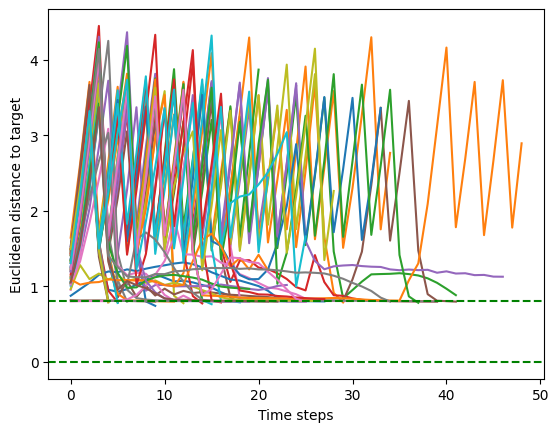

In [25]:
for i in range(50):
    plt.plot(euclids[i])
plt.axhline(y=0.8, color='g', linestyle='--')
plt.axhline(y=0, color='g', linestyle='--')
plt.plot()
plt.xlabel('Time steps')
plt.ylabel('Euclidean distance to target')
plt.show()

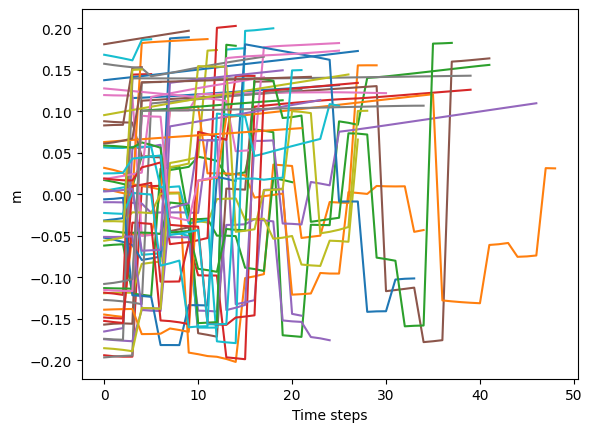

In [26]:
for i in range(50):
    plt.plot(dims0[i])
plt.plot()
plt.xlabel('Time steps')
plt.ylabel('m')
plt.show()